# Validacia v3 - konstatne emisie

Toto je verzia validacie pre simulacie s konstantnymi emisiami.

Validacia je robena pomocou funkcie validation z modulu validacia_v2.py
Je mozne validovat lubovolny pocet modelovych vystupov naraz.
V nasledujucej bunke treba urcit: 
   - nazovy validovanych modelov (zatial CMAQ/CAMS) 
   - nazovy gridov (zatial ala2km, d02, cams) 
   - zaciatocny a konecny cas simulacie vo formate YYYY-MM-DD hh:mm:ss  
   - cestu k netCDF suborom s modelovymi hodnotami (pokial nejde o d02 domenu, vid validacia CMAQ)

Pri jednotlivych typoch validacie a grafov je mozne urcit rocne obdobie, pre ktore chceme validovat.

Pri d02 gride pre rok 2015 a 2017 je vystup vo formate 1 file/rok/pollutant. Pre kazdy pollutant je teda treba zmenit path.

GRAFY:

Script zatial obsahuje grafy hodinovych, priemernych hodinovych a priemernych dennych chodov pozorovani vs modelov, farby pre jednotlive modely sa zadavaju v nasledujucej bunke.

V grafoch pre hodinove a priemerne denne data sa urci obdobie pre ktore chceme vykreslit ako datum; pre priemerne hodinove data sa zvoli rocne obdobie alebo mesiac (jar, leto, jesen, zima, rok, jan, feb...).
Na grafe je vzdy vypocitana hodnota R a RMSE pre zvolene obdobie.

Grafy sa defaultne neukladaju, ak chcete ulozit tak upravte save_path a zmente save na = True 
Je mozne rucne vypisat, ktore stanice chcem vyplotit, alebo zvolit vsetky stanice.

## User input

In [3]:
### USER INPUT
# pre kazdy modelovy vstup treba zadat nazov modelu aj grid, aj ked tieto mozu byt pre rozne vstupy rovnake
# poradie nazvov v nasledujucich listoch treba dodrzat, teda prvy prvok v kazdom liste opisuje prvy vstup atd
nick = 'const_emis_cop'   # specificky nazov pre celu validaciu x modelov
folder_name = 'CMAQ2017d02_ref_vs_cop_vs_const'   #nazov zlozky vo validated foldri
specific = ['ref','cop','rh_const','tot_const']   # specificky nazov pre kazdy z modelovych vstupov
model_name = ['CMAQ', 'CMAQ', 'CMAQ', 'CMAQ']    # prisluchajuci nazov modelu
grid_name = ['d02','d02','d02','d02']   # prisluchajuci grid
#start_date = '2017-01-01 00:00:00' # cele obdobie ktore chceme nahrat
#end_date = '2017-01-31 23:59:59'

start_date = ['2017-01-01 00:00:00', '2017-01-01 00:00:00', '2017-01-01 00:00:00','2017-01-01 00:00:00'] # cele obdobie ktore chceme nahrat
end_date = ['2017-12-31 23:59:59', '2017-12-31 23:59:59', '2017-12-31 23:59:59','2017-12-31 23:59:59']

obs_color = 'r'  # farba pozorovani v plotoch
#obs_color = 'darkred'

colors = ['k','b','g','fuchsia' ]   # farby pre modelove hodnoty v plotoch 
#colors = ['darkred','slateblue','orange','green','indigo']
#colors = ['darkred','black','slateblue','green','indigo']
color_list = {}
for i in range(0,len(specific)):
    color_list[specific[i]] = colors[i]

In [4]:
### NOT USER INPUT
import numpy as np
import pandas as pd
from IPython.display import Image, display
import matplotlib.pyplot as plt
vali_path = '/data/teri/validacia'
import os
import sys
sys.path.append(vali_path)
import validacia_v2 as vali
import xarray as xr

units = 'ug/m3'
locs = ['S','R','U']
types = ['B','T','I']
all_types = locs + types 
all_types_all = locs + types + ['all']
season = ['spring','summer','autumn','winter','year']
season_months = {'spring':[3,4,5], 'summer':[6,7,8], 'autumn':[9,10,11], 'winter':[1,2,12], 'year':list(range(1,13)),
                'jan':[1], 'feb':[2], 'mar':[3], 'apr':[4], 'may':[5], 'jun':[6], 'jul':[7], 'aug':[8],
                'sep':[9], 'okt':[10], 'nov':[11], 'dec':[12], 'let_cas':[4,5,6,7,8,9,10], 'zim_cas':[11,12,1,2,3]}

stat = {}
data = {} 
    
stanice = pd.read_csv('/data/teri/sezonalita_kv_ovzd/stanice_NMSKO_d02.csv')
pd.set_option('display.max_columns', 25)
stanice

,Unnamed: 0,id,ci,ii,name,cccc,cc,iso_cc,lat,lon,elev,info,...,SO2,NO,NO2,NOx,CO,BEN,H2S,O3,coord,x,y,lat_lon
0,0,78001,78,11813,"BRATISLAVA, JESENIOVA",NaN,SK,703,48.167952,17.106209,283.0,NaN,...,1,1,1,1,0,0,0,1,"(21, 92)",21,92,"(48.152134, 17.130432)"
1,1,78002,78,11916,"CHOPOK, EMEP",NaN,SK,703,48.943620,19.589236,1958.0,NaN,...,0,1,1,1,0,0,0,1,"(40, 130)",40,130,"(48.928993, 19.58075)"
2,2,78003,78,11952,"GANOVCE, METEO. ST.",NaN,SK,703,49.034601,20.322844,682.0,NaN,...,0,1,1,1,0,0,0,1,"(43, 141)",43,141,"(49.038628, 20.296814)"
3,3,78004,78,11958,KOJSOVSKA HOLA,NaN,SK,703,48.782875,20.987112,1230.0,NaN,...,0,1,1,1,0,0,0,1,"(37, 152)",37,152,"(48.76358, 20.986572)"
4,4,78005,78,99111,"BRATISLAVA, MAMATEYOVA",NaN,SK,703,48.124692,17.125400,134.0,NaN,...,1,1,1,1,0,0,1,1,"(20, 92)",20,92,"(48.10979, 17.13034)"
5,5,78006,78,99112,"BRATISLAVA, TRNAVSKE MYTO",NaN,SK,703,48.158359,17.128891,140.0,NaN,...,0,1,1,1,1,1,0,0,"(21, 92)",21,92,"(48.152134, 17.130432)"
6,6,78007,78,99114,"BRATISLAVA, KAMENNE NAM.",NaN,SK,703,48.144670,17.113543,146.0,NaN,...,0,0,0,0,0,0,0,0,"(21, 92)",21,92,"(48.152134, 17.130432)"
7,7,78008,78,99122,"SENICA, HVIEZDOSLAVOVA",NaN,SK,703,48.680681,17.363110,207.0,NaN,...,1,0,0,0,0,0,0,0,"(33, 96)",33,96,"(48.659653, 17.388062)"
8,8,78009,78,99123,"TRNAVA, KOLLAROVA",NaN,SK,703,48.371385,17.584926,144.0,NaN,...,0,1,1,1,1,1,0,0,"(26, 99)",26,99,"(48.36253, 17.577057)"
9,9,78038,78,99126,TRNOVEC NAD VAHOM,NaN,SK,703,48.150000,17.928600,114.0,NaN,...,0,0,0,0,0,0,0,0,"(21, 105)",21,105,"(48.14837, 17.955536)"


In [5]:
#statistiky = ['r','bias','rmse','mge']
#statistiky = ['r','bias','bias%','rmse','rmse%']
#statistiky = ['R','MB','MPE','MGE','MGPE','RMSE','RMSPE']
#statistiky = ['R','MB','MPE','RMSE','RMSPE']
#statistiky = ['R','MB','MB%','MPE','MGE','MGE%','MGPE','RMSE','RMSE%','RMSPE']
statistiky = ['R','MB','RMSE','FAC2']

# NO2

In [12]:
v = 'NO2'
path = {'ref':'/data/oko/dusan/POST/WB_2020_{0}_2017'.format(v),
        'rh_const':'/data/oko/dusan/POST/WB_const_{0}_2017'.format(v),
        'cop':'/data/oko/dusan/POST/WB_2017_d02_CAMS_13_res_heat_{0}_2017'.format(v),
       'tot_const':'/data/oko/dusan/POST/WB_totcons_{0}_2017'.format(v)} # prisluchajuca cesta k suboru

#for i in range(0, len(specific)):
for i, key in enumerate(specific):
    print(key)
    stat[key], data[key] = vali.validation(path[key], model_name[i], grid_name[i], start_date[i], end_date[i], v)

ref
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=11813 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=11916 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=11952 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=11958 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
sel

Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=99323 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=99325 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=99326 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=99334 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select 

/data/teri/validacia/validacia_v2.py:237: RuntimeWarning: Mean of empty slice
  stat['obs_mean'][s] = np.nanmean(obs_all[s])


Validation of NO2 done in 45.99454092979431 seconds
cop
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=11813 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=11916 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=11952 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=11958 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making conne

Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=99316 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=99323 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=99325 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=99326 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select 

Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=99214 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=99215 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=99217 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=99224 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select 

Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=11952 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=11958 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=99111 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=99112 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select 

Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=99326 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=99334 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=99351 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=99352 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select 

In [13]:
stat.keys()


'NO2'

In [8]:
pd.set_option('display.max_rows', 500)
stat['ref']


,name,loc,type,coverage,obs_mean,MB,MGE,RMSE,R,FAC2
all,all,all,all,94.0813,20.4475,-15.5743,15.9292,23.481,0.437662,23.7364
11813,"BRATISLAVA, JESENIOVA",S,B,94.0982,14.2364,-4.95346,7.02453,11.0958,0.585451,60.3785
11916,"CHOPOK, EMEP",R,B,50.6735,2.99507,-1.73536,2.02027,2.85282,0.257198,35.1205
11952,"GANOVCE, METEO. ST.",R,B,95.8333,8.62945,-4.56342,5.21356,8.79814,0.415064,49.6605
11958,KOJSOVSKA HOLA,R,B,96.7009,3.13693,-0.843229,2.01075,2.91394,0.262062,47.5977
99111,"BRATISLAVA, MAMATEYOVA",U,B,95.1826,23.6776,-13.8608,14.6327,20.1458,0.550984,32.3459
99112,"BRATISLAVA, TRNAVSKE MYTO",U,T,90.7877,39.2678,-29.7808,29.9111,36.8163,0.386772,15.8934
99114,"BRATISLAVA, KAMENNE NAM.",U,B,0,NaN,NaN,NaN,NaN,NaN,NaN
99117,BRATISLAVA - RACA,None,None,0,NaN,NaN,NaN,NaN,NaN,NaN
99122,"SENICA, HVIEZDOSLAVOVA",U,T,0,NaN,NaN,NaN,NaN,NaN,NaN


## Statistika

### Vsetky stanice

In [9]:
my_season = 'year'

stat_all = stat[specific[0]][['name','loc','type','coverage','obs_mean']].copy()

for s in statistiky:
    for i in specific:
        stat_all['{0}_{1}'.format(s,i)] = pd.Series(dtype = 'float64')

for i in specific:   
    for s in stat_all.index:
        
        if s == 'all':
            obs = data[i]['OBS'].sel(time = data[i].time.dt.month.isin(season_months[my_season])).to_series()
            mod = data[i]['MOD'].sel(time = data[i].time.dt.month.isin(season_months[my_season])).to_series()
        else: 
            obs = data[i]['OBS'].sel(station = s, time = data[i].time.dt.month.isin(season_months[my_season])).to_series()
            mod = data[i]['MOD'].sel(station = s, time = data[i].time.dt.month.isin(season_months[my_season])).to_series()

        stat_all.at[s,'R_{0}'.format(i)] = obs.corr(mod)
        diff = (mod - obs).to_numpy()
        diff = diff[~np.isnan(diff)]
        obs[obs == 0] = np.nan
        obs_ = obs[~np.isnan(obs)]
        stat_all.at[s, 'obs_mean'] = np.nanmean(obs)
        podiel = (mod/obs).to_numpy()
        podiel = podiel[~np.isnan(podiel)]
        podiel_fac2 = podiel[podiel <= 2]
        podiel_fac2 = podiel_fac2[podiel_fac2 >= 0.5]
        
        if len(diff) != 0:
            stat_all.at[s, 'MB_{0}'.format(i)] = np.sum(diff)/len(diff)
            #stat_all.at[s, 'MPE_{0}'.format(i)] = 100*np.sum(diff/obs_)/len(diff)
            #stat_all.at[s,'MGE_{0}'.format(i)] = np.sum(np.absolute(diff))/len(diff)
            #stat_all.at[s,'MGPE_{0}'.format(i)] = 100*np.sum(np.absolute(diff/obs_))/len(diff)
            stat_all.at[s,'RMSE_{0}'.format(i)] = np.sqrt(np.sum(diff**2)/len(diff))
            #stat_all.at[s,'RMSPE_{0}'.format(i)] = 100*np.sqrt(np.sum((diff/obs_)**2)/len(diff))
            stat_all.at[s,'FAC2_{0}'.format(i)] = 100*len(podiel_fac2)/len(podiel)

#stat_all.loc[stat_all.coverage != 0]
#stat_all.loc[stat_all.r_full >= 0.5]
#stat_all.to_csv('/data/teri/validacia/validated/{0}/tabulky/validation_{1}_all_{2}_2.csv'.format(folder_name,v,my_season))
stat_all.loc[stat_all.coverage != 0]

<ipython-input-9-506ec1bf269f>:24: RuntimeWarning: Mean of empty slice
  stat_all.at[s, 'obs_mean'] = np.nanmean(obs)


,name,loc,type,coverage,obs_mean,R_ref,R_cop,R_rh_const,R_tot_const,MB_ref,MB_cop,MB_rh_const,MB_tot_const,RMSE_ref,RMSE_cop,RMSE_rh_const,RMSE_tot_const,FAC2_ref,FAC2_cop,FAC2_rh_const,FAC2_tot_const
all,all,all,all,94.0813,20.4475,0.437662,0.445416,0.437706,0.361731,-15.574340,-15.229631,-15.244420,-14.757931,23.481044,23.168590,23.222937,23.227068,23.736398,25.586057,25.781652,29.414477
11813,"BRATISLAVA, JESENIOVA",S,B,94.0982,14.2364,0.585451,0.583708,0.573583,0.450903,-4.953463,-4.348507,-4.363299,-3.276929,11.095779,10.893993,10.981723,11.837519,60.378503,62.780541,62.816936,57.418416
11916,"CHOPOK, EMEP",R,B,50.6735,2.99507,0.257198,0.259723,0.261306,0.243349,-1.735361,-1.694931,-1.696925,-1.700879,2.852817,2.830289,2.828560,2.827797,35.120523,36.246902,36.201847,37.913945
11952,"GANOVCE, METEO. ST.",R,B,95.8333,8.62945,0.415064,0.418035,0.410952,0.445550,-4.563421,-4.151881,-4.157363,-3.632035,8.798143,8.577813,8.603764,8.251134,49.660512,53.055390,53.650983,56.390709
11958,KOJSOVSKA HOLA,R,B,96.7009,3.13693,0.262062,0.254266,0.251841,0.210358,-0.843229,-0.721579,-0.724103,-0.659394,2.913936,2.996930,2.995155,3.031984,47.597686,49.155944,49.510093,50.242002
99111,"BRATISLAVA, MAMATEYOVA",U,B,95.1826,23.6776,0.550984,0.550335,0.546424,0.475635,-13.860814,-13.338439,-13.341991,-12.213972,20.145817,19.752573,19.786314,19.570339,32.345886,34.924442,34.912449,40.441353
99112,"BRATISLAVA, TRNAVSKE MYTO",U,T,90.7877,39.2678,0.386772,0.395614,0.393406,0.204195,-29.780841,-29.167056,-29.189572,-27.973712,36.816338,36.258735,36.291759,36.398126,15.893374,17.892619,17.792028,25.751289
99123,"TRNAVA, KOLLAROVA",U,T,97.8311,36.5444,0.320711,0.334889,0.326118,0.153503,-31.129027,-30.722037,-30.738329,-30.005606,36.682309,36.280610,36.325585,36.171427,5.519253,6.406068,6.592765,13.465578
99128,"TRENCIN, HASICSKA",U,T,95.6849,31.1322,0.185858,0.194063,0.181282,0.068009,-22.707478,-22.090496,-22.109143,-21.457262,29.853344,29.412254,29.483035,29.705604,24.624195,26.330231,26.437604,28.608924
99132,"MALACKY, MIEROVE NAMESTIE",U,T,98.6187,28.6218,0.379461,0.385725,0.375156,0.295955,-23.725579,-23.545419,-23.558110,-23.126661,27.990646,27.813569,27.854897,27.679050,5.996064,6.540109,6.713740,10.545202


In [36]:
#stat_all.loc[stat_all.coverage != 0]
stat_all.loc[stat_all.R_ref <= 0.3]

,name,loc,type,coverage,obs_mean,R_ref,R_cop,R_rh_const,R_tot_const,MB_ref,MB_cop,MB_rh_const,MB_tot_const,RMSE_ref,RMSE_cop,RMSE_rh_const,RMSE_tot_const,FAC2_ref,FAC2_cop,FAC2_rh_const,FAC2_tot_const
11916,"CHOPOK, EMEP",R,B,50.6735,2.99507,0.257198,0.259723,0.261306,0.243349,-1.735361,-1.694931,-1.696925,-1.700879,2.852817,2.830289,2.828560,2.827797,35.120523,36.246902,36.201847,37.913945
11958,KOJSOVSKA HOLA,R,B,96.7009,3.13693,0.262062,0.254266,0.251841,0.210358,-0.843229,-0.721579,-0.724103,-0.659394,2.913936,2.996930,2.995155,3.031984,47.597686,49.155944,49.510093,50.242002
99128,"TRENCIN, HASICSKA",U,T,95.6849,31.1322,0.185858,0.194063,0.181282,0.068009,-22.707478,-22.090496,-22.109143,-21.457262,29.853344,29.412254,29.483035,29.705604,24.624195,26.330231,26.437604,28.608924
99224,"RUZOMBEROK, RIADOK",U,B,97.226,21.0635,0.291792,0.297390,0.286753,0.191486,-14.728475,-14.226887,-14.232722,-13.833440,20.438661,20.099333,20.148363,20.358710,23.952096,25.995069,26.042034,27.509687


In [37]:
ID_B = list(stat_all.loc[stat_all.type == 'B'].loc[stat_all.coverage != 0].index.values)
ID_B

[11813,
 11916,
 11952,
 11958,
 99111,
 99134,
 99215,
 99224,
 99246,
 99252,
 99281,
 99351,
 99401,
 99403,
 99404]

### Typy stanic

In [10]:
my_season = 'year'

#stat_types_mine = ['all','RB', 'OB', 'UT', 'I']
stat_types_mine = ['all','RB', 'OB', 'UT']
stat_types = pd.DataFrame(index = stat_types_mine, columns = ['n']+list(stat_all.columns)[3:])

for i in specific:
    for t in stat_types_mine:
        if t == 'RB':
            #loc_, type_ = 'R', 'B'
            stanice_vyber = list(stat_all.loc[stat_all['type'] == 'B'].loc[stat_all['loc']=='R'].loc[stat_all['coverage'] != 0].index)
        
        if t == 'OB':
            stanice_vyber = list(stat_all.loc[stat_all['type'] == 'B'].loc[stat_all['loc']=='U'].loc[stat_all['coverage'] != 0].index) + list(stat_all.loc[stat_all['type'] == 'B'].loc[stat_all['loc']=='S'].loc[stat_all['coverage'] != 0].index)
             
        if t == 'UT':
            stanice_vyber = list(stat_all.loc[stat_all['type'] == 'T'].loc[stat_all['loc']=='U'].loc[stat_all['coverage'] != 0].index)
            
        if t == 'I':
            stanice_vyber = list(stat_all.loc[stat_all['type'] == 'I'].loc[stat_all['coverage'] != 0].index)
            
        if t == 'all':
            stanice_vyber = list(stat_all.loc[stat_all.coverage != 0].index.values)[1:]
            
        #stat_types.at[t,'count'] = len(stat_all.loc[stat_all['type'] == type_].loc[stat_all['loc']==loc_])
        #stanice_vyber = list(stat_all.loc[stat_all[col] == t].loc[stat_all['coverage'] != 0].index)
        stat_types.at[t,'n'] = len(stanice_vyber)
        obs = data[i]['OBS'].sel(station = stanice_vyber, time = data[i].time.dt.month.isin(season_months[my_season])).to_series()
        mod = data[i]['MOD'].sel(station = stanice_vyber, time = data[i].time.dt.month.isin(season_months[my_season])).to_series()

        obs[obs == 0] = np.nan
        obs_ = obs[~np.isnan(obs)]
        podiel = (mod/obs).to_numpy()
        podiel = podiel[~np.isnan(podiel)]
        podiel_fac2 = podiel[podiel <= 2]
        podiel_fac2 = podiel_fac2[podiel_fac2 >= 0.5]
        
        stat_types.at[t,'coverage'] = 100*(len(obs) - obs.isna().sum())/len(obs)
        stat_types.at[t,'obs_mean'] = np.nanmean(obs)
        stat_types.at[t,'R_{0}'.format(i)] = obs.corr(mod)
        diff = (mod - obs).to_numpy()
        diff = diff[~np.isnan(diff)]
        stat_types.at[t, 'MB_{0}'.format(i)] = np.sum(diff)/len(diff)
        #stat_types.at[t, 'MPE_{0}'.format(i)] = 100*np.sum(diff/obs_)/len(diff)
        #stat_types.at[t,'MGE_{0}'.format(i)] = np.sum(np.absolute(diff))/len(diff)
        #stat_types.at[t,'MGPE_{0}'.format(i)] = 100*np.sum(np.absolute(diff/obs_))/len(diff)
        stat_types.at[t,'RMSE_{0}'.format(i)] = np.sqrt(np.sum(diff**2)/len(diff))
        #stat_types.at[t,'RMSPE_{0}'.format(i)] = 100*np.sqrt(np.sum((diff/obs_)**2)/len(diff))
        stat_types.at[t,'FAC2_{0}'.format(i)] = 100*len(podiel_fac2)/len(podiel)
        
stat_types

,n,coverage,obs_mean,R_ref,R_cop,R_rh_const,R_tot_const,MB_ref,MB_cop,MB_rh_const,MB_tot_const,RMSE_ref,RMSE_cop,RMSE_rh_const,RMSE_tot_const,FAC2_ref,FAC2_cop,FAC2_rh_const,FAC2_tot_const
all,25,94.0813,20.4475,0.437662,0.445416,0.437706,0.361731,-15.5743,-15.2296,-15.2444,-14.7579,23.481,23.1686,23.2229,23.2271,23.7364,25.5861,25.7817,29.4145
RB,6,88.8527,5.27068,0.53147,0.53867,0.533967,0.540588,-2.5936,-2.43498,-2.4404,-2.22589,5.34716,5.24586,5.26309,5.14609,44.9669,47.0825,47.2902,49.1467
OB,9,95.756,16.8583,0.477391,0.48214,0.470507,0.396715,-11.3842,-10.9987,-11.0169,-10.4826,17.4944,17.1899,17.2677,17.3168,28.1095,30.67,30.9018,34.0477
UT,10,95.7112,32.1328,0.373054,0.383296,0.372504,0.237127,-26.5775,-26.1659,-26.1828,-25.588,32.6102,32.2135,32.2706,32.2647,7.97324,9.03474,9.19099,14.2516


In [39]:
stat_types_diff = stat_types.copy()
for s in statistiky:
    for e in ['cop','rh_const','tot_const']:
        stat_types_diff['{0}_{1}'.format(s,e)] = stat_types['{0}_{1}'.format(s,e)] - stat_types['{0}_ref'.format(s)]

stat_types_diff.to_csv('/data/teri/validacia/validated/{0}/tabulky/stat_types_validation_{1}_{2}_fac2.csv'.format(folder_name,v,my_season))

stat_types_diff

,n,coverage,obs_mean,R_ref,R_cop,R_rh_const,R_tot_const,MB_ref,MB_cop,MB_rh_const,MB_tot_const,RMSE_ref,RMSE_cop,RMSE_rh_const,RMSE_tot_const,FAC2_ref,FAC2_cop,FAC2_rh_const,FAC2_tot_const
all,25,94.0813,20.4475,0.437662,0.00775403,4.39062e-05,-0.0759306,-15.5743,0.344709,0.32992,0.816409,23.481,-0.312455,-0.258108,-0.253977,23.7364,1.84966,2.04525,5.67808
RB,6,88.8527,5.27068,0.53147,0.00719946,0.00249697,0.00911733,-2.5936,0.158628,0.153206,0.36771,5.34716,-0.101302,-0.0840756,-0.201073,44.9669,2.11559,2.32329,4.17978
OB,9,95.756,16.8583,0.477391,0.00474882,-0.0068838,-0.0806759,-11.3842,0.385535,0.367283,0.901668,17.4944,-0.304452,-0.226629,-0.177554,28.1095,2.56047,2.79227,5.93822
UT,10,95.7112,32.1328,0.373054,0.0102418,-0.000549898,-0.135927,-26.5775,0.411597,0.394708,0.989567,32.6102,-0.396665,-0.339592,-0.345454,7.97324,1.06151,1.21775,6.2784


### Stat. tabulka seasons

In [11]:
stat_season = pd.DataFrame(index = season, columns = ['coverage','obs_mean'] + statistiky)
stat_season_all = {}
for i in ['ref','cop','rh_const','tot_const']:
    stat_season_all[i] = {}
    for t in all_types_all:
        if t in locs:
            stanice_vyber = list(stat_all.loc[stat_all['loc'] == t].loc[stat_all['coverage'] != 0].index)
        elif t in types:
            stanice_vyber = list(stat_all.loc[stat_all['type'] == t].loc[stat_all['coverage'] != 0].index)
        else:
            stanice_vyber = list(stat_all.loc[stat_all['coverage'] != 0].index.values)[1:]
            
        for s in season:   
            obs = data[i]['OBS'].sel(station = stanice_vyber, time = data[i].time.dt.month.isin(season_months[s])).to_series()
            mod = data[i]['MOD'].sel(station = stanice_vyber, time = data[i].time.dt.month.isin(season_months[s])).to_series()
        
            obs[obs == 0] = np.nan
            obs_ = obs[~np.isnan(obs)]
            podiel = (mod/obs).to_numpy()
            podiel = podiel[~np.isnan(podiel)]
            podiel_fac2 = podiel[podiel <= 2]
            podiel_fac2 = podiel_fac2[podiel_fac2 >= 0.5]
            
            stat_season.at[s,'coverage'] = 100*(len(obs) - obs.isna().sum())/len(obs)
            stat_season.at[s,'obs_mean'] = np.nanmean(obs)
            stat_season.at[s,'R'.format(i)] = obs.corr(mod)
            diff = (mod - obs).to_numpy()
            diff = diff[~np.isnan(diff)]
            stat_season.at[s, 'MB'.format(i)] = np.sum(diff)/len(diff)
            #stat_season.at[s,'MGE'.format(i)] = np.sum(np.absolute(diff))/len(diff)
            stat_season.at[s,'RMSE'.format(i)] = np.sqrt(np.sum(diff**2)/len(diff))
            if len(podiel) != 0:
                stat_season.at[s,'FAC2'.format(i)] = 100*len(podiel_fac2)/len(podiel)
        
        stat_season_all[i][t] = stat_season.copy()
        #stat_season.to_csv('/data/teri/validacia/validated/CMAQ2017d02_full_vs_const/tabulky/stat_seasons_{0}_CMAQ2017d02_{1}_{2}.csv'.format(v,i,t))
#stat_season_all

<ipython-input-11-b948b195496a>:24: RuntimeWarning: invalid value encountered in long_scalars
  stat_season.at[s,'coverage'] = 100*(len(obs) - obs.isna().sum())/len(obs)
<ipython-input-11-b948b195496a>:25: RuntimeWarning: Mean of empty slice
  stat_season.at[s,'obs_mean'] = np.nanmean(obs)
<ipython-input-11-b948b195496a>:29: RuntimeWarning: invalid value encountered in double_scalars
  stat_season.at[s, 'MB'.format(i)] = np.sum(diff)/len(diff)
<ipython-input-11-b948b195496a>:31: RuntimeWarning: invalid value encountered in double_scalars
  stat_season.at[s,'RMSE'.format(i)] = np.sqrt(np.sum(diff**2)/len(diff))


In [41]:
#stat_season_all

In [12]:
typ = 'B'
stat_season_diff = pd.DataFrame(index = season, columns = list(stat_all.columns)[3:])
for s in statistiky:
    stat_season_diff['{0}_ref'.format(s)] = stat_season_all['ref']['B'][s].copy()
    stat_season_diff['coverage'.format(s)] = stat_season_all['ref']['B']['coverage'].copy()
    stat_season_diff['obs_mean'.format(s)] = stat_season_all['ref']['B']['obs_mean'].copy()
    for e in ['cop', 'rh_const','tot_const']:
        stat_season_diff['{0}_{1}'.format(s,e)] = stat_season_all[e]['B'][s] - stat_season_all['ref']['B'][s]

stat_season_diff.to_csv('/data/teri/validacia/validated/{0}/tabulky/seasons_validation_{1}_{2}_fac2.csv'.format(folder_name,typ,v))

stat_season_diff

,coverage,obs_mean,R_ref,R_cop,R_rh_const,R_tot_const,MB_ref,MB_cop,MB_rh_const,MB_tot_const,RMSE_ref,RMSE_cop,RMSE_rh_const,RMSE_tot_const,FAC2_ref,FAC2_cop,FAC2_rh_const,FAC2_tot_const
spring,97.2464,9.91369,0.509866,0.00171265,0.00158774,-0.0479899,-6.41801,0.213868,0.253661,0.755307,10.7984,-0.159609,-0.184376,-0.290272,31.5574,2.17958,2.62668,6.94858
summer,91.5127,7.21474,0.438035,0.00463799,0.00833427,-0.0352752,-4.80581,0.200935,0.280539,1.04832,8.89816,-0.135368,-0.19123,-0.341899,30.2055,2.5306,3.63918,6.81976
autumn,88.8675,12.3784,0.493943,0.00303351,0.00173344,-0.0651714,-7.29389,0.347961,0.379764,0.490787,12.4467,-0.221766,-0.23269,0.0628145,40.8512,2.66204,3.0124,3.39367
winter,94.3364,20.301,0.476483,0.0109757,0.000386623,-0.0301833,-13.6053,0.438577,0.23405,0.485985,21.2291,-0.393055,-0.185872,-0.178538,36.0183,2.21495,1.20072,3.7363
year,92.9947,12.4297,0.535606,0.00510699,-0.00371814,-0.0565301,-8.02459,0.298815,0.285466,0.697598,14.1426,-0.247311,-0.185345,-0.16447,34.5522,2.39044,2.61304,5.26617


## Hodinovy chod koncentracii 

In [15]:
### USER INPUT
# Choose stations to plot
ID = list(stat_all.loc[stat_all.coverage != 0].index.values)[1:]
#ID = [11813,11916]    # selected stations
save = False   # save the plots?

plot_from = '2017-03-25'
plot_until = '2017-03-25'  

save_path = '{0}/validated/{1}_{2}/graphs/{3}'.format(vali_path, folder_name, start_date[0:4],v)

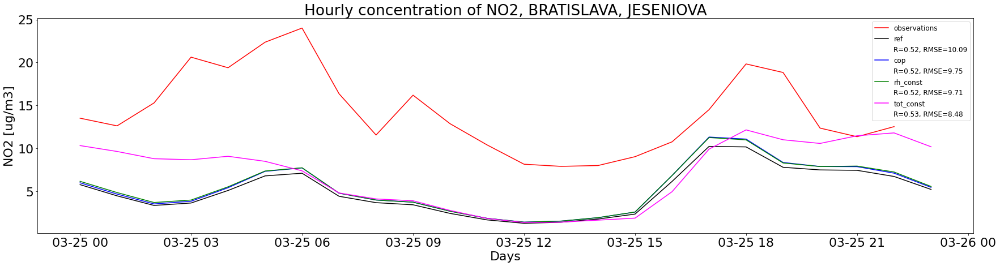

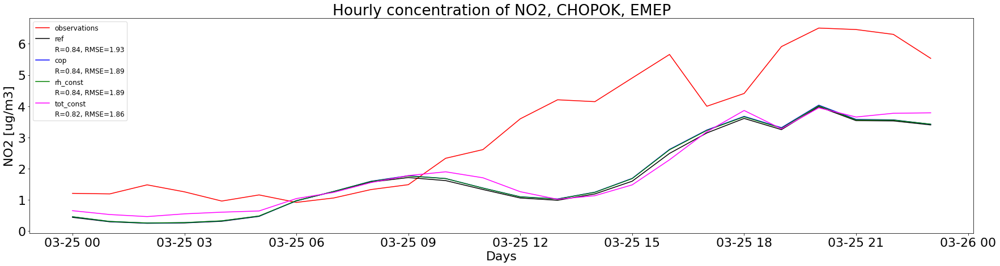

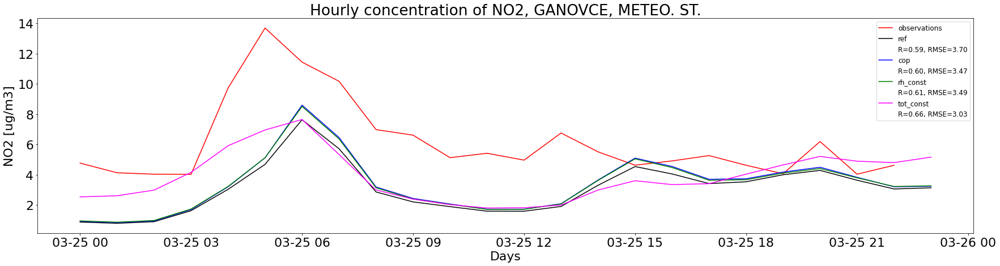

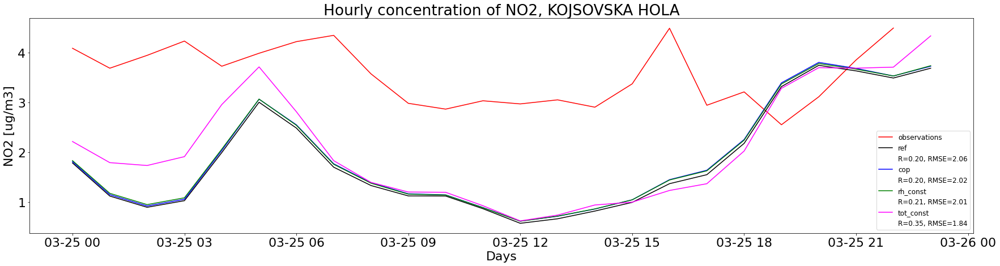

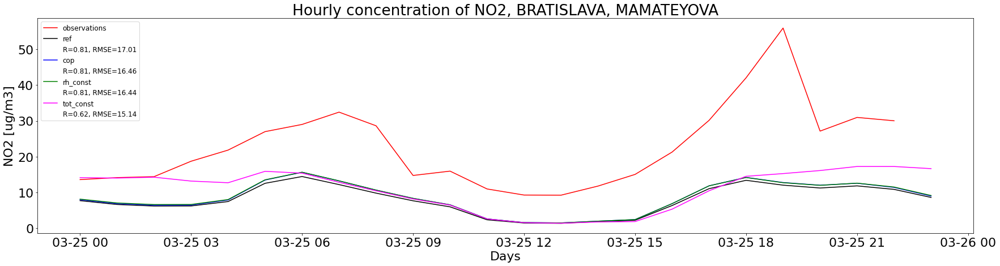

...

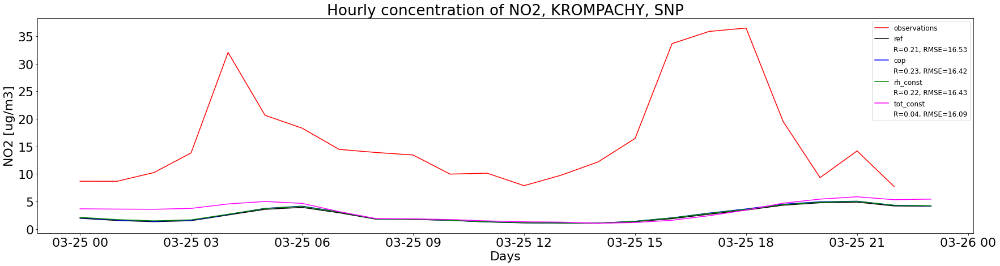

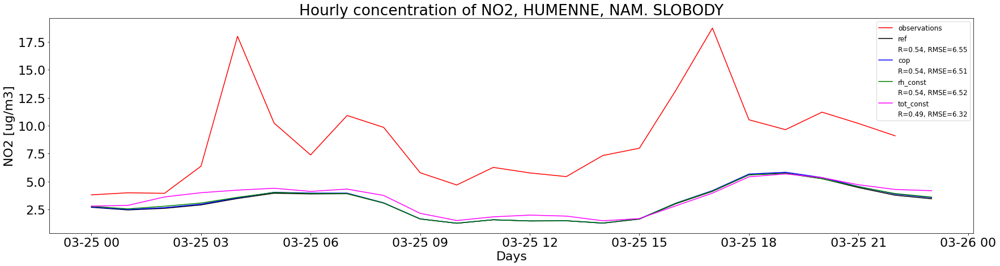

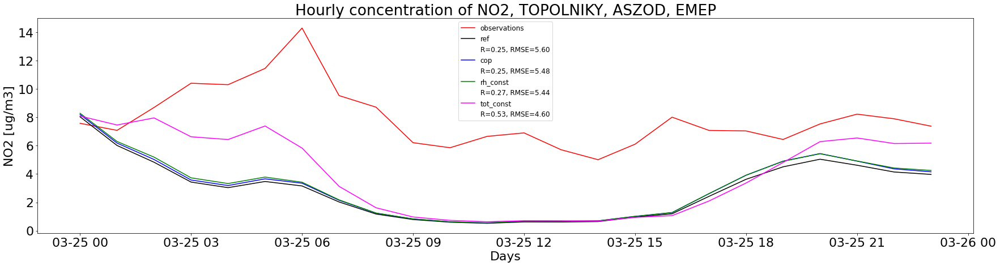

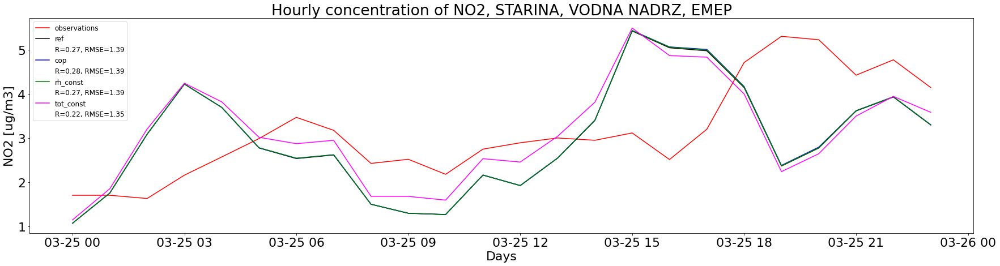

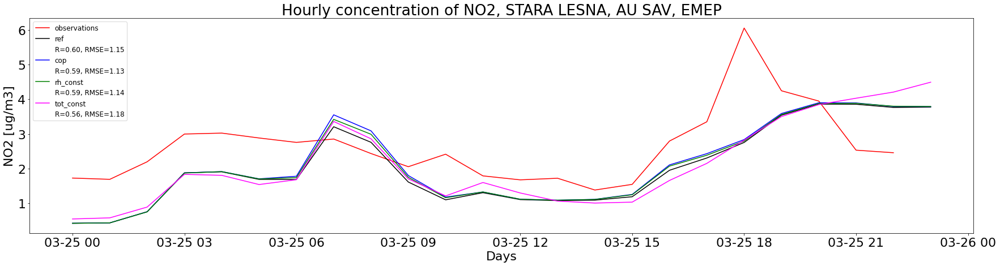

In [69]:
if save:
    print('Plots will be saved at:{}'.format(save_path))
for i in ID:    
    
    obs_id = data[specific[0]]['OBS'].sel(station = i).to_series()[plot_from:plot_until]
    name_sta = stat[specific[0]].name.loc[stat[specific[0]].index == i].item()
    
    plt.rcParams['figure.figsize'] = 25,7
    plt.rcParams.update({'font.size': 22})

    plt.plot(obs_id.index[:], obs_id[:], color =obs_color, label = 'observations')                
    for s in specific:
        mod_id = data[s]['MOD'].sel(station = i).to_series()[plot_from:plot_until]
        
        stat_corr = mod_id.corr(obs_id)
        stat_diff = np.array((mod_id - obs_id).dropna())
        if len(stat_diff) != 0:
            stat_rmse = np.sqrt(np.sum(stat_diff**2)/len(stat_diff))
        else:
            stat_rmse = np.nan
            
        plt.plot(obs_id.index[:], mod_id[:], color = color_list[s], label = '{}'.format(s))
        plt.plot([], [], ' ', label='R={:0.2f}, RMSE={:1.2f}'.format(stat_corr,stat_rmse))

    plt.legend(fontsize=12)                
    plt.title('Hourly concentration of {0}, {1}'.format(v,name_sta))                               
    plt.xlabel('Days')
    plt.ylabel('{0} [{1}]'.format(v,units))
    plt.tight_layout()

    if save:
        if not os.path.exists(save_path):
            os.makedirs(save_path)
        plt.savefig('{0}/{1}_{2}_{3}_{4}_H{5}-{6}.png'.format(save_path,nick, start_date[0:4], v, i,plot_from,plot_until), dpi=300)                
    plt.show()                
    plt.close()   

## Priemerny hodinovy chod 

In [16]:
### USER INPUT
# Choose stations to plot
ID = list(stat_all.loc[stat_all.coverage != 0].index.values)[1:]
#ID = [11813,11916]    # selected stations

my_season = 'winter'

save = True   # save the plots?  

save_path = '{0}/validated/{1}/graphs/{2}'.format(vali_path, folder_name,v)

Plots will be saved at:/data/teri/validacia/validated/const_emis_cop_['2017-01-01 00:00:00', '2017-01-01 00:00:00', '2017-01-01 00:00:00', '2017-01-01 00:00:00']/graphs/NO2


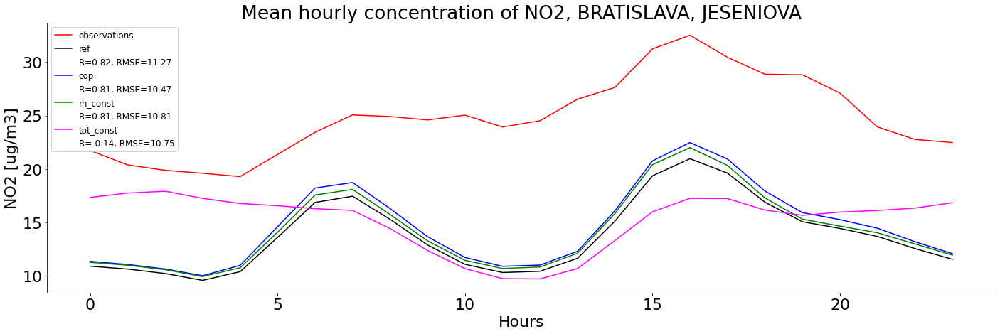

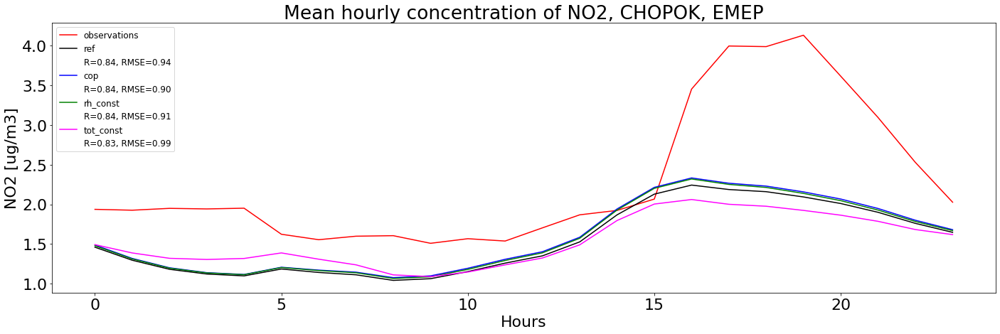

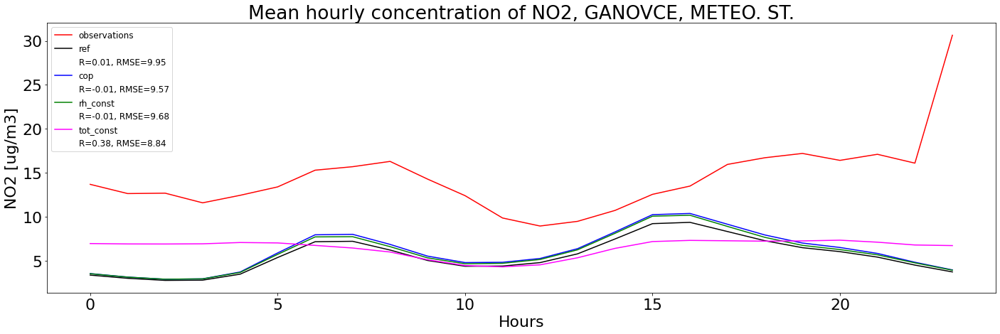

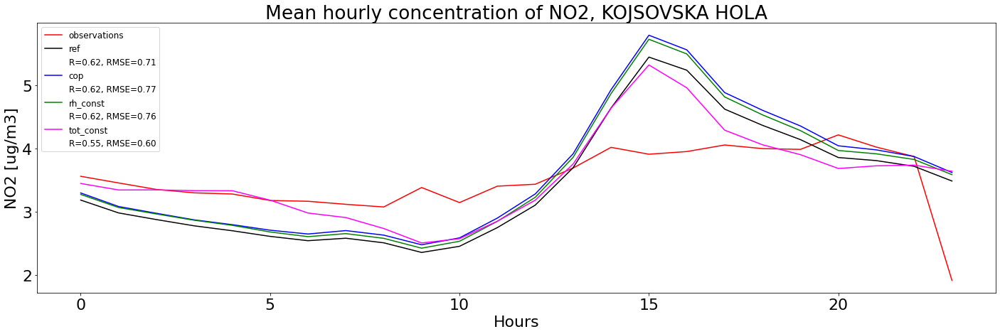

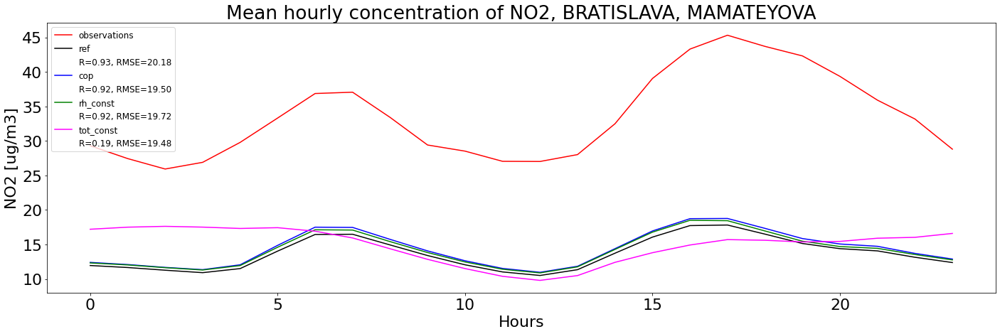

...

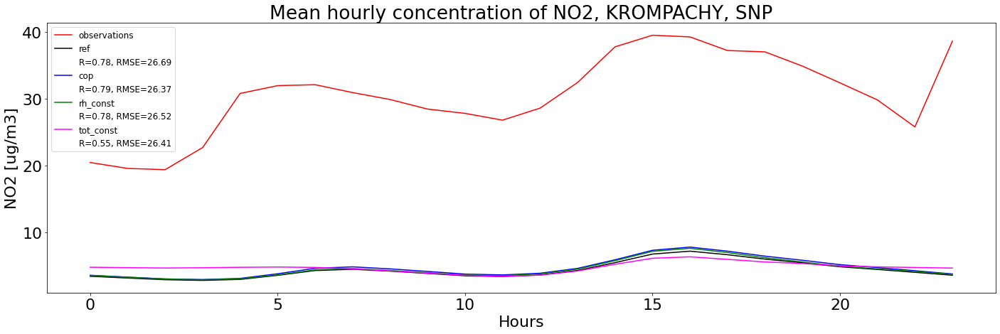

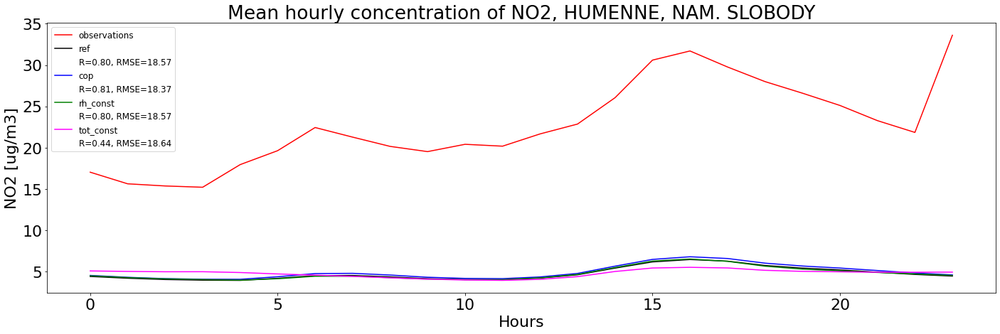

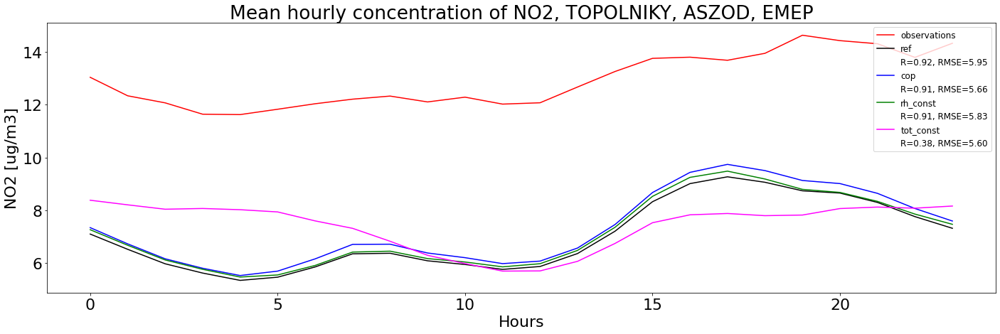

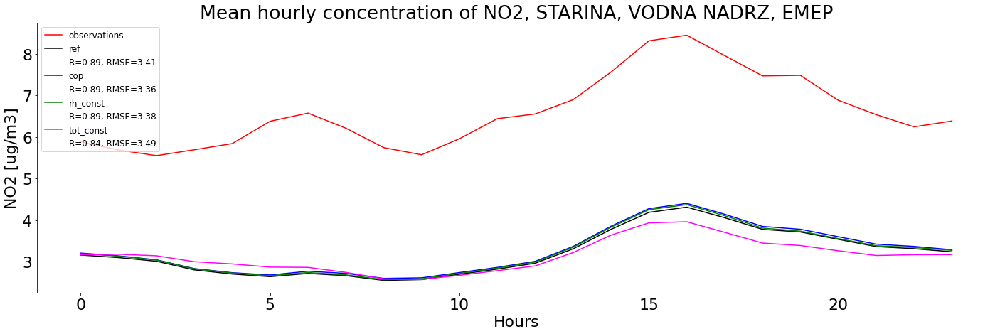

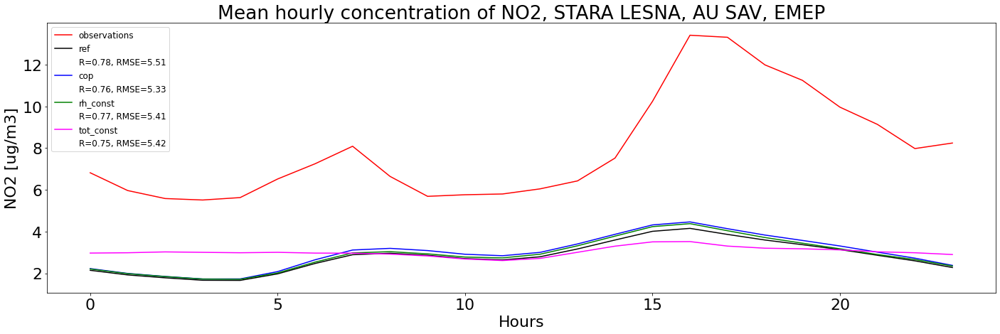

In [14]:
if save:
    print('Plots will be saved at:{}'.format(save_path))
for i in ID:    
    
    obs_id = data[specific[0]]['OBS'].sel(station = i, time = data[specific[0]].time.dt.month.isin(season_months[my_season])).groupby('time.hour').mean()
    name_sta = stat[specific[0]].name.loc[stat[specific[0]].index == i].item()
    
    plt.rcParams['figure.figsize'] = 20,7
    plt.rcParams.update({'font.size': 22})

    plt.plot(obs_id.hour, obs_id[:], color =obs_color, label = 'observations')                
    for s in specific:
        mod_id = data[s]['MOD'].sel(station = i, time = data[s].time.dt.month.isin(season_months[my_season])).groupby('time.hour').mean()
        
        stat_corr = mod_id.to_series().corr(obs_id.to_series())
        stat_diff = np.array((mod_id - obs_id).to_series().dropna())
        if len(stat_diff) != 0:
            stat_rmse = np.sqrt(np.sum(stat_diff**2)/len(stat_diff))
        else:
            stat_rmse = np.nan
            
        plt.plot(obs_id.hour, mod_id[:], color = color_list[s], label = '{}'.format(s))
        plt.plot([], [], ' ', label='R={:0.2f}, RMSE={:1.2f}'.format(stat_corr,stat_rmse))

    plt.legend(fontsize=12)                
    plt.title('Mean hourly concentration of {0}, {1}'.format(v,name_sta))                               
    plt.xlabel('Hours')
    plt.ylabel('{0} [{1}]'.format(v,units))
    plt.tight_layout()

    if save:
        if not os.path.exists(save_path):
            os.makedirs(save_path)
        #plt.savefig('{0}/{1}_{2}_{3}_{4}_MH_{5}.png'.format(save_path,nick,name_sta, v, i,my_season), dpi=300)                
    plt.show()                
    plt.close() 

## Priemerny hodinovy chod pre typy stanic

In [17]:
### USER INPUT
# Choose stations to plot
#moj_typ = 'B'
#moj_loc = 'R'
my_name = 'B'
#ID = list(stat_all.loc[stat_all['type'] == moj_typ].loc[stat_all['loc'] != moj_loc].loc[stat_all.coverage != 0].index.values)
ID = list(stat_all.loc[stat_all['type'] == my_name].loc[stat_all.coverage != 0].index.values)
#ID = [11813,11916]    # selected stations

my_season = 'winter'

save = True   # save the plots?  

save_path = '{0}/validated/{1}/graphs/{2}'.format(vali_path,folder_name, v)

Plots will be saved at:/data/teri/validacia/validated/CMAQ2017d02_ref_vs_cop_vs_const/graphs/NO2


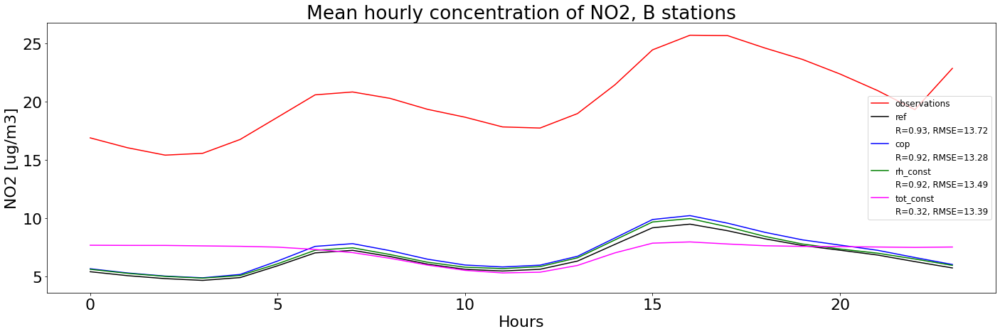

In [18]:
if save:
    print('Plots will be saved at:{}'.format(save_path))
#for i in ID:    
    
obs_id = data[specific[0]]['OBS'].sel(station = ID, time = data[specific[0]].time.dt.month.isin(season_months[my_season])).groupby('time.hour').mean().mean(dim = 'station')
#name_sta = stat[specific[0]].name.loc[stat[specific[0]].index == i].item()

plt.rcParams['figure.figsize'] = 20,7
plt.rcParams.update({'font.size': 22})

plt.plot(obs_id.hour, obs_id[:], color =obs_color, label = 'observations')                
for s in specific:
    mod_id = data[s]['MOD'].sel(station = ID, time = data[s].time.dt.month.isin(season_months[my_season])).groupby('time.hour').mean().mean(dim = 'station')

    stat_corr = mod_id.to_series().corr(obs_id.to_series())
    stat_diff = np.array((mod_id - obs_id).to_series().dropna())
    if len(stat_diff) != 0:
        stat_rmse = np.sqrt(np.sum(stat_diff**2)/len(stat_diff))
    else:
        stat_rmse = np.nan

    plt.plot(obs_id.hour, mod_id[:], color = color_list[s], label = '{}'.format(s))
    plt.plot([], [], ' ', label='R={:0.2f}, RMSE={:1.2f}'.format(stat_corr,stat_rmse))

plt.legend(fontsize=12)                
plt.title('Mean hourly concentration of {0}, {1} stations'.format(v, my_name))                               
plt.xlabel('Hours')
plt.ylabel('{0} [{1}]'.format(v,units))
plt.tight_layout()

if save:
    if not os.path.exists(save_path):
        os.makedirs(save_path)
    plt.savefig('{0}/MH_{1}_{2}_{3}_{4}.png'.format(save_path,my_name, nick, v, my_season), dpi=300)                
plt.show()                
plt.close() 

## Normovany priemerny hodinovy chod pre typy stanic

In [19]:
### USER INPUT
# Choose stations to plot
#moj_typ = 'T'
#moj_loc = 'U'
my_name = 'B'
#ID = list(stat_all.loc[stat_all['type'] == moj_typ].loc[stat_all['loc'] == moj_loc].loc[stat_all.coverage != 0].index.values)
ID = list(stat_all.loc[stat_all['type'] == my_name].loc[stat_all.coverage != 0].index.values)
#ID = [11813,11916]    # selected stations

my_season = 'winter'

save = True   # save the plots?  

save_path = '{0}/validated/{1}/graphs/{2}'.format(vali_path, folder_name,v)

Plots will be saved at:/data/teri/validacia/validated/CMAQ2017d02_ref_vs_cop_vs_const/graphs/NO2


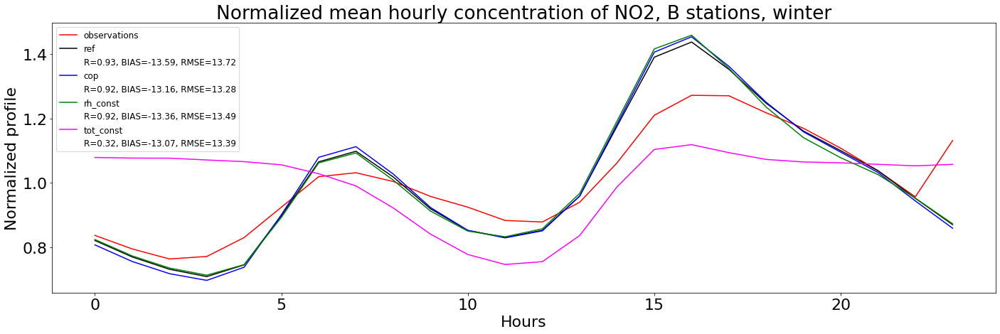

In [20]:
if save:
    print('Plots will be saved at:{}'.format(save_path))
#for i in ID:    
    
obs_id = data[specific[0]]['OBS'].sel(station = ID, time = data[specific[0]].time.dt.month.isin(season_months[my_season])).groupby('time.hour').mean().mean(dim = 'station')
#name_sta = stat[specific[0]].name.loc[stat[specific[0]].index == i].item()

plt.rcParams['figure.figsize'] = 20,7
plt.rcParams.update({'font.size': 22})

obs_id_norm = 24*obs_id/obs_id.sum()
plt.plot(obs_id.hour, obs_id_norm[:], color =obs_color, label = 'observations')                
for s in specific:
    mod_id = data[s]['MOD'].sel(station = ID, time = data[s].time.dt.month.isin(season_months[my_season])).groupby('time.hour').mean().mean(dim = 'station')
    mod_id_norm = 24*mod_id/mod_id.sum()
    
    stat_corr = mod_id.to_series().corr(obs_id.to_series())
    stat_diff = np.array((mod_id - obs_id).to_series().dropna())
    if len(stat_diff) != 0:
        stat_bias = np.sum(stat_diff)/len(stat_diff)
        stat_rmse = np.sqrt(np.sum(stat_diff**2)/len(stat_diff))
    else:
        stat_rmse = np.nan
        stat_bias = np.nan
    
    plt.plot(obs_id.hour, mod_id_norm[:], color = color_list[s], label = '{}'.format(s))
    #plt.plot([], [], ' ', label='R={:0.2f}, RMSE={:1.2f}'.format(stat_corr,stat_rmse))
    plt.plot([], [], ' ', label='R={:0.2f}, BIAS={:1.2f}, RMSE={:1.2f}'.format(stat_corr,stat_bias, stat_rmse))

plt.legend(fontsize=12)                
plt.title('Normalized mean hourly concentration of {0}, {1} stations, {2}'.format(v, my_name, my_season))                               
plt.xlabel('Hours')
plt.ylabel('Normalized profile')
plt.tight_layout()

if save:
    if not os.path.exists(save_path):
        os.makedirs(save_path)
    plt.savefig('{0}/MH_norm_{1}_{2}_{3}_{4}.png'.format(save_path,my_name, nick, v, my_season), dpi=300)                
plt.show()                
plt.close() 

## Priemerny rocny chod pre stanice

Chod priemernych dennych hodnot

In [74]:
### USER INPUT
# Choose stations to plot
ID = list(stat_all.loc[stat_all.coverage != 0].index.values)[1:]
#ID = [11813,11916]    # selected stations
save = False   # save the plots?

plot_from = '2017-01-01'
plot_until = '2017-12-31' 

save_path = '{0}/validated/{1}_{2}/graphs/{3}'.format(vali_path, nick, start_date[0:4],v)

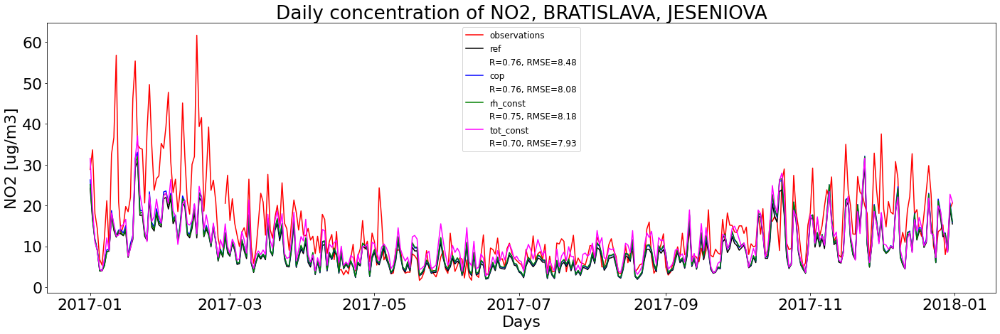

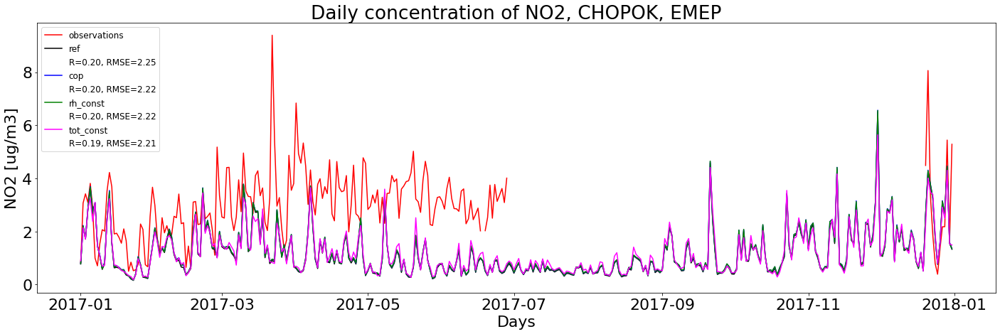

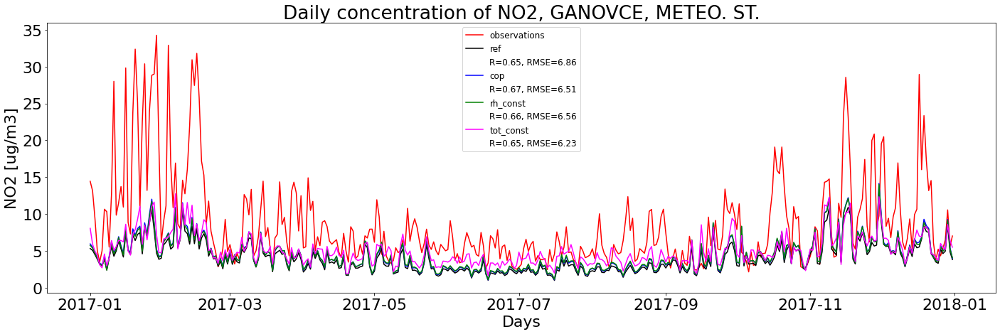

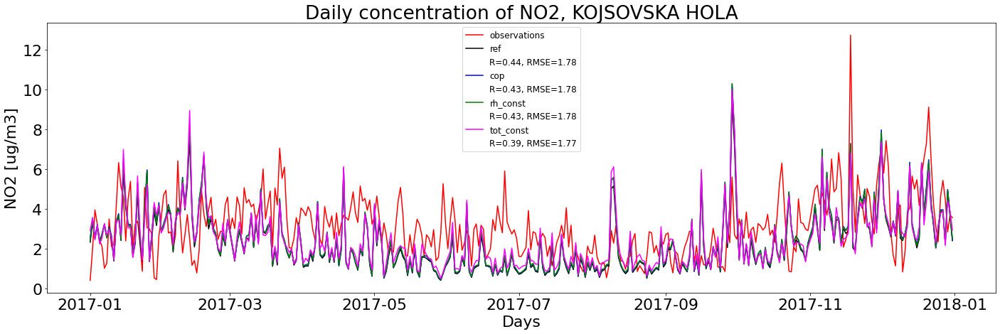

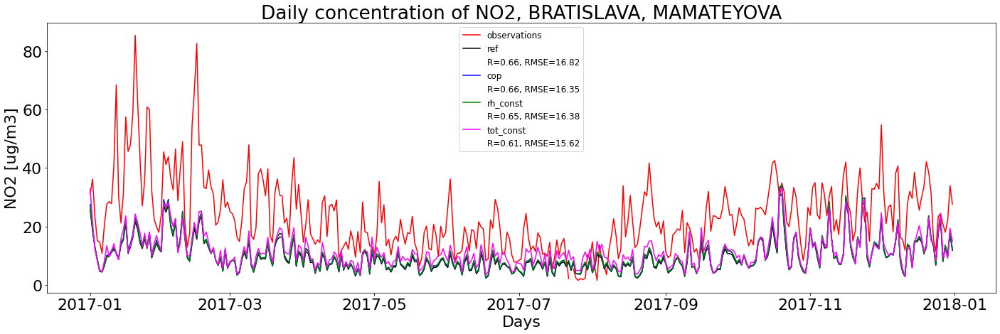

...

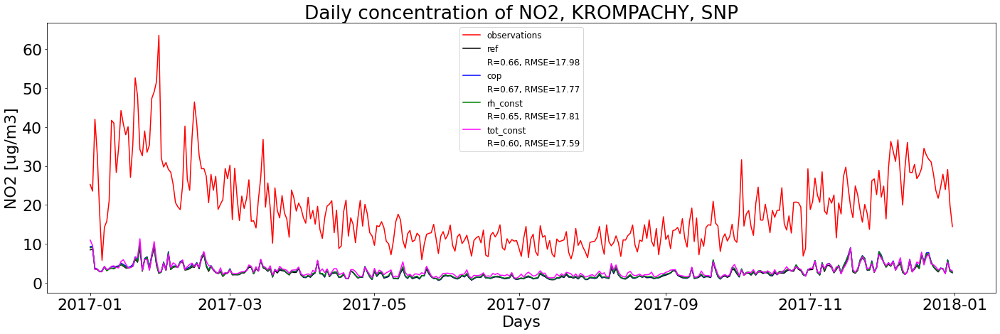

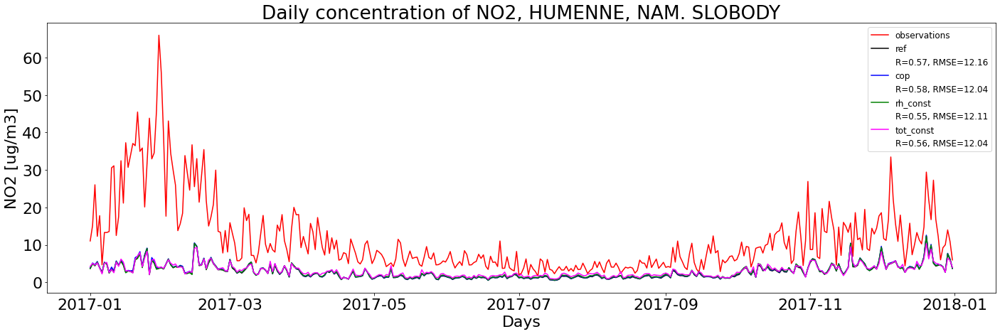

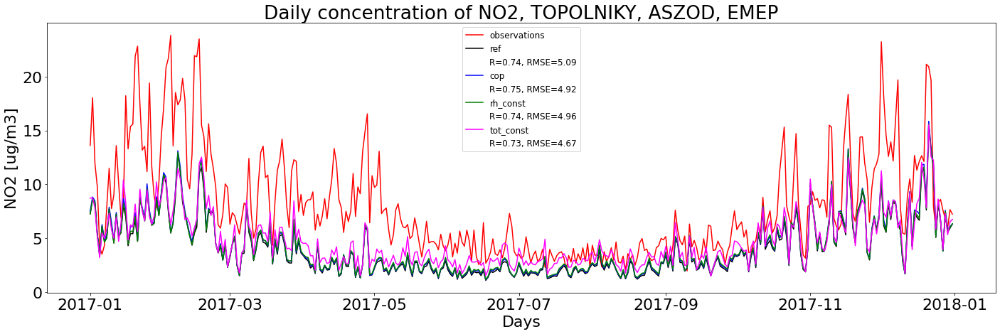

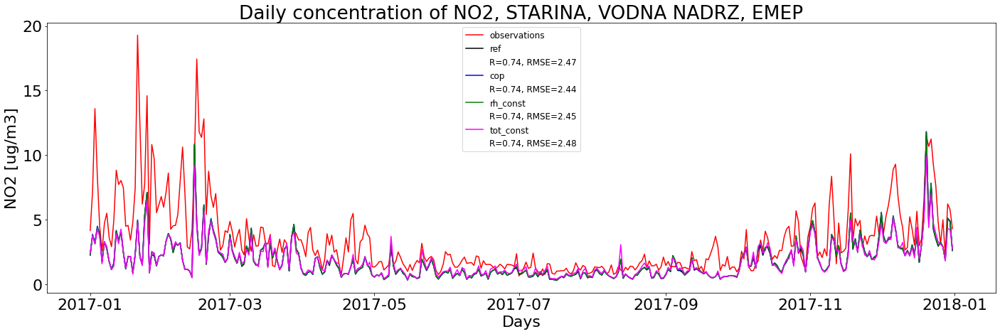

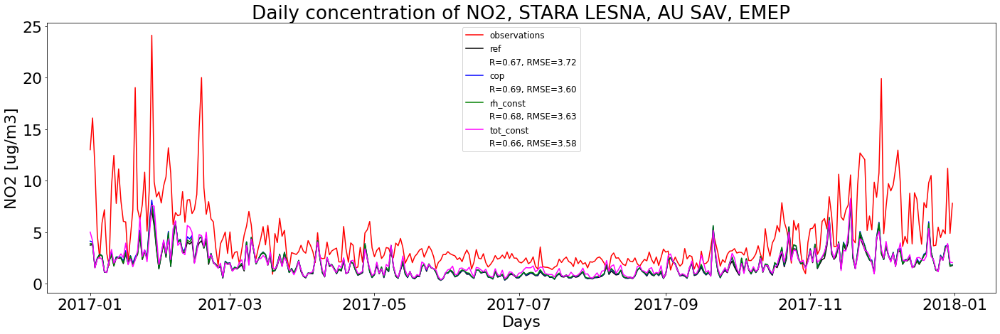

In [75]:
if save:
    print('Plots will be saved at:{}'.format(save_path))
for i in ID:
    obs_id = data[specific[0]]['OBS'].sel(station = i).to_series()[plot_from:plot_until]
    name_sta = stat[specific[0]].name.loc[stat[specific[0]].index == i].item()
    daily_obs = obs_id.groupby(pd.Grouper(freq='D')).mean()
    
    plt.rcParams['figure.figsize'] = 20,7
    plt.rcParams.update({'font.size': 22})
    plt.plot(daily_obs.index[:], daily_obs[:], color = obs_color, label = 'observations')                
    
    for s in specific:        
        mod_id = data[s]['MOD'].sel(station = i).to_series()[plot_from:plot_until]        
        daily_mod = mod_id.groupby(pd.Grouper(freq='D')).mean()

        stat_corr_daily = daily_mod.corr(daily_obs)
        stat_diff_daily = np.array((daily_mod - daily_obs).dropna())
        if len(stat_diff_daily) != 0:
            stat_rmse_daily = np.sqrt(np.sum(stat_diff_daily**2)/len(stat_diff_daily))
        else:
            stat_rmse_daily = np.nan

        plt.plot(daily_obs.index[:], daily_mod[:], color = color_list[s], label = '{}'.format(s))
        plt.plot([], [], ' ', label='R={:0.2f}, RMSE={:1.2f}'.format(stat_corr_daily,stat_rmse_daily))

    plt.legend(fontsize=12)                
    plt.title('Daily concentration of {0}, {1}'.format(v,name_sta))                               
    plt.xlabel('Days')
    plt.ylabel('{0} [{1}]'.format(v,units))
    plt.tight_layout()

    if save:
        if not os.path.exists(save_path):
            os.makedirs(save_path)
        plt.savefig('{0}/{1}_{2}_{3}_{4}_D{5}-{6}.png'.format(save_path,nick, start_date[0:4], v, i,plot_from,plot_until), dpi=300)                
    plt.show()                
    plt.close()   

## Priemerny rocny chod typy stanic

In [43]:
### USER INPUT
# Choose stations to plot
#moj_typ = 'T'
#moj_loc = 'U'
my_name = 'B'
#ID = list(stat_all.loc[stat_all['type'] == moj_typ].loc[stat_all['loc'] == moj_loc].loc[stat_all.coverage != 0].index.values)
ID = list(stat_all.loc[stat_all['type'] == my_name].loc[stat_all.coverage != 0].index.values)
#ID = [11813,11916]    # selected stations

my_season = 'year'

save =True   # save the plots?  

save_path = '{0}/validated/{1}/graphs/{2}'.format(vali_path, folder_name,v)

Plots will be saved at:/data/teri/validacia/validated/CMAQ2017d02_ref_vs_cop_vs_const/graphs/NO2


/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)


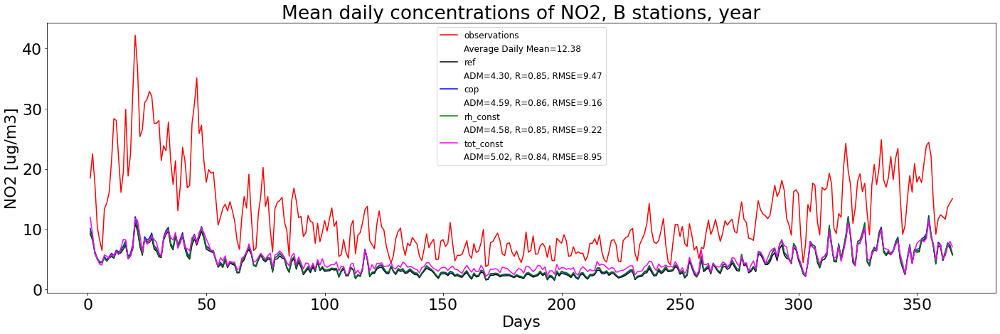

In [44]:
if save:
    print('Plots will be saved at:{}'.format(save_path))
#for i in ID:    
days_np = np.repeat(np.linspace(1,365,365),24)
new_data = data[specific[0]].assign_coords(time = days_np)    
obs_id = new_data['OBS'].sel(station = ID).groupby(new_data['OBS'].time).mean().mean(dim = 'station')
obs_mean = obs_id.mean()

plt.rcParams['figure.figsize'] = 20,7
plt.rcParams.update({'font.size': 22})

plt.plot(obs_id.time, obs_id[:], color =obs_color, label = 'observations') 
plt.plot([], [], ' ', label='Average Daily Mean={:0.2f}'.format(obs_mean.item()))

for s in specific:
    new_data = data[s].assign_coords(time = days_np)
    mod_id = new_data['MOD'].sel(station = ID).groupby(new_data['MOD'].time).mean().mean(dim = 'station')
    mod_mean = mod_id.mean()

    stat_corr = mod_id.to_series().corr(obs_id.to_series())
    stat_diff = np.array((mod_id - obs_id).to_series().dropna())
    if len(stat_diff) != 0:
        stat_rmse = np.sqrt(np.sum(stat_diff**2)/len(stat_diff))
    else:
        stat_rmse = np.nan

    plt.plot(obs_id.time, mod_id[:], color = color_list[s], label = '{}'.format(s))
    plt.plot([], [], ' ', label='ADM={:0.2f}, R={:1.2f}, RMSE={:1.2f}'.format(mod_mean.item(),stat_corr,stat_rmse))

plt.legend(fontsize=12)                
plt.title('Mean daily concentrations of {0}, {1} stations, {2}'.format(v, my_name, my_season))                               
plt.xlabel('Days')
plt.ylabel('{0} [{1}]'.format(v,units))
plt.tight_layout()

if save:
    if not os.path.exists(save_path):
        os.makedirs(save_path)
    plt.savefig('{0}/MA_{1}_{2}_{3}_{4}.png'.format(save_path,my_name, nick, v, my_season), dpi=300)                
plt.show()                
plt.close() 

## Rocne obdobia

In [14]:
### USER INPUT
# Choose stations to plot
ID = list(stat_all.loc[stat_all.coverage != 0].index.values)[1:]
#ID = [11813,11916]    # selected stations

save = True   # save the plots?  

save_path = '{0}/validated/{1}/graphs/{2}'.format(vali_path,folder_name,v)
save_path


'/data/teri/validacia/validated/CMAQ2017d02_ref_vs_cop_vs_const/graphs/NO2'

### Observations

In [79]:
if save:
    print('Plots will be saved at:{}'.format(save_path))
for i in ID:    
    
    obs_id_jar = data[specific[0]]['OBS'].sel(station = i, time = data[specific[0]].time.dt.month.isin(season_months['jar'])).groupby('time.hour').mean()
    obs_id_leto = data[specific[0]]['OBS'].sel(station = i, time = data[specific[0]].time.dt.month.isin(season_months['leto'])).groupby('time.hour').mean()
    obs_id_jesen = data[specific[0]]['OBS'].sel(station = i, time = data[specific[0]].time.dt.month.isin(season_months['jesen'])).groupby('time.hour').mean()
    obs_id_zima = data[specific[0]]['OBS'].sel(station = i, time = data[specific[0]].time.dt.month.isin(season_months['zima'])).groupby('time.hour').mean()
    
    name_sta = stat[specific[0]].name.loc[stat[specific[0]].index == i].item()
    
    plt.rcParams['figure.figsize'] = 20,7
    plt.rcParams.update({'font.size': 22})

    plt.plot(obs_id_jar.hour, obs_id_jar[:], color ='green', label = 'jar') 
    plt.plot(obs_id_leto.hour, obs_id_leto[:], color ='red', label = 'leto')
    plt.plot(obs_id_jesen.hour, obs_id_jesen[:], color ='orange', label = 'jesen') 
    plt.plot(obs_id_zima.hour, obs_id_zima[:], color ='blue', label = 'zima')

    plt.legend(fontsize=12)                
    plt.title('Mean hourly concentration of {0}, {1}'.format(v,name_sta))                               
    plt.xlabel('Hours')
    plt.ylabel('{0} [{1}]'.format(v,units))
    plt.tight_layout()

    if save:
        if not os.path.exists(save_path):
            os.makedirs(save_path)
        plt.savefig('{0}/MH_seasons_{1}_{2}.png'.format(save_path,v), dpi=300)                
    plt.show()                
    plt.close() 

Plots will be saved at:/data/teri/validacia/validated/CMAQ2017d02_ref_vs_cop_vs_const/graphs/NO2


KeyError: 'jar'

### Observations - station types

In [ ]:
if save:
    print('Plots will be saved at:{}'.format(save_path))
    
for t in all_types:
    if t in locs:
        col = 'loc'
    else:
        col = 'type'

    stanice_vyber = list(stat_all.loc[stat_all[col] == t].index)    

    obs_id_jar = data[specific[0]]['OBS'].sel(station = stanice_vyber, time = data[specific[0]].time.dt.month.isin(season_months['jar'])).groupby('time.hour').mean().mean(dim = 'station')
    obs_id_leto = data[specific[0]]['OBS'].sel(station = stanice_vyber, time = data[specific[0]].time.dt.month.isin(season_months['leto'])).groupby('time.hour').mean().mean(dim = 'station')
    obs_id_jesen = data[specific[0]]['OBS'].sel(station = stanice_vyber, time = data[specific[0]].time.dt.month.isin(season_months['jesen'])).groupby('time.hour').mean().mean(dim = 'station')
    obs_id_zima = data[specific[0]]['OBS'].sel(station = stanice_vyber, time = data[specific[0]].time.dt.month.isin(season_months['zima'])).groupby('time.hour').mean().mean(dim = 'station')
    
    #name_sta = stat[specific[0]].name.loc[stat[specific[0]].index == i].item()
    
    plt.rcParams['figure.figsize'] = 25,8
    plt.rcParams.update({'font.size': 22})

    plt.plot(obs_id_jar.hour, obs_id_jar[:], color ='green', label = 'jar') 
    plt.plot(obs_id_leto.hour, obs_id_leto[:], color ='red', label = 'leto')
    plt.plot(obs_id_jesen.hour, obs_id_jesen[:], color ='orange', label = 'jesen') 
    plt.plot(obs_id_zima.hour, obs_id_zima[:], color ='blue', label = 'zima')

    plt.legend(fontsize=12)                
    plt.title('Mean hourly concentration of {0}, {1}'.format(v,t))                               
    plt.xlabel('Hours')
    plt.ylabel('{0} [{1}]'.format(v,units))
    plt.tight_layout()

    if save:
        if not os.path.exists(save_path):
            os.makedirs(save_path)
        plt.savefig('{0}/{1}_{2}_{3}_{4}_MH{5}-{6}.png'.format(save_path,nick, start_date[0:4], v, i,plot_from,plot_until), dpi=300)                
    plt.show()                
    plt.close() 

In [ ]:
obs_id_jar

### Model

In [ ]:
spec_nick = 'tot_const'

if save:
    print('Plots will be saved at:{}'.format(save_path))
for i in ID:    
    
    mod_id_jar = data[spec_nick]['MOD'].sel(station = i, time = data[spec_nick].time.dt.month.isin(season_months['spring'])).groupby('time.hour').mean()
    mod_id_leto = data[spec_nick]['MOD'].sel(station = i, time = data[spec_nick].time.dt.month.isin(season_months['summer'])).groupby('time.hour').mean()
    mod_id_jesen = data[spec_nick]['MOD'].sel(station = i, time = data[spec_nick].time.dt.month.isin(season_months['autumn'])).groupby('time.hour').mean()
    mod_id_zima = data[spec_nick]['MOD'].sel(station = i, time = data[spec_nick].time.dt.month.isin(season_months['winter'])).groupby('time.hour').mean()
    
    obs_id_jar = data[specific[0]]['OBS'].sel(station = i, time = data[specific[0]].time.dt.month.isin(season_months['spring'])).groupby('time.hour').mean()
    obs_id_leto = data[specific[0]]['OBS'].sel(station = i, time = data[specific[0]].time.dt.month.isin(season_months['summer'])).groupby('time.hour').mean()
    obs_id_jesen = data[specific[0]]['OBS'].sel(station = i, time = data[specific[0]].time.dt.month.isin(season_months['autumn'])).groupby('time.hour').mean()
    obs_id_zima = data[specific[0]]['OBS'].sel(station = i, time = data[specific[0]].time.dt.month.isin(season_months['winter'])).groupby('time.hour').mean()
    
    r_jar = mod_id_jar.to_series().corr(obs_id_jar.to_series())
    r_leto = mod_id_leto.to_series().corr(obs_id_leto.to_series())
    r_jesen = mod_id_jesen.to_series().corr(obs_id_jesen.to_series())
    r_zima = mod_id_zima.to_series().corr(obs_id_zima.to_series())
    
    name_sta = stat[spec_nick].name.loc[stat[spec_nick].index == i].item()
    
    plt.rcParams['figure.figsize'] = 20,7
    plt.rcParams.update({'font.size': 22})

    plt.plot(mod_id_jar.hour, mod_id_jar[:], color ='green', linestyle='--', label = 'spring mod, R={:0.2f}'.format(r_jar)) 
    plt.plot(mod_id_leto.hour, mod_id_leto[:], color ='red', linestyle='--', label = 'summer mod, R={:0.2f}'.format(r_leto))
    plt.plot(mod_id_jesen.hour, mod_id_jesen[:], color ='darkorange', linestyle='--', label = 'autumn mod, R={:0.2f}'.format(r_jesen)) 
    plt.plot(mod_id_zima.hour, mod_id_zima[:], color ='blue', linestyle='--', label = 'winter mod, R={:0.2f}'.format(r_zima))
    
    plt.plot(obs_id_jar.hour, obs_id_jar[:], color ='green', label = 'spring obs') 
    plt.plot(obs_id_leto.hour, obs_id_leto[:], color ='red', label = 'summer obs')
    plt.plot(obs_id_jesen.hour, obs_id_jesen[:], color ='darkorange', label = 'autumn obs') 
    plt.plot(obs_id_zima.hour, obs_id_zima[:], color ='blue', label = 'winter obs')
    
    plt.legend(fontsize=12)                
    plt.title('Mean hourly concentration of {0}, {1}, {2}'.format(v,name_sta, spec_nick))                               
    plt.xlabel('Hours')
    plt.ylabel('{0} [{1}]'.format(v,units))
    plt.tight_layout()

    if save:
        if not os.path.exists(save_path):
            os.makedirs(save_path)
        plt.savefig('{0}/{1}_{2}_{3}_{4}_MH{5}-{6}.png'.format(save_path,nick, start_date[0:4], v, i,plot_from,plot_until), dpi=300)                
    plt.show()                
    plt.close() 

### Model - station types

Plots will be saved at:/data/teri/validacia/validated/CMAQ2017d02_ref_vs_cop_vs_const/graphs/NO2


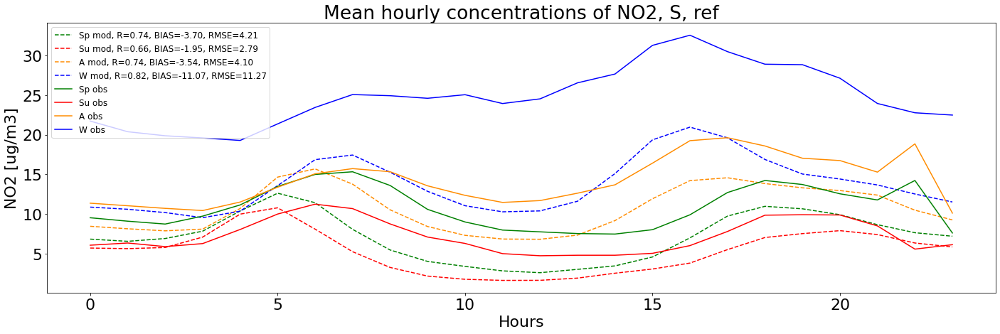

/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)


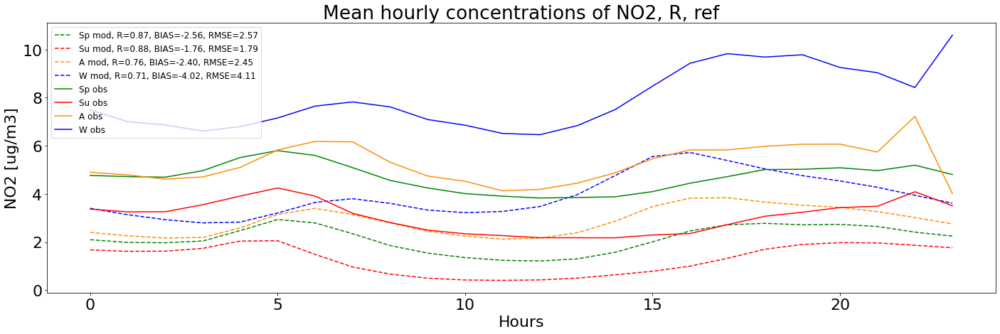

/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)


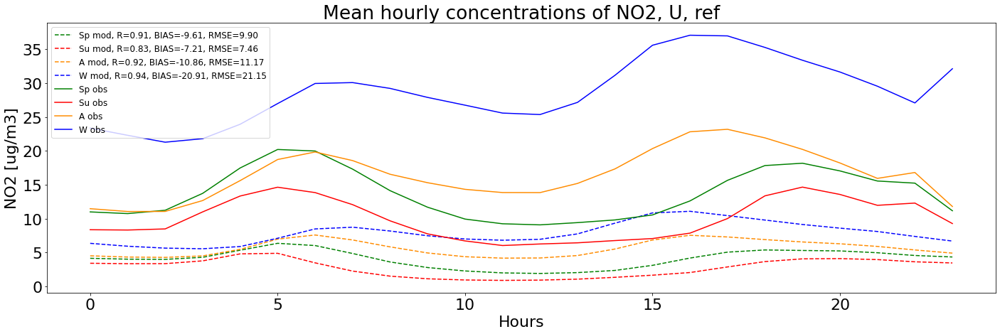

/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)


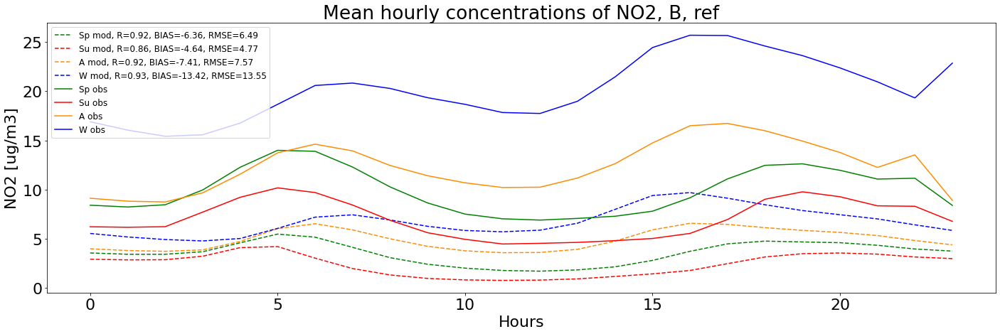

/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)
<ipython-input-15-843c41a8d2fd>:49: RuntimeWarning: invalid value encountered in double_scalars
  jar_rmse = np.sqrt(np.sum(jar_diff**2)/len(jar_diff))
<ipython-input-15-843c41a8d2fd>:50: RuntimeWarning: invalid value encountered in double_scalars
  leto_rmse = np.sqrt(np.sum(leto_diff**2)/len(leto_diff))
<ipython-input-15-843c41a8d2fd>:51: RuntimeWarning: invalid value encountered in double_scalars
  jesen_rmse = np.sqrt(np.sum(jesen_diff**2)/len(jesen_diff))
<ipython-input-15-843c41a8d2fd>:52: RuntimeWarning: invalid value encountered in double_scalars
  zima_rmse = np.sqrt(np.sum(zima_diff**2)/len(zima_diff))
<ipython-input-15-843c41a8d2fd>:54: RuntimeWarning: invalid value encountered in double_scalars
  jar_bias, leto_bias = np.sum(jar_diff)/len(jar_diff), np.sum(leto_diff)/len(leto_diff)
<ipython-input-15-843c

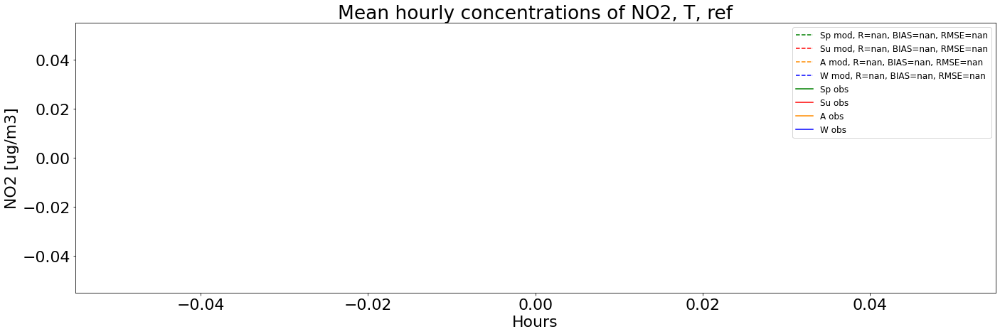

/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)
<ipython-input-15-843c41a8d2fd>:49: RuntimeWarning: invalid value encountered in double_scalars
  jar_rmse = np.sqrt(np.sum(jar_diff**2)/len(jar_diff))
<ipython-input-15-843c41a8d2fd>:50: RuntimeWarning: invalid value encountered in double_scalars
  leto_rmse = np.sqrt(np.sum(leto_diff**2)/len(leto_diff))
<ipython-input-15-843c41a8d2fd>:51: RuntimeWarning: invalid value encountered in double_scalars
  jesen_rmse = np.sqrt(np.sum(jesen_diff**2)/len(jesen_diff))
<ipython-input-15-843c41a8d2fd>:52: RuntimeWarning: invalid value encountered in double_scalars
  zima_rmse = np.sqrt(np.sum(zima_diff**2)/len(zima_diff))
<ipython-input-15-843c41a8d2fd>:54: RuntimeWarning: invalid value encountered in double_scalars
  jar_bias, leto_bias = np.sum(jar_diff)/len(jar_diff), np.sum(leto_diff)/len(leto_diff)
<ipython-input-15-843c

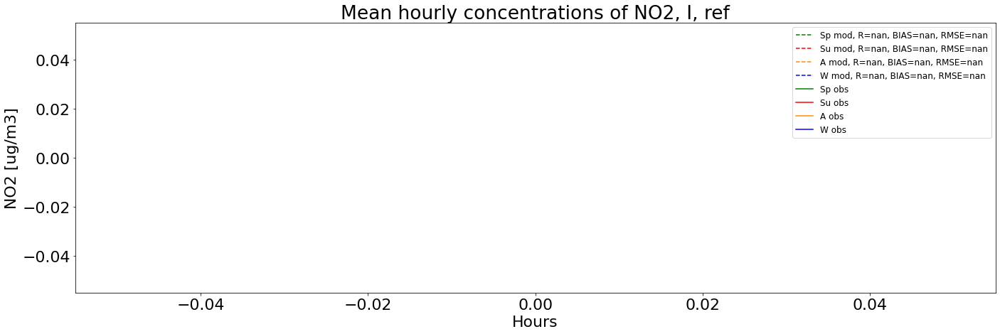

/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)


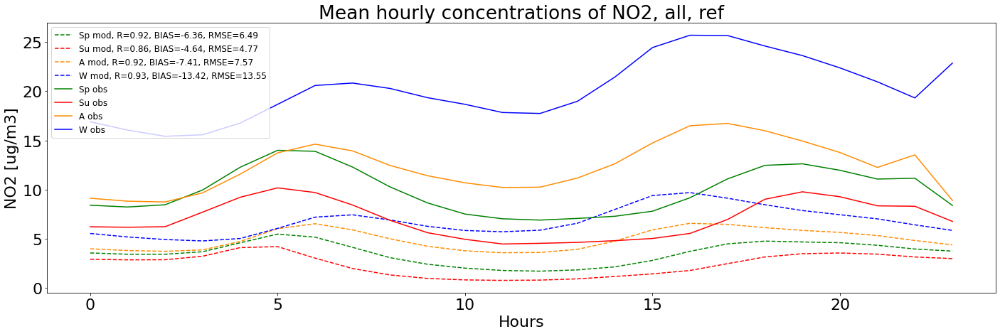

In [15]:
save = True
spec_nick = 'ref'
stat_types_new = ['RB', 'OB', 'UT']

if save:
    print('Plots will be saved at:{}'.format(save_path))
#for t in stat_types_new:
for t in all_types_all:
    #"""
    if t in locs:
        stanice_vyber = list(stat_all.loc[stat_all['loc'] == t].loc[stat_all['coverage'] != 0].index)
    elif t in types:
        stanice_vyber = list(stat_all.loc[stat_all['type'] == t].loc[stat_all['coverage'] != 0].index)
    else:
        stanice_vyber = list(stat_all.loc[stat_all['coverage'] != 0].index.values)[1:]  
    """
        
    if t == 'RB':
            #loc_, type_ = 'R', 'B'
            stanice_vyber = list(stat_all.loc[stat_all['type'] == 'B'].loc[stat_all['loc']=='R'].loc[stat_all['coverage'] != 0].index)
        
    if t == 'OB':
            stanice_vyber = list(stat_all.loc[stat_all['type'] == 'B'].loc[stat_all['loc']=='U'].loc[stat_all['coverage'] != 0].index) + list(stat_all.loc[stat_all['type'] == 'B'].loc[stat_all['loc']=='S'].loc[stat_all['coverage'] != 0].index)
             
    if t == 'UT':
            stanice_vyber = list(stat_all.loc[stat_all['type'] == 'T'].loc[stat_all['loc']=='U'].loc[stat_all['coverage'] != 0].index)
    #"""

    mod_id_jar = data[spec_nick]['MOD'].sel(station = stanice_vyber, time = data[spec_nick].time.dt.month.isin(season_months['spring'])).groupby('time.hour').mean().mean(dim = 'station')
    mod_id_leto = data[spec_nick]['MOD'].sel(station = stanice_vyber, time = data[spec_nick].time.dt.month.isin(season_months['summer'])).groupby('time.hour').mean().mean(dim = 'station')
    mod_id_jesen = data[spec_nick]['MOD'].sel(station = stanice_vyber, time = data[spec_nick].time.dt.month.isin(season_months['autumn'])).groupby('time.hour').mean().mean(dim = 'station')
    mod_id_zima = data[spec_nick]['MOD'].sel(station = stanice_vyber, time = data[spec_nick].time.dt.month.isin(season_months['winter'])).groupby('time.hour').mean().mean(dim = 'station')
    
    obs_id_jar = data[specific[0]]['OBS'].sel(station = stanice_vyber, time = data[specific[0]].time.dt.month.isin(season_months['spring'])).groupby('time.hour').mean().mean(dim = 'station')
    obs_id_leto = data[specific[0]]['OBS'].sel(station = stanice_vyber, time = data[specific[0]].time.dt.month.isin(season_months['summer'])).groupby('time.hour').mean().mean(dim = 'station')
    obs_id_jesen = data[specific[0]]['OBS'].sel(station = stanice_vyber, time = data[specific[0]].time.dt.month.isin(season_months['autumn'])).groupby('time.hour').mean().mean(dim = 'station')
    obs_id_zima = data[specific[0]]['OBS'].sel(station = stanice_vyber, time = data[specific[0]].time.dt.month.isin(season_months['winter'])).groupby('time.hour').mean().mean(dim = 'station')
    
    r_jar = mod_id_jar.to_series().corr(obs_id_jar.to_series())
    r_leto = mod_id_leto.to_series().corr(obs_id_leto.to_series())
    r_jesen = mod_id_jesen.to_series().corr(obs_id_jesen.to_series())
    r_zima = mod_id_zima.to_series().corr(obs_id_zima.to_series())
    
    jar_diff = np.array((mod_id_jar - obs_id_jar).to_series().dropna())
    leto_diff = np.array((mod_id_leto - obs_id_leto).to_series().dropna())
    jesen_diff = np.array((mod_id_jesen - obs_id_jesen).to_series().dropna())
    zima_diff = np.array((mod_id_zima - obs_id_zima).to_series().dropna())
    #if len(jar_diff) != 0:
    jar_rmse = np.sqrt(np.sum(jar_diff**2)/len(jar_diff))
    leto_rmse = np.sqrt(np.sum(leto_diff**2)/len(leto_diff))
    jesen_rmse = np.sqrt(np.sum(jesen_diff**2)/len(jesen_diff))
    zima_rmse = np.sqrt(np.sum(zima_diff**2)/len(zima_diff))
    
    jar_bias, leto_bias = np.sum(jar_diff)/len(jar_diff), np.sum(leto_diff)/len(leto_diff)
    jesen_bias, zima_bias = np.sum(jesen_diff)/len(jesen_diff), np.sum(zima_diff)/len(zima_diff)
    #else:
    #    stat_rmse = np.nan
    
    #name_sta = stat[spec_nick].name.loc[stat[spec_nick].index == i].item()
    
    plt.rcParams['figure.figsize'] = 20,7
    plt.rcParams.update({'font.size': 22})

    plt.plot(mod_id_jar.hour, mod_id_jar[:], color ='green', linestyle='--', label = 'Sp mod, R={:0.2f}, BIAS={:0.2f}, RMSE={:0.2f}'.format(r_jar, jar_bias, jar_rmse)) 
    plt.plot(mod_id_leto.hour, mod_id_leto[:], color ='red', linestyle='--', label = 'Su mod, R={:0.2f}, BIAS={:0.2f}, RMSE={:0.2f}'.format(r_leto, leto_bias, leto_rmse))
    plt.plot(mod_id_jesen.hour, mod_id_jesen[:], color ='darkorange', linestyle='--', label = 'A mod, R={:0.2f}, BIAS={:0.2f}, RMSE={:0.2f}'.format(r_jesen, jesen_bias, jesen_rmse)) 
    plt.plot(mod_id_zima.hour, mod_id_zima[:], color ='blue', linestyle='--', label = 'W mod, R={:0.2f}, BIAS={:0.2f}, RMSE={:0.2f}'.format(r_zima, zima_bias, zima_rmse))
    
    plt.plot(obs_id_jar.hour, obs_id_jar[:], color ='green', label = 'Sp obs') 
    plt.plot(obs_id_leto.hour, obs_id_leto[:], color ='red', label = 'Su obs')
    plt.plot(obs_id_jesen.hour, obs_id_jesen[:], color ='darkorange', label = 'A obs') 
    plt.plot(obs_id_zima.hour, obs_id_zima[:], color ='blue', label = 'W obs')
    
    plt.legend(fontsize=12)                
    plt.title('Mean hourly concentrations of {0}, {1}, {2}'.format(v,t,spec_nick))                               
    plt.xlabel('Hours')
    plt.ylabel('{0} [{1}]'.format(v,units))
    plt.tight_layout()

    if save:
        if not os.path.exists(save_path):
            os.makedirs(save_path)
        plt.savefig('{0}/MH_seasons_{1}_{2}_{3}_stat.png'.format(save_path,v,spec_nick,t), dpi=300) 
    plt.show()                
    plt.close() 

### Normovane Model - station types

Plots will be saved at:/data/teri/validacia/validated/CMAQ2017d02_ref_vs_cop_vs_const/graphs/NO2


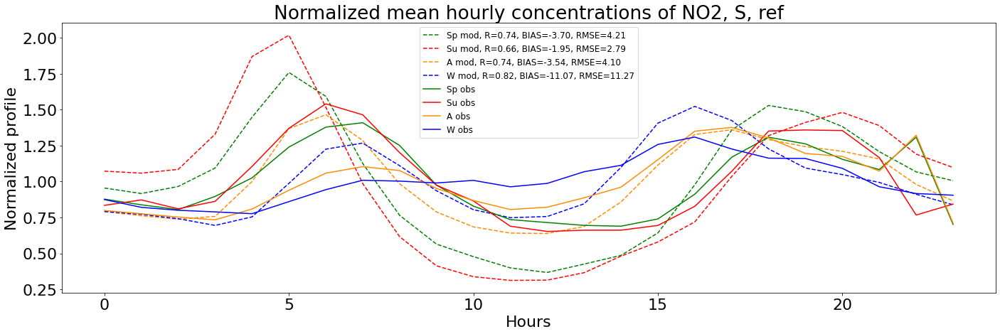

/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)


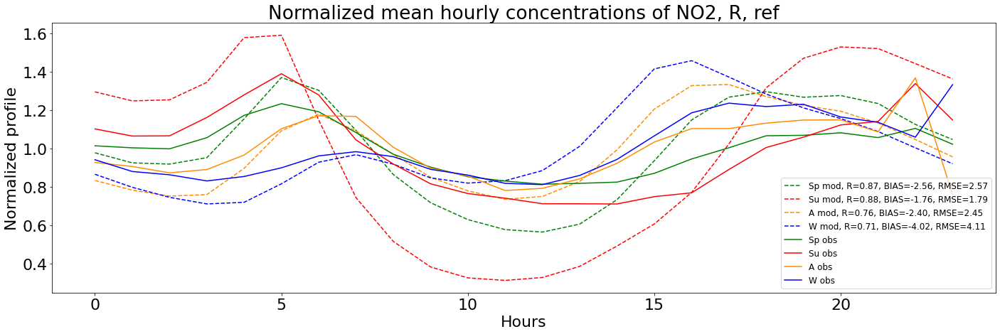

/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)


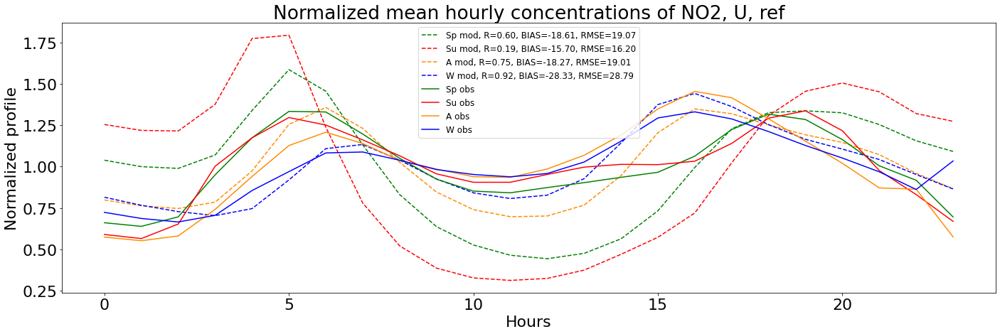

/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)


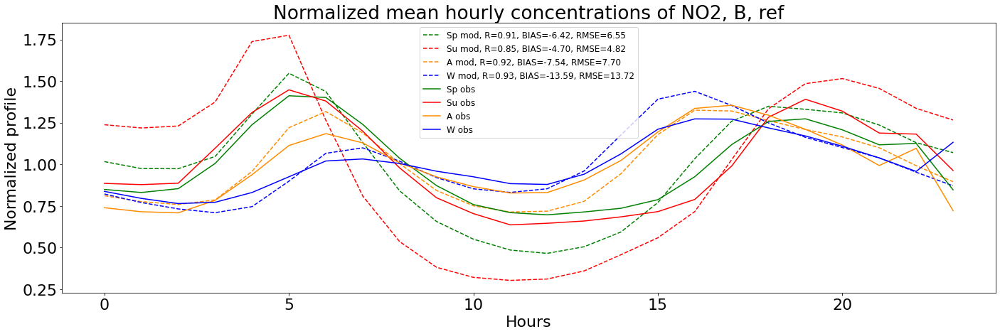

/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)


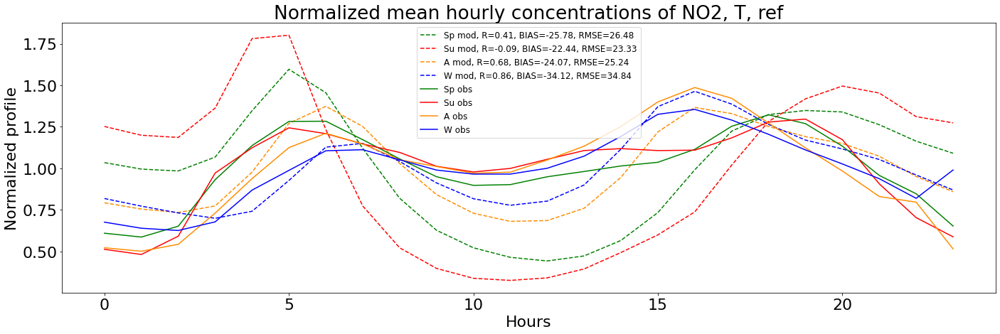

/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)
<ipython-input-23-4e454cc78317>:53: RuntimeWarning: invalid value encountered in double_scalars
  jar_rmse = np.sqrt(np.sum(jar_diff**2)/len(jar_diff))
<ipython-input-23-4e454cc78317>:54: RuntimeWarning: invalid value encountered in double_scalars
  leto_rmse = np.sqrt(np.sum(leto_diff**2)/len(leto_diff))
<ipython-input-23-4e454cc78317>:55: RuntimeWarning: invalid value encountered in double_scalars
  jesen_rmse = np.sqrt(np.sum(jesen_diff**2)/len(jesen_diff))
<ipython-input-23-4e454cc78317>:56: RuntimeWarning: invalid value encountered in double_scalars
  zima_rmse = np.sqrt(np.sum(zima_diff**2)/len(zima_diff))
<ipython-input-23-4e454cc78317>:58: RuntimeWarning: invalid value encountered in double_scalars
  jar_bias, leto_bias = np.sum(jar_diff)/len(jar_diff), np.sum(leto_diff)/len(leto_diff)
<ipython-input-23-4e45

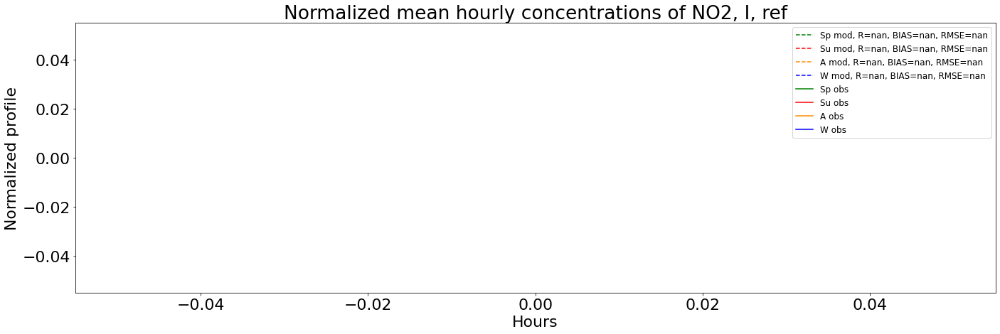

/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)


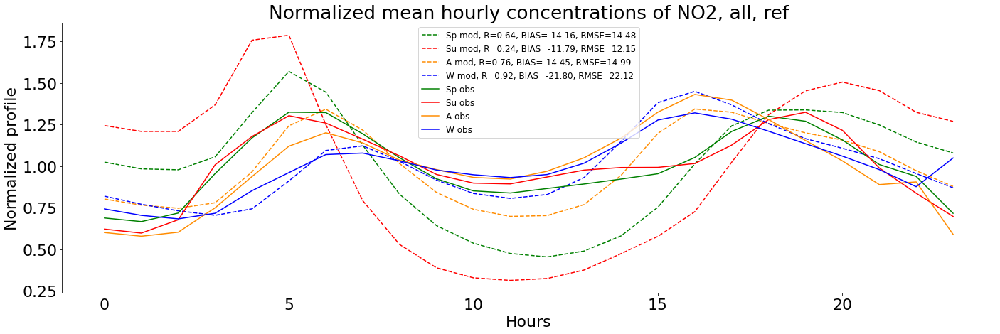

In [23]:
save = True
spec_nick = 'ref'
stat_types_new = ['RB', 'OB', 'UT']

if save:
    print('Plots will be saved at:{}'.format(save_path))
#for t in stat_types_new:
for t in all_types_all:
    #"""
    if t in locs:
        stanice_vyber = list(stat_all.loc[stat_all['loc'] == t].loc[stat_all['coverage'] != 0].index)
    elif t in types:
        stanice_vyber = list(stat_all.loc[stat_all['type'] == t].loc[stat_all['coverage'] != 0].index)
    else:
        stanice_vyber = list(stat_all.loc[stat_all['coverage'] != 0].index.values)[1:]  
    """
        
    if t == 'RB':
            #loc_, type_ = 'R', 'B'
            stanice_vyber = list(stat_all.loc[stat_all['type'] == 'B'].loc[stat_all['loc']=='R'].loc[stat_all['coverage'] != 0].index)
        
    if t == 'OB':
            stanice_vyber = list(stat_all.loc[stat_all['type'] == 'B'].loc[stat_all['loc']=='U'].loc[stat_all['coverage'] != 0].index) + list(stat_all.loc[stat_all['type'] == 'B'].loc[stat_all['loc']=='S'].loc[stat_all['coverage'] != 0].index)
             
    if t == 'UT':
            stanice_vyber = list(stat_all.loc[stat_all['type'] == 'T'].loc[stat_all['loc']=='U'].loc[stat_all['coverage'] != 0].index)
    #"""

    mod_id_jar = data[spec_nick]['MOD'].sel(station = stanice_vyber, time = data[spec_nick].time.dt.month.isin(season_months['spring'])).groupby('time.hour').mean().mean(dim = 'station')
    mod_id_leto = data[spec_nick]['MOD'].sel(station = stanice_vyber, time = data[spec_nick].time.dt.month.isin(season_months['summer'])).groupby('time.hour').mean().mean(dim = 'station')
    mod_id_jar_norm, mod_id_leto_norm = 24*mod_id_jar/mod_id_jar.sum(), 24*mod_id_leto/mod_id_leto.sum()
    mod_id_jesen = data[spec_nick]['MOD'].sel(station = stanice_vyber, time = data[spec_nick].time.dt.month.isin(season_months['autumn'])).groupby('time.hour').mean().mean(dim = 'station')
    mod_id_zima = data[spec_nick]['MOD'].sel(station = stanice_vyber, time = data[spec_nick].time.dt.month.isin(season_months['winter'])).groupby('time.hour').mean().mean(dim = 'station')
    mod_id_jesen_norm, mod_id_zima_norm = 24*mod_id_jesen/mod_id_jesen.sum(), 24*mod_id_zima/mod_id_zima.sum()
    
    obs_id_jar = data[specific[0]]['OBS'].sel(station = stanice_vyber, time = data[specific[0]].time.dt.month.isin(season_months['spring'])).groupby('time.hour').mean().mean(dim = 'station')
    obs_id_leto = data[specific[0]]['OBS'].sel(station = stanice_vyber, time = data[specific[0]].time.dt.month.isin(season_months['summer'])).groupby('time.hour').mean().mean(dim = 'station')
    obs_id_jar_norm, obs_id_leto_norm = 24*obs_id_jar/obs_id_jar.sum(), 24*obs_id_leto/obs_id_leto.sum()
    obs_id_jesen = data[specific[0]]['OBS'].sel(station = stanice_vyber, time = data[specific[0]].time.dt.month.isin(season_months['autumn'])).groupby('time.hour').mean().mean(dim = 'station')
    obs_id_zima = data[specific[0]]['OBS'].sel(station = stanice_vyber, time = data[specific[0]].time.dt.month.isin(season_months['winter'])).groupby('time.hour').mean().mean(dim = 'station')
    obs_id_jesen_norm, obs_id_zima_norm = 24*obs_id_jesen/obs_id_jesen.sum(), 24*obs_id_zima/obs_id_zima.sum()
    
    r_jar = mod_id_jar.to_series().corr(obs_id_jar.to_series())
    r_leto = mod_id_leto.to_series().corr(obs_id_leto.to_series())
    r_jesen = mod_id_jesen.to_series().corr(obs_id_jesen.to_series())
    r_zima = mod_id_zima.to_series().corr(obs_id_zima.to_series())
    
    jar_diff = np.array((mod_id_jar - obs_id_jar).to_series().dropna())
    leto_diff = np.array((mod_id_leto - obs_id_leto).to_series().dropna())
    jesen_diff = np.array((mod_id_jesen - obs_id_jesen).to_series().dropna())
    zima_diff = np.array((mod_id_zima - obs_id_zima).to_series().dropna())
    #if len(jar_diff) != 0:
    jar_rmse = np.sqrt(np.sum(jar_diff**2)/len(jar_diff))
    leto_rmse = np.sqrt(np.sum(leto_diff**2)/len(leto_diff))
    jesen_rmse = np.sqrt(np.sum(jesen_diff**2)/len(jesen_diff))
    zima_rmse = np.sqrt(np.sum(zima_diff**2)/len(zima_diff))
    
    jar_bias, leto_bias = np.sum(jar_diff)/len(jar_diff), np.sum(leto_diff)/len(leto_diff)
    jesen_bias, zima_bias = np.sum(jesen_diff)/len(jesen_diff), np.sum(zima_diff)/len(zima_diff)
    
    #name_sta = stat[spec_nick].name.loc[stat[spec_nick].index == i].item()
    
    plt.rcParams['figure.figsize'] = 20,7
    plt.rcParams.update({'font.size': 22})

    plt.plot(mod_id_jar.hour, mod_id_jar_norm[:], color ='green', linestyle='--', label = 'Sp mod, R={:0.2f}, BIAS={:0.2f}, RMSE={:0.2f}'.format(r_jar, jar_bias, jar_rmse)) 
    plt.plot(mod_id_leto.hour, mod_id_leto_norm[:], color ='red', linestyle='--', label = 'Su mod, R={:0.2f}, BIAS={:0.2f}, RMSE={:0.2f}'.format(r_leto, leto_bias, leto_rmse))
    plt.plot(mod_id_jesen.hour, mod_id_jesen_norm[:], color ='darkorange', linestyle='--', label = 'A mod, R={:0.2f}, BIAS={:0.2f}, RMSE={:0.2f}'.format(r_jesen, jesen_bias, jesen_rmse)) 
    plt.plot(mod_id_zima.hour, mod_id_zima_norm[:], color ='blue', linestyle='--', label = 'W mod, R={:0.2f}, BIAS={:0.2f}, RMSE={:0.2f}'.format(r_zima, zima_bias, zima_rmse))
    
    plt.plot(obs_id_jar.hour, obs_id_jar_norm[:], color ='green', label = 'Sp obs') 
    plt.plot(obs_id_leto.hour, obs_id_leto_norm[:], color ='red', label = 'Su obs')
    plt.plot(obs_id_jesen.hour, obs_id_jesen_norm[:], color ='darkorange', label = 'A obs') 
    plt.plot(obs_id_zima.hour, obs_id_zima_norm[:], color ='blue', label = 'W obs')
    
    plt.legend(fontsize=12)                
    plt.title('Normalized mean hourly concentrations of {0}, {1}, {2}'.format(v,t,spec_nick))                               
    plt.xlabel('Hours')
    plt.ylabel('Normalized profile')
    plt.tight_layout()

    if save:
        if not os.path.exists(save_path):
            os.makedirs(save_path)
        plt.savefig('{0}/MH_norm_seasons_{1}_{2}_{3}.png'.format(save_path,v,spec_nick,t), dpi=300) 
    plt.show()                
    plt.close() 

## Mesiace

In [ ]:
### USER INPUT
# Choose stations to plot
ID = list(stat_all.loc[stat_all.coverage != 0].index.values)[1:]
#ID = [11813,11916]    # selected stations
save = False   # save the plots?  
save_path = '{0}/validated/{1}_{2}/graphs/{3}'.format(vali_path, nick, start_date[0:4],v)

In [ ]:
if save:
    print('Plots will be saved at:{}'.format(save_path))
mesiace = ['jan','feb','mar','apr','may','jun','jul','aug','sep','okt','nov','dec']
colors2 = ['dodgerblue','blue','greenyellow','limegreen','green','gold','orange','orangered','lightcoral','brown','maroon','turquoise']
color_list2 = {}
for i, m in enumerate(mesiace):
    color_list2[m] = colors2[i]

for i in ID:    
    name_sta = stat[specific[0]].name.loc[stat[specific[0]].index == i].item()
    
    plt.rcParams['figure.figsize'] = 20,7
    plt.rcParams.update({'font.size': 22})
    
    for m in mesiace:
        obs_id = data[specific[0]]['OBS'].sel(station = i, time = data[specific[0]].time.dt.month.isin(season_months[m])).groupby('time.hour').mean()   
        plt.plot(obs_id.hour, obs_id[:], label = m, color = color_list2[m]) 

    plt.legend(fontsize=12)                
    plt.title('Mean hourly concentration of {0}, {1}'.format(v,name_sta))                               
    plt.xlabel('Hours')
    plt.ylabel('{0} [{1}]'.format(v,units))
    plt.tight_layout()

    if save:
        if not os.path.exists(save_path):
            os.makedirs(save_path)
        plt.savefig('{0}/{1}_{2}_{3}_{4}_MH{5}-{6}.png'.format(save_path,nick, start_date[0:4], v, i,plot_from,plot_until), dpi=300)                
    plt.show()                
    plt.close() 

## Zimny vs letny cas

In [ ]:
### USER INPUT
# Choose stations to plot
ID = list(stat_all.loc[stat_all.coverage != 0].index.values)[1:]
#ID = [11813,11916]    # selected stations

letny = 'apr'
zimny = 'mar'
spec_nick = 'orig'

save = False   # save the plots?  

save_path = '{0}/validated/{1}_{2}/graphs/{3}'.format(vali_path, nick, start_date[0:4],v)

In [ ]:
if save:
    print('Plots will be saved at:{}'.format(save_path))
for i in ID:    
    
    obs_id_leto = data[specific[0]]['OBS'].sel(station = i, time = data[specific[0]].time.dt.month.isin(season_months[letny])).groupby('time.hour').mean()
    obs_id_zima = data[specific[0]]['OBS'].sel(station = i, time = data[specific[0]].time.dt.month.isin(season_months[zimny])).groupby('time.hour').mean()
    
    mod_id_leto = data[spec_nick]['MOD'].sel(station = i, time = data[spec_nick].time.dt.month.isin(season_months[letny])).groupby('time.hour').mean()
    mod_id_zima = data[spec_nick]['MOD'].sel(station = i, time = data[spec_nick].time.dt.month.isin(season_months[zimny])).groupby('time.hour').mean()
    
    r_leto = mod_id_leto.to_series().corr(obs_id_leto.to_series())
    r_zima = mod_id_zima.to_series().corr(obs_id_zima.to_series())
    
    name_sta = stat[specific[0]].name.loc[stat[specific[0]].index == i].item()
    
    plt.rcParams['figure.figsize'] = 20,7
    plt.rcParams.update({'font.size': 22})

    plt.plot(obs_id_leto.hour, obs_id_leto[:], color ='salmon', label = 'letny cas') 
    plt.plot(obs_id_zima.hour, obs_id_zima[:], color ='dodgerblue', label = 'zimny cas')
    
    plt.plot(mod_id_leto.hour, mod_id_leto[:], color ='red', label = 'leto mod, R={:0.2f}'.format(r_leto))
    plt.plot(mod_id_zima.hour, mod_id_zima[:], color ='blue', label = 'zima mod, R={:0.2f}'.format(r_zima))

    plt.legend(fontsize=12)                
    plt.title('Mean hourly concentration of {0}, {1}'.format(v,name_sta))                               
    plt.xlabel('Hours')
    plt.ylabel('{0} [{1}]'.format(v,units))
    plt.tight_layout()

    if save:
        if not os.path.exists(save_path):
            os.makedirs(save_path)
        plt.savefig('{0}/{1}_{2}_{3}_{4}_MH{5}-{6}.png'.format(save_path,nick, start_date[0:4], v, i,plot_from,plot_until), dpi=300)                
    plt.show()                
    plt.close() 

In [ ]:
#TYPES
if save:
    print('Plots will be saved at:{}'.format(save_path))
for t in all_types:
    if t in locs:
        col = 'loc'
    else:
        col = 'type'    

    stanice_vyber = list(stat_all.loc[stat_all[col] == t].index)
    obs_id_leto = data[specific[0]]['OBS'].sel(station = stanice_vyber, time = data[specific[0]].time.dt.month.isin(season_months[letny])).groupby('time.hour').mean().mean(dim = 'station')
    obs_id_zima = data[specific[0]]['OBS'].sel(station = stanice_vyber, time = data[specific[0]].time.dt.month.isin(season_months[zimny])).groupby('time.hour').mean().mean(dim = 'station')
    
    mod_id_leto = data[spec_nick]['MOD'].sel(station = stanice_vyber, time = data[spec_nick].time.dt.month.isin(season_months[letny])).groupby('time.hour').mean().mean(dim = 'station')
    mod_id_zima = data[spec_nick]['MOD'].sel(station = stanice_vyber, time = data[spec_nick].time.dt.month.isin(season_months[zimny])).groupby('time.hour').mean().mean(dim = 'station')
    
    r_leto = mod_id_leto.to_series().corr(obs_id_leto.to_series())
    r_zima = mod_id_zima.to_series().corr(obs_id_zima.to_series())
    
    name_sta = stat[specific[0]].name.loc[stat[specific[0]].index == i].item()
    
    plt.rcParams['figure.figsize'] = 20,7
    plt.rcParams.update({'font.size': 22})

    plt.plot(obs_id_leto.hour, obs_id_leto[:], color ='salmon', label = 'letny cas') 
    plt.plot(obs_id_zima.hour, obs_id_zima[:], color ='dodgerblue', label = 'zimny cas')
    
    plt.plot(mod_id_leto.hour, mod_id_leto[:], color ='red', label = 'leto mod, R={:0.2f}'.format(r_leto))
    plt.plot(mod_id_zima.hour, mod_id_zima[:], color ='blue', label = 'zima mod, R={:0.2f}'.format(r_zima))

    plt.legend(fontsize=12)                
    plt.title('Mean hourly concentration of {0}, {1}'.format(v,t))                               
    plt.xlabel('Hours')
    plt.ylabel('{0} [{1}]'.format(v,units))
    plt.tight_layout()

    if save:
        if not os.path.exists(save_path):
            os.makedirs(save_path)
        plt.savefig('{0}/{1}_{2}_{3}_{4}_MH{5}-{6}.png'.format(save_path,nick, start_date[0:4], v, i,plot_from,plot_until), dpi=300)                
    plt.show()                
    plt.close() 

## Sezonalita 

### Vsetky stanice

In [24]:
save_path = '/data/teri/validacia/validated/{0}/graphs/{1}'.format(folder_name, v)
#ID = list(stat_all.index.values)[:]
ID = list(stat_all.index.values)
fzl = stat[specific[0]][['name','loc','type','coverage']].copy()
zl = stat[specific[0]][['name','loc','type','coverage']].copy()

for i in ID:
    #print(i)
    if i == 'all':
        zima = data['ref']['OBS'].sel(time = data[specific[0]].time.dt.month.isin(season_months['winter'])).mean()
        leto = data['ref']['OBS'].sel(time = data[specific[0]].time.dt.month.isin(season_months['summer'])).mean()
        obs_mean = data['ref']['OBS'].sel(time = data[specific[0]].time.dt.month.isin(season_months['year'])).mean()
    else:
        zima = data['ref']['OBS'].sel(station = i, time = data[specific[0]].time.dt.month.isin(season_months['winter'])).mean()
        leto = data['ref']['OBS'].sel(station = i, time = data[specific[0]].time.dt.month.isin(season_months['summer'])).mean()
        obs_mean = data['ref']['OBS'].sel(station = i, time = data[specific[0]].time.dt.month.isin(season_months['year'])).mean()
    
    fzl.at[i, 'fzl_obs'] = zima/leto
    zl.at[i, 'zl_obs'] = (zima - leto)/obs_mean

    for s in specific:
        if i == 'all':
            zima = data[s]['MOD'].sel(time = data[specific[0]].time.dt.month.isin(season_months['winter'])).mean()
            leto = data[s]['MOD'].sel(time = data[specific[0]].time.dt.month.isin(season_months['summer'])).mean()
            mod_mean = data[s]['MOD'].sel(time = data[specific[0]].time.dt.month.isin(season_months['year'])).mean()
        else:
            zima = data[s]['MOD'].sel(station = i, time = data[s].time.dt.month.isin(season_months['winter'])).mean()
            leto = data[s]['MOD'].sel(station = i, time = data[s].time.dt.month.isin(season_months['summer'])).mean()
            mod_mean = data[s]['MOD'].sel(station = i, time = data[s].time.dt.month.isin(season_months['year'])).mean()
        
        if zima != np.nan and leto != np.nan:
            fzl.at[i, 'fzl_{0}'.format(s)] = zima/leto
            zl.at[i, 'zl_{0}'.format(s)] = (zima - leto)/mod_mean
        else:
            fzl.at[i, 'fzl_{0}'.format(s)] = np.nan
            zl.at[i, 'zl_{0}'.format(s)] = np.nan

fzl

/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)
/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)
/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)
/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)
/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)
/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return 

,name,loc,type,coverage,fzl_obs,fzl_ref,fzl_cop,fzl_rh_const,fzl_tot_const
all,all,all,all,94.0813,1.970908,2.802649,2.760305,2.615574,2.114373
11813,"BRATISLAVA, JESENIOVA",S,B,94.0982,3.375378,2.569855,2.515637,2.399293,1.937843
11916,"CHOPOK, EMEP",R,B,50.6735,0.758246,2.605198,2.564316,2.512976,2.210631
11952,"GANOVCE, METEO. ST.",R,B,95.8333,2.533596,2.395468,2.342771,2.214179,1.738220
11958,KOJSOVSKA HOLA,R,B,96.7009,1.574554,2.665263,2.632023,2.558656,2.224852
99111,"BRATISLAVA, MAMATEYOVA",U,B,95.1826,2.103167,2.147870,2.114153,2.056090,1.660880
99112,"BRATISLAVA, TRNAVSKE MYTO",U,T,90.7877,1.155760,2.569855,2.515637,2.399293,1.937843
99114,"BRATISLAVA, KAMENNE NAM.",U,B,0,NaN,2.569855,2.515637,2.399293,1.937843
99117,BRATISLAVA - RACA,None,None,0,NaN,2.760106,2.695305,2.591569,2.145198
99122,"SENICA, HVIEZDOSLAVOVA",U,T,0,NaN,3.834957,3.783678,3.625127,2.853854


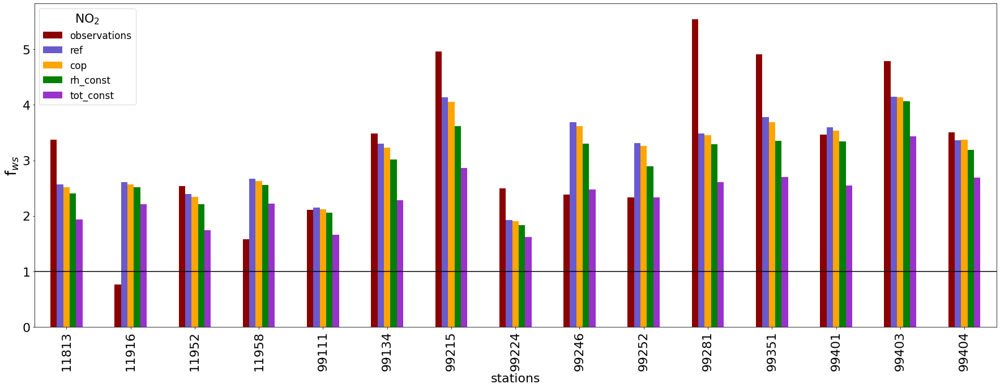

In [25]:
station_list = list(stat_all.loc[stat_all['type'] == 'B'].loc[stat_all.coverage != 0].index.values)

plt.rcParams['figure.figsize'] = 25,10
plt.rcParams.update({'font.size': 22})
# VYBER STANIC Z LISTU
fzl.loc[station_list,list(fzl.columns)[4:]].plot.bar(color=['darkred','slateblue','orange','green','darkorchid'])
# PLOT VSETKYCH STANIC S NAZVAMI (ROZMER ZADAT 40,8) 
#fzl.plot.bar(x = 'name',y = ['fzl_obs','fzl_orig','fzl_rh_const','fzl_tot_const'],color=['darkred','slateblue','orange','green'])
# PLOT VSETKYCH STANIC S KODOM (ROZMER ZADAT 40,8)
#fzl.iloc[:,4:].plot.bar(color=['darkred','slateblue','orange','green'])
plt.legend(["observations", "ref", "cop", 'rh_const','tot_const'],title='NO$_{2}$',fontsize=17)
plt.axhline(y=1,color='black')
plt.ylabel('f$_{ws}$', fontsize=26)
plt.xlabel('stations', fontsize=22)
plt.tight_layout()
    
plt.savefig('{0}/fzl_{1}_{2}.png'.format(save_path,folder_name,v), dpi=300)
plt.show()
plt.close()

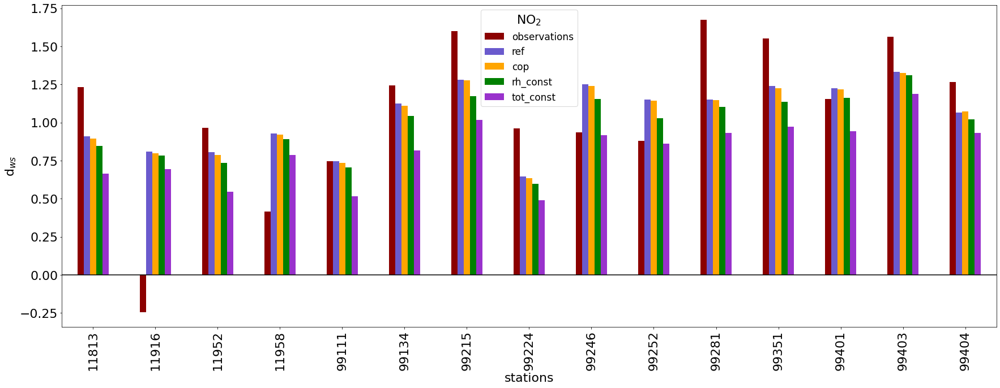

In [26]:
station_list = list(stat_all.loc[stat_all['type'] == 'B'].loc[stat_all.coverage != 0].index.values)

plt.rcParams['figure.figsize'] = 25,10
plt.rcParams.update({'font.size': 22})
zl.loc[station_list,list(zl.columns)[4:]].plot.bar(color=['darkred','slateblue','orange','green','darkorchid'])
#zl.iloc[:,4:].plot.bar(color=['darkred','slateblue','orange','green'])
plt.legend(["observations", "ref", "cop", 'rh_const','tot_const'],title='NO$_{2}$',fontsize=17)
plt.axhline(y=0,color='black')
#plt.ylabel('Mean winter - summer conc. $[\mu g . m^{-3}]$', fontsize=22)  #18
plt.ylabel('d$_{ws}$', fontsize=22)  #18
plt.xlabel('stations', fontsize=22)
plt.tight_layout()
    
plt.savefig('{0}/dws_{1}_{2}.png'.format(save_path, folder_name, v), dpi=300)
plt.show()
plt.close()

### Typy stanic 

In [27]:
fzl_types = pd.DataFrame(index = all_types, columns = ['count']+list(fzl.columns)[3:], dtype = 'float64')
zl_types = pd.DataFrame(index = all_types, columns = ['count']+list(zl.columns)[3:], dtype = 'float64')
for t in all_types:
    if t in locs:
        col = 'loc'
    else:
        col = 'type'
        
    stanice_vyber = list(stat_all.loc[stat_all[col] == t].loc[stat_all['coverage'] != 0].index)
    fzl_types.at[t,'count'], zl_types.at[t,'count']  = len(stanice_vyber), len(stanice_vyber)
    obs = data['ref']['OBS'].sel(station = stanice_vyber, time = data['ref'].time.dt.month.isin(season_months['year'])).to_series()
    zima = data['ref']['OBS'].sel(station = stanice_vyber, time = data['ref'].time.dt.month.isin(season_months['winter'])).mean()
    leto = data['ref']['OBS'].sel(station = stanice_vyber, time = data['ref'].time.dt.month.isin(season_months['summer'])).mean()    
    coverage = 100*(len(obs) - obs.isna().sum())/len(obs)
    fzl_types.at[t,'coverage'], zl_types.at[t,'coverage'] = coverage, coverage
    obs_mean = np.mean(obs)
    
    fzl_types.at[t, 'fzl_obs'] = zima/leto
    zl_types.at[t, 'zl_obs'] = (zima - leto)/obs_mean
    
    for s in specific:
        zima = data[s]['MOD'].sel(station = stanice_vyber, time = data[s].time.dt.month.isin(season_months['winter'])).mean()
        leto = data[s]['MOD'].sel(station = stanice_vyber, time = data[s].time.dt.month.isin(season_months['summer'])).mean()
        mod_mean = data[s]['MOD'].sel(station = stanice_vyber, time = data['ref'].time.dt.month.isin(season_months['year'])).mean()
        
        fzl_types.at[t, 'fzl_{0}'.format(s)] = zima/leto
        zl_types.at[t, 'zl_{0}'.format(s)] = (zima - leto)/mod_mean
    
        
zl_types

/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)
<ipython-input-27-ce2dc4ded259>:14: RuntimeWarning: invalid value encountered in long_scalars
  coverage = 100*(len(obs) - obs.isna().sum())/len(obs)


,count,coverage,zl_obs,zl_ref,zl_cop,zl_rh_const,zl_tot_const
S,1.0,94.098174,1.231943,0.911068,0.895260,0.846616,0.664385
R,6.0,88.852740,0.953653,1.031542,1.017790,0.976053,0.812777
U,18.0,95.823186,0.689742,0.977166,0.965805,0.899664,0.727876
B,15.0,92.994673,1.052821,0.994433,0.983455,0.925656,0.749466
T,10.0,95.711187,0.522825,0.961121,0.947934,0.881682,0.715068
I,0.0,NaN,NaN,NaN,NaN,NaN,NaN


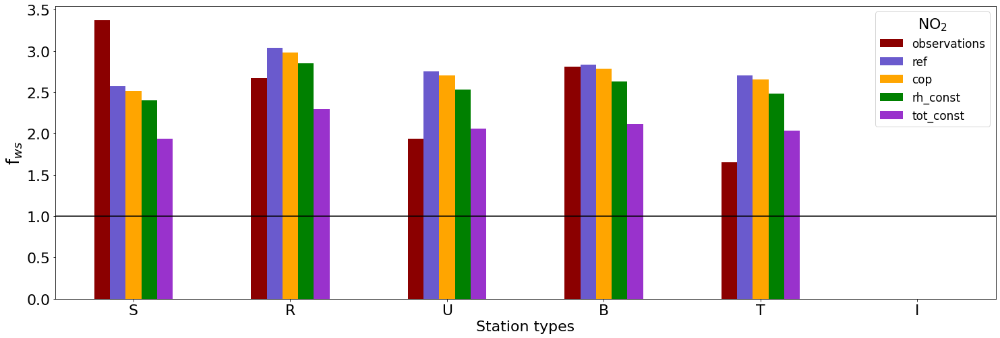

In [28]:
plt.rcParams['figure.figsize'] = 25,8
plt.rcParams.update({'font.size': 22})
fzl_types.iloc[:,2:].plot.bar(color=['darkred','slateblue','orange','green','darkorchid'], rot=0)
plt.legend(["observations", "ref", "cop", 'rh_const','tot_const'],title='NO$_{2}$',fontsize=17)
plt.axhline(y=1,color='black')
plt.ylabel('f$_{ws}$', fontsize=26)
plt.xlabel('Station types', fontsize=22)
    
plt.savefig('{0}/fws_station_types_{1}_{2}.png'.format(save_path, folder_name, v), dpi=300)
plt.show()
plt.close()

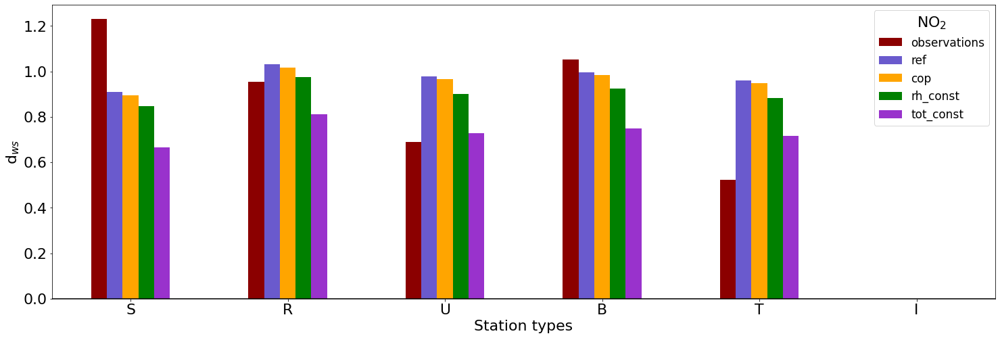

In [29]:
plt.rcParams['figure.figsize'] = 25,8
plt.rcParams.update({'font.size': 22})
zl_types.iloc[:,2:].plot.bar(color=['darkred','slateblue','orange','green','darkorchid'], rot=0)
plt.legend(["observations", "ref", "cop", 'rh_const','tot_const'],title='NO$_{2}$',fontsize=17)
plt.axhline(y=0,color='black')
#plt.ylabel('Mean winter - summer conc. $[\mu g . m^{-3}]$', fontsize=22)  #18
plt.ylabel('d$_{ws}$', fontsize=22)  #18
plt.xlabel('Station types', fontsize=22)
    
#plt.savefig('{0}/ws_station_types_{1}_CMAQ2017d02.png'.format(save_path,v), dpi=300)
plt.savefig('{0}/dws_station_types_{1}_{2}.png'.format(save_path, folder_name, v), dpi=300)
plt.show()
plt.close()

# O3

In [6]:
v = 'O3'
path = {'ref':'/data/oko/dusan/POST/WB_2020_{0}_2017'.format(v),
        'rh_const':'/data/oko/dusan/POST/WB_const_{0}_2017'.format(v),
        'cop':'/data/oko/dusan/POST/WB_2017_d02_CAMS_13_res_heat_{0}_2017'.format(v),
       'tot_const':'/data/oko/dusan/POST/WB_totcons_{0}_2017'.format(v)} # prisluchajuca cesta k suboru

#for i in range(0, len(specific)):
for i, key in enumerate(specific):
    print(key)
    stat[key], data[key] = vali.validation(path[key], model_name[i], grid_name[i], start_date[i], end_date[i], v)

ref
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=11813 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=11916 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=11952 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=11958 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
sel

Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=99323 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=99325 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=99326 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=99334 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select 

/data/teri/validacia/validacia_v2.py:237: RuntimeWarning: Mean of empty slice
  stat['obs_mean'][s] = np.nanmean(obs_all[s])


Validation of O3 done in 48.80735421180725 seconds
cop
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=11813 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=11916 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=11952 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=11958 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connec

Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=99316 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=99323 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=99325 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=99326 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select 

Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=99214 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=99215 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=99217 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=99224 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select 

Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=11952 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=11958 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=99111 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=99112 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select 

Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=99326 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=99334 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=99351 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=99352 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select 

## Statistika

### Vsetky stanice

In [8]:
my_season = 'year'

stat_all = stat[specific[0]][['name','loc','type','coverage','obs_mean']].copy()

for s in statistiky:
    for i in specific:
        stat_all['{0}_{1}'.format(s,i)] = pd.Series(dtype = 'float64')

for i in specific:   
    for s in stat_all.index:
        
        if s == 'all':
            obs = data[i]['OBS'].sel(time = data[i].time.dt.month.isin(season_months[my_season])).to_series()
            mod = data[i]['MOD'].sel(time = data[i].time.dt.month.isin(season_months[my_season])).to_series()
        else: 
            obs = data[i]['OBS'].sel(station = s, time = data[i].time.dt.month.isin(season_months[my_season])).to_series()
            mod = data[i]['MOD'].sel(station = s, time = data[i].time.dt.month.isin(season_months[my_season])).to_series()

        stat_all.at[s,'R_{0}'.format(i)] = obs.corr(mod)
        diff = (mod - obs).to_numpy()
        diff = diff[~np.isnan(diff)]
        obs[obs == 0] = np.nan
        obs_ = obs[~np.isnan(obs)]
        stat_all.at[s, 'obs_mean'] = np.nanmean(obs)
        podiel = (mod/obs).to_numpy()
        podiel = podiel[~np.isnan(podiel)]
        podiel_fac2 = podiel[podiel <= 2]
        podiel_fac2 = podiel_fac2[podiel_fac2 >= 0.5]
        
        if len(diff) != 0:
            stat_all.at[s, 'MB_{0}'.format(i)] = np.sum(diff)/len(diff)
            #stat_all.at[s, 'MPE_{0}'.format(i)] = 100*np.sum(diff/obs_)/len(diff)
            #stat_all.at[s,'MGE_{0}'.format(i)] = np.sum(np.absolute(diff))/len(diff)
            #stat_all.at[s,'MGPE_{0}'.format(i)] = 100*np.sum(np.absolute(diff/obs_))/len(diff)
            stat_all.at[s,'RMSE_{0}'.format(i)] = np.sqrt(np.sum(diff**2)/len(diff))
            #stat_all.at[s,'RMSPE_{0}'.format(i)] = 100*np.sqrt(np.sum((diff/obs_)**2)/len(diff))
            stat_all.at[s,'FAC2_{0}'.format(i)] = 100*len(podiel_fac2)/len(podiel)

#stat_all.loc[stat_all.coverage != 0]
#stat_all.loc[stat_all.r_full >= 0.5]
stat_all.to_csv('/data/teri/validacia/validated/{0}/tabulky/validation_{1}_all_{2}_2.csv'.format(folder_name,v,my_season))
stat_all.loc[stat_all.coverage != 0]

<ipython-input-8-036312436282>:24: RuntimeWarning: Mean of empty slice
  stat_all.at[s, 'obs_mean'] = np.nanmean(obs)


,name,loc,type,coverage,obs_mean,R_ref,R_cop,R_rh_const,R_tot_const,MB_ref,MB_cop,MB_rh_const,MB_tot_const,RMSE_ref,RMSE_cop,RMSE_rh_const,RMSE_tot_const,FAC2_ref,FAC2_cop,FAC2_rh_const,FAC2_tot_const
all,all,all,all,89.4157,56.1255,0.582094,0.587608,0.587834,0.589057,21.990136,21.737224,21.750204,21.326481,33.521235,33.250405,33.256235,32.949133,70.845402,71.035308,71.027329,71.294634
11813,"BRATISLAVA, JESENIOVA",S,B,93.6073,64.4235,0.731160,0.729348,0.728785,0.696648,7.707605,7.137868,7.172671,6.077781,22.033468,21.842049,21.875318,22.387652,88.085366,88.378049,88.353659,88.158537
11916,"CHOPOK, EMEP",R,B,46.29,98.3031,0.606221,0.608719,0.608838,0.600741,-8.445818,-8.421459,-8.431164,-8.496437,15.490728,15.455566,15.461029,15.582368,99.901356,99.901356,99.901356,99.901356
11952,"GANOVCE, METEO. ST.",R,B,95,53.2576,0.499232,0.511097,0.512554,0.534482,27.549425,27.230865,27.232533,26.647148,35.438401,35.078994,35.066759,34.409841,72.182168,72.470560,72.398462,72.638789
11958,KOJSOVSKA HOLA,R,B,95.2511,80.2296,0.434000,0.437123,0.435260,0.424885,1.741222,1.675741,1.672368,1.588571,18.331590,18.318406,18.350843,18.470725,98.322148,98.322148,98.310163,98.334132
99111,"BRATISLAVA, MAMATEYOVA",U,B,94.8402,50.733,0.742183,0.742561,0.743566,0.736924,20.429181,19.925699,19.945817,18.828639,30.253980,29.845588,29.840955,29.181328,68.403948,68.897448,68.873375,69.896485
99134,"NITRA, JANIKOVCE",U,B,86.7123,59.593,0.700998,0.707955,0.707885,0.713222,15.621583,15.295652,15.319551,14.715352,29.129214,28.733185,28.745984,28.294801,77.159031,77.356503,77.356503,77.922591
99215,"BANSKA BYSTRICA, ZELENA",U,B,90.9132,56.7422,0.625796,0.637403,0.637251,0.639304,23.992359,23.746919,23.767696,23.454621,34.277790,33.903317,33.921810,33.697693,68.558513,68.797087,68.797087,69.060773
99224,"RUZOMBEROK, RIADOK",U,B,90.5479,37.3885,0.487729,0.496304,0.497885,0.503885,40.706780,40.282052,40.286819,39.898507,46.545177,46.121390,46.113085,45.726160,44.717600,45.083207,45.095814,45.247100
99246,"PRIEVIDZA, MALONECPALSKA",U,B,82.6826,51.2209,0.654390,0.661117,0.661548,0.671044,27.884031,27.580406,27.621522,27.294678,38.256838,37.867490,37.896099,37.560942,61.328179,61.466243,61.424824,61.714759


In [9]:
#stat_all.loc[stat_all.coverage != 0]
stat_all.loc[stat_all.R_ref <= 0.3]


,name,loc,type,coverage,obs_mean,R_ref,R_cop,R_rh_const,R_tot_const,MB_ref,MB_cop,MB_rh_const,MB_tot_const,RMSE_ref,RMSE_cop,RMSE_rh_const,RMSE_tot_const,FAC2_ref,FAC2_cop,FAC2_rh_const,FAC2_tot_const


In [48]:
ID_B = list(stat_all.loc[stat_all.type == 'B'].loc[stat_all.coverage != 0].index.values)
#ID_B

### Typy stanic

In [32]:
my_season = 'year'

#stat_types_mine = ['all','RB', 'OB', 'UT', 'I']
stat_types_mine = ['all','RB', 'OB', 'UT']
stat_types = pd.DataFrame(index = stat_types_mine, columns = ['n']+list(stat_all.columns)[3:])

for i in specific:
    for t in stat_types_mine:
        if t == 'RB':
            #loc_, type_ = 'R', 'B'
            stanice_vyber = list(stat_all.loc[stat_all['type'] == 'B'].loc[stat_all['loc']=='R'].loc[stat_all['coverage'] != 0].index)
        
        if t == 'OB':
            stanice_vyber = list(stat_all.loc[stat_all['type'] == 'B'].loc[stat_all['loc']=='U'].loc[stat_all['coverage'] != 0].index) + list(stat_all.loc[stat_all['type'] == 'B'].loc[stat_all['loc']=='S'].loc[stat_all['coverage'] != 0].index)
             
        if t == 'UT':
            stanice_vyber = list(stat_all.loc[stat_all['type'] == 'T'].loc[stat_all['loc']=='U'].loc[stat_all['coverage'] != 0].index)
            
        if t == 'I':
            stanice_vyber = list(stat_all.loc[stat_all['type'] == 'I'].loc[stat_all['coverage'] != 0].index)
            
        if t == 'all':
            stanice_vyber = list(stat_all.loc[stat_all.coverage != 0].index.values)[1:]
            
        #stat_types.at[t,'count'] = len(stat_all.loc[stat_all['type'] == type_].loc[stat_all['loc']==loc_])
        #stanice_vyber = list(stat_all.loc[stat_all[col] == t].loc[stat_all['coverage'] != 0].index)
        stat_types.at[t,'n'] = len(stanice_vyber)
        obs = data[i]['OBS'].sel(station = stanice_vyber, time = data[i].time.dt.month.isin(season_months[my_season])).to_series()
        mod = data[i]['MOD'].sel(station = stanice_vyber, time = data[i].time.dt.month.isin(season_months[my_season])).to_series()

        obs[obs == 0] = np.nan
        obs_ = obs[~np.isnan(obs)]
        podiel = (mod/obs).to_numpy()
        podiel = podiel[~np.isnan(podiel)]
        podiel_fac2 = podiel[podiel <= 2]
        podiel_fac2 = podiel_fac2[podiel_fac2 >= 0.5]
        
        stat_types.at[t,'coverage'] = 100*(len(obs) - obs.isna().sum())/len(obs)
        stat_types.at[t,'obs_mean'] = np.nanmean(obs)
        stat_types.at[t,'R_{0}'.format(i)] = obs.corr(mod)
        diff = (mod - obs).to_numpy()
        diff = diff[~np.isnan(diff)]
        stat_types.at[t, 'MB_{0}'.format(i)] = np.sum(diff)/len(diff)
        #stat_types.at[t, 'MPE_{0}'.format(i)] = 100*np.sum(diff/obs_)/len(diff)
        #stat_types.at[t,'MGE_{0}'.format(i)] = np.sum(np.absolute(diff))/len(diff)
        #stat_types.at[t,'MGPE_{0}'.format(i)] = 100*np.sum(np.absolute(diff/obs_))/len(diff)
        stat_types.at[t,'RMSE_{0}'.format(i)] = np.sqrt(np.sum(diff**2)/len(diff))
        #stat_types.at[t,'RMSPE_{0}'.format(i)] = 100*np.sqrt(np.sum((diff/obs_)**2)/len(diff))
        if len(podiel) != 0:
            stat_types.at[t,'FAC2_{0}'.format(i)] = 100*len(podiel_fac2)/len(podiel)
        
stat_types

<ipython-input-32-51872e5e39b5>:38: RuntimeWarning: invalid value encountered in long_scalars
  stat_types.at[t,'coverage'] = 100*(len(obs) - obs.isna().sum())/len(obs)
<ipython-input-32-51872e5e39b5>:39: RuntimeWarning: Mean of empty slice
  stat_types.at[t,'obs_mean'] = np.nanmean(obs)
<ipython-input-32-51872e5e39b5>:43: RuntimeWarning: invalid value encountered in double_scalars
  stat_types.at[t, 'MB_{0}'.format(i)] = np.sum(diff)/len(diff)
<ipython-input-32-51872e5e39b5>:47: RuntimeWarning: invalid value encountered in double_scalars
  stat_types.at[t,'RMSE_{0}'.format(i)] = np.sqrt(np.sum(diff**2)/len(diff))


,n,coverage,obs_mean,R_ref,R_cop,R_rh_const,R_tot_const,MB_ref,MB_cop,MB_rh_const,MB_tot_const,RMSE_ref,RMSE_cop,RMSE_rh_const,RMSE_tot_const,FAC2_ref,FAC2_cop,FAC2_rh_const,FAC2_tot_const
all,16,89.4157,56.1255,0.582094,0.587608,0.587834,0.589057,21.9901,21.7372,21.7502,21.3265,33.5212,33.2504,33.2562,32.9491,70.8454,71.0353,71.0273,71.2946
RB,6,86.6229,64.1361,0.540435,0.54559,0.545303,0.553913,17.16,17.0568,17.0617,16.8205,29.1231,28.9859,28.9915,28.7343,80.6804,80.7793,80.7683,80.955
OB,10,91.0913,51.5549,0.581434,0.586708,0.587216,0.584346,24.7461,24.4077,24.4253,23.8974,35.7893,35.4545,35.4605,35.1281,65.2338,65.4757,65.4694,65.7827
UT,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [50]:
stat_types_diff = stat_types.copy()
for s in statistiky:
    for e in ['cop','rh_const','tot_const']:
        stat_types_diff['{0}_{1}'.format(s,e)] = stat_types['{0}_{1}'.format(s,e)] - stat_types['{0}_ref'.format(s)]

stat_types_diff.to_csv('/data/teri/validacia/validated/{0}/tabulky/stat_types_validation_{1}_{2}_fac2.csv'.format(folder_name,v,my_season))

stat_types_diff

,n,coverage,obs_mean,R_ref,R_cop,R_rh_const,R_tot_const,MB_ref,MB_cop,MB_rh_const,MB_tot_const,RMSE_ref,RMSE_cop,RMSE_rh_const,RMSE_tot_const,FAC2_ref,FAC2_cop,FAC2_rh_const,FAC2_tot_const
all,16,89.4157,56.1255,0.582094,0.00551494,0.00574017,0.00696353,21.9901,-0.252912,-0.239931,-0.663654,33.5212,-0.27083,-0.264999,-0.572102,70.8454,0.189906,0.181927,0.449232
RB,6,86.6229,64.1361,0.540435,0.00515493,0.0048678,0.013477,17.16,-0.103143,-0.0982743,-0.339443,29.1231,-0.137204,-0.131587,-0.388821,80.6804,0.0988381,0.0878561,0.27455
OB,10,91.0913,51.5549,0.581434,0.00527414,0.00578187,0.00291165,24.7461,-0.338365,-0.320756,-0.848639,35.7893,-0.334804,-0.328837,-0.661187,65.2338,0.241867,0.235601,0.5489
UT,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


### Stat. tabulka seasons

In [33]:
stat_season = pd.DataFrame(index = season, columns = ['coverage','obs_mean'] + statistiky)
stat_season_all = {}
for i in ['ref','cop','rh_const','tot_const']:
    stat_season_all[i] = {}
    for t in all_types_all:
        if t in locs:
            stanice_vyber = list(stat_all.loc[stat_all['loc'] == t].loc[stat_all['coverage'] != 0].index)
        elif t in types:
            stanice_vyber = list(stat_all.loc[stat_all['type'] == t].loc[stat_all['coverage'] != 0].index)
        else:
            stanice_vyber = list(stat_all.loc[stat_all['coverage'] != 0].index.values)[1:]
            
        for s in season:   
            obs = data[i]['OBS'].sel(station = stanice_vyber, time = data[i].time.dt.month.isin(season_months[s])).to_series()
            mod = data[i]['MOD'].sel(station = stanice_vyber, time = data[i].time.dt.month.isin(season_months[s])).to_series()
        
            obs[obs == 0] = np.nan
            obs_ = obs[~np.isnan(obs)]
            podiel = (mod/obs).to_numpy()
            podiel = podiel[~np.isnan(podiel)]
            podiel_fac2 = podiel[podiel <= 2]
            podiel_fac2 = podiel_fac2[podiel_fac2 >= 0.5]
            
            stat_season.at[s,'coverage'] = 100*(len(obs) - obs.isna().sum())/len(obs)
            stat_season.at[s,'obs_mean'] = np.nanmean(obs)
            stat_season.at[s,'R'.format(i)] = obs.corr(mod)
            diff = (mod - obs).to_numpy()
            diff = diff[~np.isnan(diff)]
            stat_season.at[s, 'MB'.format(i)] = np.sum(diff)/len(diff)
            #stat_season.at[s,'MGE'.format(i)] = np.sum(np.absolute(diff))/len(diff)
            stat_season.at[s,'RMSE'.format(i)] = np.sqrt(np.sum(diff**2)/len(diff))
            if len(podiel) != 0:
                stat_season.at[s,'FAC2'.format(i)] = 100*len(podiel_fac2)/len(podiel)
        
        stat_season_all[i][t] = stat_season.copy()
        #stat_season.to_csv('/data/teri/validacia/validated/CMAQ2017d02_full_vs_const/tabulky/stat_seasons_{0}_CMAQ2017d02_{1}_{2}.csv'.format(v,i,t))
#stat_season_all

<ipython-input-33-b948b195496a>:24: RuntimeWarning: invalid value encountered in long_scalars
  stat_season.at[s,'coverage'] = 100*(len(obs) - obs.isna().sum())/len(obs)
<ipython-input-33-b948b195496a>:25: RuntimeWarning: Mean of empty slice
  stat_season.at[s,'obs_mean'] = np.nanmean(obs)
<ipython-input-33-b948b195496a>:29: RuntimeWarning: invalid value encountered in double_scalars
  stat_season.at[s, 'MB'.format(i)] = np.sum(diff)/len(diff)
<ipython-input-33-b948b195496a>:31: RuntimeWarning: invalid value encountered in double_scalars
  stat_season.at[s,'RMSE'.format(i)] = np.sqrt(np.sum(diff**2)/len(diff))


In [52]:
#stat_season_all

In [35]:
typ = 'B'
stat_season_diff = pd.DataFrame(index = season, columns = list(stat_all.columns)[3:])
for s in statistiky:
    stat_season_diff['{0}_ref'.format(s)] = stat_season_all['ref']['B'][s].copy()
    stat_season_diff['coverage'.format(s)] = stat_season_all['ref']['B']['coverage'].copy()
    stat_season_diff['obs_mean'.format(s)] = stat_season_all['ref']['B']['obs_mean'].copy()
    for e in ['cop', 'rh_const','tot_const']:
        stat_season_diff['{0}_{1}'.format(s,e)] = stat_season_all[e]['B'][s] - stat_season_all['ref']['B'][s]

stat_season_diff.to_csv('/data/teri/validacia/validated/{0}/tabulky/seasons_validation_{1}_{2}_fac2.csv'.format(folder_name,typ,v))

stat_season_diff

,coverage,obs_mean,R_ref,R_cop,R_rh_const,R_tot_const,MB_ref,MB_cop,MB_rh_const,MB_tot_const,RMSE_ref,RMSE_cop,RMSE_rh_const,RMSE_tot_const,FAC2_ref,FAC2_cop,FAC2_rh_const,FAC2_tot_const
spring,89.2861,67.928,0.496728,0.00612201,0.00730863,0.0119427,17.629,-0.164535,-0.164499,-0.649569,29.9438,-0.176601,-0.192266,-0.540517,82.1196,0.0887677,0.104619,0.408966
summer,89.6937,72.9764,0.51283,0.00574124,0.00825269,0.0125425,12.7253,0.0738519,0.0871426,-0.665466,28.9547,-0.0674998,-0.102757,-0.57191,84.2427,0.0378704,0.0410263,0.444977
autumn,85.7372,40.9351,0.436371,0.00513209,0.00630007,0.00875842,31.9387,-0.374596,-0.372904,-0.542596,38.9653,-0.330128,-0.337697,-0.501396,55.8344,0.263685,0.263685,0.43725
winter,92.9832,42.0866,0.400849,0.00803479,0.0024439,0.0127476,26.1314,-0.54842,-0.512516,-0.788558,35.4957,-0.45995,-0.388952,-0.686867,60.5632,0.370313,0.320523,0.504123
year,89.4157,56.1255,0.582094,0.00551494,0.00574017,0.00696353,21.9901,-0.252912,-0.239931,-0.663654,33.5212,-0.27083,-0.264999,-0.572102,70.8454,0.189906,0.181927,0.449232


## Priemerny hodinovy chod 

In [ ]:
### USER INPUT
# Choose stations to plot
ID = list(stat_all.loc[stat_all.coverage != 0].index.values)[1:]
#ID = [11813,11916]    # selected stations

my_season = 'year'

save = True   # save the plots?  

save_path = '{0}/validated/{1}_{2}/graphs/{3}'.format(vali_path, nick, start_date[0:4],v)

In [ ]:
if save:
    print('Plots will be saved at:{}'.format(save_path))
for i in ID:    
    
    obs_id = data[specific[0]]['OBS'].sel(station = i, time = data[specific[0]].time.dt.month.isin(season_months[my_season])).groupby('time.hour').mean()
    name_sta = stat[specific[0]].name.loc[stat[specific[0]].index == i].item()
    
    plt.rcParams['figure.figsize'] = 20,7
    plt.rcParams.update({'font.size': 22})

    plt.plot(obs_id.hour, obs_id[:], color =obs_color, label = 'observations')                
    for s in specific:
        mod_id = data[s]['MOD'].sel(station = i, time = data[s].time.dt.month.isin(season_months[my_season])).groupby('time.hour').mean()
        
        stat_corr = mod_id.to_series().corr(obs_id.to_series())
        stat_diff = np.array((mod_id - obs_id).to_series().dropna())
        if len(stat_diff) != 0:
            stat_rmse = np.sqrt(np.sum(stat_diff**2)/len(stat_diff))
        else:
            stat_rmse = np.nan
            
        plt.plot(obs_id.hour, mod_id[:], color = color_list[s], label = '{}'.format(s))
        plt.plot([], [], ' ', label='R={:0.2f}, RMSE={:1.2f}'.format(stat_corr,stat_rmse))

    plt.legend(fontsize=12)                
    plt.title('Mean hourly concentration of {0}, {1}'.format(v,name_sta))                               
    plt.xlabel('Hours')
    plt.ylabel('{0} [{1}]'.format(v,units))
    plt.tight_layout()

    if save:
        if not os.path.exists(save_path):
            os.makedirs(save_path)
        plt.savefig('{0}/{1}_{2}_{3}_{4}_MH_{5}.png'.format(save_path,nick, start_date[0:4], v, i,my_season), dpi=300)                
    plt.show()                
    plt.close() 

## Hodinovy chod koncentracii 

In [ ]:
### USER INPUT
# Choose stations to plot
ID = list(stat_all.loc[stat_all['coverage']!=0].index.values)[1:]   # all stations
#ID = [11813,11916]    # selected stations
save = False   # save the plots?

plot_from = '2017-01-08'
plot_until = '2017-01-08'  

save_path = '{0}/validated/{1}_{2}/graphs/{3}'.format(vali_path, nick, start_date[0:4],v)

In [ ]:
if save:
    print('Plots will be saved at:{}'.format(save_path))
for i in ID:    
    
    obs_id = data[specific[0]]['OBS'].sel(station = i).to_series()[plot_from:plot_until]
    name_sta = stat[specific[0]].name.loc[stat[specific[0]].index == i].item()
    
    plt.rcParams['figure.figsize'] = 20,7
    plt.rcParams.update({'font.size': 22})

    plt.plot(obs_id.index[:], obs_id[:], color =obs_color, label = 'observations')                
    for s in specific:
        mod_id = data[s]['MOD'].sel(station = i).to_series()[plot_from:plot_until]
        
        stat_corr = mod_id.corr(obs_id)
        stat_diff = np.array((mod_id - obs_id).dropna())
        if len(stat_diff) != 0:
            stat_rmse = np.sqrt(np.sum(stat_diff**2)/len(stat_diff))
        else:
            stat_rmse = np.nan
            
        plt.plot(obs_id.index[:], mod_id[:], color = color_list[s], label = '{}'.format(s))
        plt.plot([], [], ' ', label='R={:0.2f}, RMSE={:1.2f}'.format(stat_corr,stat_rmse))

    plt.legend(fontsize=12)                
    plt.title('Hourly concentration of {0}, {1}'.format(v,name_sta))                               
    plt.xlabel('Days')
    plt.ylabel('{0} [{1}]'.format(v,units))
    plt.tight_layout()

    if save:
        if not os.path.exists(save_path):
            os.makedirs(save_path)
        plt.savefig('{0}/{1}_{2}_{3}_{4}_H{5}-{6}.png'.format(save_path,nick, start_date[0:4], v, i,plot_from,plot_until), dpi=300)                
    plt.show()                
    plt.close()   

## Priemerny hodinovy chod pre typy stanic

In [36]:
### USER INPUT
# Choose stations to plot
#moj_typ = 'T'
#moj_loc = 'U'
my_name = 'B'
#ID = list(stat_all.loc[stat_all['type'] == moj_typ].loc[stat_all['loc'] == moj_loc].loc[stat_all.coverage != 0].index.values)
ID = list(stat_all.loc[stat_all['type'] == my_name].loc[stat_all.coverage != 0].index.values)
#ID = [11813,11916]    # selected stations

my_season = 'winter'

save = True   # save the plots?  

save_path = '{0}/validated/{1}/graphs/{2}'.format(vali_path, folder_name,v)

Plots will be saved at:/data/teri/validacia/validated/CMAQ2017d02_ref_vs_cop_vs_const/graphs/O3


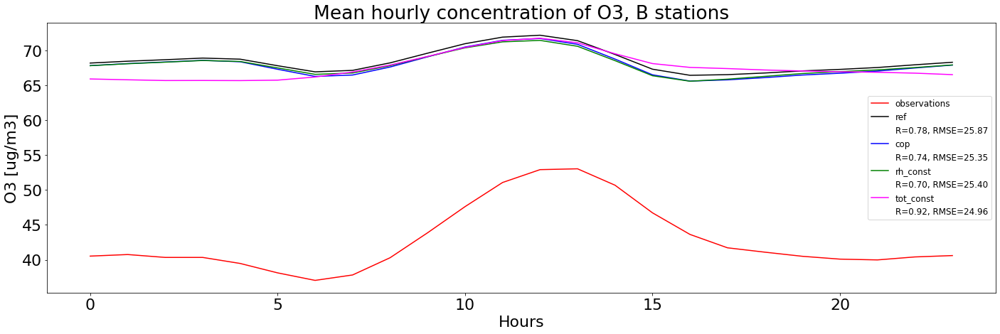

In [37]:
if save:
    print('Plots will be saved at:{}'.format(save_path))
#for i in ID:    
    
obs_id = data[specific[0]]['OBS'].sel(station = ID, time = data[specific[0]].time.dt.month.isin(season_months[my_season])).groupby('time.hour').mean().mean(dim = 'station')
#name_sta = stat[specific[0]].name.loc[stat[specific[0]].index == i].item()

plt.rcParams['figure.figsize'] = 20,7
plt.rcParams.update({'font.size': 22})

plt.plot(obs_id.hour, obs_id[:], color =obs_color, label = 'observations')                
for s in specific:
    mod_id = data[s]['MOD'].sel(station = ID, time = data[s].time.dt.month.isin(season_months[my_season])).groupby('time.hour').mean().mean(dim = 'station')

    stat_corr = mod_id.to_series().corr(obs_id.to_series())
    stat_diff = np.array((mod_id - obs_id).to_series().dropna())
    if len(stat_diff) != 0:
        stat_rmse = np.sqrt(np.sum(stat_diff**2)/len(stat_diff))
    else:
        stat_rmse = np.nan

    plt.plot(obs_id.hour, mod_id[:], color = color_list[s], label = '{}'.format(s))
    plt.plot([], [], ' ', label='R={:0.2f}, RMSE={:1.2f}'.format(stat_corr,stat_rmse))

plt.legend(fontsize=12)                
plt.title('Mean hourly concentration of {0}, {1} stations'.format(v, my_name))                               
plt.xlabel('Hours')
plt.ylabel('{0} [{1}]'.format(v,units))
plt.tight_layout()

if save:
    if not os.path.exists(save_path):
        os.makedirs(save_path)
    plt.savefig('{0}/MH_{1}_{2}_{3}_{4}.png'.format(save_path,my_name, nick, v, my_season), dpi=300)                
plt.show()                
plt.close() 

## Normovany priemerny hodinovy chod pre typy stanic

In [38]:
### USER INPUT
# Choose stations to plot
#moj_typ = 'T'
#moj_loc = 'U'
my_name = 'B'
#ID = list(stat_all.loc[stat_all['type'] == moj_typ].loc[stat_all['loc'] == moj_loc].loc[stat_all.coverage != 0].index.values)
ID = list(stat_all.loc[stat_all['type'] == my_name].loc[stat_all.coverage != 0].index.values)
#ID = [11813,11916]    # selected stations

my_season = 'winter'

save = True   # save the plots?  

save_path = '{0}/validated/{1}/graphs/{2}'.format(vali_path, folder_name,v)

Plots will be saved at:/data/teri/validacia/validated/CMAQ2017d02_ref_vs_cop_vs_const/graphs/O3


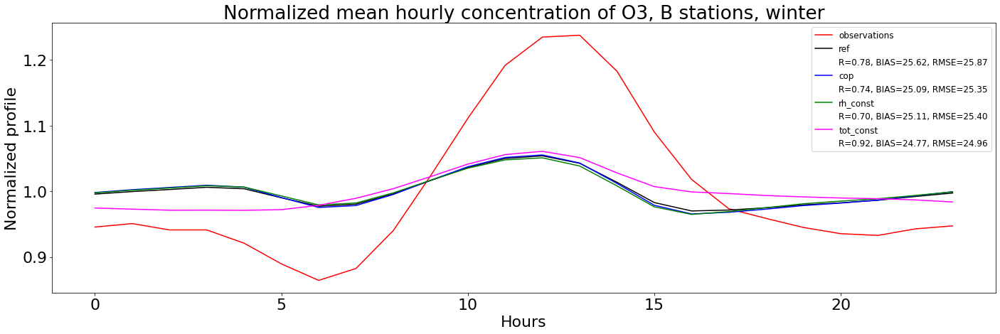

In [39]:
if save:
    print('Plots will be saved at:{}'.format(save_path))
#for i in ID:    
    
obs_id = data[specific[0]]['OBS'].sel(station = ID, time = data[specific[0]].time.dt.month.isin(season_months[my_season])).groupby('time.hour').mean().mean(dim = 'station')
#name_sta = stat[specific[0]].name.loc[stat[specific[0]].index == i].item()

plt.rcParams['figure.figsize'] = 20,7
plt.rcParams.update({'font.size': 22})

obs_id_norm = 24*obs_id/obs_id.sum()
plt.plot(obs_id.hour, obs_id_norm[:], color =obs_color, label = 'observations')                
for s in specific:
    mod_id = data[s]['MOD'].sel(station = ID, time = data[s].time.dt.month.isin(season_months[my_season])).groupby('time.hour').mean().mean(dim = 'station')
    mod_id_norm = 24*mod_id/mod_id.sum()
    
    stat_corr = mod_id.to_series().corr(obs_id.to_series())
    stat_diff = np.array((mod_id - obs_id).to_series().dropna())
    if len(stat_diff) != 0:
        stat_bias = np.sum(stat_diff)/len(stat_diff)
        stat_rmse = np.sqrt(np.sum(stat_diff**2)/len(stat_diff))
    else:
        stat_rmse = np.nan
        stat_bias = np.nan
    
    plt.plot(obs_id.hour, mod_id_norm[:], color = color_list[s], label = '{}'.format(s))
    #plt.plot([], [], ' ', label='R={:0.2f}, RMSE={:1.2f}'.format(stat_corr,stat_rmse))
    plt.plot([], [], ' ', label='R={:0.2f}, BIAS={:1.2f}, RMSE={:1.2f}'.format(stat_corr,stat_bias, stat_rmse))

plt.legend(fontsize=12)                
plt.title('Normalized mean hourly concentration of {0}, {1} stations, {2}'.format(v, my_name, my_season))                               
plt.xlabel('Hours')
plt.ylabel('Normalized profile')
plt.tight_layout()

if save:
    if not os.path.exists(save_path):
        os.makedirs(save_path)
    plt.savefig('{0}/MH_norm_{1}_{2}_{3}_{4}.png'.format(save_path,my_name, nick, v, my_season), dpi=300)                
plt.show()                
plt.close() 

## Priemerny rocny chod pre stanice

Chod priemernych dennych hodnot

In [ ]:
### USER INPUT
# Choose stations to plot
ID = list(stat_all.index.values)[1:]   # all stations
#ID = [11813,11916]    # selected stations
save = False   # save the plots?

plot_from = '2017-01-01'
plot_until = '2017-01-31' 

save_path = '{0}/validated/{1}_{2}/graphs/{3}'.format(vali_path, nick, start_date[0:4],v)

In [ ]:
if save:
    print('Plots will be saved at:{}'.format(save_path))
for i in ID:
    obs_id = data[specific[0]]['OBS'].sel(station = i).to_series()[plot_from:plot_until]
    name_sta = stat[specific[0]].name.loc[stat[specific[0]].index == i].item()
    daily_obs = obs_id.groupby(pd.Grouper(freq='D')).mean()
    
    plt.rcParams['figure.figsize'] = 20,7
    plt.rcParams.update({'font.size': 22})
    plt.plot(daily_obs.index[:], daily_obs[:], color = obs_color, label = 'observations')                
    
    for s in specific:        
        mod_id = data[s]['MOD'].sel(station = i).to_series()[plot_from:plot_until]        
        daily_mod = mod_id.groupby(pd.Grouper(freq='D')).mean()

        stat_corr_daily = daily_mod.corr(daily_obs)
        stat_diff_daily = np.array((daily_mod - daily_obs).dropna())
        if len(stat_diff_daily) != 0:
            stat_rmse_daily = np.sqrt(np.sum(stat_diff_daily**2)/len(stat_diff_daily))
        else:
            stat_rmse_daily = np.nan

        plt.plot(daily_obs.index[:], daily_mod[:], color = color_list[s], label = '{}'.format(s))
        plt.plot([], [], ' ', label='R={:0.2f}, RMSE={:1.2f}'.format(stat_corr_daily,stat_rmse_daily))

    plt.legend(fontsize=12)                
    plt.title('Daily concentration of {0}, {1}'.format(v,name_sta))                               
    plt.xlabel('Days')
    plt.ylabel('{0} [{1}]'.format(v,units))
    plt.tight_layout()

    if save:
        if not os.path.exists(save_path):
            os.makedirs(save_path)
        plt.savefig('{0}/{1}_{2}_{3}_{4}_D{5}-{6}.png'.format(save_path,nick, start_date[0:4], v, i,plot_from,plot_until), dpi=300)                
    plt.show()                
    plt.close()   

## Priemerny rocny chod typy stanic

In [54]:
### USER INPUT
# Choose stations to plot
#moj_typ = 'T'
#moj_loc = 'U'
my_name = 'B'
#ID = list(stat_all.loc[stat_all['type'] == moj_typ].loc[stat_all['loc'] == moj_loc].loc[stat_all.coverage != 0].index.values)
ID = list(stat_all.loc[stat_all['type'] == my_name].loc[stat_all.coverage != 0].index.values)
#ID = [11813,11916]    # selected stations

my_season = 'year'

save = True   # save the plots?  

save_path = '{0}/validated/{1}/graphs/{2}'.format(vali_path, folder_name,v)

Plots will be saved at:/data/teri/validacia/validated/CMAQ2017d02_ref_vs_cop_vs_const/graphs/O3


/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)


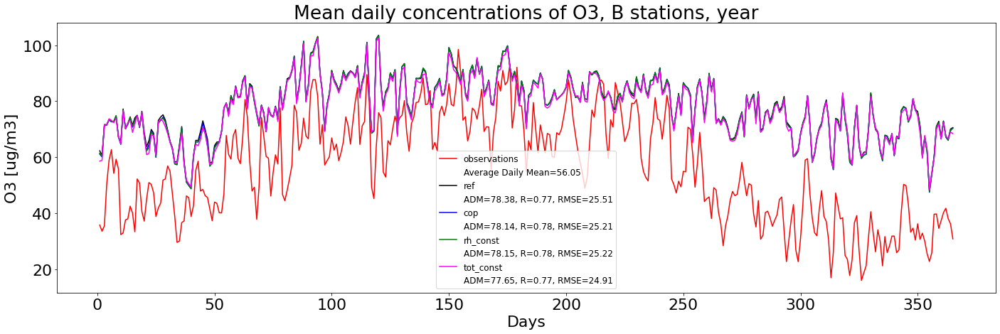

In [55]:
if save:
    print('Plots will be saved at:{}'.format(save_path))
#for i in ID:    
days_np = np.repeat(np.linspace(1,365,365),24)
new_data = data[specific[0]].assign_coords(time = days_np)    
obs_id = new_data['OBS'].sel(station = ID).groupby(new_data['OBS'].time).mean().mean(dim = 'station')
obs_mean = obs_id.mean()

plt.rcParams['figure.figsize'] = 20,7
plt.rcParams.update({'font.size': 22})

plt.plot(obs_id.time, obs_id[:], color =obs_color, label = 'observations') 
plt.plot([], [], ' ', label='Average Daily Mean={:0.2f}'.format(obs_mean.item()))

for s in specific:
    new_data = data[s].assign_coords(time = days_np)
    mod_id = new_data['MOD'].sel(station = ID).groupby(new_data['MOD'].time).mean().mean(dim = 'station')
    mod_mean = mod_id.mean()

    stat_corr = mod_id.to_series().corr(obs_id.to_series())
    stat_diff = np.array((mod_id - obs_id).to_series().dropna())
    if len(stat_diff) != 0:
        stat_rmse = np.sqrt(np.sum(stat_diff**2)/len(stat_diff))
    else:
        stat_rmse = np.nan

    plt.plot(obs_id.time, mod_id[:], color = color_list[s], label = '{}'.format(s))
    plt.plot([], [], ' ', label='ADM={:0.2f}, R={:1.2f}, RMSE={:1.2f}'.format(mod_mean.item(),stat_corr,stat_rmse))

plt.legend(fontsize=12)                
plt.title('Mean daily concentrations of {0}, {1} stations, {2}'.format(v, my_name, my_season))                               
plt.xlabel('Days')
plt.ylabel('{0} [{1}]'.format(v,units))
plt.tight_layout()

if save:
    if not os.path.exists(save_path):
        os.makedirs(save_path)
    plt.savefig('{0}/MA_{1}_{2}_{3}_{4}.png'.format(save_path,my_name, nick, v, my_season), dpi=300)                
plt.show()                
plt.close() 

## Rocne obdobia

In [10]:
### USER INPUT
# Choose stations to plot
ID = list(stat_all.loc[stat_all.coverage != 0].index.values)[1:]
#ID = [11813,11916]    # selected stations

save = True   # save the plots?  

save_path = '{0}/validated/{1}/graphs/{2}'.format(vali_path,folder_name,v)
save_path

'/data/teri/validacia/validated/CMAQ2017d02_ref_vs_cop_vs_const/graphs/O3'

### Model - station types

Plots will be saved at:/data/teri/validacia/validated/CMAQ2017d02_ref_vs_cop_vs_const/graphs/O3


/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)


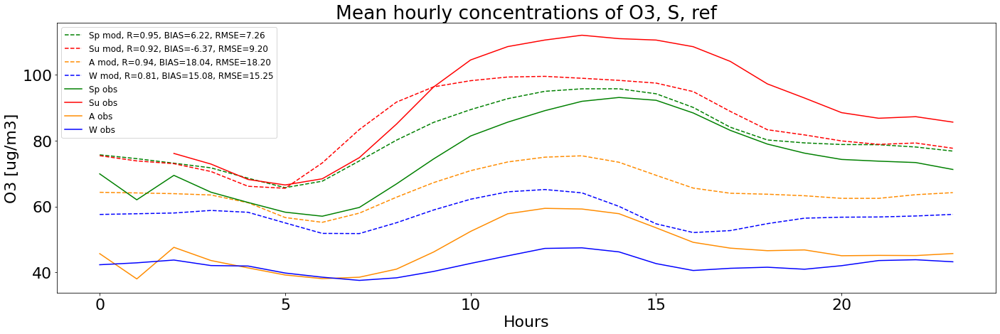

/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)


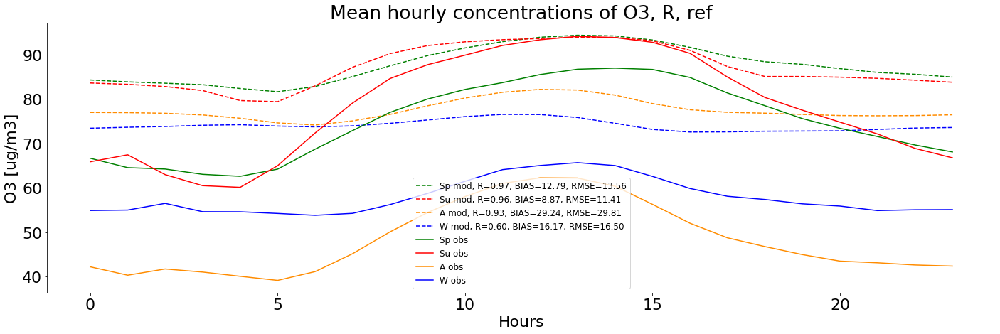

/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)


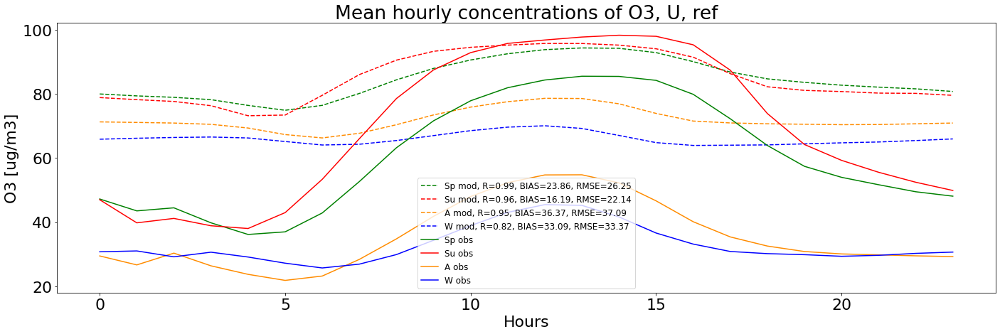

/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)


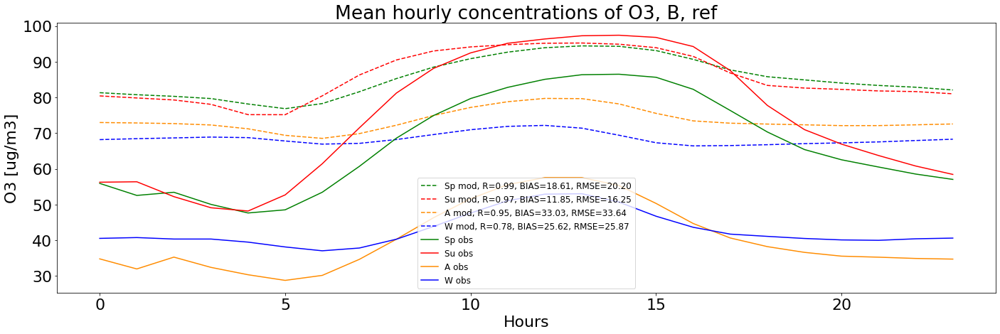

/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)
<ipython-input-11-843c41a8d2fd>:49: RuntimeWarning: invalid value encountered in double_scalars
  jar_rmse = np.sqrt(np.sum(jar_diff**2)/len(jar_diff))
<ipython-input-11-843c41a8d2fd>:50: RuntimeWarning: invalid value encountered in double_scalars
  leto_rmse = np.sqrt(np.sum(leto_diff**2)/len(leto_diff))
<ipython-input-11-843c41a8d2fd>:51: RuntimeWarning: invalid value encountered in double_scalars
  jesen_rmse = np.sqrt(np.sum(jesen_diff**2)/len(jesen_diff))
<ipython-input-11-843c41a8d2fd>:52: RuntimeWarning: invalid value encountered in double_scalars
  zima_rmse = np.sqrt(np.sum(zima_diff**2)/len(zima_diff))
<ipython-input-11-843c41a8d2fd>:54: RuntimeWarning: invalid value encountered in double_scalars
  jar_bias, leto_bias = np.sum(jar_diff)/len(jar_diff), np.sum(leto_diff)/len(leto_diff)
<ipython-input-11-843c

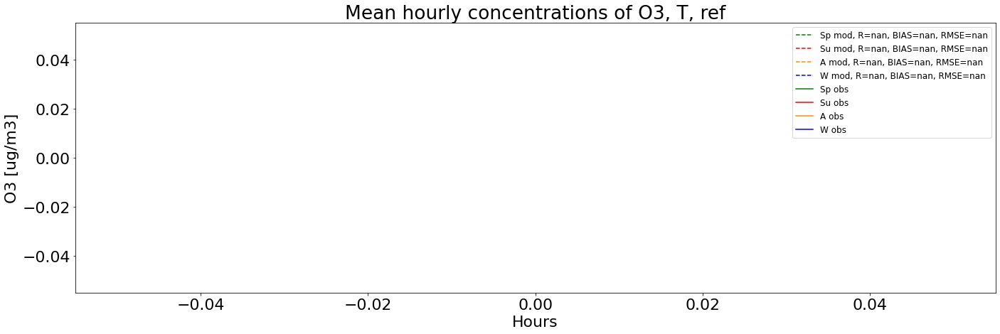

/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)
<ipython-input-11-843c41a8d2fd>:49: RuntimeWarning: invalid value encountered in double_scalars
  jar_rmse = np.sqrt(np.sum(jar_diff**2)/len(jar_diff))
<ipython-input-11-843c41a8d2fd>:50: RuntimeWarning: invalid value encountered in double_scalars
  leto_rmse = np.sqrt(np.sum(leto_diff**2)/len(leto_diff))
<ipython-input-11-843c41a8d2fd>:51: RuntimeWarning: invalid value encountered in double_scalars
  jesen_rmse = np.sqrt(np.sum(jesen_diff**2)/len(jesen_diff))
<ipython-input-11-843c41a8d2fd>:52: RuntimeWarning: invalid value encountered in double_scalars
  zima_rmse = np.sqrt(np.sum(zima_diff**2)/len(zima_diff))
<ipython-input-11-843c41a8d2fd>:54: RuntimeWarning: invalid value encountered in double_scalars
  jar_bias, leto_bias = np.sum(jar_diff)/len(jar_diff), np.sum(leto_diff)/len(leto_diff)
<ipython-input-11-843c

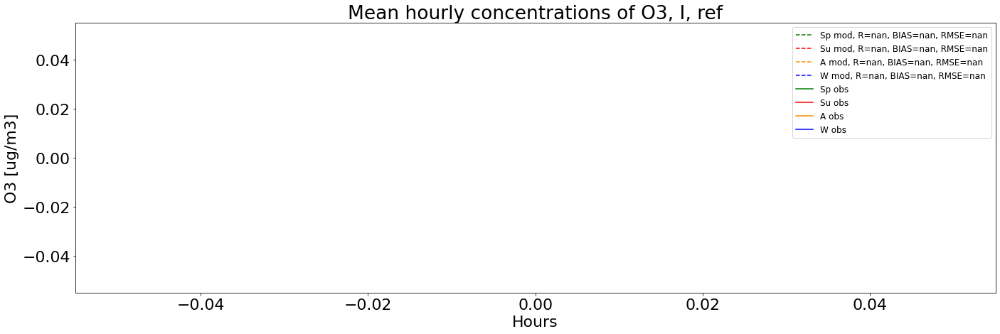

/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)


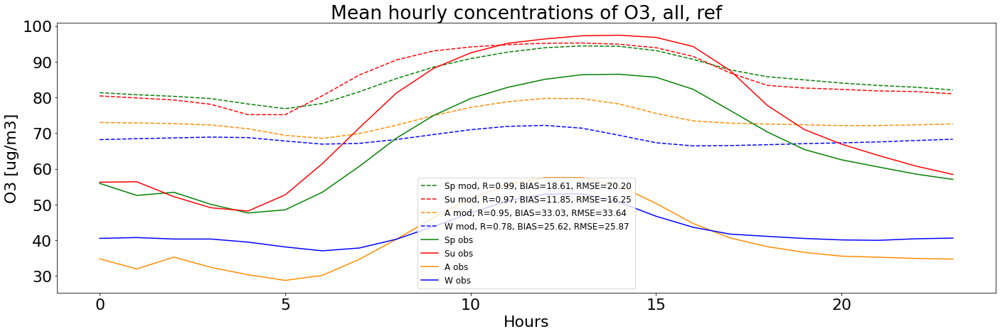

In [11]:
save = True
spec_nick = 'ref'
stat_types_new = ['RB', 'OB', 'UT']

if save:
    print('Plots will be saved at:{}'.format(save_path))
#for t in stat_types_new:
for t in all_types_all:
    #"""
    if t in locs:
        stanice_vyber = list(stat_all.loc[stat_all['loc'] == t].loc[stat_all['coverage'] != 0].index)
    elif t in types:
        stanice_vyber = list(stat_all.loc[stat_all['type'] == t].loc[stat_all['coverage'] != 0].index)
    else:
        stanice_vyber = list(stat_all.loc[stat_all['coverage'] != 0].index.values)[1:]  
    """
        
    if t == 'RB':
            #loc_, type_ = 'R', 'B'
            stanice_vyber = list(stat_all.loc[stat_all['type'] == 'B'].loc[stat_all['loc']=='R'].loc[stat_all['coverage'] != 0].index)
        
    if t == 'OB':
            stanice_vyber = list(stat_all.loc[stat_all['type'] == 'B'].loc[stat_all['loc']=='U'].loc[stat_all['coverage'] != 0].index) + list(stat_all.loc[stat_all['type'] == 'B'].loc[stat_all['loc']=='S'].loc[stat_all['coverage'] != 0].index)
             
    if t == 'UT':
            stanice_vyber = list(stat_all.loc[stat_all['type'] == 'T'].loc[stat_all['loc']=='U'].loc[stat_all['coverage'] != 0].index)
    #"""

    mod_id_jar = data[spec_nick]['MOD'].sel(station = stanice_vyber, time = data[spec_nick].time.dt.month.isin(season_months['spring'])).groupby('time.hour').mean().mean(dim = 'station')
    mod_id_leto = data[spec_nick]['MOD'].sel(station = stanice_vyber, time = data[spec_nick].time.dt.month.isin(season_months['summer'])).groupby('time.hour').mean().mean(dim = 'station')
    mod_id_jesen = data[spec_nick]['MOD'].sel(station = stanice_vyber, time = data[spec_nick].time.dt.month.isin(season_months['autumn'])).groupby('time.hour').mean().mean(dim = 'station')
    mod_id_zima = data[spec_nick]['MOD'].sel(station = stanice_vyber, time = data[spec_nick].time.dt.month.isin(season_months['winter'])).groupby('time.hour').mean().mean(dim = 'station')
    
    obs_id_jar = data[specific[0]]['OBS'].sel(station = stanice_vyber, time = data[specific[0]].time.dt.month.isin(season_months['spring'])).groupby('time.hour').mean().mean(dim = 'station')
    obs_id_leto = data[specific[0]]['OBS'].sel(station = stanice_vyber, time = data[specific[0]].time.dt.month.isin(season_months['summer'])).groupby('time.hour').mean().mean(dim = 'station')
    obs_id_jesen = data[specific[0]]['OBS'].sel(station = stanice_vyber, time = data[specific[0]].time.dt.month.isin(season_months['autumn'])).groupby('time.hour').mean().mean(dim = 'station')
    obs_id_zima = data[specific[0]]['OBS'].sel(station = stanice_vyber, time = data[specific[0]].time.dt.month.isin(season_months['winter'])).groupby('time.hour').mean().mean(dim = 'station')
    
    r_jar = mod_id_jar.to_series().corr(obs_id_jar.to_series())
    r_leto = mod_id_leto.to_series().corr(obs_id_leto.to_series())
    r_jesen = mod_id_jesen.to_series().corr(obs_id_jesen.to_series())
    r_zima = mod_id_zima.to_series().corr(obs_id_zima.to_series())
    
    jar_diff = np.array((mod_id_jar - obs_id_jar).to_series().dropna())
    leto_diff = np.array((mod_id_leto - obs_id_leto).to_series().dropna())
    jesen_diff = np.array((mod_id_jesen - obs_id_jesen).to_series().dropna())
    zima_diff = np.array((mod_id_zima - obs_id_zima).to_series().dropna())
    #if len(jar_diff) != 0:
    jar_rmse = np.sqrt(np.sum(jar_diff**2)/len(jar_diff))
    leto_rmse = np.sqrt(np.sum(leto_diff**2)/len(leto_diff))
    jesen_rmse = np.sqrt(np.sum(jesen_diff**2)/len(jesen_diff))
    zima_rmse = np.sqrt(np.sum(zima_diff**2)/len(zima_diff))
    
    jar_bias, leto_bias = np.sum(jar_diff)/len(jar_diff), np.sum(leto_diff)/len(leto_diff)
    jesen_bias, zima_bias = np.sum(jesen_diff)/len(jesen_diff), np.sum(zima_diff)/len(zima_diff)
    #else:
    #    stat_rmse = np.nan
    
    #name_sta = stat[spec_nick].name.loc[stat[spec_nick].index == i].item()
    
    plt.rcParams['figure.figsize'] = 20,7
    plt.rcParams.update({'font.size': 22})

    plt.plot(mod_id_jar.hour, mod_id_jar[:], color ='green', linestyle='--', label = 'Sp mod, R={:0.2f}, BIAS={:0.2f}, RMSE={:0.2f}'.format(r_jar, jar_bias, jar_rmse)) 
    plt.plot(mod_id_leto.hour, mod_id_leto[:], color ='red', linestyle='--', label = 'Su mod, R={:0.2f}, BIAS={:0.2f}, RMSE={:0.2f}'.format(r_leto, leto_bias, leto_rmse))
    plt.plot(mod_id_jesen.hour, mod_id_jesen[:], color ='darkorange', linestyle='--', label = 'A mod, R={:0.2f}, BIAS={:0.2f}, RMSE={:0.2f}'.format(r_jesen, jesen_bias, jesen_rmse)) 
    plt.plot(mod_id_zima.hour, mod_id_zima[:], color ='blue', linestyle='--', label = 'W mod, R={:0.2f}, BIAS={:0.2f}, RMSE={:0.2f}'.format(r_zima, zima_bias, zima_rmse))
    
    plt.plot(obs_id_jar.hour, obs_id_jar[:], color ='green', label = 'Sp obs') 
    plt.plot(obs_id_leto.hour, obs_id_leto[:], color ='red', label = 'Su obs')
    plt.plot(obs_id_jesen.hour, obs_id_jesen[:], color ='darkorange', label = 'A obs') 
    plt.plot(obs_id_zima.hour, obs_id_zima[:], color ='blue', label = 'W obs')
    
    plt.legend(fontsize=12)                
    plt.title('Mean hourly concentrations of {0}, {1}, {2}'.format(v,t,spec_nick))                               
    plt.xlabel('Hours')
    plt.ylabel('{0} [{1}]'.format(v,units))
    plt.tight_layout()

    if save:
        if not os.path.exists(save_path):
            os.makedirs(save_path)
        plt.savefig('{0}/MH_seasons_{1}_{2}_{3}_stat.png'.format(save_path,v,spec_nick,t), dpi=300) 
    plt.show()                
    plt.close() 

### Normovane Model - station types

Plots will be saved at:/data/teri/validacia/validated/CMAQ2017d02_ref_vs_cop_vs_const/graphs/O3


/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)


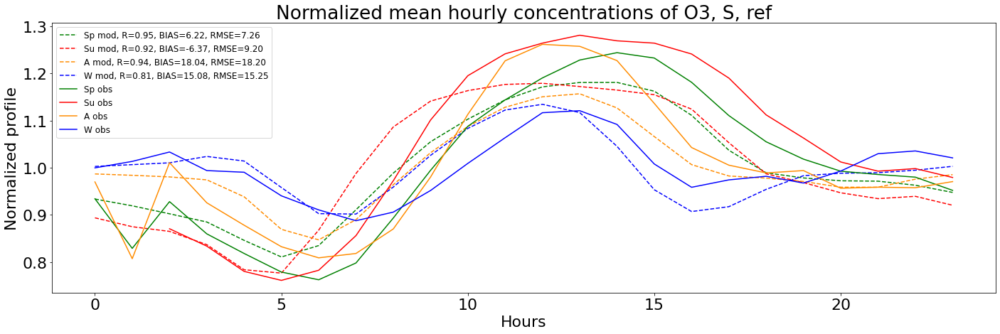

/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)


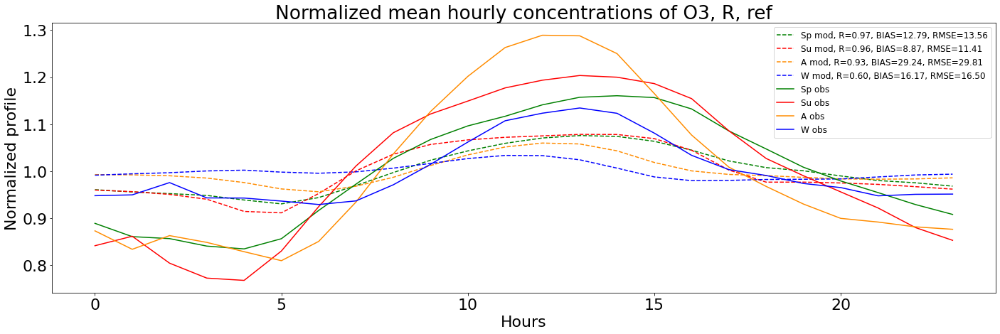

/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)


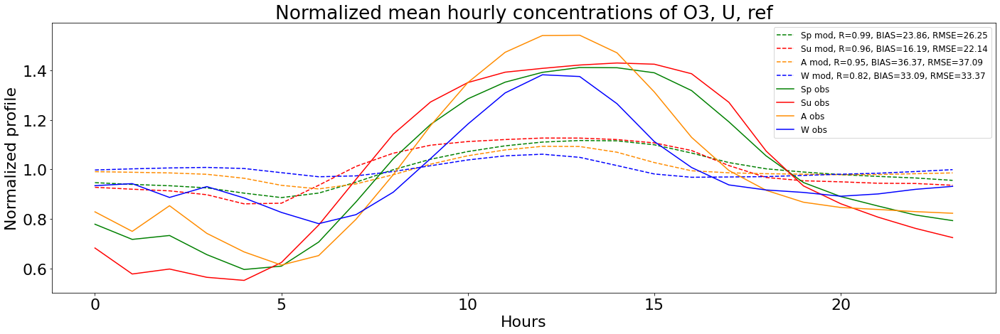

/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)


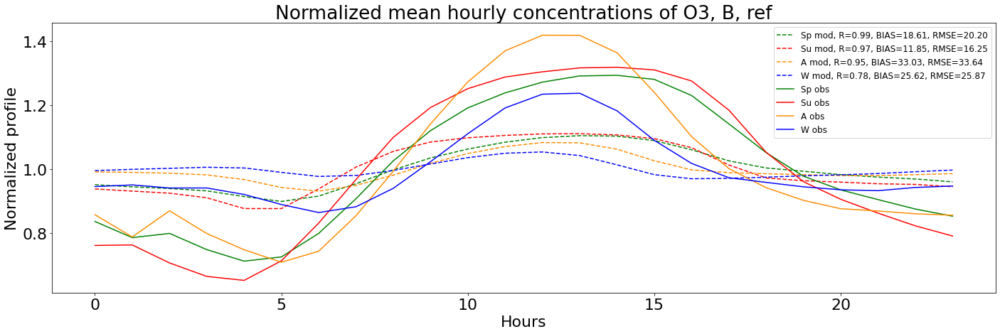

/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)
<ipython-input-41-4e454cc78317>:53: RuntimeWarning: invalid value encountered in double_scalars
  jar_rmse = np.sqrt(np.sum(jar_diff**2)/len(jar_diff))
<ipython-input-41-4e454cc78317>:54: RuntimeWarning: invalid value encountered in double_scalars
  leto_rmse = np.sqrt(np.sum(leto_diff**2)/len(leto_diff))
<ipython-input-41-4e454cc78317>:55: RuntimeWarning: invalid value encountered in double_scalars
  jesen_rmse = np.sqrt(np.sum(jesen_diff**2)/len(jesen_diff))
<ipython-input-41-4e454cc78317>:56: RuntimeWarning: invalid value encountered in double_scalars
  zima_rmse = np.sqrt(np.sum(zima_diff**2)/len(zima_diff))
<ipython-input-41-4e454cc78317>:58: RuntimeWarning: invalid value encountered in double_scalars
  jar_bias, leto_bias = np.sum(jar_diff)/len(jar_diff), np.sum(leto_diff)/len(leto_diff)
<ipython-input-41-4e45

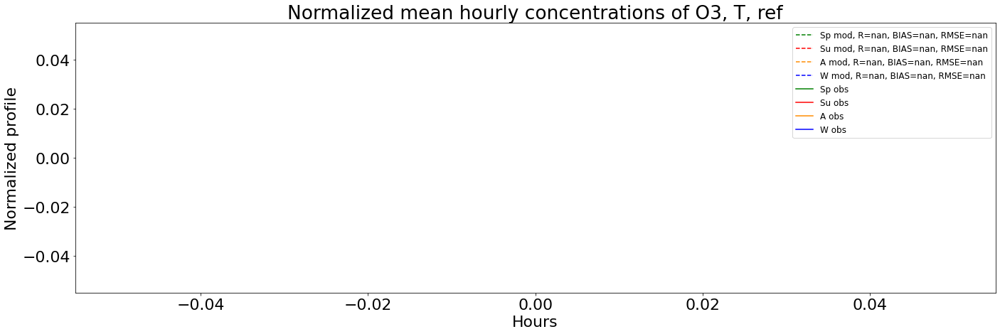

/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)
<ipython-input-41-4e454cc78317>:53: RuntimeWarning: invalid value encountered in double_scalars
  jar_rmse = np.sqrt(np.sum(jar_diff**2)/len(jar_diff))
<ipython-input-41-4e454cc78317>:54: RuntimeWarning: invalid value encountered in double_scalars
  leto_rmse = np.sqrt(np.sum(leto_diff**2)/len(leto_diff))
<ipython-input-41-4e454cc78317>:55: RuntimeWarning: invalid value encountered in double_scalars
  jesen_rmse = np.sqrt(np.sum(jesen_diff**2)/len(jesen_diff))
<ipython-input-41-4e454cc78317>:56: RuntimeWarning: invalid value encountered in double_scalars
  zima_rmse = np.sqrt(np.sum(zima_diff**2)/len(zima_diff))
<ipython-input-41-4e454cc78317>:58: RuntimeWarning: invalid value encountered in double_scalars
  jar_bias, leto_bias = np.sum(jar_diff)/len(jar_diff), np.sum(leto_diff)/len(leto_diff)
<ipython-input-41-4e45

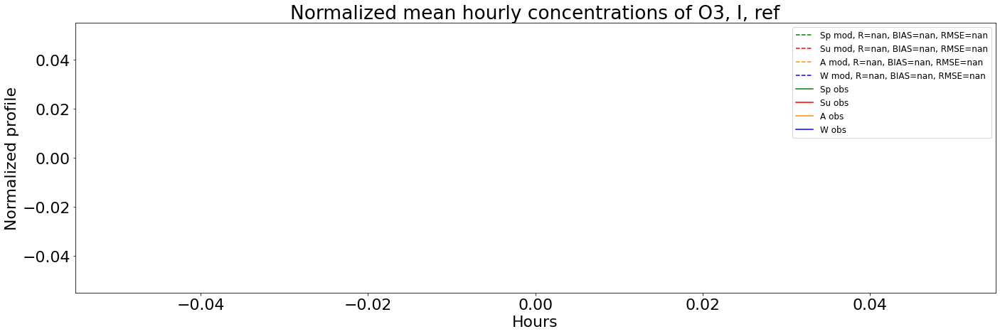

/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)


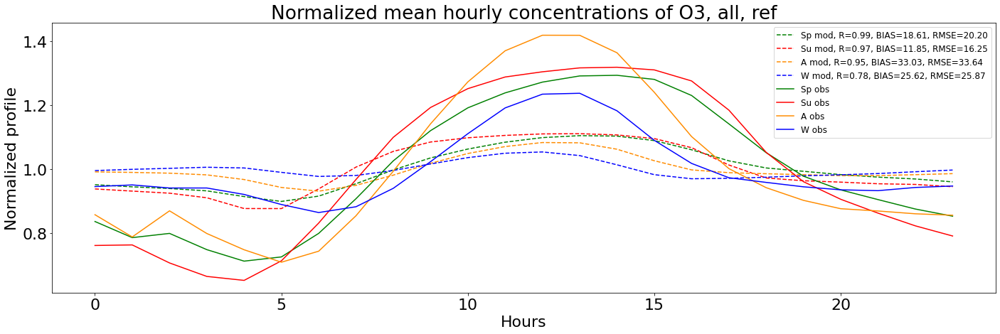

In [41]:
save = True
spec_nick = 'ref'
stat_types_new = ['RB', 'OB', 'UT']

if save:
    print('Plots will be saved at:{}'.format(save_path))
#for t in stat_types_new:
for t in all_types_all:
    #"""
    if t in locs:
        stanice_vyber = list(stat_all.loc[stat_all['loc'] == t].loc[stat_all['coverage'] != 0].index)
    elif t in types:
        stanice_vyber = list(stat_all.loc[stat_all['type'] == t].loc[stat_all['coverage'] != 0].index)
    else:
        stanice_vyber = list(stat_all.loc[stat_all['coverage'] != 0].index.values)[1:]  
    """
        
    if t == 'RB':
            #loc_, type_ = 'R', 'B'
            stanice_vyber = list(stat_all.loc[stat_all['type'] == 'B'].loc[stat_all['loc']=='R'].loc[stat_all['coverage'] != 0].index)
        
    if t == 'OB':
            stanice_vyber = list(stat_all.loc[stat_all['type'] == 'B'].loc[stat_all['loc']=='U'].loc[stat_all['coverage'] != 0].index) + list(stat_all.loc[stat_all['type'] == 'B'].loc[stat_all['loc']=='S'].loc[stat_all['coverage'] != 0].index)
             
    if t == 'UT':
            stanice_vyber = list(stat_all.loc[stat_all['type'] == 'T'].loc[stat_all['loc']=='U'].loc[stat_all['coverage'] != 0].index)
    #"""

    mod_id_jar = data[spec_nick]['MOD'].sel(station = stanice_vyber, time = data[spec_nick].time.dt.month.isin(season_months['spring'])).groupby('time.hour').mean().mean(dim = 'station')
    mod_id_leto = data[spec_nick]['MOD'].sel(station = stanice_vyber, time = data[spec_nick].time.dt.month.isin(season_months['summer'])).groupby('time.hour').mean().mean(dim = 'station')
    mod_id_jar_norm, mod_id_leto_norm = 24*mod_id_jar/mod_id_jar.sum(), 24*mod_id_leto/mod_id_leto.sum()
    mod_id_jesen = data[spec_nick]['MOD'].sel(station = stanice_vyber, time = data[spec_nick].time.dt.month.isin(season_months['autumn'])).groupby('time.hour').mean().mean(dim = 'station')
    mod_id_zima = data[spec_nick]['MOD'].sel(station = stanice_vyber, time = data[spec_nick].time.dt.month.isin(season_months['winter'])).groupby('time.hour').mean().mean(dim = 'station')
    mod_id_jesen_norm, mod_id_zima_norm = 24*mod_id_jesen/mod_id_jesen.sum(), 24*mod_id_zima/mod_id_zima.sum()
    
    obs_id_jar = data[specific[0]]['OBS'].sel(station = stanice_vyber, time = data[specific[0]].time.dt.month.isin(season_months['spring'])).groupby('time.hour').mean().mean(dim = 'station')
    obs_id_leto = data[specific[0]]['OBS'].sel(station = stanice_vyber, time = data[specific[0]].time.dt.month.isin(season_months['summer'])).groupby('time.hour').mean().mean(dim = 'station')
    obs_id_jar_norm, obs_id_leto_norm = 24*obs_id_jar/obs_id_jar.sum(), 24*obs_id_leto/obs_id_leto.sum()
    obs_id_jesen = data[specific[0]]['OBS'].sel(station = stanice_vyber, time = data[specific[0]].time.dt.month.isin(season_months['autumn'])).groupby('time.hour').mean().mean(dim = 'station')
    obs_id_zima = data[specific[0]]['OBS'].sel(station = stanice_vyber, time = data[specific[0]].time.dt.month.isin(season_months['winter'])).groupby('time.hour').mean().mean(dim = 'station')
    obs_id_jesen_norm, obs_id_zima_norm = 24*obs_id_jesen/obs_id_jesen.sum(), 24*obs_id_zima/obs_id_zima.sum()
    
    r_jar = mod_id_jar.to_series().corr(obs_id_jar.to_series())
    r_leto = mod_id_leto.to_series().corr(obs_id_leto.to_series())
    r_jesen = mod_id_jesen.to_series().corr(obs_id_jesen.to_series())
    r_zima = mod_id_zima.to_series().corr(obs_id_zima.to_series())
    
    jar_diff = np.array((mod_id_jar - obs_id_jar).to_series().dropna())
    leto_diff = np.array((mod_id_leto - obs_id_leto).to_series().dropna())
    jesen_diff = np.array((mod_id_jesen - obs_id_jesen).to_series().dropna())
    zima_diff = np.array((mod_id_zima - obs_id_zima).to_series().dropna())
    #if len(jar_diff) != 0:
    jar_rmse = np.sqrt(np.sum(jar_diff**2)/len(jar_diff))
    leto_rmse = np.sqrt(np.sum(leto_diff**2)/len(leto_diff))
    jesen_rmse = np.sqrt(np.sum(jesen_diff**2)/len(jesen_diff))
    zima_rmse = np.sqrt(np.sum(zima_diff**2)/len(zima_diff))
    
    jar_bias, leto_bias = np.sum(jar_diff)/len(jar_diff), np.sum(leto_diff)/len(leto_diff)
    jesen_bias, zima_bias = np.sum(jesen_diff)/len(jesen_diff), np.sum(zima_diff)/len(zima_diff)
    
    #name_sta = stat[spec_nick].name.loc[stat[spec_nick].index == i].item()
    
    plt.rcParams['figure.figsize'] = 20,7
    plt.rcParams.update({'font.size': 22})

    plt.plot(mod_id_jar.hour, mod_id_jar_norm[:], color ='green', linestyle='--', label = 'Sp mod, R={:0.2f}, BIAS={:0.2f}, RMSE={:0.2f}'.format(r_jar, jar_bias, jar_rmse)) 
    plt.plot(mod_id_leto.hour, mod_id_leto_norm[:], color ='red', linestyle='--', label = 'Su mod, R={:0.2f}, BIAS={:0.2f}, RMSE={:0.2f}'.format(r_leto, leto_bias, leto_rmse))
    plt.plot(mod_id_jesen.hour, mod_id_jesen_norm[:], color ='darkorange', linestyle='--', label = 'A mod, R={:0.2f}, BIAS={:0.2f}, RMSE={:0.2f}'.format(r_jesen, jesen_bias, jesen_rmse)) 
    plt.plot(mod_id_zima.hour, mod_id_zima_norm[:], color ='blue', linestyle='--', label = 'W mod, R={:0.2f}, BIAS={:0.2f}, RMSE={:0.2f}'.format(r_zima, zima_bias, zima_rmse))
    
    plt.plot(obs_id_jar.hour, obs_id_jar_norm[:], color ='green', label = 'Sp obs') 
    plt.plot(obs_id_leto.hour, obs_id_leto_norm[:], color ='red', label = 'Su obs')
    plt.plot(obs_id_jesen.hour, obs_id_jesen_norm[:], color ='darkorange', label = 'A obs') 
    plt.plot(obs_id_zima.hour, obs_id_zima_norm[:], color ='blue', label = 'W obs')
    
    plt.legend(fontsize=12)                
    plt.title('Normalized mean hourly concentrations of {0}, {1}, {2}'.format(v,t,spec_nick))                               
    plt.xlabel('Hours')
    plt.ylabel('Normalized profile')
    plt.tight_layout()

    if save:
        if not os.path.exists(save_path):
            os.makedirs(save_path)
        plt.savefig('{0}/MH_norm_seasons_{1}_{2}_{3}.png'.format(save_path,v,spec_nick,t), dpi=300) 
    plt.show()                
    plt.close() 

## Sezonalita 

### Vsetky stanice

In [42]:
save_path = '/data/teri/validacia/validated/{0}/graphs/{1}'.format(folder_name, v)
#ID = list(stat_all.index.values)[:]
ID = list(stat_all.index.values)
fzl = stat[specific[0]][['name','loc','type','coverage']].copy()
zl = stat[specific[0]][['name','loc','type','coverage']].copy()

for i in ID:
    #print(i)
    if i == 'all':
        zima = data['ref']['OBS'].sel(time = data[specific[0]].time.dt.month.isin(season_months['winter'])).mean()
        leto = data['ref']['OBS'].sel(time = data[specific[0]].time.dt.month.isin(season_months['summer'])).mean()
        obs_mean = data['ref']['OBS'].sel(time = data[specific[0]].time.dt.month.isin(season_months['year'])).mean()
    else:
        zima = data['ref']['OBS'].sel(station = i, time = data[specific[0]].time.dt.month.isin(season_months['winter'])).mean()
        leto = data['ref']['OBS'].sel(station = i, time = data[specific[0]].time.dt.month.isin(season_months['summer'])).mean()
        obs_mean = data['ref']['OBS'].sel(station = i, time = data[specific[0]].time.dt.month.isin(season_months['year'])).mean()
    
    fzl.at[i, 'fzl_obs'] = leto/zima
    zl.at[i, 'zl_obs'] = (leto - zima)/obs_mean
    #zl.at[i, 'zl_obs'] = (leto - zima)

    for s in specific:
        if i == 'all':
            zima = data[s]['MOD'].sel(time = data[specific[0]].time.dt.month.isin(season_months['winter'])).mean()
            leto = data[s]['MOD'].sel(time = data[specific[0]].time.dt.month.isin(season_months['summer'])).mean()
            mod_mean = data[s]['MOD'].sel(time = data[specific[0]].time.dt.month.isin(season_months['year'])).mean()
        else:
            zima = data[s]['MOD'].sel(station = i, time = data[s].time.dt.month.isin(season_months['winter'])).mean()
            leto = data[s]['MOD'].sel(station = i, time = data[s].time.dt.month.isin(season_months['summer'])).mean()
            mod_mean = data[s]['MOD'].sel(station = i, time = data[s].time.dt.month.isin(season_months['year'])).mean()
        
        if zima != np.nan and leto != np.nan:
            fzl.at[i, 'fzl_{0}'.format(s)] = leto/zima
            zl.at[i, 'zl_{0}'.format(s)] = (leto - zima)/mod_mean
            #zl.at[i, 'zl_{0}'.format(s)] = (leto - zima)
            
        else:
            fzl.at[i, 'fzl_{0}'.format(s)] = np.nan
            zl.at[i, 'zl_{0}'.format(s)] = np.nan

fzl

/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)
/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)
/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)
/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)
/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)
/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return 

,name,loc,type,coverage,fzl_obs,fzl_ref,fzl_cop,fzl_rh_const,fzl_tot_const
all,all,all,all,89.4157,1.733957,1.251833,1.261820,1.261170,1.255371
11813,"BRATISLAVA, JESENIOVA",S,B,93.6073,2.156959,1.469195,1.486637,1.478381,1.467682
11916,"CHOPOK, EMEP",R,B,46.29,1.204362,1.103803,1.107965,1.109620,1.107201
11952,"GANOVCE, METEO. ST.",R,B,95,1.781693,1.178453,1.188988,1.189763,1.181412
11958,KOJSOVSKA HOLA,R,B,95.2511,1.282580,1.179852,1.186849,1.189430,1.187657
99111,"BRATISLAVA, MAMATEYOVA",U,B,94.8402,2.352758,1.445362,1.458692,1.454409,1.436204
99112,"BRATISLAVA, TRNAVSKE MYTO",U,T,0,NaN,1.469195,1.486637,1.478381,1.467682
99114,"BRATISLAVA, KAMENNE NAM.",U,B,0,NaN,1.469195,1.486637,1.478381,1.467682
99117,BRATISLAVA - RACA,None,None,0,NaN,1.394214,1.405007,1.401186,1.391883
99122,"SENICA, HVIEZDOSLAVOVA",U,T,0,NaN,1.330040,1.337194,1.337060,1.332188


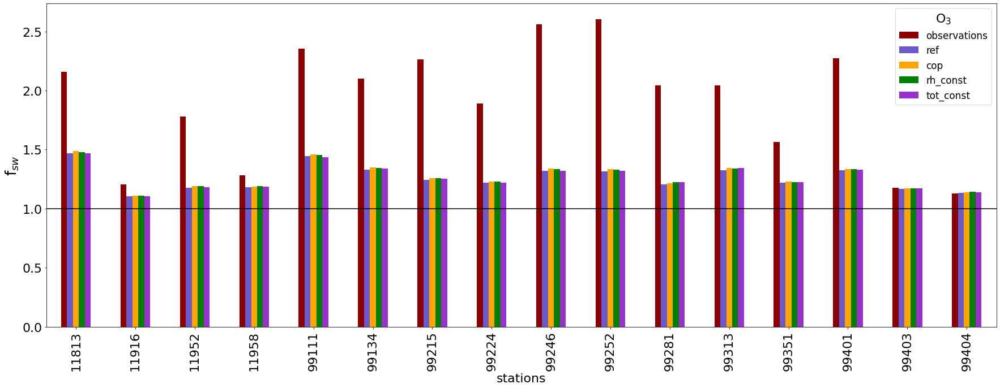

In [43]:
station_list = list(stat_all.loc[stat_all['type'] == 'B'].loc[stat_all.coverage != 0].index.values)

plt.rcParams['figure.figsize'] = 25,10
plt.rcParams.update({'font.size': 22})
# VYBER STANIC Z LISTU
fzl.loc[station_list,list(fzl.columns)[4:]].plot.bar(color=['darkred','slateblue','orange','green','darkorchid'])
# PLOT VSETKYCH STANIC S NAZVAMI (ROZMER ZADAT 40,8) 
#fzl.plot.bar(x = 'name',y = ['fzl_obs','fzl_orig','fzl_rh_const','fzl_tot_const'],color=['darkred','slateblue','orange','green'])
# PLOT VSETKYCH STANIC S KODOM (ROZMER ZADAT 40,8)
#fzl.iloc[:,4:].plot.bar(color=['darkred','slateblue','orange','green'])
plt.legend(["observations", "ref", "cop", 'rh_const','tot_const'],title='O$_{3}$',fontsize=17)
plt.axhline(y=1,color='black')
plt.ylabel('f$_{sw}$', fontsize=26)
plt.xlabel('stations', fontsize=22)
plt.tight_layout()
    
plt.savefig('{0}/fzl_{1}_{2}.png'.format(save_path,folder_name, v), dpi=300)
plt.show()
plt.close()

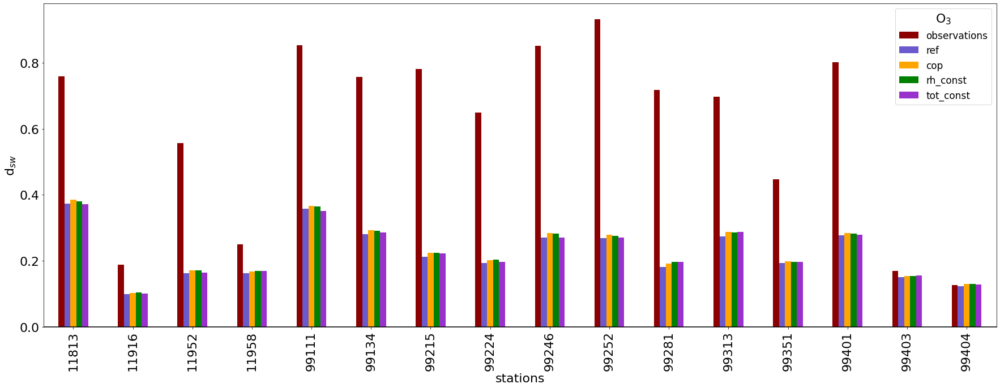

In [44]:
station_list = list(stat_all.loc[stat_all['type'] == 'B'].loc[stat_all.coverage != 0].index.values)

plt.rcParams['figure.figsize'] = 25,10
plt.rcParams.update({'font.size': 22})
zl.loc[station_list,list(zl.columns)[4:]].plot.bar(color=['darkred','slateblue','orange','green','darkorchid'])
#zl.iloc[:,4:].plot.bar(color=['darkred','slateblue','orange','green'])
plt.legend(["observations", "ref", "cop", 'rh_const','tot_const'],title='O$_{3}$',fontsize=17)
plt.axhline(y=0,color='black')
#plt.ylabel('Mean summer - winter conc. $[\mu g . m^{-3}]$', fontsize=22)  #18
plt.ylabel('d$_{sw}$', fontsize=22)  #18
plt.xlabel('stations', fontsize=22)
plt.tight_layout()
    
plt.savefig('{0}/dws_{1}_{2}.png'.format(save_path,folder_name,v), dpi=300)
plt.show()
plt.close()

### Typy stanic 

In [45]:
fzl_types = pd.DataFrame(index = all_types, columns = ['count']+list(fzl.columns)[3:], dtype = 'float64')
zl_types = pd.DataFrame(index = all_types, columns = ['count']+list(zl.columns)[3:], dtype = 'float64')
for t in all_types:
    if t in locs:
        col = 'loc'
    else:
        col = 'type'
        
    stanice_vyber = list(stat_all.loc[stat_all[col] == t].loc[stat_all['coverage'] != 0].index)
    fzl_types.at[t,'count'], zl_types.at[t,'count']  = len(stanice_vyber), len(stanice_vyber)
    obs = data['ref']['OBS'].sel(station = stanice_vyber, time = data['ref'].time.dt.month.isin(season_months['year'])).to_series()
    zima = data['ref']['OBS'].sel(station = stanice_vyber, time = data['ref'].time.dt.month.isin(season_months['winter'])).mean()
    leto = data['ref']['OBS'].sel(station = stanice_vyber, time = data['ref'].time.dt.month.isin(season_months['summer'])).mean()    
    coverage = 100*(len(obs) - obs.isna().sum())/len(obs)
    fzl_types.at[t,'coverage'], zl_types.at[t,'coverage'] = coverage, coverage
    obs_mean = np.mean(obs)
    
    fzl_types.at[t, 'fzl_obs'] = leto/zima
    zl_types.at[t, 'zl_obs'] = (leto-zima)/obs_mean
    #zl_types.at[t, 'zl_obs'] = (leto-zima)
      
    for s in specific:
        zima = data[s]['MOD'].sel(station = stanice_vyber, time = data[s].time.dt.month.isin(season_months['winter'])).mean()
        leto = data[s]['MOD'].sel(station = stanice_vyber, time = data[s].time.dt.month.isin(season_months['summer'])).mean()
        mod_mean = data[s]['MOD'].sel(station = stanice_vyber, time = data['ref'].time.dt.month.isin(season_months['year'])).mean()
        
        fzl_types.at[t, 'fzl_{0}'.format(s)] = leto/zima
        zl_types.at[t, 'zl_{0}'.format(s)] = (leto-zima)/obs_mean
        #zl_types.at[t, 'zl_{0}'.format(s)] = (leto-zima)
    
        
zl_types

/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)
<ipython-input-45-7cf6d851fda5>:14: RuntimeWarning: invalid value encountered in long_scalars
  coverage = 100*(len(obs) - obs.isna().sum())/len(obs)


,count,coverage,zl_obs,zl_ref,zl_cop,zl_rh_const,zl_tot_const
S,1.0,93.607306,0.759414,0.418216,0.427256,0.422026,0.405196
R,6.0,86.622907,0.281875,0.203584,0.210433,0.211714,0.207399
U,9.0,90.811771,0.738720,0.378600,0.393199,0.392207,0.381634
B,16.0,89.415668,0.550370,0.307271,0.318182,0.317857,0.309494
T,0.0,NaN,NaN,NaN,NaN,NaN,NaN
I,0.0,NaN,NaN,NaN,NaN,NaN,NaN


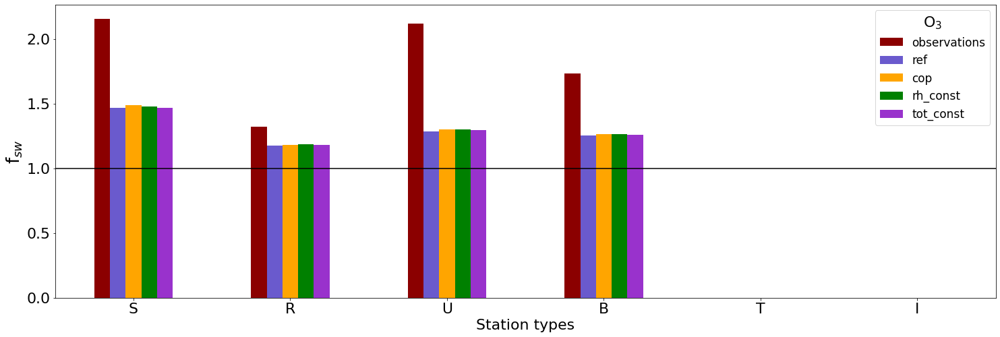

In [46]:
plt.rcParams['figure.figsize'] = 25,8
plt.rcParams.update({'font.size': 22})
fzl_types.iloc[:,2:].plot.bar(color=['darkred','slateblue','orange','green','darkorchid'], rot=0)
plt.legend(["observations", "ref", "cop", 'rh_const','tot_const'],title='O$_{3}$',fontsize=17)
plt.axhline(y=1,color='black')
plt.ylabel('f$_{sw}$', fontsize=26)
plt.xlabel('Station types', fontsize=22)
    
plt.savefig('{0}/fws_station_types_{1}_{2}.png'.format(save_path,folder_name,v), dpi=300)
plt.show()
plt.close()

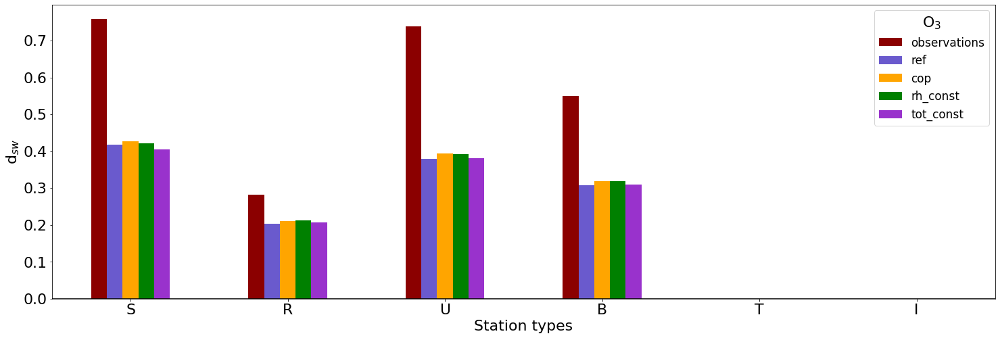

In [47]:
plt.rcParams['figure.figsize'] = 25,8
plt.rcParams.update({'font.size': 22})
zl_types.iloc[:,2:].plot.bar(color=['darkred','slateblue','orange','green','darkorchid'], rot=0)
plt.legend(["observations", "ref", "cop", 'rh_const','tot_const'],title='O$_{3}$',fontsize=17)
plt.axhline(y=0,color='black')
#plt.ylabel('Mean summer - winter conc. $[\mu g . m^{-3}]$', fontsize=22)  #18
plt.ylabel('d$_{sw}$', fontsize=22)  #18
plt.xlabel('Station types', fontsize=22)
    
#plt.savefig('{0}/ws_station_types_{1}_CMAQ2017d02.png'.format(save_path,v), dpi=300)
plt.savefig('{0}/dws_station_types_{1}_{2}.png'.format(save_path,folder_name, v), dpi=300)
plt.show()
plt.close()

# PM10

In [48]:
v = 'PM10'
v2 = 'PM'
path = {'cop':'/data/oko/dusan/POST/WB_2017_d02_CAMS_13_res_heat_PM_2017',
        'ref':'/data/oko/dusan/POST/WB_2020_PM_2017',
       'rh_const':'/data/oko/dusan/POST/WB_const_PM_2017',
       'tot_const':'/data/oko/dusan/POST/WB_totcons_{0}_2017'.format(v2)} # prisluchajuca cesta k suboru

#for i in range(0, len(specific)):
for i, key in enumerate(specific):
    print(key)
    stat[key], data[key] = vali.validation(path[key], model_name[i], grid_name[i], start_date[i], end_date[i], v)

ref
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=11813 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=11916 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=11952 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=11958 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
sel

Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=99323 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=99325 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=99326 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=99334 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select 

/data/teri/validacia/validacia_v2.py:237: RuntimeWarning: Mean of empty slice
  stat['obs_mean'][s] = np.nanmean(obs_all[s])


Validation of PM10 done in 67.09776282310486 seconds
cop
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=11813 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=11916 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=11952 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=11958 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making conn

Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=99316 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=99323 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=99325 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=99326 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select 

Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=99139 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=99214 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=99215 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=99217 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select 

Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=11916 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=11952 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=11958 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=99111 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select 

Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=99325 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=99326 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=99334 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=99351 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select 

In [57]:
for i, key in enumerate(specific):
    print(i, key)

0 ref
1 cop
2 rh_const
3 tot_const


## Statistika

### Vsetky stanice

In [49]:
my_season = 'year'

stat_all = stat[specific[0]][['name','loc','type','coverage','obs_mean']].copy()

for s in statistiky:
    for i in specific:
        stat_all['{0}_{1}'.format(s,i)] = pd.Series(dtype = 'float64')

for i in specific:   
    for s in stat_all.index:
        
        if s == 'all':
            obs = data[i]['OBS'].sel(time = data[i].time.dt.month.isin(season_months[my_season])).to_series()
            mod = data[i]['MOD'].sel(time = data[i].time.dt.month.isin(season_months[my_season])).to_series()
        else: 
            obs = data[i]['OBS'].sel(station = s, time = data[i].time.dt.month.isin(season_months[my_season])).to_series()
            mod = data[i]['MOD'].sel(station = s, time = data[i].time.dt.month.isin(season_months[my_season])).to_series()

        stat_all.at[s,'R_{0}'.format(i)] = obs.corr(mod)
        diff = (mod - obs).to_numpy()
        diff = diff[~np.isnan(diff)]
        obs[obs == 0] = np.nan
        obs_ = obs[~np.isnan(obs)]
        stat_all.at[s, 'obs_mean'] = np.nanmean(obs)
        podiel = (mod/obs).to_numpy()
        podiel = podiel[~np.isnan(podiel)]
        podiel_fac2 = podiel[podiel <= 2]
        podiel_fac2 = podiel_fac2[podiel_fac2 >= 0.5]
        
        if len(diff) != 0:
            stat_all.at[s, 'MB_{0}'.format(i)] = np.sum(diff)/len(diff)
            #stat_all.at[s, 'MPE_{0}'.format(i)] = 100*np.sum(diff/obs_)/len(diff)
            #stat_all.at[s,'MGE_{0}'.format(i)] = np.sum(np.absolute(diff))/len(diff)
            #stat_all.at[s,'MGPE_{0}'.format(i)] = 100*np.sum(np.absolute(diff/obs_))/len(diff)
            stat_all.at[s,'RMSE_{0}'.format(i)] = np.sqrt(np.sum(diff**2)/len(diff))
            #stat_all.at[s,'RMSPE_{0}'.format(i)] = 100*np.sqrt(np.sum((diff/obs_)**2)/len(diff))
            stat_all.at[s,'FAC2_{0}'.format(i)] = 100*len(podiel_fac2)/len(podiel)

#stat_all.loc[stat_all.coverage != 0]
#stat_all.loc[stat_all.r_full >= 0.5]
stat_all.to_csv('/data/teri/validacia/validated/{0}/tabulky/validation_{1}_all_{2}_2.csv'.format(folder_name,v,my_season))
stat_all.loc[stat_all.coverage != 0]

<ipython-input-49-036312436282>:24: RuntimeWarning: Mean of empty slice
  stat_all.at[s, 'obs_mean'] = np.nanmean(obs)


,name,loc,type,coverage,obs_mean,R_ref,R_cop,R_rh_const,R_tot_const,MB_ref,MB_cop,MB_rh_const,MB_tot_const,RMSE_ref,RMSE_cop,RMSE_rh_const,RMSE_tot_const,FAC2_ref,FAC2_cop,FAC2_rh_const,FAC2_tot_const
all,all,all,all,97.2845,26.0621,0.529540,0.532667,0.478101,0.462657,-19.312817,-19.130687,-19.237908,-18.898597,27.965088,27.787312,28.218802,28.051712,17.514846,18.298546,18.983394,21.614693
11813,"BRATISLAVA, JESENIOVA",S,B,96.8379,20.3322,0.615566,0.625820,0.586744,0.570150,-12.541160,-12.342440,-12.437256,-12.063339,19.301899,19.060145,19.532221,19.375812,31.734056,32.771425,34.787222,37.805022
99111,"BRATISLAVA, MAMATEYOVA",U,B,98.7443,23.0763,0.496586,0.502871,0.481798,0.463747,-15.194473,-15.048873,-15.093900,-14.743017,22.362787,22.212236,22.410684,22.268555,27.456647,27.930636,29.017341,31.456647
99112,"BRATISLAVA, TRNAVSKE MYTO",U,T,89.5776,25.3066,0.524199,0.527618,0.504936,0.455721,-17.574490,-17.348477,-17.470277,-17.025720,23.670962,23.456968,23.763252,23.663223,20.950682,21.855486,21.422200,25.066905
99114,"BRATISLAVA, KAMENNE NAM.",U,B,83.4475,18.625,0.392668,0.394276,0.412399,0.382930,-12.128195,-12.032387,-11.719817,-11.296725,15.501654,15.420159,15.112110,14.896946,25.950752,26.265390,28.960328,32.311902
99122,"SENICA, HVIEZDOSLAVOVA",U,T,95.4566,24.8802,0.595418,0.598616,0.571502,0.551904,-17.971938,-17.882627,-17.915528,-17.585006,23.724000,23.622248,23.826428,23.658879,16.455393,16.754365,17.149007,19.756039
99123,"TRNAVA, KOLLAROVA",U,T,94.4064,24.4349,0.621223,0.625707,0.590232,0.552795,-17.033900,-16.864538,-16.957815,-16.637424,23.260480,23.070784,23.445724,23.413336,21.571947,22.261185,22.732769,25.465538
99128,"TRENCIN, HASICSKA",U,T,98.4475,29.8362,0.529902,0.531046,0.472879,0.452694,-22.648016,-22.462986,-22.582027,-22.158145,29.375388,29.194824,29.638317,29.384174,13.659555,14.517625,14.981447,18.181818
99132,"MALACKY, MIEROVE NAMESTIE",U,T,98.4132,22.9419,0.573994,0.579934,0.544825,0.528630,-15.769703,-15.671032,-15.725919,-15.425991,21.434427,21.315942,21.585877,21.438171,21.992808,22.421993,22.827978,25.345088
99134,"NITRA, JANIKOVCE",U,B,97.7511,23.8669,0.582420,0.592766,0.531786,0.516461,-16.574177,-16.396606,-16.509954,-16.222052,23.755626,23.540590,24.042595,23.924981,21.020670,21.791428,22.854140,25.435011


In [59]:
#stat_all.loc[stat_all.coverage != 0]
stat_all.loc[stat_all.R_ref <= 0.3]
v

'PM10'

In [60]:
ID_B = list(stat_all.loc[stat_all.type == 'B'].loc[stat_all.coverage != 0].index.values)
#ID_B

### Typy stanic

In [50]:
my_season = 'year'

#stat_types_mine = ['all','RB', 'OB', 'UT', 'I']
stat_types_mine = ['all','RB', 'OB', 'UT']
stat_types = pd.DataFrame(index = stat_types_mine, columns = ['n']+list(stat_all.columns)[3:])

for i in specific:
    for t in stat_types_mine:
        if t == 'RB':
            #loc_, type_ = 'R', 'B'
            stanice_vyber = list(stat_all.loc[stat_all['type'] == 'B'].loc[stat_all['loc']=='R'].loc[stat_all['coverage'] != 0].index)
        
        if t == 'OB':
            stanice_vyber = list(stat_all.loc[stat_all['type'] == 'B'].loc[stat_all['loc']=='U'].loc[stat_all['coverage'] != 0].index) + list(stat_all.loc[stat_all['type'] == 'B'].loc[stat_all['loc']=='S'].loc[stat_all['coverage'] != 0].index)
             
        if t == 'UT':
            stanice_vyber = list(stat_all.loc[stat_all['type'] == 'T'].loc[stat_all['loc']=='U'].loc[stat_all['coverage'] != 0].index)
            
        if t == 'I':
            stanice_vyber = list(stat_all.loc[stat_all['type'] == 'I'].loc[stat_all['coverage'] != 0].index)
            
        if t == 'all':
            stanice_vyber = list(stat_all.loc[stat_all.coverage != 0].index.values)[1:]
            
        #stat_types.at[t,'count'] = len(stat_all.loc[stat_all['type'] == type_].loc[stat_all['loc']==loc_])
        #stanice_vyber = list(stat_all.loc[stat_all[col] == t].loc[stat_all['coverage'] != 0].index)
        stat_types.at[t,'n'] = len(stanice_vyber)
        obs = data[i]['OBS'].sel(station = stanice_vyber, time = data[i].time.dt.month.isin(season_months[my_season])).to_series()
        mod = data[i]['MOD'].sel(station = stanice_vyber, time = data[i].time.dt.month.isin(season_months[my_season])).to_series()

        obs[obs == 0] = np.nan
        obs_ = obs[~np.isnan(obs)]
        podiel = (mod/obs).to_numpy()
        podiel = podiel[~np.isnan(podiel)]
        podiel_fac2 = podiel[podiel <= 2]
        podiel_fac2 = podiel_fac2[podiel_fac2 >= 0.5]
        
        stat_types.at[t,'coverage'] = 100*(len(obs) - obs.isna().sum())/len(obs)
        stat_types.at[t,'obs_mean'] = np.nanmean(obs)
        stat_types.at[t,'R_{0}'.format(i)] = obs.corr(mod)
        diff = (mod - obs).to_numpy()
        diff = diff[~np.isnan(diff)]
        stat_types.at[t, 'MB_{0}'.format(i)] = np.sum(diff)/len(diff)
        #stat_types.at[t, 'MPE_{0}'.format(i)] = 100*np.sum(diff/obs_)/len(diff)
        #stat_types.at[t,'MGE_{0}'.format(i)] = np.sum(np.absolute(diff))/len(diff)
        #stat_types.at[t,'MGPE_{0}'.format(i)] = 100*np.sum(np.absolute(diff/obs_))/len(diff)
        stat_types.at[t,'RMSE_{0}'.format(i)] = np.sqrt(np.sum(diff**2)/len(diff))
        #stat_types.at[t,'RMSPE_{0}'.format(i)] = 100*np.sqrt(np.sum((diff/obs_)**2)/len(diff))
        stat_types.at[t,'FAC2_{0}'.format(i)] = 100*len(podiel_fac2)/len(podiel)
        
stat_types

,n,coverage,obs_mean,R_ref,R_cop,R_rh_const,R_tot_const,MB_ref,MB_cop,MB_rh_const,MB_tot_const,RMSE_ref,RMSE_cop,RMSE_rh_const,RMSE_tot_const,FAC2_ref,FAC2_cop,FAC2_rh_const,FAC2_tot_const
all,33,97.2845,26.0621,0.52954,0.532667,0.478101,0.462657,-19.3128,-19.1307,-19.2379,-18.8986,27.9651,27.7873,28.2188,28.0517,17.5148,18.2985,18.9834,21.6147
RB,3,98.2953,18.2403,0.618927,0.622154,0.600676,0.583116,-12.5189,-12.4382,-12.5008,-12.2623,17.2846,17.1946,17.3823,17.2999,20.8385,21.3456,21.4347,24.3342
OB,18,97.3732,25.3893,0.516246,0.51892,0.455211,0.44457,-18.6982,-18.5221,-18.6357,-18.2848,27.9448,27.7799,28.2586,28.0675,18.6182,19.4408,20.38,22.9884
UT,11,96.7144,28.3802,0.539889,0.542664,0.490338,0.468418,-21.3016,-21.0825,-21.1932,-20.8391,29.2198,29.0036,29.4333,29.2677,15.4495,16.2768,16.7318,19.3811


In [62]:
stat_types_diff = stat_types.copy()
for s in statistiky:
    for e in ['cop','rh_const','tot_const']:
        stat_types_diff['{0}_{1}'.format(s,e)] = stat_types['{0}_{1}'.format(s,e)] - stat_types['{0}_ref'.format(s)]

stat_types_diff.to_csv('/data/teri/validacia/validated/{0}/tabulky/stat_types_validation_{1}_{2}_fac2.csv'.format(folder_name,v,my_season))

stat_types_diff

,n,coverage,obs_mean,R_ref,R_cop,R_rh_const,R_tot_const,MB_ref,MB_cop,MB_rh_const,MB_tot_const,RMSE_ref,RMSE_cop,RMSE_rh_const,RMSE_tot_const,FAC2_ref,FAC2_cop,FAC2_rh_const,FAC2_tot_const
all,33,97.2845,26.0621,0.52954,0.00312729,-0.0514382,-0.0668825,-19.3128,0.18213,0.0749097,0.41422,27.9651,-0.177776,0.253714,0.0866246,17.5148,0.7837,1.46855,4.09985
RB,3,98.2953,18.2403,0.618927,0.0032266,-0.0182509,-0.0358115,-12.5189,0.0806591,0.0180935,0.256527,17.2846,-0.0900104,0.0976719,0.0152732,20.8385,0.507123,0.59616,3.49566
OB,18,97.3732,25.3893,0.516246,0.00267393,-0.0610348,-0.0716761,-18.6982,0.176082,0.0624737,0.413351,27.9448,-0.16492,0.313764,0.122697,18.6182,0.822598,1.76178,4.37025
UT,11,96.7144,28.3802,0.539889,0.00277555,-0.0495512,-0.0714712,-21.3016,0.219172,0.108394,0.462557,29.2198,-0.216162,0.213505,0.0479151,15.4495,0.827306,1.28227,3.93158


### Stat. tabulka seasons

In [51]:
stat_season = pd.DataFrame(index = season, columns = ['coverage','obs_mean'] + statistiky)
stat_season_all = {}
for i in ['ref','cop','rh_const','tot_const']:
    stat_season_all[i] = {}
    for t in all_types_all:
        if t in locs:
            stanice_vyber = list(stat_all.loc[stat_all['loc'] == t].loc[stat_all['coverage'] != 0].index)
        elif t in types:
            stanice_vyber = list(stat_all.loc[stat_all['type'] == t].loc[stat_all['coverage'] != 0].index)
        else:
            stanice_vyber = list(stat_all.loc[stat_all['coverage'] != 0].index.values)[1:]
            
        for s in season:   
            obs = data[i]['OBS'].sel(station = stanice_vyber, time = data[i].time.dt.month.isin(season_months[s])).to_series()
            mod = data[i]['MOD'].sel(station = stanice_vyber, time = data[i].time.dt.month.isin(season_months[s])).to_series()
        
            obs[obs == 0] = np.nan
            obs_ = obs[~np.isnan(obs)]
            podiel = (mod/obs).to_numpy()
            podiel = podiel[~np.isnan(podiel)]
            podiel_fac2 = podiel[podiel <= 2]
            podiel_fac2 = podiel_fac2[podiel_fac2 >= 0.5]
            
            stat_season.at[s,'coverage'] = 100*(len(obs) - obs.isna().sum())/len(obs)
            stat_season.at[s,'obs_mean'] = np.nanmean(obs)
            stat_season.at[s,'R'.format(i)] = obs.corr(mod)
            diff = (mod - obs).to_numpy()
            diff = diff[~np.isnan(diff)]
            stat_season.at[s, 'MB'.format(i)] = np.sum(diff)/len(diff)
            #stat_season.at[s,'MGE'.format(i)] = np.sum(np.absolute(diff))/len(diff)
            stat_season.at[s,'RMSE'.format(i)] = np.sqrt(np.sum(diff**2)/len(diff))
            if len(podiel) != 0:
                stat_season.at[s,'FAC2'.format(i)] = 100*len(podiel_fac2)/len(podiel)
        
        stat_season_all[i][t] = stat_season.copy()
        #stat_season.to_csv('/data/teri/validacia/validated/{0}/tabulky/stat_seasons_{1}_CMAQ2017d02_{2}_{3}.csv'.format(folder_name,v,i,t))
stat_season_all

{'ref': {'S':        coverage obs_mean         R       MB     RMSE     FAC2
  spring  97.4789  23.8421  0.224696 -16.7496  23.7251   22.797
  summer  98.4752   20.132  0.232098 -16.6744  21.3679  6.27012
  autumn  98.1227  23.8266  0.358279 -17.3823  23.7791  21.3719
  winter  93.9969   44.756  0.458554 -33.4252  45.4481  20.8669
  year     97.032  27.8847  0.484598  -20.873   29.921   17.749,
  'R':        coverage obs_mean         R       MB     RMSE     FAC2
  spring   97.962  16.4245  0.473406 -10.3031  12.8324  28.1708
  summer  98.1129     13.8  0.252596 -10.5518  12.5076  9.47838
  autumn  98.4585  15.6443  0.570059 -10.5517  13.5784   21.423
  winter  98.6574  27.2168  0.636392 -18.7525   26.362  24.3548
  year    98.2953  18.2403  0.618927 -12.5189  17.2846  20.8385,
  'U':        coverage obs_mean         R       MB     RMSE     FAC2
  spring  97.0729   22.142  0.393031 -15.2096  19.9681  22.4586
  summer  97.0847   18.289  0.198119 -14.8759  17.9667   7.0424
  autumn   97.96

In [64]:
#stat_season_all

In [52]:
typ = 'B'
stat_season_diff = pd.DataFrame(index = season, columns = list(stat_all.columns)[3:])
for s in statistiky:
    stat_season_diff['{0}_ref'.format(s)] = stat_season_all['ref']['B'][s].copy()
    stat_season_diff['coverage'.format(s)] = stat_season_all['ref']['B']['coverage'].copy()
    stat_season_diff['obs_mean'.format(s)] = stat_season_all['ref']['B']['obs_mean'].copy()
    for e in ['cop', 'rh_const','tot_const']:
        stat_season_diff['{0}_{1}'.format(s,e)] = stat_season_all[e]['B'][s] - stat_season_all['ref']['B'][s]

stat_season_diff.to_csv('/data/teri/validacia/validated/{0}/tabulky/seasons_validation_{1}_{2}_fac2.csv'.format(folder_name,typ,v))

stat_season_diff

,coverage,obs_mean,R_ref,R_cop,R_rh_const,R_tot_const,MB_ref,MB_cop,MB_rh_const,MB_tot_const,RMSE_ref,RMSE_cop,RMSE_rh_const,RMSE_tot_const,FAC2_ref,FAC2_cop,FAC2_rh_const,FAC2_tot_const
spring,98.7664,19.656,0.396604,-0.00429245,-0.00726594,-0.045499,-12.9307,0.049096,0.280722,-0.0843928,17.0353,-0.0236247,-0.189311,0.205543,25.4586,0.323172,2.17705,0.222727
summer,97.3667,16.5038,0.216857,-0.000124322,-0.0141398,-0.0446061,-13.1592,0.188698,0.692447,1.22892,16.0078,-0.156285,-0.552367,-0.932016,8.07363,1.14958,5.15649,10.2399
autumn,98.574,20.6456,0.453581,-0.00185272,-0.00682753,-0.0228909,-14.6482,0.0438917,0.209062,0.902223,19.9815,-0.0267324,-0.132122,-0.608861,21.2011,0.34948,1.67662,6.36585
winter,95.2756,41.4363,0.458168,-0.00250798,-0.0469054,-0.0611704,-31.1395,0.378716,-1.00678,-0.516352,44.2725,-0.309788,1.06166,0.812431,21.0103,1.31661,-2.83222,0.023139
year,97.5049,24.3597,0.524726,0.00314992,-0.0561289,-0.0664582,-17.8083,0.16234,0.0560822,0.390766,26.6735,-0.156297,0.290516,0.111467,18.9379,0.777165,1.59391,4.2443


## Hodinovy chod koncentracii 

In [14]:
### USER INPUT
# Choose stations to plot
ID = list(stat_all.loc[stat_all['coverage']!=0].index.values)[1:]    # all stations
#ID = [11813,11916]    # selected stations
save = False   # save the plots?

plot_from = '2017-01-01'
plot_until = '2017-01-01'  

save_path = '{0}/validated/{1}/graphs/{2}'.format(vali_path, folder_name,v)

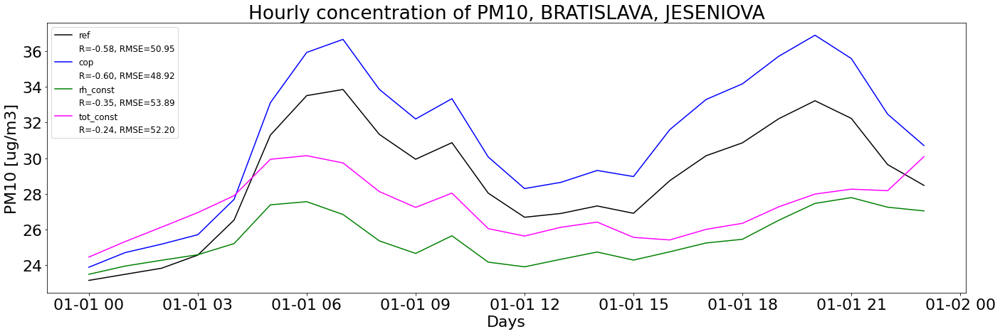

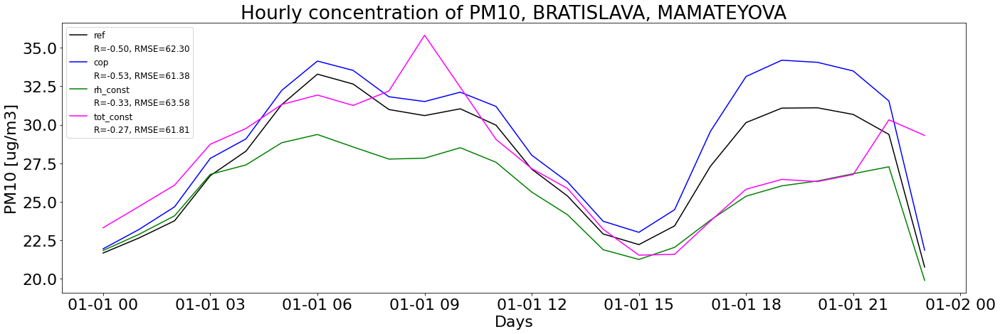

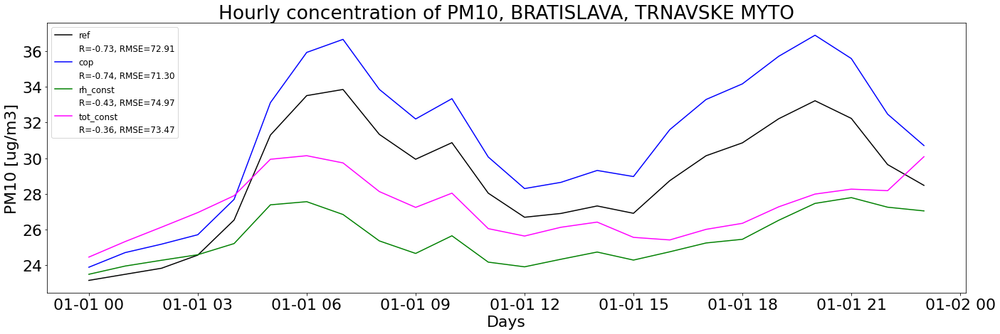

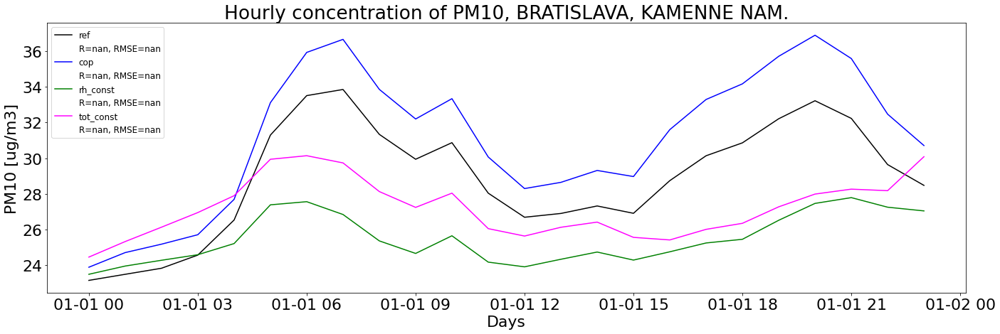

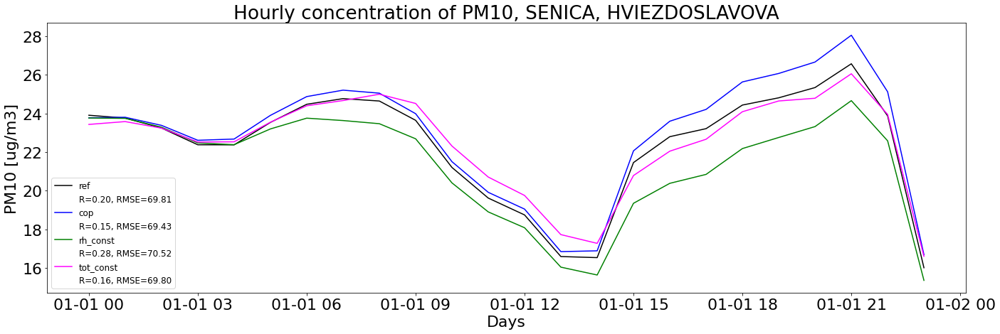

...

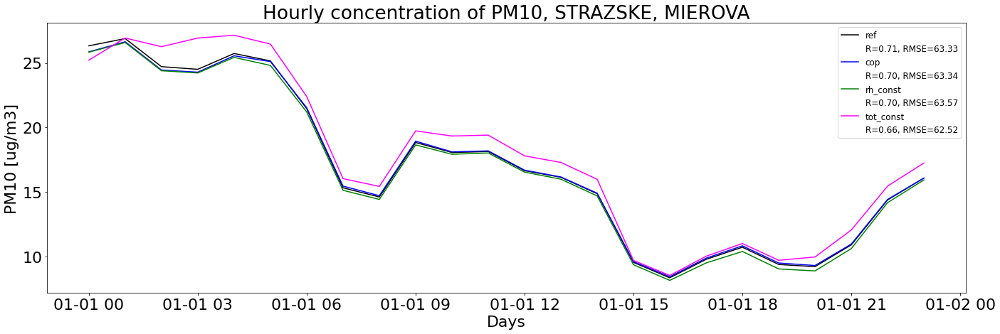

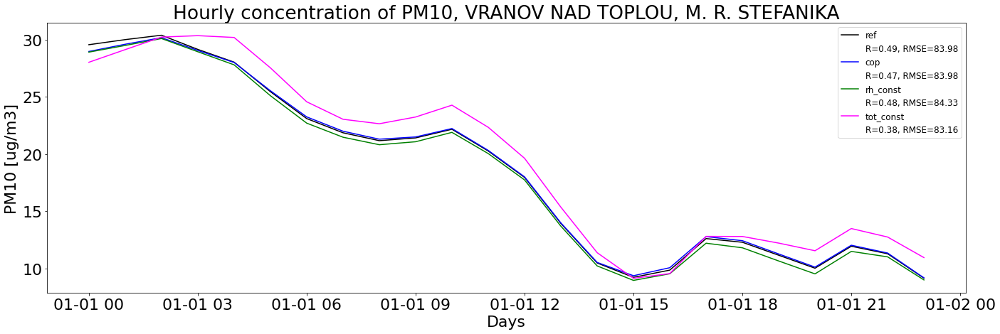

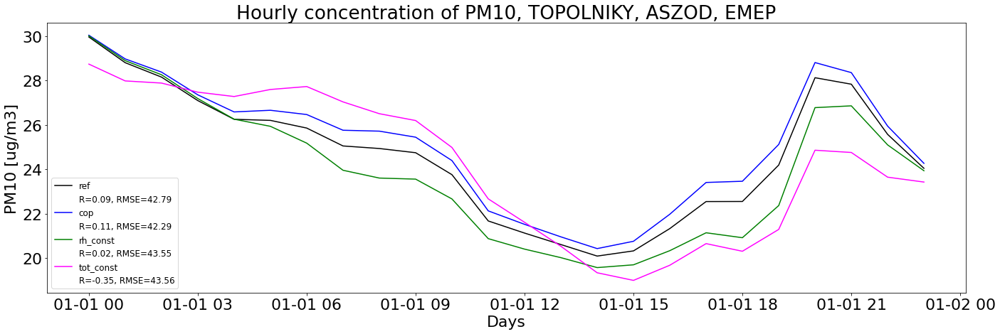

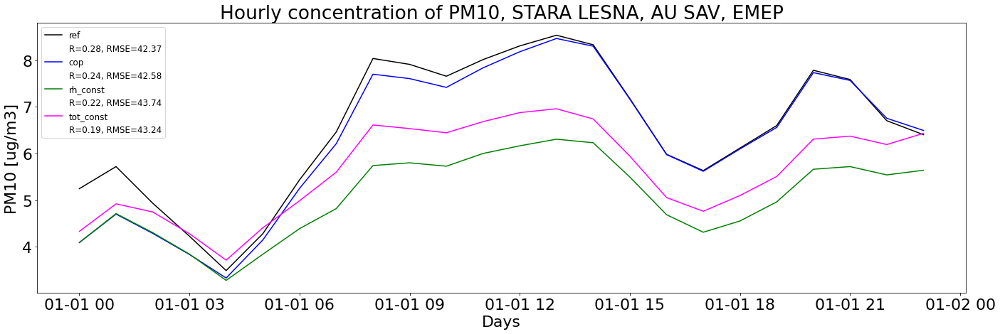

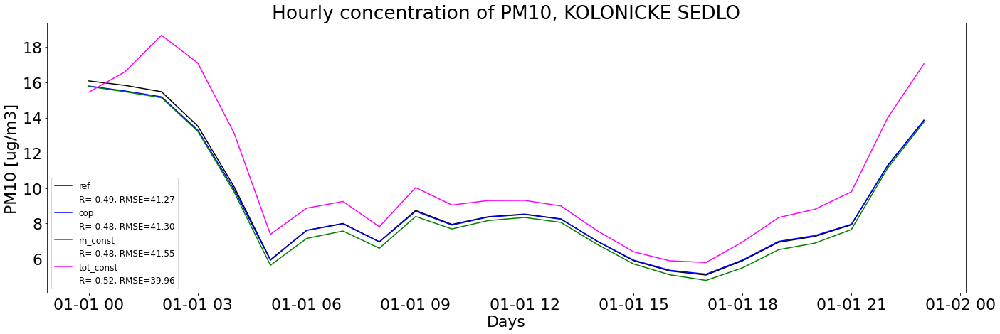

In [15]:
if save:
    print('Plots will be saved at:{}'.format(save_path))
for i in ID:    
    
    obs_id = data[specific[0]]['OBS'].sel(station = i).to_series()[plot_from:plot_until]
    name_sta = stat[specific[0]].name.loc[stat[specific[0]].index == i].item()
    
    plt.rcParams['figure.figsize'] = 20,7
    plt.rcParams.update({'font.size': 22})

    #plt.plot(obs_id.index[:], obs_id[:], color =obs_color, label = 'observations')                
    for s in specific:
        mod_id = data[s]['MOD'].sel(station = i).to_series()[plot_from:plot_until]
        
        stat_corr = mod_id.corr(obs_id)
        stat_diff = np.array((mod_id - obs_id).dropna())
        if len(stat_diff) != 0:
            stat_rmse = np.sqrt(np.sum(stat_diff**2)/len(stat_diff))
        else:
            stat_rmse = np.nan
            
        plt.plot(obs_id.index[:], mod_id[:], color = color_list[s], label = '{}'.format(s))
        plt.plot([], [], ' ', label='R={:0.2f}, RMSE={:1.2f}'.format(stat_corr,stat_rmse))

    plt.legend(fontsize=12)                
    plt.title('Hourly concentration of {0}, {1}'.format(v,name_sta))                               
    plt.xlabel('Days')
    plt.ylabel('{0} [{1}]'.format(v,units))
    plt.tight_layout()

    if save:
        if not os.path.exists(save_path):
            os.makedirs(save_path)
        plt.savefig('{0}/{1}_{2}_{3}_{4}_H{5}-{6}.png'.format(save_path,nick, start_date[0:4], v, i,plot_from,plot_until), dpi=300)                
    plt.show()                
    plt.close()   

## Priemerny hodinovy chod 

In [16]:
### USER INPUT
# Choose stations to plot
ID = list(stat_all.loc[stat_all.coverage != 0].index.values)[1:]
#ID = [11813,11916]    # selected stations

my_season = 'winter'

save = False   # save the plots?  

save_path = '{0}/validated/{1}/graphs/{2}'.format(vali_path, folder_name,v)

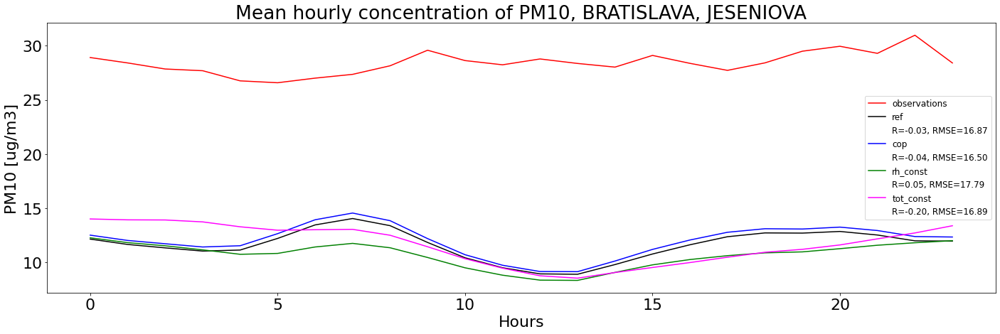

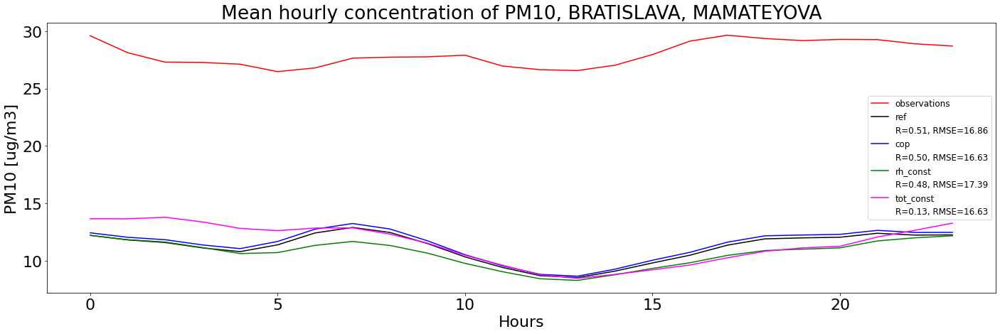

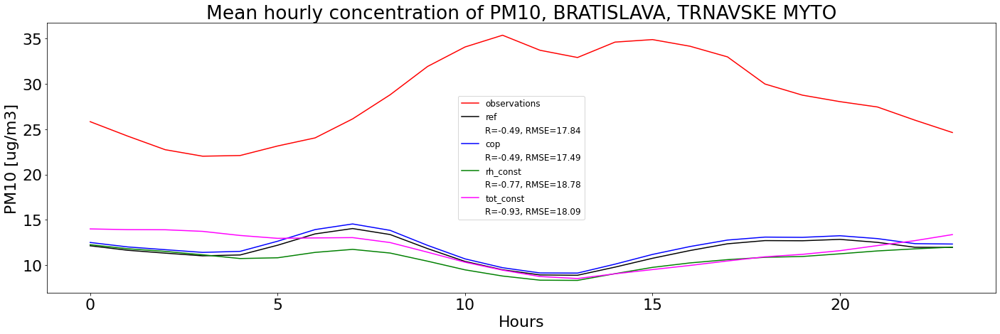

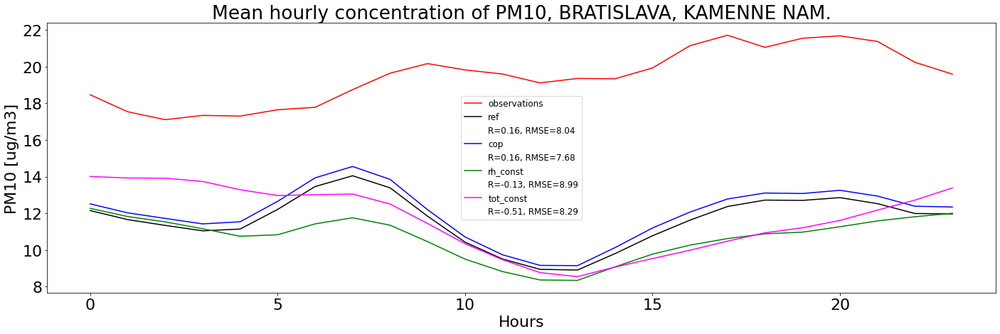

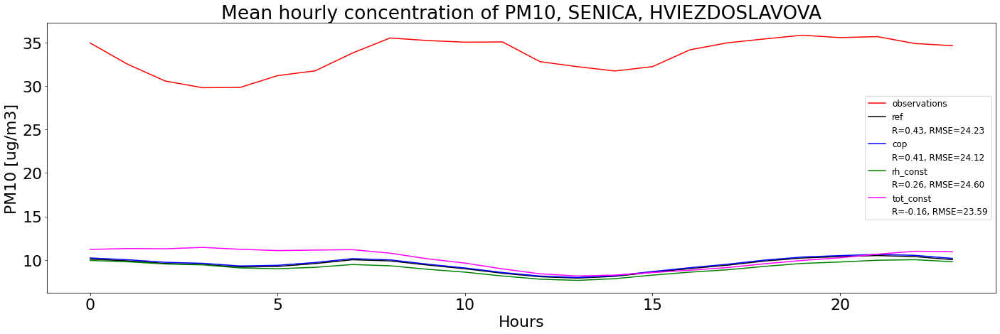

...

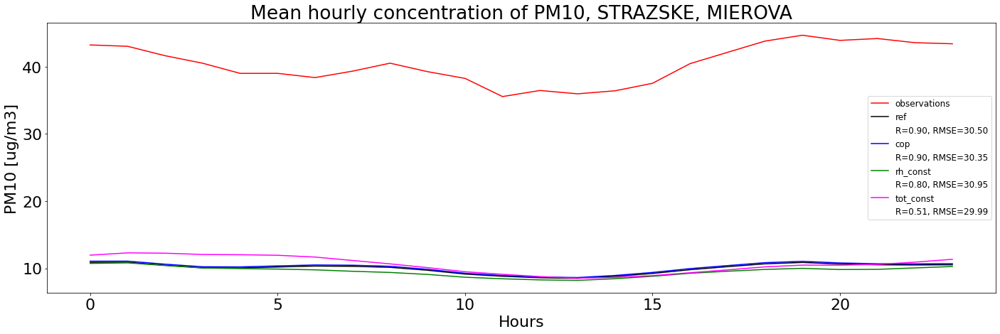

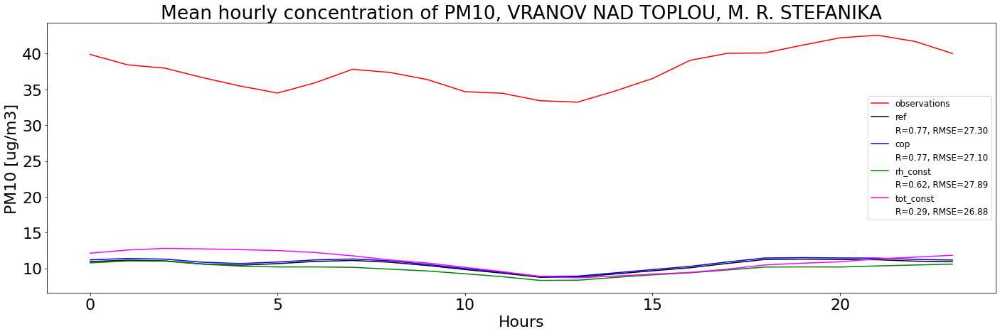

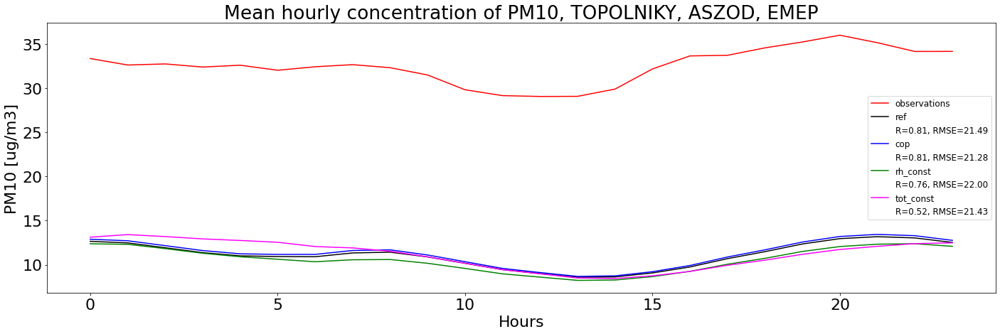

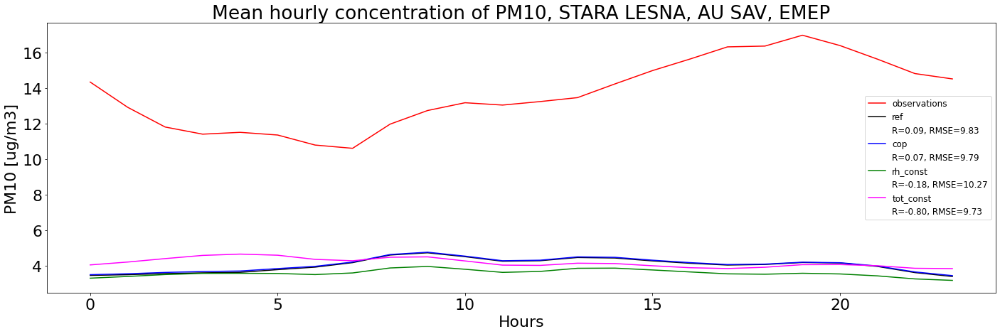

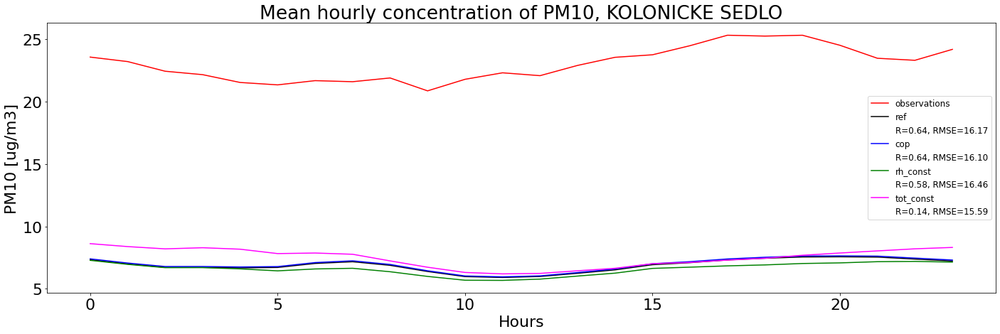

In [17]:
if save:
    print('Plots will be saved at:{}'.format(save_path))
for i in ID:    
    
    obs_id = data[specific[0]]['OBS'].sel(station = i, time = data[specific[0]].time.dt.month.isin(season_months[my_season])).groupby('time.hour').mean()
    name_sta = stat[specific[0]].name.loc[stat[specific[0]].index == i].item()
    
    plt.rcParams['figure.figsize'] = 20,7
    plt.rcParams.update({'font.size': 22})

    plt.plot(obs_id.hour, obs_id[:], color =obs_color, label = 'observations')                
    for s in specific:
        mod_id = data[s]['MOD'].sel(station = i, time = data[s].time.dt.month.isin(season_months[my_season])).groupby('time.hour').mean()
        
        stat_corr = mod_id.to_series().corr(obs_id.to_series())
        stat_diff = np.array((mod_id - obs_id).to_series().dropna())
        if len(stat_diff) != 0:
            stat_rmse = np.sqrt(np.sum(stat_diff**2)/len(stat_diff))
        else:
            stat_rmse = np.nan
            
        plt.plot(obs_id.hour, mod_id[:], color = color_list[s], label = '{}'.format(s))
        plt.plot([], [], ' ', label='R={:0.2f}, RMSE={:1.2f}'.format(stat_corr,stat_rmse))

    plt.legend(fontsize=12)                
    plt.title('Mean hourly concentration of {0}, {1}'.format(v,name_sta))                               
    plt.xlabel('Hours')
    plt.ylabel('{0} [{1}]'.format(v,units))
    plt.tight_layout()

    if save:
        if not os.path.exists(save_path):
            os.makedirs(save_path)
        plt.savefig('{0}/{1}_{2}_{3}_{4}_MH_{5}.png'.format(save_path,nick, start_date[0:4], v, i,my_season), dpi=300)                
    plt.show()                
    plt.close() 

## Priemerny hodinovy chod pre typy stanic

In [53]:
### USER INPUT
# Choose stations to plot
#moj_typ = 'T'
#moj_loc = 'U'
my_name = 'B'
#ID = list(stat_all.loc[stat_all['type'] == moj_typ].loc[stat_all['loc'] == moj_loc].loc[stat_all.coverage != 0].index.values)
ID = list(stat_all.loc[stat_all['type'] == my_name].loc[stat_all.coverage != 0].index.values)
#ID = [11813,11916]    # selected stations

my_season = 'winter'

save = True   # save the plots?  

save_path = '{0}/validated/{1}/graphs/{2}'.format(vali_path, folder_name,v)

Plots will be saved at:/data/teri/validacia/validated/CMAQ2017d02_ref_vs_cop_vs_const/graphs/PM10


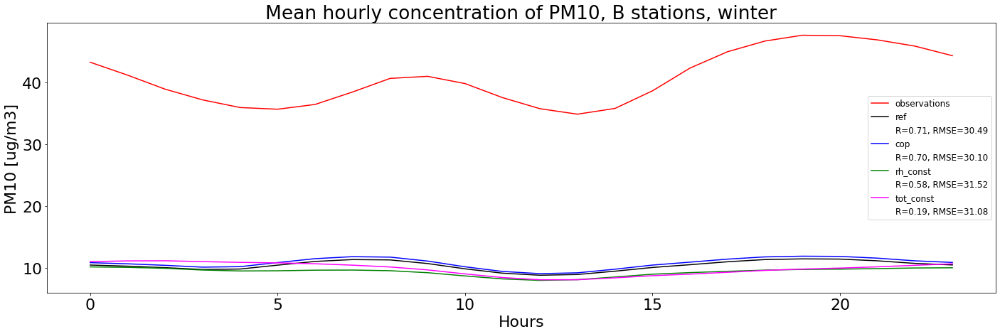

In [54]:
if save:
    print('Plots will be saved at:{}'.format(save_path))
#for i in ID:    
    
obs_id = data[specific[0]]['OBS'].sel(station = ID, time = data[specific[0]].time.dt.month.isin(season_months[my_season])).groupby('time.hour').mean().mean(dim = 'station')
#name_sta = stat[specific[0]].name.loc[stat[specific[0]].index == i].item()

plt.rcParams['figure.figsize'] = 20,7
plt.rcParams.update({'font.size': 22})

plt.plot(obs_id.hour, obs_id[:], color =obs_color, label = 'observations')                
for s in specific:
    mod_id = data[s]['MOD'].sel(station = ID, time = data[s].time.dt.month.isin(season_months[my_season])).groupby('time.hour').mean().mean(dim = 'station')

    stat_corr = mod_id.to_series().corr(obs_id.to_series())
    stat_diff = np.array((mod_id - obs_id).to_series().dropna())
    if len(stat_diff) != 0:
        stat_rmse = np.sqrt(np.sum(stat_diff**2)/len(stat_diff))
    else:
        stat_rmse = np.nan

    plt.plot(obs_id.hour, mod_id[:], color = color_list[s], label = '{}'.format(s))
    plt.plot([], [], ' ', label='R={:0.2f}, RMSE={:1.2f}'.format(stat_corr,stat_rmse))

plt.legend(fontsize=12)                
plt.title('Mean hourly concentration of {0}, {1} stations, {2}'.format(v, my_name, my_season))                               
plt.xlabel('Hours')
plt.ylabel('{0} [{1}]'.format(v,units))
plt.tight_layout()

if save:
    if not os.path.exists(save_path):
        os.makedirs(save_path)
    plt.savefig('{0}/MH_{1}_{2}_{3}_{4}.png'.format(save_path,my_name, nick, v, my_season), dpi=300)                
plt.show()                
plt.close() 

## Normovany priemerny hodinovy chod pre typy stanic

In [55]:
### USER INPUT
# Choose stations to plot
#moj_typ = 'T'
#moj_loc = 'U'
my_name = 'B'
#ID = list(stat_all.loc[stat_all['type'] == moj_typ].loc[stat_all['loc'] == moj_loc].loc[stat_all.coverage != 0].index.values)
ID = list(stat_all.loc[stat_all['type'] == my_name].loc[stat_all.coverage != 0].index.values)
#ID = [11813,11916]    # selected stations

my_season = 'winter'

save = True   # save the plots?  

save_path = '{0}/validated/{1}/graphs/{2}'.format(vali_path, folder_name,v)

Plots will be saved at:/data/teri/validacia/validated/CMAQ2017d02_ref_vs_cop_vs_const/graphs/PM10


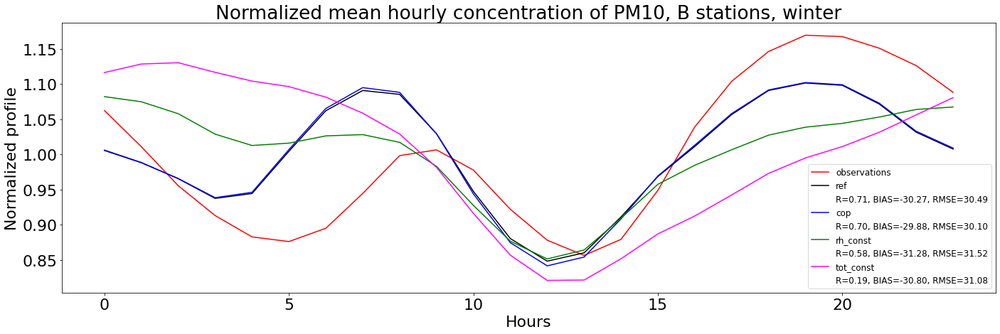

In [56]:
if save:
    print('Plots will be saved at:{}'.format(save_path))
#for i in ID:    
    
obs_id = data[specific[0]]['OBS'].sel(station = ID, time = data[specific[0]].time.dt.month.isin(season_months[my_season])).groupby('time.hour').mean().mean(dim = 'station')
#name_sta = stat[specific[0]].name.loc[stat[specific[0]].index == i].item()

plt.rcParams['figure.figsize'] = 20,7
plt.rcParams.update({'font.size': 22})

obs_id_norm = 24*obs_id/obs_id.sum()
plt.plot(obs_id.hour, obs_id_norm[:], color =obs_color, label = 'observations')                
for s in specific:
    mod_id = data[s]['MOD'].sel(station = ID, time = data[s].time.dt.month.isin(season_months[my_season])).groupby('time.hour').mean().mean(dim = 'station')
    mod_id_norm = 24*mod_id/mod_id.sum()
    
    stat_corr = mod_id.to_series().corr(obs_id.to_series())
    stat_diff = np.array((mod_id - obs_id).to_series().dropna())
    if len(stat_diff) != 0:
        stat_bias = np.sum(stat_diff)/len(stat_diff)
        stat_rmse = np.sqrt(np.sum(stat_diff**2)/len(stat_diff))
    else:
        stat_rmse = np.nan
        stat_bias = np.nan
    
    plt.plot(obs_id.hour, mod_id_norm[:], color = color_list[s], label = '{}'.format(s))
    #plt.plot([], [], ' ', label='R={:0.2f}, RMSE={:1.2f}'.format(stat_corr,stat_rmse))
    plt.plot([], [], ' ', label='R={:0.2f}, BIAS={:1.2f}, RMSE={:1.2f}'.format(stat_corr,stat_bias, stat_rmse))

plt.legend(fontsize=12)                
plt.title('Normalized mean hourly concentration of {0}, {1} stations, {2}'.format(v, my_name, my_season))                               
plt.xlabel('Hours')
plt.ylabel('Normalized profile')
plt.tight_layout()

if save:
    if not os.path.exists(save_path):
        os.makedirs(save_path)
    plt.savefig('{0}/MH_norm_{1}_{2}_{3}_{4}.png'.format(save_path,my_name, nick, v, my_season), dpi=300)                
plt.show()                
plt.close() 

In [ ]:
obs_id = data[specific[0]]['OBS'].sel(station = ID, time = data[specific[0]].time.dt.month.isin(season_months[my_season])).groupby('time.hour').mean().mean(dim = 'station')
24*obs_id/obs_id.sum()


## Priemerny rocny chod pre stanice

Chod priemernych dennych hodnot

In [103]:
### USER INPUT
# Choose stations to plot
ID = list(stat_all.index.values)[1:]   # all stations
#ID = [11813,11916]    # selected stations
save = False   # save the plots?

plot_from = '2017-01-01'
plot_until = '2017-12-31' 

save_path = '{0}/validated/{1}/graphs/{2}'.format(vali_path, folder_name,v)

In [ ]:
if save:
    print('Plots will be saved at:{}'.format(save_path))
for i in ID:
    obs_id = data[specific[0]]['OBS'].sel(station = i).to_series()[plot_from:plot_until]
    name_sta = stat[specific[0]].name.loc[stat[specific[0]].index == i].item()
    daily_obs = obs_id.groupby(pd.Grouper(freq='D')).mean()
    
    plt.rcParams['figure.figsize'] = 20,7
    plt.rcParams.update({'font.size': 22})
    plt.plot(daily_obs.index[:], daily_obs[:], color = obs_color, label = 'observations')                
    
    for s in specific:        
        mod_id = data[s]['MOD'].sel(station = i).to_series()[plot_from:plot_until]        
        daily_mod = mod_id.groupby(pd.Grouper(freq='D')).mean()

        stat_corr_daily = daily_mod.corr(daily_obs)
        stat_diff_daily = np.array((daily_mod - daily_obs).dropna())
        if len(stat_diff_daily) != 0:
            stat_rmse_daily = np.sqrt(np.sum(stat_diff_daily**2)/len(stat_diff_daily))
        else:
            stat_rmse_daily = np.nan

        plt.plot(daily_obs.index[:], daily_mod[:], color = color_list[s], label = '{}'.format(s))
        plt.plot([], [], ' ', label='R={:0.2f}, RMSE={:1.2f}'.format(stat_corr_daily,stat_rmse_daily))

    plt.legend(fontsize=12)                
    plt.title('Daily concentration of {0}, {1}'.format(v,name_sta))                               
    plt.xlabel('Days')
    plt.ylabel('{0} [{1}]'.format(v,units))
    plt.tight_layout()

    if save:
        if not os.path.exists(save_path):
            os.makedirs(save_path)
        plt.savefig('{0}/{1}_{2}_{3}_{4}_D{5}-{6}.png'.format(save_path,nick, start_date[0:4], v, i,plot_from,plot_until), dpi=300)                
    plt.show()                
    plt.close()   

## Priemerny rocny chod typy stanic

In [66]:
### USER INPUT
# Choose stations to plot
#moj_typ = 'T'
#moj_loc = 'U'
my_name = 'B'
#ID = list(stat_all.loc[stat_all['type'] == moj_typ].loc[stat_all['loc'] == moj_loc].loc[stat_all.coverage != 0].index.values)
ID = list(stat_all.loc[stat_all['type'] == my_name].loc[stat_all.coverage != 0].index.values)
#ID = [11813,11916]    # selected stations

my_season = 'year'

save = True   # save the plots?  

save_path = '{0}/validated/{1}/graphs/{2}'.format(vali_path, folder_name,v)

Plots will be saved at:/data/teri/validacia/validated/CMAQ2017d02_ref_vs_cop_vs_const/graphs/PM10


/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)


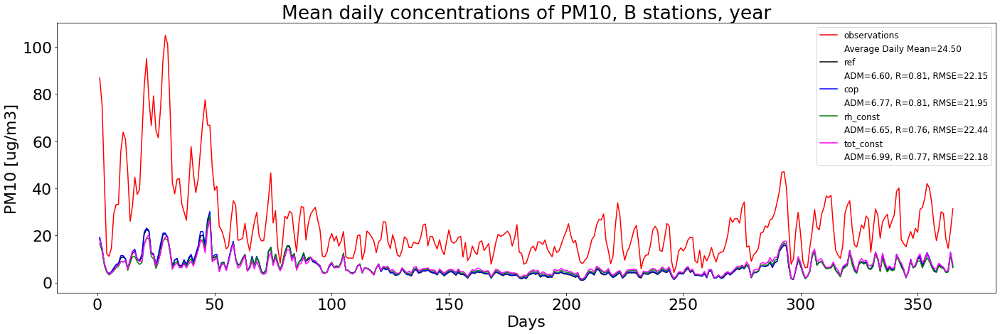

In [67]:
if save:
    print('Plots will be saved at:{}'.format(save_path))
#for i in ID:    
days_np = np.repeat(np.linspace(1,365,365),24)
new_data = data[specific[0]].assign_coords(time = days_np)    
obs_id = new_data['OBS'].sel(station = ID).groupby(new_data['OBS'].time).mean().mean(dim = 'station')
obs_mean = obs_id.mean()

plt.rcParams['figure.figsize'] = 20,7
plt.rcParams.update({'font.size': 22})

plt.plot(obs_id.time, obs_id[:], color =obs_color, label = 'observations') 
plt.plot([], [], ' ', label='Average Daily Mean={:0.2f}'.format(obs_mean.item()))

for s in specific:
    new_data = data[s].assign_coords(time = days_np)
    mod_id = new_data['MOD'].sel(station = ID).groupby(new_data['MOD'].time).mean().mean(dim = 'station')
    mod_mean = mod_id.mean()

    stat_corr = mod_id.to_series().corr(obs_id.to_series())
    stat_diff = np.array((mod_id - obs_id).to_series().dropna())
    if len(stat_diff) != 0:
        stat_rmse = np.sqrt(np.sum(stat_diff**2)/len(stat_diff))
    else:
        stat_rmse = np.nan

    plt.plot(obs_id.time, mod_id[:], color = color_list[s], label = '{}'.format(s))
    plt.plot([], [], ' ', label='ADM={:0.2f}, R={:1.2f}, RMSE={:1.2f}'.format(mod_mean.item(),stat_corr,stat_rmse))

plt.legend(fontsize=12)                
plt.title('Mean daily concentrations of {0}, {1} stations, {2}'.format(v, my_name, my_season))                               
plt.xlabel('Days')
plt.ylabel('{0} [{1}]'.format(v,units))
plt.tight_layout()

if save:
    if not os.path.exists(save_path):
        os.makedirs(save_path)
    plt.savefig('{0}/MA_{1}_{2}_{3}_{4}.png'.format(save_path,my_name, nick, v, my_season), dpi=300)                
plt.show()                
plt.close() 

In [16]:
# Average annual mean
my_seasons = ['spring','summer','autumn','winter','year']
print(v)
for s in my_seasons:    
    means = data['ref'].sel(station = ID, time = data['ref'].time.dt.month.isin(season_months[s])).mean()
    print('{0} average \n obs: {1} \n ref: {2}'.format(s, means['OBS'].values,means['MOD'].values))
    means = data['cop'].sel(station = ID, time = data['cop'].time.dt.month.isin(season_months[s])).mean()
    print(' cop: {0}'.format(means['MOD'].values))
    means = data['rh_const'].sel(station = ID, time = data['rh_const'].time.dt.month.isin(season_months[s])).mean()
    print(' rh_const: {0}'.format(means['MOD'].values))
    means = data['tot_const'].sel(station = ID, time = data['tot_const'].time.dt.month.isin(season_months[s])).mean()
    print(' tot_const: {0}'.format(means['MOD'].values))

PM10
spring average 
 obs: 19.656004332408944 
 ref: 6.719780445098877
 cop: 6.768843650817871
 rh_const: 7.000389575958252
 tot_const: 6.638930797576904
summer average 
 obs: 16.503814276386024 
 ref: 3.3501579761505127
 cop: 3.538330554962158
 rh_const: 4.040591239929199
 tot_const: 4.578207969665527
autumn average 
 obs: 20.64558337153285 
 ref: 5.99451208114624
 cop: 6.0387654304504395
 rh_const: 6.20621919631958
 tot_const: 6.897619724273682
winter average 
 obs: 35.88774757670341 
 ref: 9.044947624206543
 cop: 9.27950668334961
 rh_const: 8.197858810424805
 tot_const: 9.215292930603027
year average 
 obs: 24.3597198545409 
 ref: 6.604287147521973
 cop: 6.7709150314331055
 rh_const: 6.651987552642822
 tot_const: 6.986158847808838


In [20]:
obs_id.mean()

<xarray.DataArray 'OBS' ()>
array(24.49630043)

## Rocne obdobia

In [25]:
### USER INPUT
# Choose stations to plot
ID = list(stat_all.index.values)[1:]   # all stations
#ID = [11813,11916]    # selected stations

save = True  # save the plots?  

save_path = '{0}/validated/{1}/graphs/{2}'.format(vali_path, folder_name,v)
save_path

'/data/teri/validacia/validated/CMAQ2017d02_ref_vs_cop_vs_const/graphs/PM10'

### Observations

In [ ]:
if save:
    print('Plots will be saved at:{}'.format(save_path))
for i in ID:    
    
    obs_id_jar = data[specific[0]]['OBS'].sel(station = i, time = data[specific[0]].time.dt.month.isin(season_months['spring'])).groupby('time.hour').mean()
    obs_id_leto = data[specific[0]]['OBS'].sel(station = i, time = data[specific[0]].time.dt.month.isin(season_months['summer'])).groupby('time.hour').mean()
    obs_id_jesen = data[specific[0]]['OBS'].sel(station = i, time = data[specific[0]].time.dt.month.isin(season_months['autumn'])).groupby('time.hour').mean()
    obs_id_zima = data[specific[0]]['OBS'].sel(station = i, time = data[specific[0]].time.dt.month.isin(season_months['winter'])).groupby('time.hour').mean()
    
    name_sta = stat[specific[0]].name.loc[stat[specific[0]].index == i].item()
    
    plt.rcParams['figure.figsize'] = 20,7
    plt.rcParams.update({'font.size': 22})

    plt.plot(obs_id_jar.hour, obs_id_jar[:], color ='green', label = 'jar') 
    plt.plot(obs_id_leto.hour, obs_id_leto[:], color ='red', label = 'leto')
    plt.plot(obs_id_jesen.hour, obs_id_jesen[:], color ='orange', label = 'jesen') 
    plt.plot(obs_id_zima.hour, obs_id_zima[:], color ='blue', label = 'zima')

    plt.legend(fontsize=12)                
    plt.title('Mean hourly concentration of {0}, {1}'.format(v,name_sta))                               
    plt.xlabel('Hours')
    plt.ylabel('{0} [{1}]'.format(v,units))
    plt.tight_layout()

    if save:
        if not os.path.exists(save_path):
            os.makedirs(save_path)
        plt.savefig('{0}/{1}_{2}_{3}_{4}_MH{5}-{6}.png'.format(save_path,nick, start_date[0:4], v, i,plot_from,plot_until), dpi=300)                
    plt.show()                
    plt.close() 

### Model

Plots will be saved at:/data/teri/validacia/validated/CMAQ2017d02_ref_vs_cop_vs_const/graphs/PM10


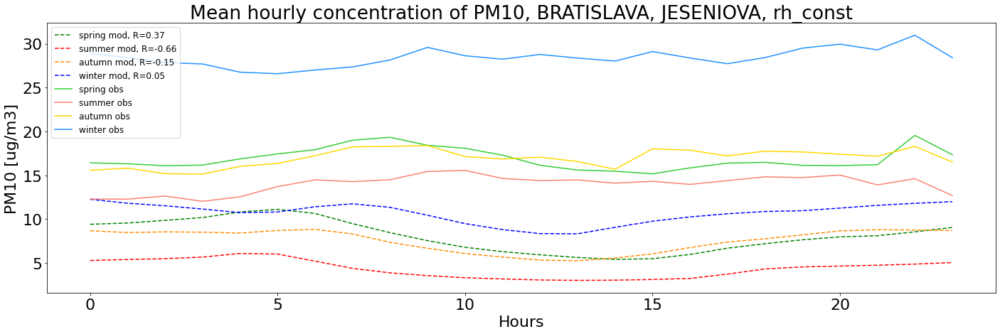

/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)


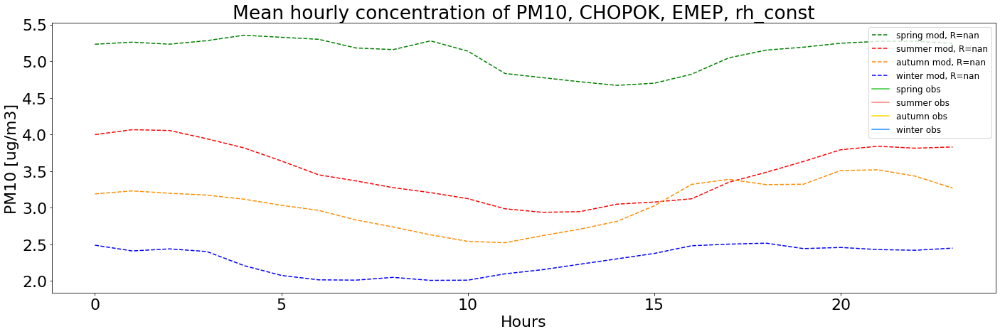

/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)


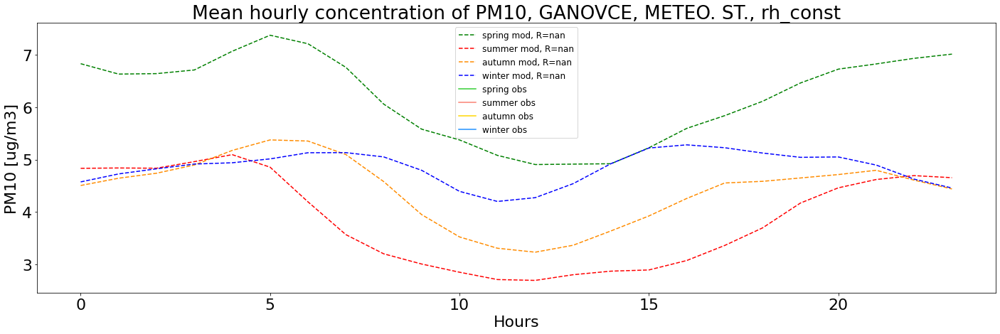

/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)


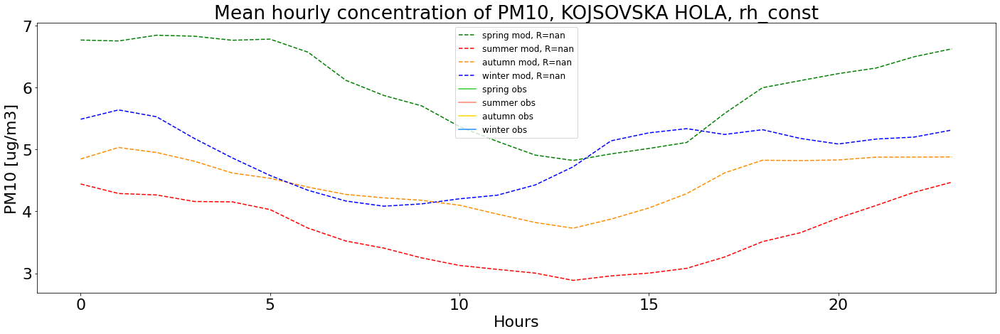

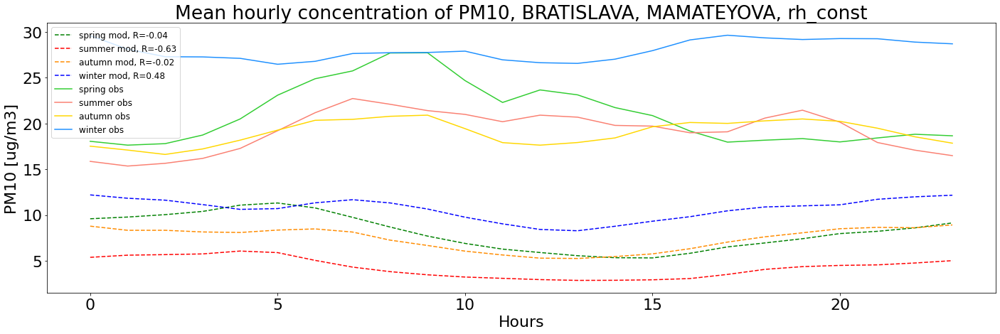

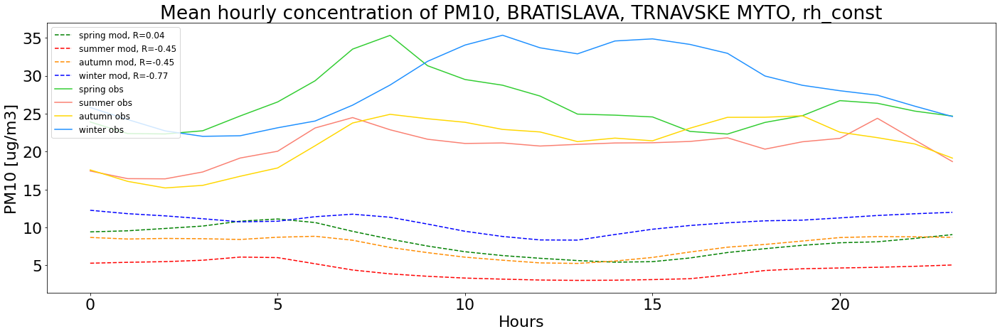

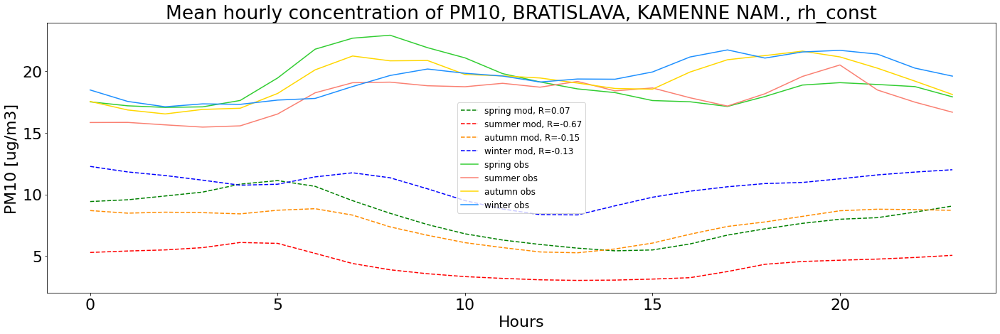

/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)


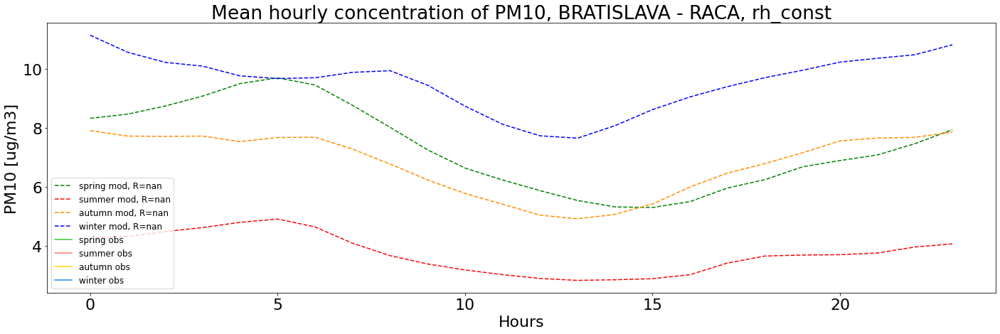

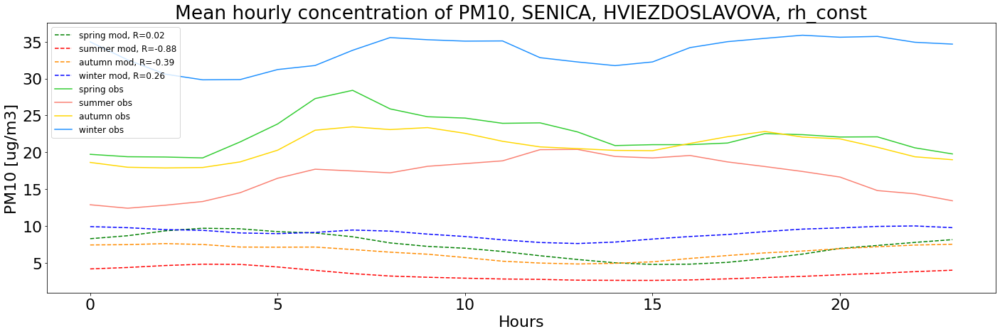

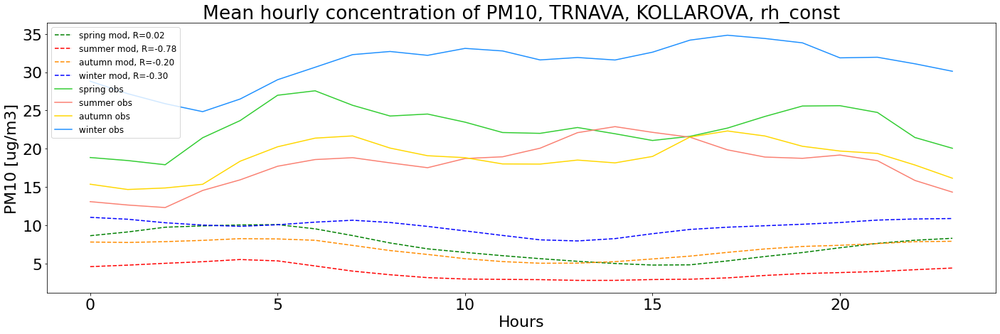

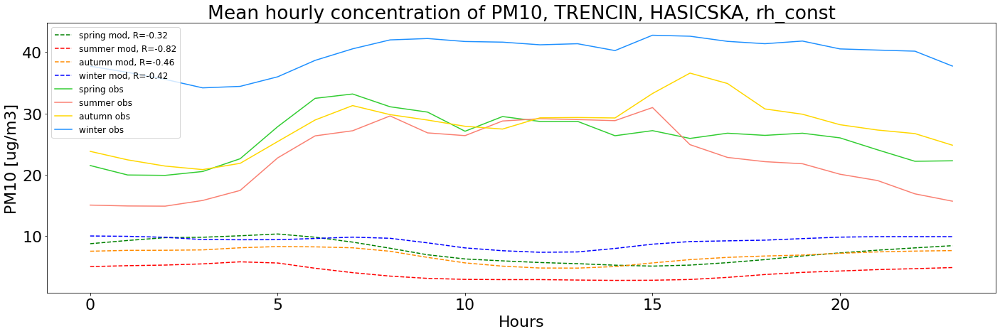

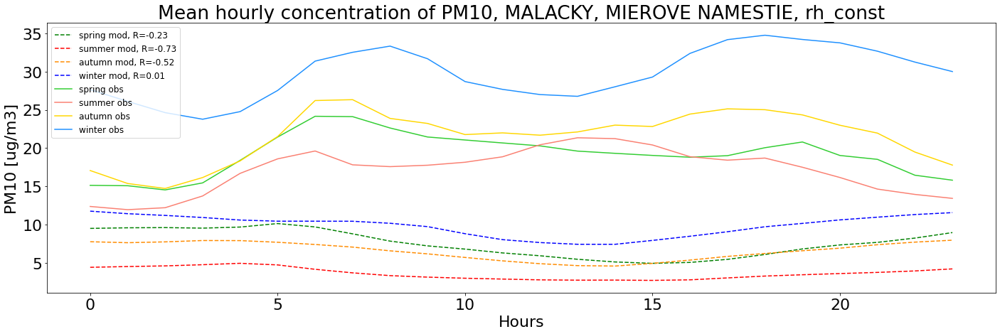

/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)


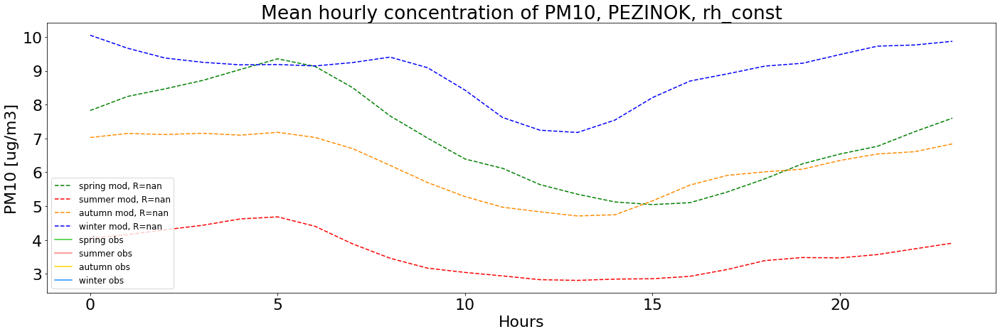

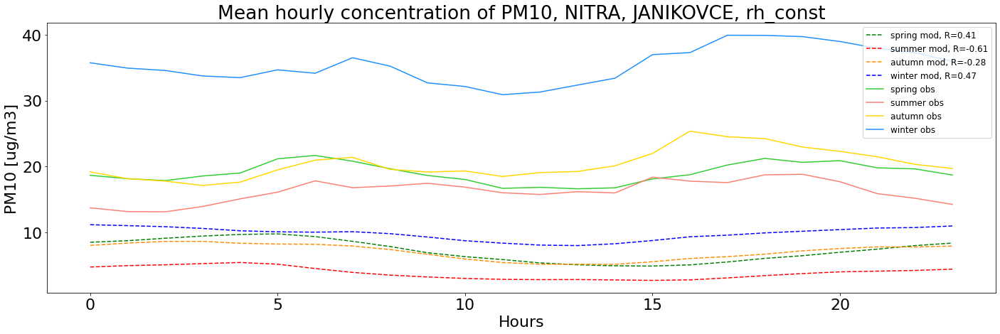

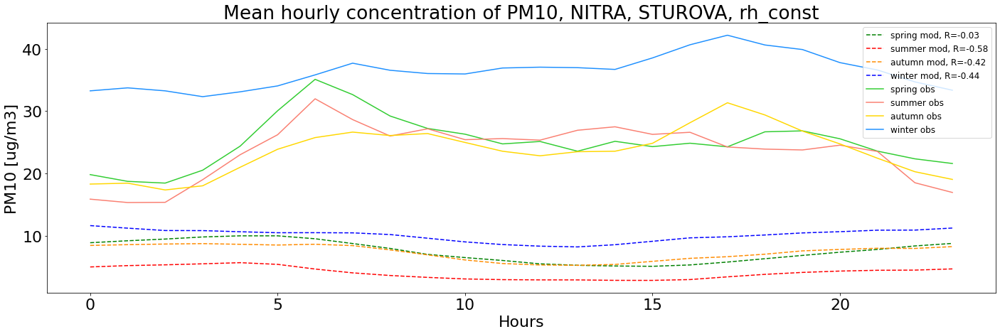

/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)


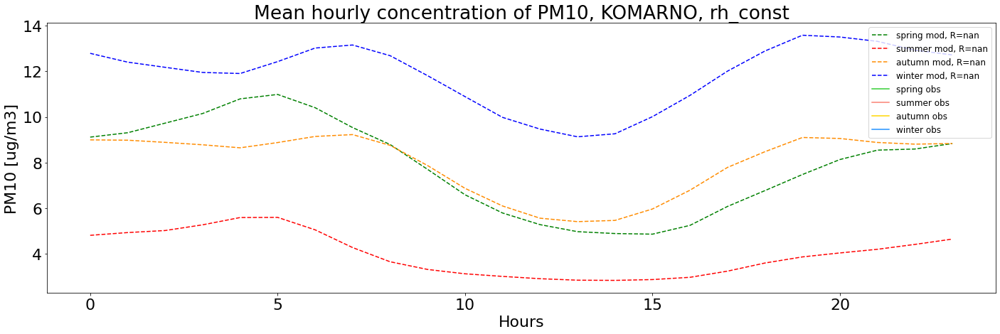

/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)


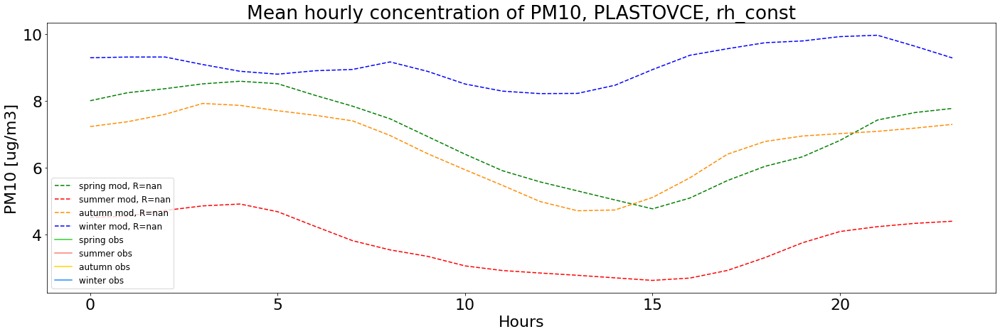

/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)


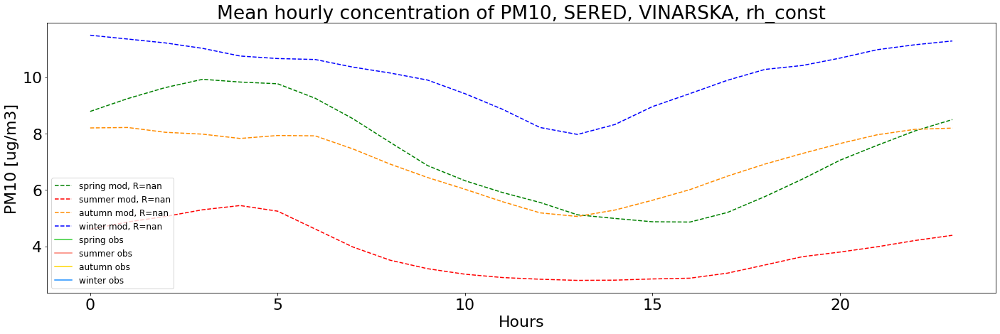

/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)


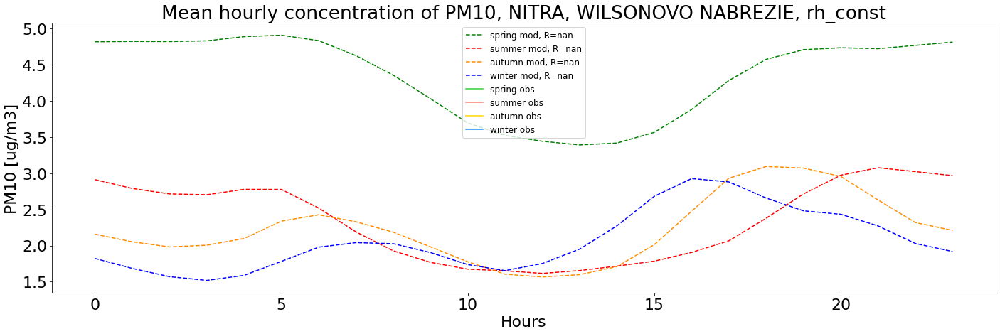

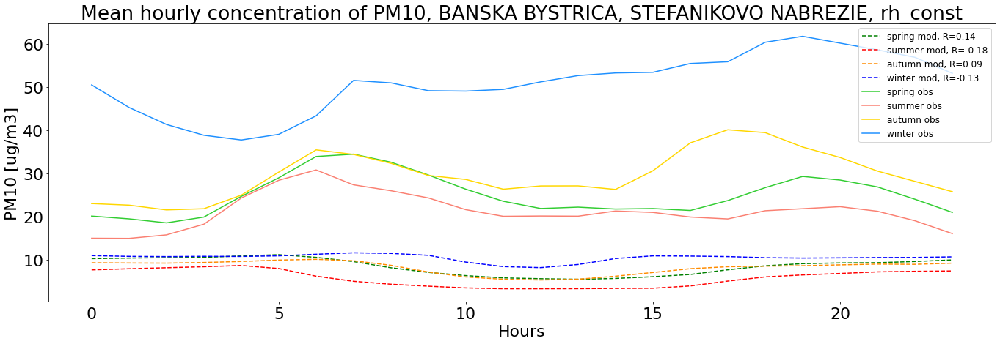

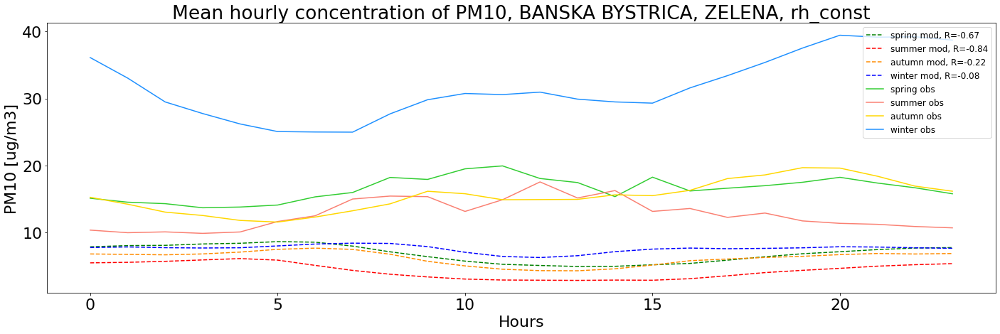

/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)


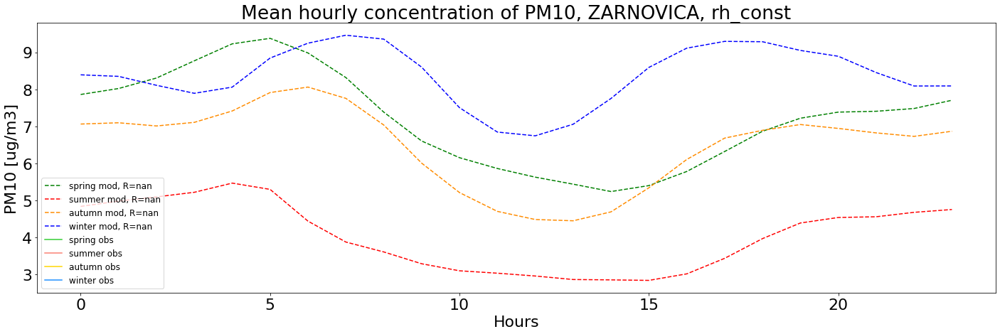

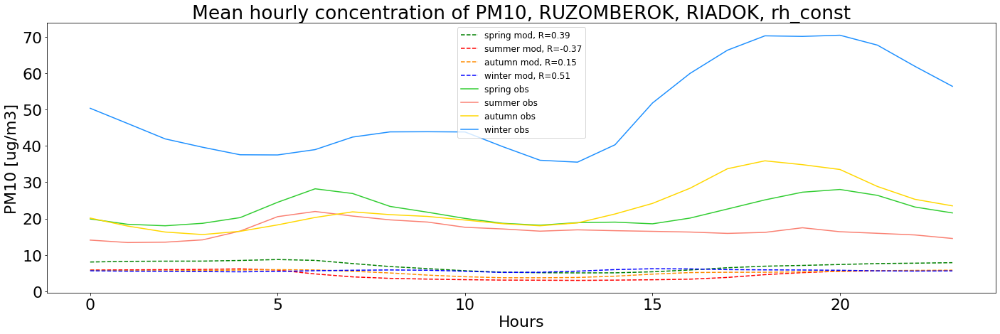

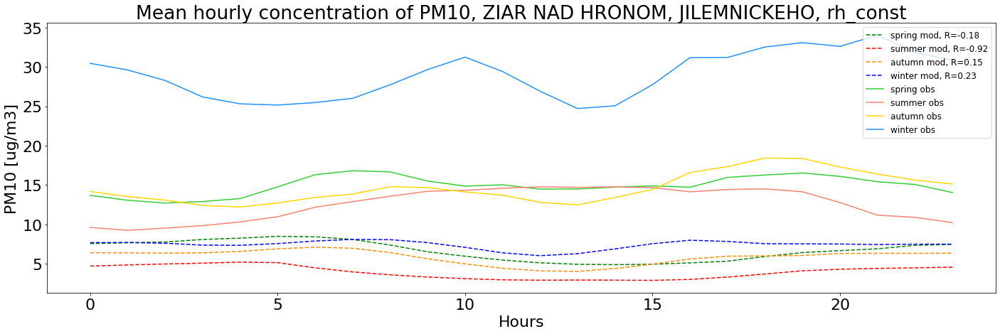

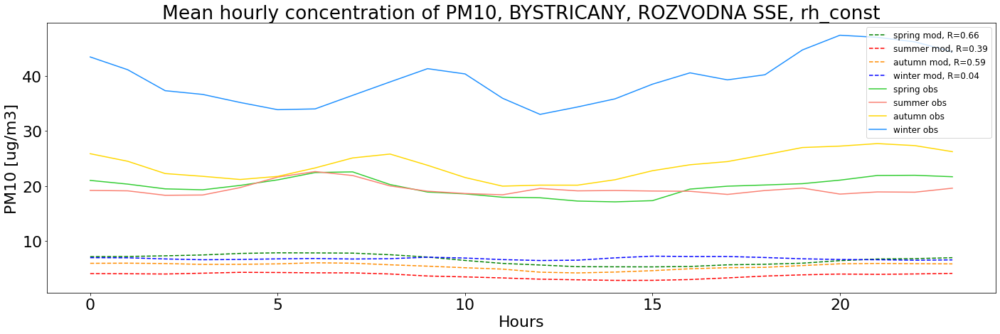

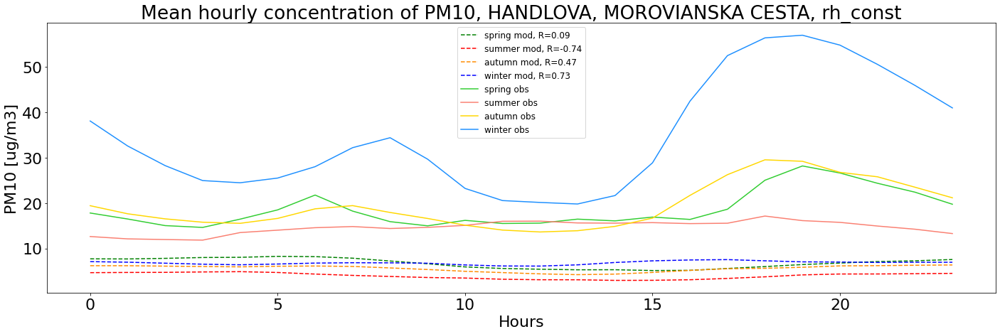

...

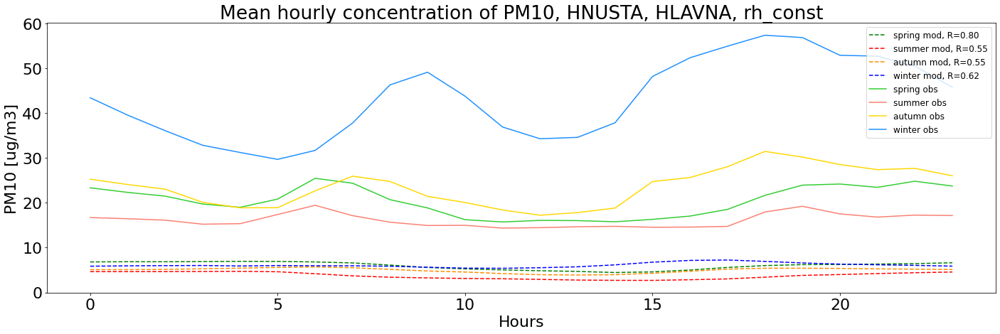

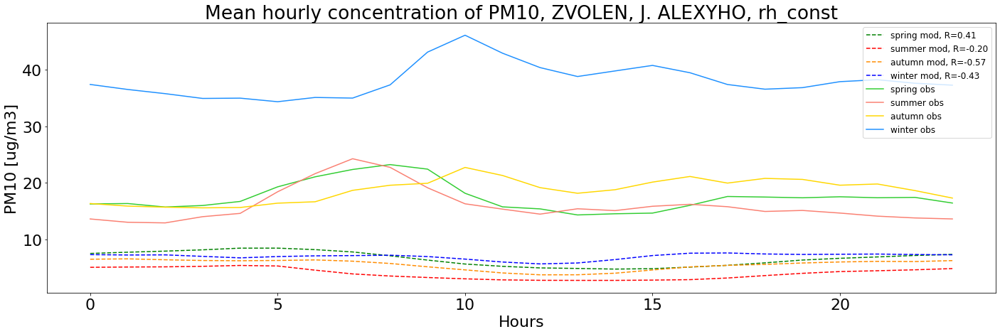

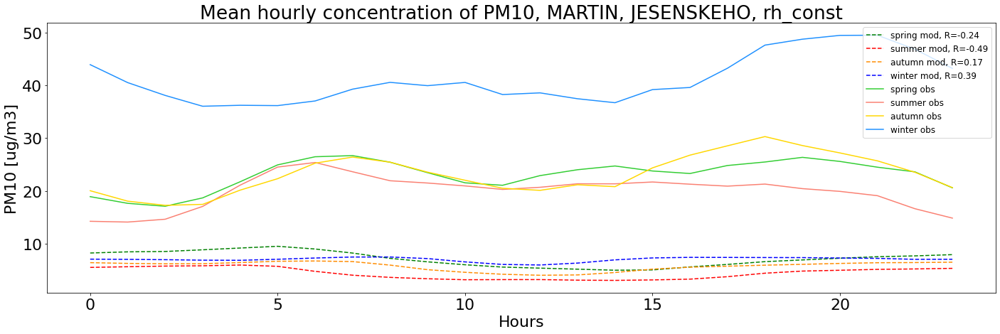

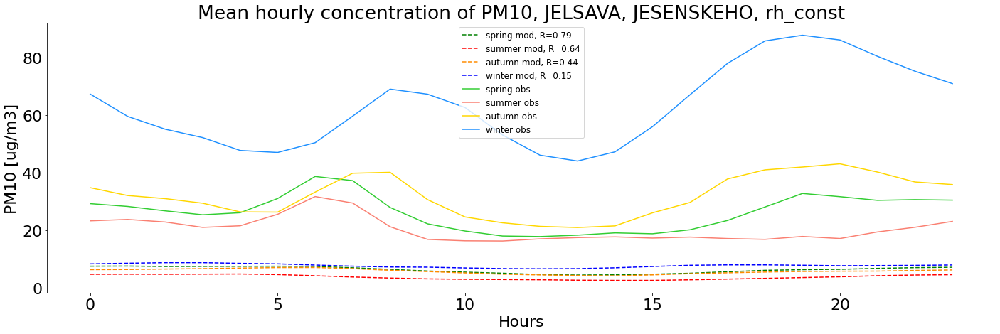

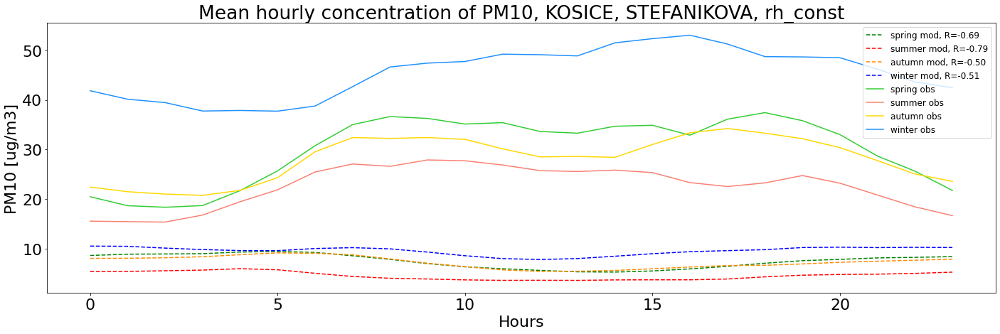

/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)


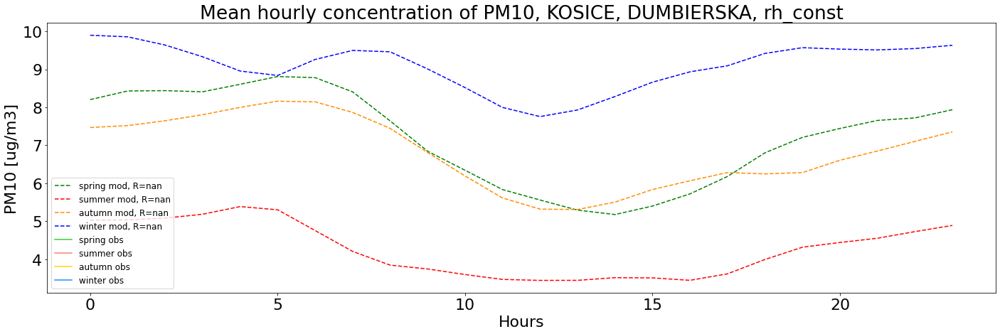

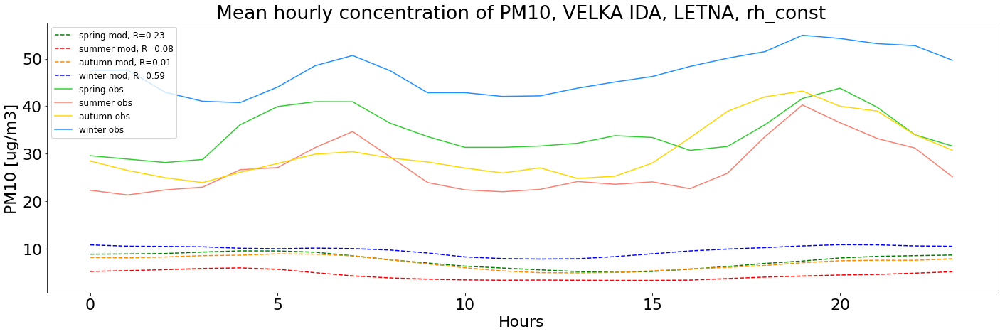

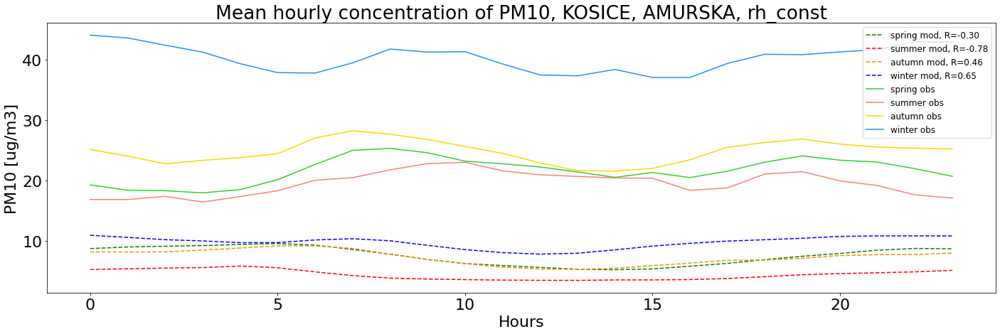

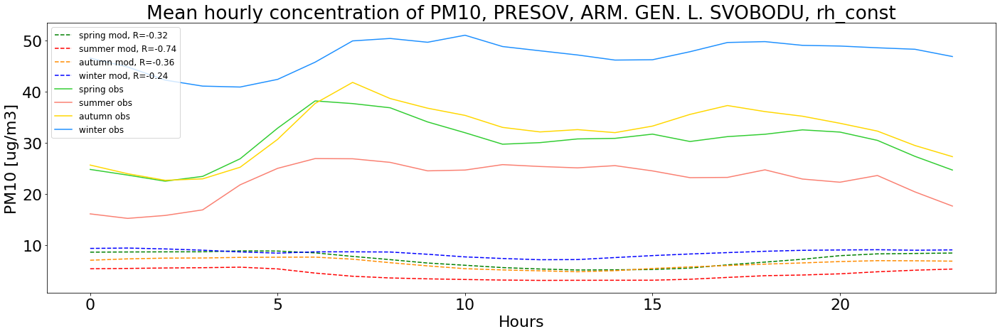

/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)


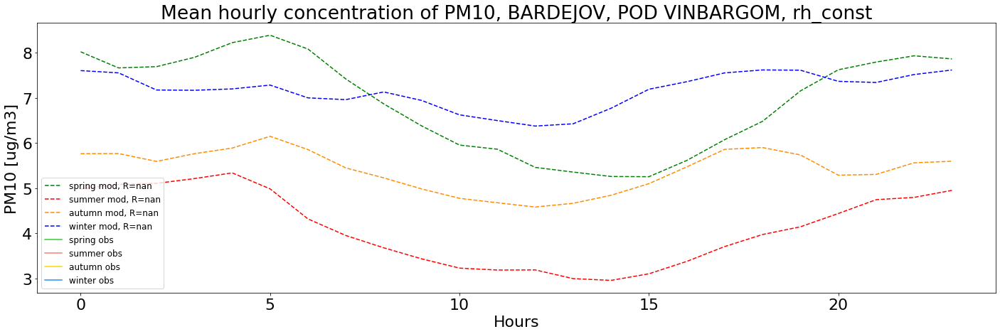

/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)


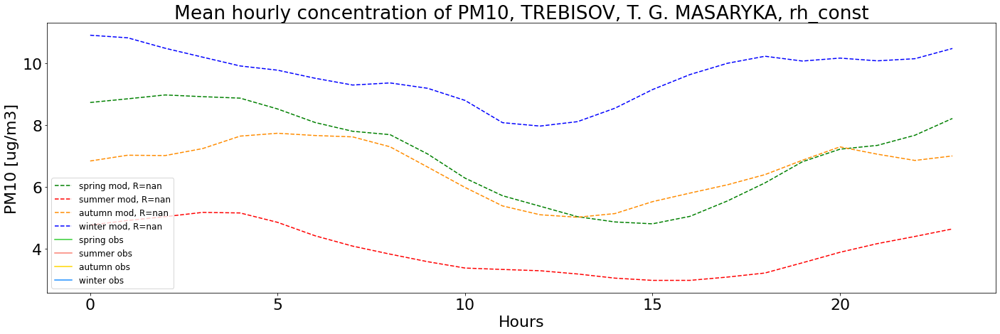

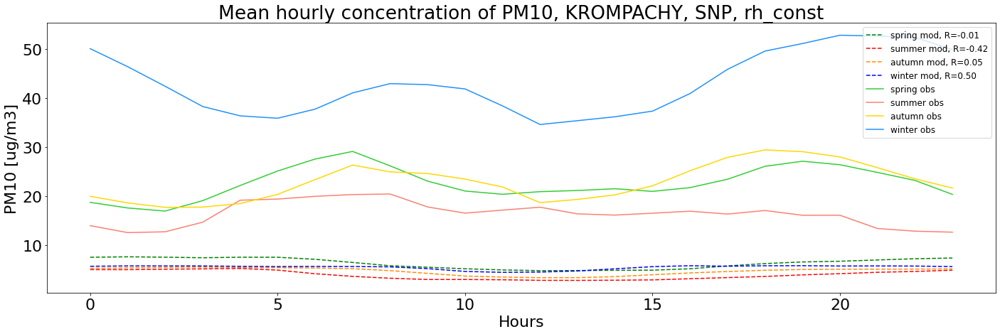

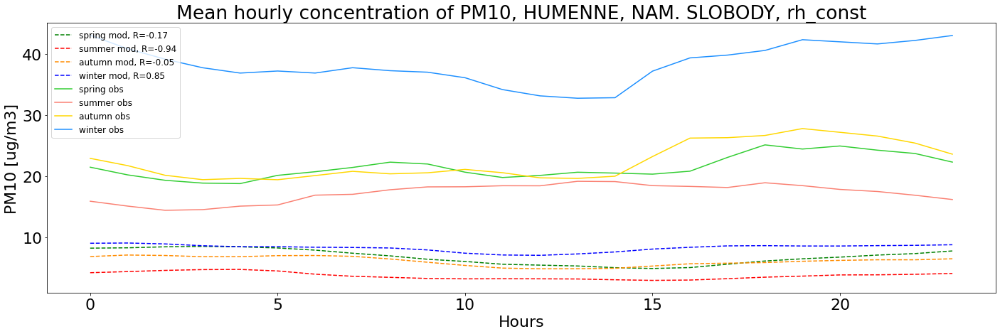

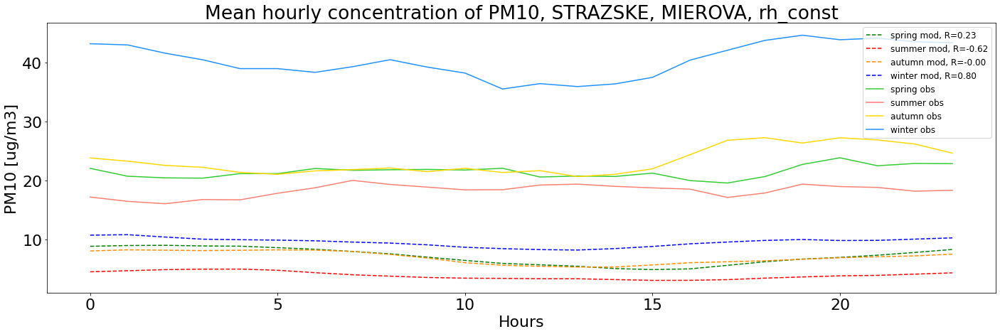

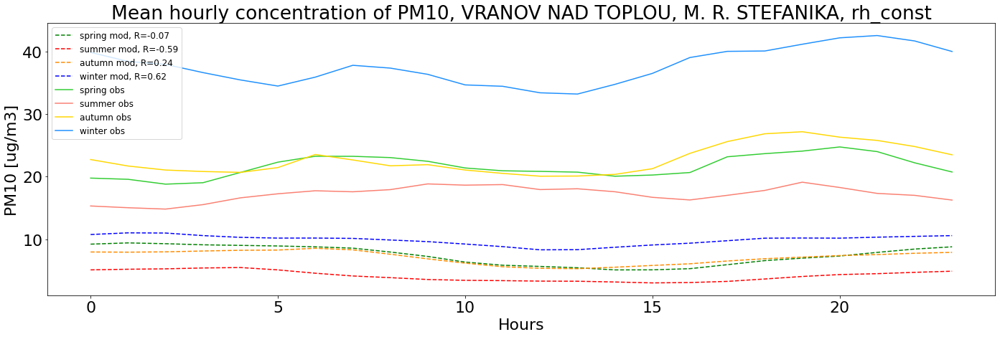

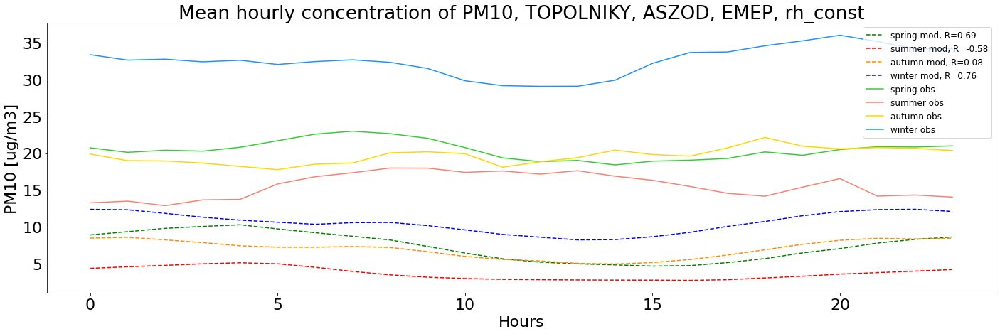

/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)


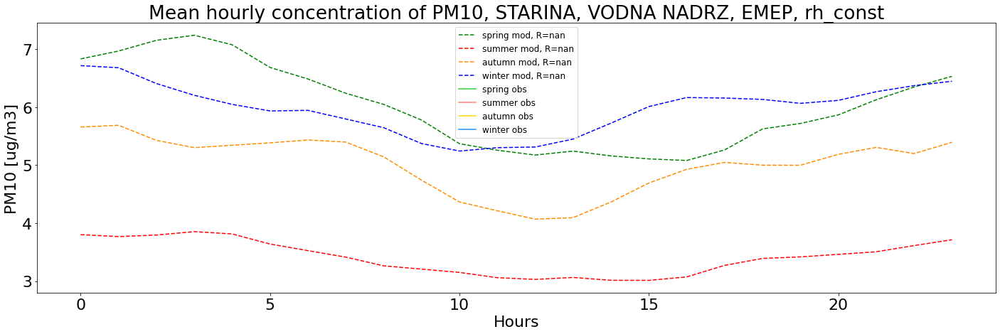

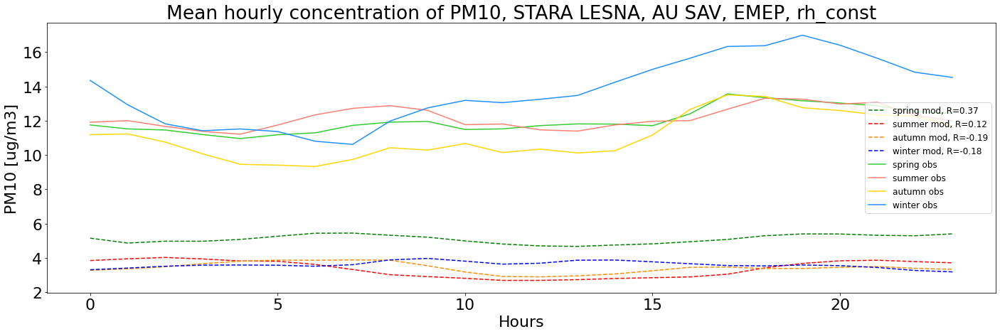

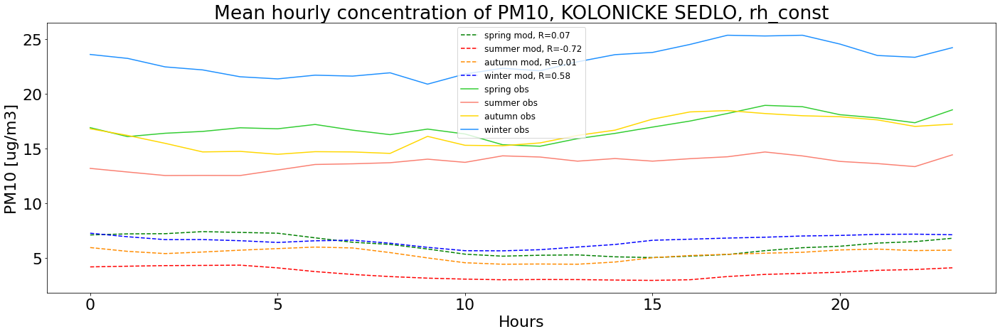

/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)


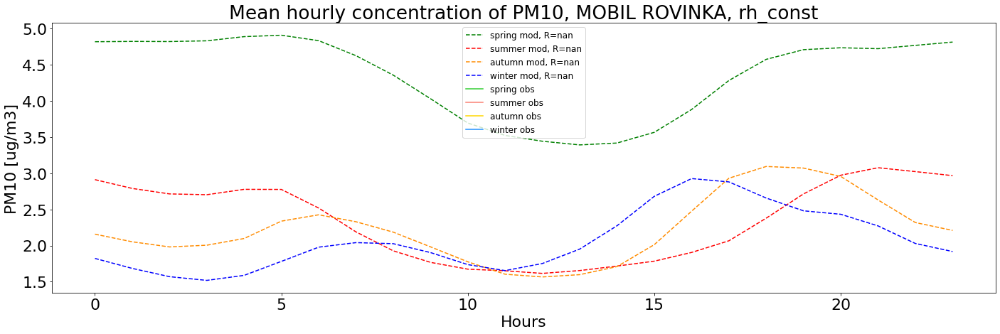

/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)


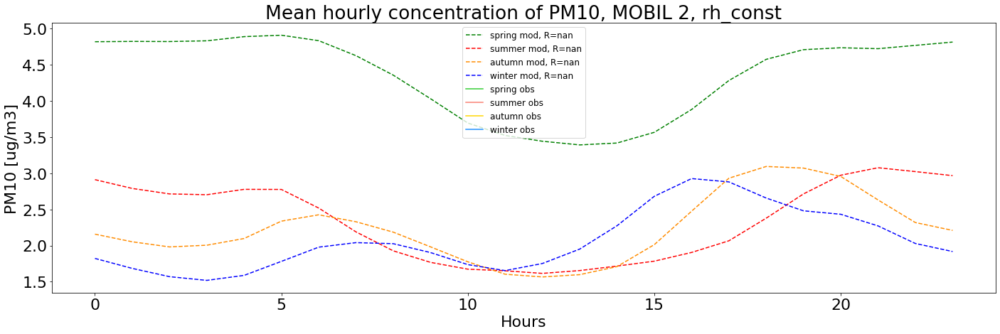

/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)


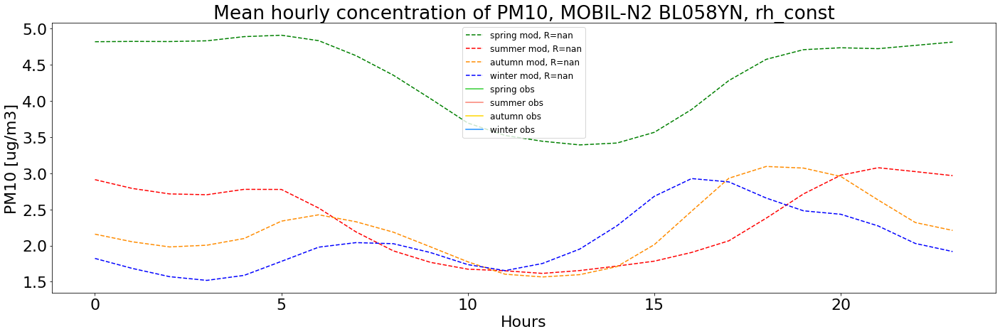

/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)


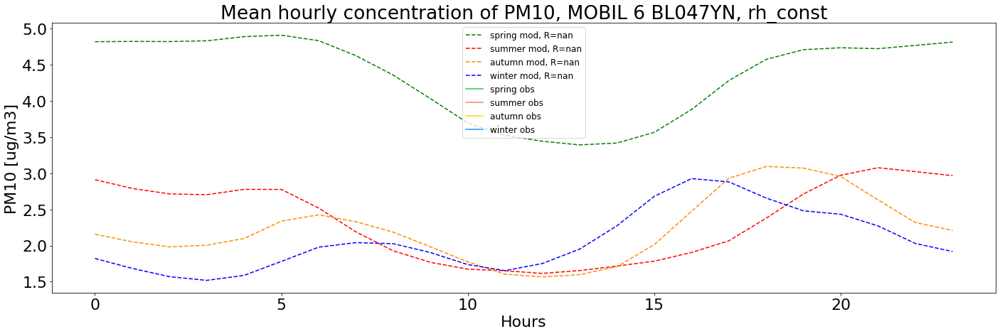

/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)


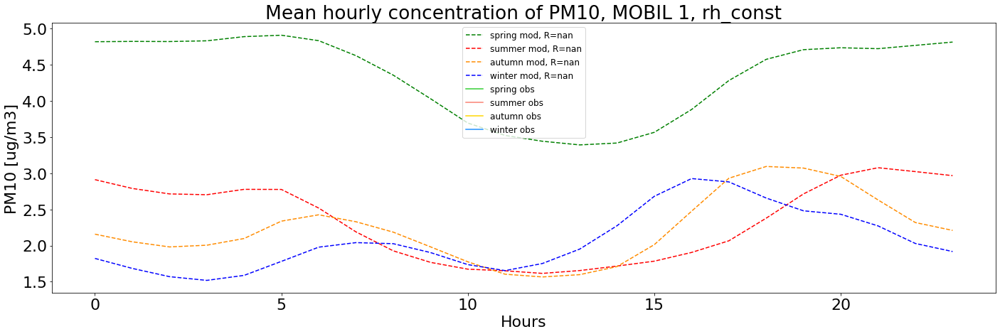

In [26]:
spec_nick = 'rh_const'

if save:
    print('Plots will be saved at:{}'.format(save_path))
for i in ID:    
    
    mod_id_jar = data[spec_nick]['MOD'].sel(station = i, time = data[spec_nick].time.dt.month.isin(season_months['spring'])).groupby('time.hour').mean()
    mod_id_leto = data[spec_nick]['MOD'].sel(station = i, time = data[spec_nick].time.dt.month.isin(season_months['summer'])).groupby('time.hour').mean()
    mod_id_jesen = data[spec_nick]['MOD'].sel(station = i, time = data[spec_nick].time.dt.month.isin(season_months['autumn'])).groupby('time.hour').mean()
    mod_id_zima = data[spec_nick]['MOD'].sel(station = i, time = data[spec_nick].time.dt.month.isin(season_months['winter'])).groupby('time.hour').mean()
    
    obs_id_jar = data[specific[0]]['OBS'].sel(station = i, time = data[specific[0]].time.dt.month.isin(season_months['spring'])).groupby('time.hour').mean()
    obs_id_leto = data[specific[0]]['OBS'].sel(station = i, time = data[specific[0]].time.dt.month.isin(season_months['summer'])).groupby('time.hour').mean()
    obs_id_jesen = data[specific[0]]['OBS'].sel(station = i, time = data[specific[0]].time.dt.month.isin(season_months['autumn'])).groupby('time.hour').mean()
    obs_id_zima = data[specific[0]]['OBS'].sel(station = i, time = data[specific[0]].time.dt.month.isin(season_months['winter'])).groupby('time.hour').mean()
    
    r_jar = mod_id_jar.to_series().corr(obs_id_jar.to_series())
    r_leto = mod_id_leto.to_series().corr(obs_id_leto.to_series())
    r_jesen = mod_id_jesen.to_series().corr(obs_id_jesen.to_series())
    r_zima = mod_id_zima.to_series().corr(obs_id_zima.to_series())
    
    name_sta = stat[spec_nick].name.loc[stat[spec_nick].index == i].item()
    
    plt.rcParams['figure.figsize'] = 20,7
    plt.rcParams.update({'font.size': 22})

    plt.plot(mod_id_jar.hour, mod_id_jar[:], color ='green', linestyle = '--', label = 'spring mod, R={:0.2f}'.format(r_jar)) 
    plt.plot(mod_id_leto.hour, mod_id_leto[:], color ='red', linestyle = '--', label = 'summer mod, R={:0.2f}'.format(r_leto))
    plt.plot(mod_id_jesen.hour, mod_id_jesen[:], color ='darkorange', linestyle = '--', label = 'autumn mod, R={:0.2f}'.format(r_jesen)) 
    plt.plot(mod_id_zima.hour, mod_id_zima[:], color ='blue', linestyle = '--', label = 'winter mod, R={:0.2f}'.format(r_zima))
    
    plt.plot(obs_id_jar.hour, obs_id_jar[:], color ='limegreen', label = 'spring obs') 
    plt.plot(obs_id_leto.hour, obs_id_leto[:], color ='salmon', label = 'summer obs')
    plt.plot(obs_id_jesen.hour, obs_id_jesen[:], color ='gold', label = 'autumn obs') 
    plt.plot(obs_id_zima.hour, obs_id_zima[:], color ='dodgerblue', label = 'winter obs')
    
    plt.legend(fontsize=12)                
    plt.title('Mean hourly concentration of {0}, {1}, {2}'.format(v,name_sta, spec_nick))                               
    plt.xlabel('Hours')
    plt.ylabel('{0} [{1}]'.format(v,units))
    plt.tight_layout()

    if save:
        if not os.path.exists(save_path):
            os.makedirs(save_path)
        plt.savefig('{0}/{1}_{2}_{3}_MH_seasons_{4}.png'.format(save_path,nick, v, i, spec_nick), dpi=300)                
    plt.show()                
    plt.close() 

### Model - station types

Plots will be saved at:/data/teri/validacia/validated/CMAQ2017d02_ref_vs_cop_vs_const/graphs/PM10


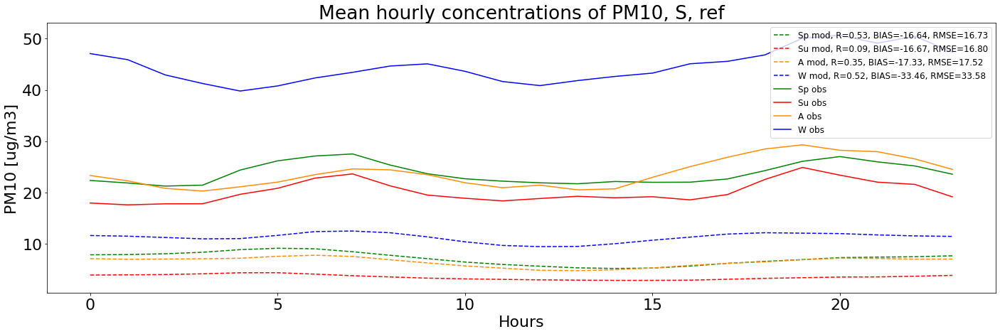

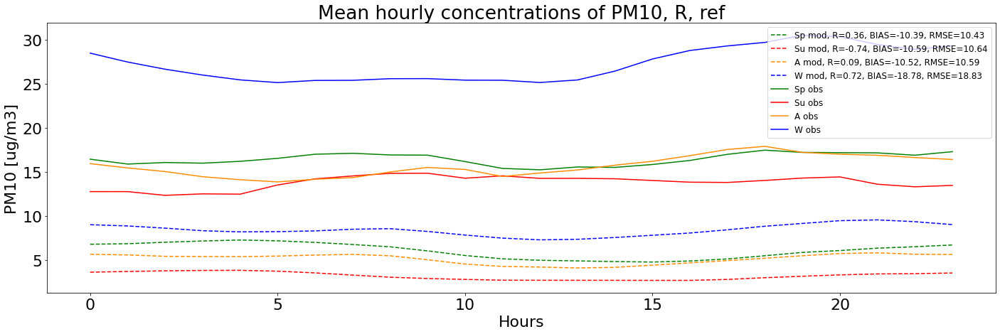

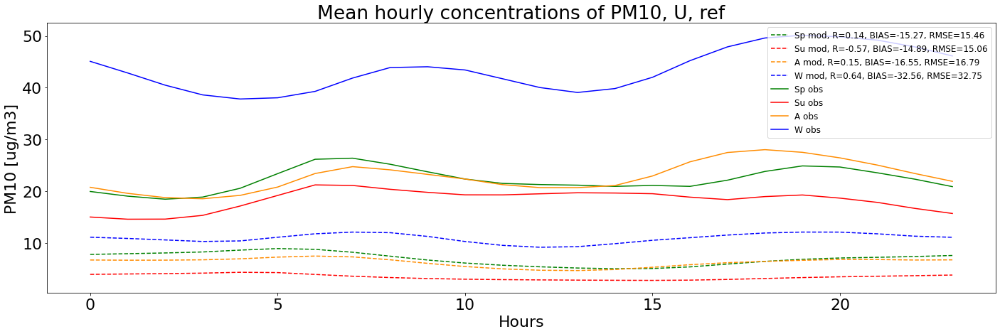

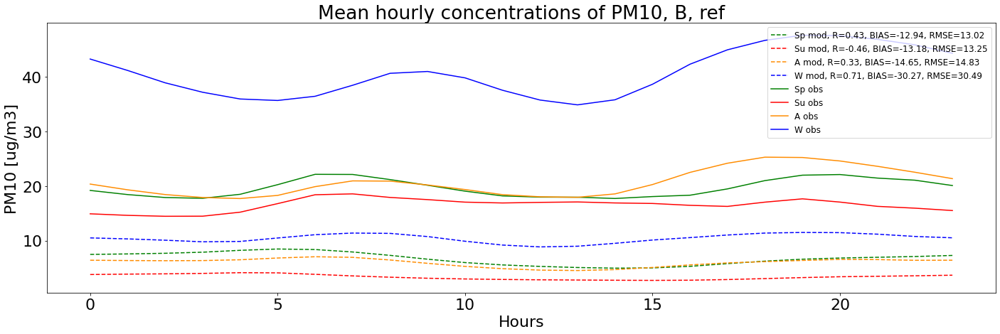

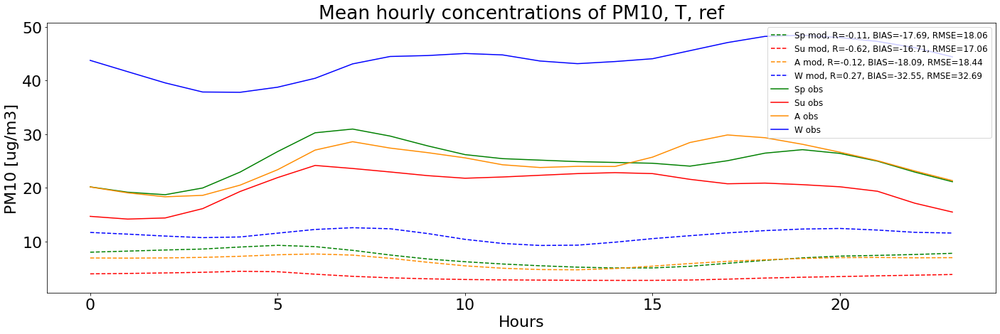

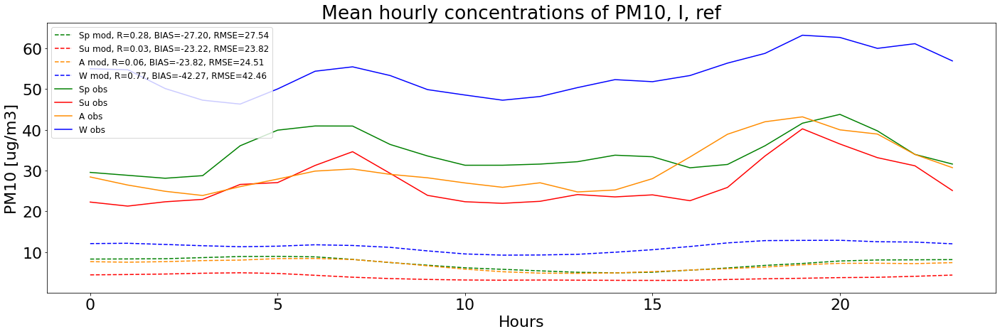

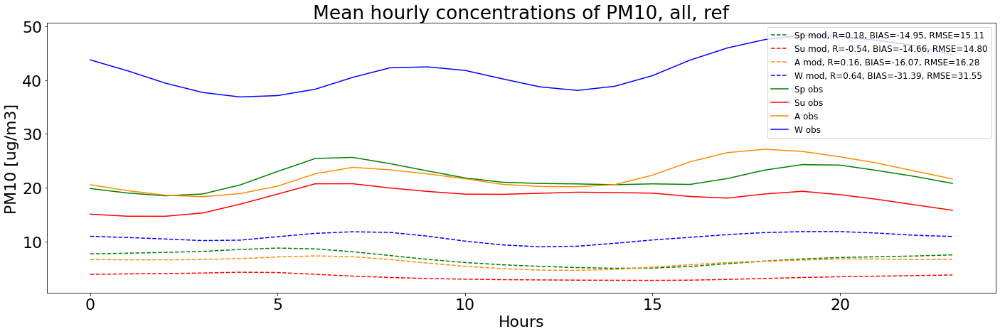

In [57]:
save = True
spec_nick = 'ref'
stat_types_new = ['RB', 'OB', 'UT']

if save:
    print('Plots will be saved at:{}'.format(save_path))
#for t in stat_types_new:
for t in all_types_all:
    #"""
    if t in locs:
        stanice_vyber = list(stat_all.loc[stat_all['loc'] == t].loc[stat_all['coverage'] != 0].index)
    elif t in types:
        stanice_vyber = list(stat_all.loc[stat_all['type'] == t].loc[stat_all['coverage'] != 0].index)
    else:
        stanice_vyber = list(stat_all.loc[stat_all['coverage'] != 0].index.values)[1:]  
    """
        
    if t == 'RB':
            #loc_, type_ = 'R', 'B'
            stanice_vyber = list(stat_all.loc[stat_all['type'] == 'B'].loc[stat_all['loc']=='R'].loc[stat_all['coverage'] != 0].index)
        
    if t == 'OB':
            stanice_vyber = list(stat_all.loc[stat_all['type'] == 'B'].loc[stat_all['loc']=='U'].loc[stat_all['coverage'] != 0].index) + list(stat_all.loc[stat_all['type'] == 'B'].loc[stat_all['loc']=='S'].loc[stat_all['coverage'] != 0].index)
             
    if t == 'UT':
            stanice_vyber = list(stat_all.loc[stat_all['type'] == 'T'].loc[stat_all['loc']=='U'].loc[stat_all['coverage'] != 0].index)
    #"""

    mod_id_jar = data[spec_nick]['MOD'].sel(station = stanice_vyber, time = data[spec_nick].time.dt.month.isin(season_months['spring'])).groupby('time.hour').mean().mean(dim = 'station')
    mod_id_leto = data[spec_nick]['MOD'].sel(station = stanice_vyber, time = data[spec_nick].time.dt.month.isin(season_months['summer'])).groupby('time.hour').mean().mean(dim = 'station')
    mod_id_jesen = data[spec_nick]['MOD'].sel(station = stanice_vyber, time = data[spec_nick].time.dt.month.isin(season_months['autumn'])).groupby('time.hour').mean().mean(dim = 'station')
    mod_id_zima = data[spec_nick]['MOD'].sel(station = stanice_vyber, time = data[spec_nick].time.dt.month.isin(season_months['winter'])).groupby('time.hour').mean().mean(dim = 'station')
    
    obs_id_jar = data[specific[0]]['OBS'].sel(station = stanice_vyber, time = data[specific[0]].time.dt.month.isin(season_months['spring'])).groupby('time.hour').mean().mean(dim = 'station')
    obs_id_leto = data[specific[0]]['OBS'].sel(station = stanice_vyber, time = data[specific[0]].time.dt.month.isin(season_months['summer'])).groupby('time.hour').mean().mean(dim = 'station')
    obs_id_jesen = data[specific[0]]['OBS'].sel(station = stanice_vyber, time = data[specific[0]].time.dt.month.isin(season_months['autumn'])).groupby('time.hour').mean().mean(dim = 'station')
    obs_id_zima = data[specific[0]]['OBS'].sel(station = stanice_vyber, time = data[specific[0]].time.dt.month.isin(season_months['winter'])).groupby('time.hour').mean().mean(dim = 'station')
    
    r_jar = mod_id_jar.to_series().corr(obs_id_jar.to_series())
    r_leto = mod_id_leto.to_series().corr(obs_id_leto.to_series())
    r_jesen = mod_id_jesen.to_series().corr(obs_id_jesen.to_series())
    r_zima = mod_id_zima.to_series().corr(obs_id_zima.to_series())
    
    jar_diff = np.array((mod_id_jar - obs_id_jar).to_series().dropna())
    leto_diff = np.array((mod_id_leto - obs_id_leto).to_series().dropna())
    jesen_diff = np.array((mod_id_jesen - obs_id_jesen).to_series().dropna())
    zima_diff = np.array((mod_id_zima - obs_id_zima).to_series().dropna())
    #if len(jar_diff) != 0:
    jar_rmse = np.sqrt(np.sum(jar_diff**2)/len(jar_diff))
    leto_rmse = np.sqrt(np.sum(leto_diff**2)/len(leto_diff))
    jesen_rmse = np.sqrt(np.sum(jesen_diff**2)/len(jesen_diff))
    zima_rmse = np.sqrt(np.sum(zima_diff**2)/len(zima_diff))
    
    jar_bias, leto_bias = np.sum(jar_diff)/len(jar_diff), np.sum(leto_diff)/len(leto_diff)
    jesen_bias, zima_bias = np.sum(jesen_diff)/len(jesen_diff), np.sum(zima_diff)/len(zima_diff)
    #else:
    #    stat_rmse = np.nan
    
    #name_sta = stat[spec_nick].name.loc[stat[spec_nick].index == i].item()
    
    plt.rcParams['figure.figsize'] = 20,7
    plt.rcParams.update({'font.size': 22})

    plt.plot(mod_id_jar.hour, mod_id_jar[:], color ='green', linestyle='--', label = 'Sp mod, R={:0.2f}, BIAS={:0.2f}, RMSE={:0.2f}'.format(r_jar, jar_bias, jar_rmse)) 
    plt.plot(mod_id_leto.hour, mod_id_leto[:], color ='red', linestyle='--', label = 'Su mod, R={:0.2f}, BIAS={:0.2f}, RMSE={:0.2f}'.format(r_leto, leto_bias, leto_rmse))
    plt.plot(mod_id_jesen.hour, mod_id_jesen[:], color ='darkorange', linestyle='--', label = 'A mod, R={:0.2f}, BIAS={:0.2f}, RMSE={:0.2f}'.format(r_jesen, jesen_bias, jesen_rmse)) 
    plt.plot(mod_id_zima.hour, mod_id_zima[:], color ='blue', linestyle='--', label = 'W mod, R={:0.2f}, BIAS={:0.2f}, RMSE={:0.2f}'.format(r_zima, zima_bias, zima_rmse))
    
    plt.plot(obs_id_jar.hour, obs_id_jar[:], color ='green', label = 'Sp obs') 
    plt.plot(obs_id_leto.hour, obs_id_leto[:], color ='red', label = 'Su obs')
    plt.plot(obs_id_jesen.hour, obs_id_jesen[:], color ='darkorange', label = 'A obs') 
    plt.plot(obs_id_zima.hour, obs_id_zima[:], color ='blue', label = 'W obs')
    
    plt.legend(fontsize=12)                
    plt.title('Mean hourly concentrations of {0}, {1}, {2}'.format(v,t,spec_nick))                               
    plt.xlabel('Hours')
    plt.ylabel('{0} [{1}]'.format(v,units))
    plt.tight_layout()

    if save:
        if not os.path.exists(save_path):
            os.makedirs(save_path)
        plt.savefig('{0}/MH_seasons_{1}_{2}_{3}_stat.png'.format(save_path,v,spec_nick,t), dpi=300) 
    plt.show()                
    plt.close() 

### Normovane Model - station types

Plots will be saved at:/data/teri/validacia/validated/CMAQ2017d02_ref_vs_cop_vs_const/graphs/PM10


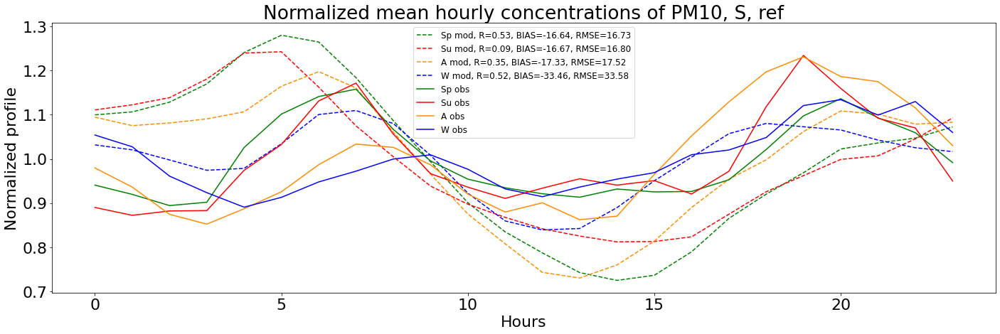

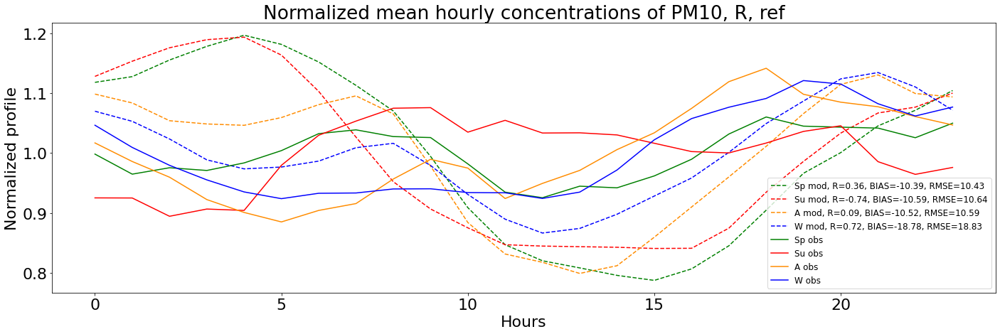

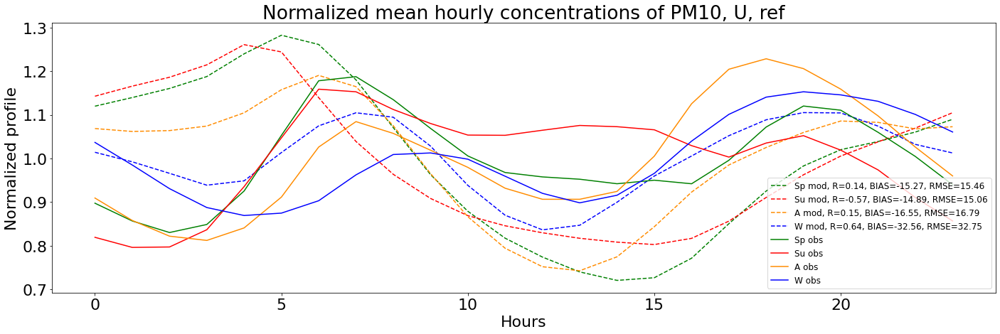

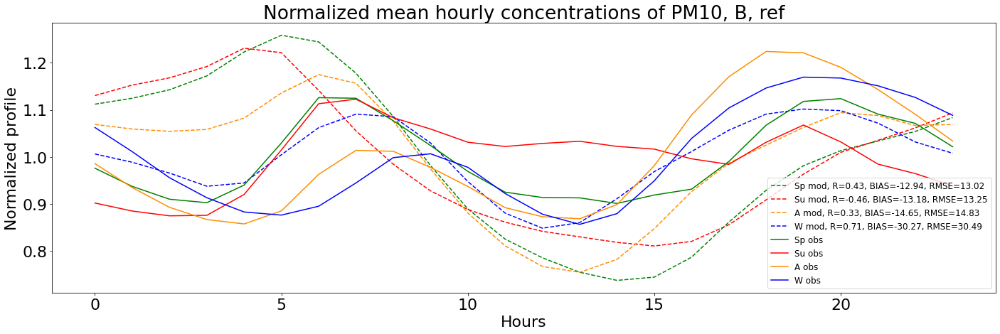

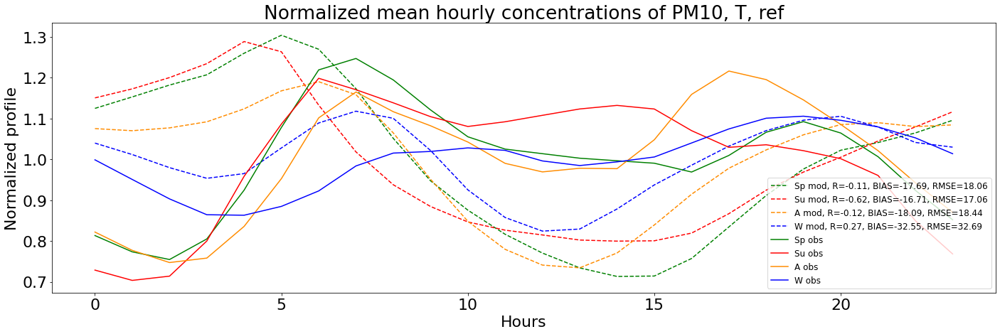

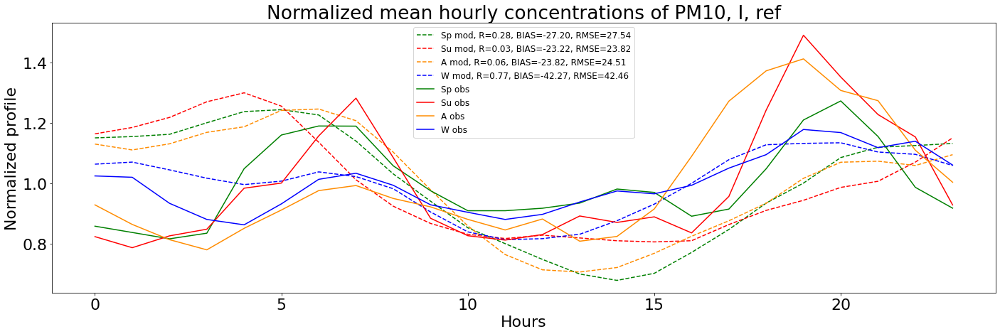

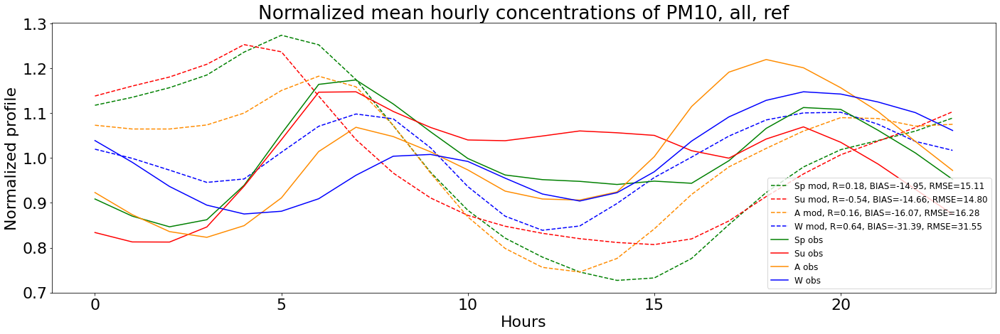

In [58]:
save = True
spec_nick = 'ref'
stat_types_new = ['RB', 'OB', 'UT']

if save:
    print('Plots will be saved at:{}'.format(save_path))
#for t in stat_types_new:
for t in all_types_all:
    #"""
    if t in locs:
        stanice_vyber = list(stat_all.loc[stat_all['loc'] == t].loc[stat_all['coverage'] != 0].index)
    elif t in types:
        stanice_vyber = list(stat_all.loc[stat_all['type'] == t].loc[stat_all['coverage'] != 0].index)
    else:
        stanice_vyber = list(stat_all.loc[stat_all['coverage'] != 0].index.values)[1:]  
    """
        
    if t == 'RB':
            #loc_, type_ = 'R', 'B'
            stanice_vyber = list(stat_all.loc[stat_all['type'] == 'B'].loc[stat_all['loc']=='R'].loc[stat_all['coverage'] != 0].index)
        
    if t == 'OB':
            stanice_vyber = list(stat_all.loc[stat_all['type'] == 'B'].loc[stat_all['loc']=='U'].loc[stat_all['coverage'] != 0].index) + list(stat_all.loc[stat_all['type'] == 'B'].loc[stat_all['loc']=='S'].loc[stat_all['coverage'] != 0].index)
             
    if t == 'UT':
            stanice_vyber = list(stat_all.loc[stat_all['type'] == 'T'].loc[stat_all['loc']=='U'].loc[stat_all['coverage'] != 0].index)
    #"""

    mod_id_jar = data[spec_nick]['MOD'].sel(station = stanice_vyber, time = data[spec_nick].time.dt.month.isin(season_months['spring'])).groupby('time.hour').mean().mean(dim = 'station')
    mod_id_leto = data[spec_nick]['MOD'].sel(station = stanice_vyber, time = data[spec_nick].time.dt.month.isin(season_months['summer'])).groupby('time.hour').mean().mean(dim = 'station')
    mod_id_jar_norm, mod_id_leto_norm = 24*mod_id_jar/mod_id_jar.sum(), 24*mod_id_leto/mod_id_leto.sum()
    mod_id_jesen = data[spec_nick]['MOD'].sel(station = stanice_vyber, time = data[spec_nick].time.dt.month.isin(season_months['autumn'])).groupby('time.hour').mean().mean(dim = 'station')
    mod_id_zima = data[spec_nick]['MOD'].sel(station = stanice_vyber, time = data[spec_nick].time.dt.month.isin(season_months['winter'])).groupby('time.hour').mean().mean(dim = 'station')
    mod_id_jesen_norm, mod_id_zima_norm = 24*mod_id_jesen/mod_id_jesen.sum(), 24*mod_id_zima/mod_id_zima.sum()
    
    obs_id_jar = data[specific[0]]['OBS'].sel(station = stanice_vyber, time = data[specific[0]].time.dt.month.isin(season_months['spring'])).groupby('time.hour').mean().mean(dim = 'station')
    obs_id_leto = data[specific[0]]['OBS'].sel(station = stanice_vyber, time = data[specific[0]].time.dt.month.isin(season_months['summer'])).groupby('time.hour').mean().mean(dim = 'station')
    obs_id_jar_norm, obs_id_leto_norm = 24*obs_id_jar/obs_id_jar.sum(), 24*obs_id_leto/obs_id_leto.sum()
    obs_id_jesen = data[specific[0]]['OBS'].sel(station = stanice_vyber, time = data[specific[0]].time.dt.month.isin(season_months['autumn'])).groupby('time.hour').mean().mean(dim = 'station')
    obs_id_zima = data[specific[0]]['OBS'].sel(station = stanice_vyber, time = data[specific[0]].time.dt.month.isin(season_months['winter'])).groupby('time.hour').mean().mean(dim = 'station')
    obs_id_jesen_norm, obs_id_zima_norm = 24*obs_id_jesen/obs_id_jesen.sum(), 24*obs_id_zima/obs_id_zima.sum()
    
    r_jar = mod_id_jar.to_series().corr(obs_id_jar.to_series())
    r_leto = mod_id_leto.to_series().corr(obs_id_leto.to_series())
    r_jesen = mod_id_jesen.to_series().corr(obs_id_jesen.to_series())
    r_zima = mod_id_zima.to_series().corr(obs_id_zima.to_series())
    
    jar_diff = np.array((mod_id_jar - obs_id_jar).to_series().dropna())
    leto_diff = np.array((mod_id_leto - obs_id_leto).to_series().dropna())
    jesen_diff = np.array((mod_id_jesen - obs_id_jesen).to_series().dropna())
    zima_diff = np.array((mod_id_zima - obs_id_zima).to_series().dropna())
    #if len(jar_diff) != 0:
    jar_rmse = np.sqrt(np.sum(jar_diff**2)/len(jar_diff))
    leto_rmse = np.sqrt(np.sum(leto_diff**2)/len(leto_diff))
    jesen_rmse = np.sqrt(np.sum(jesen_diff**2)/len(jesen_diff))
    zima_rmse = np.sqrt(np.sum(zima_diff**2)/len(zima_diff))
    
    jar_bias, leto_bias = np.sum(jar_diff)/len(jar_diff), np.sum(leto_diff)/len(leto_diff)
    jesen_bias, zima_bias = np.sum(jesen_diff)/len(jesen_diff), np.sum(zima_diff)/len(zima_diff)
    
    #name_sta = stat[spec_nick].name.loc[stat[spec_nick].index == i].item()
    
    plt.rcParams['figure.figsize'] = 20,7
    plt.rcParams.update({'font.size': 22})

    plt.plot(mod_id_jar.hour, mod_id_jar_norm[:], color ='green', linestyle='--', label = 'Sp mod, R={:0.2f}, BIAS={:0.2f}, RMSE={:0.2f}'.format(r_jar, jar_bias, jar_rmse)) 
    plt.plot(mod_id_leto.hour, mod_id_leto_norm[:], color ='red', linestyle='--', label = 'Su mod, R={:0.2f}, BIAS={:0.2f}, RMSE={:0.2f}'.format(r_leto, leto_bias, leto_rmse))
    plt.plot(mod_id_jesen.hour, mod_id_jesen_norm[:], color ='darkorange', linestyle='--', label = 'A mod, R={:0.2f}, BIAS={:0.2f}, RMSE={:0.2f}'.format(r_jesen, jesen_bias, jesen_rmse)) 
    plt.plot(mod_id_zima.hour, mod_id_zima_norm[:], color ='blue', linestyle='--', label = 'W mod, R={:0.2f}, BIAS={:0.2f}, RMSE={:0.2f}'.format(r_zima, zima_bias, zima_rmse))
    
    plt.plot(obs_id_jar.hour, obs_id_jar_norm[:], color ='green', label = 'Sp obs') 
    plt.plot(obs_id_leto.hour, obs_id_leto_norm[:], color ='red', label = 'Su obs')
    plt.plot(obs_id_jesen.hour, obs_id_jesen_norm[:], color ='darkorange', label = 'A obs') 
    plt.plot(obs_id_zima.hour, obs_id_zima_norm[:], color ='blue', label = 'W obs')
    
    plt.legend(fontsize=12)                
    plt.title('Normalized mean hourly concentrations of {0}, {1}, {2}'.format(v,t,spec_nick))                               
    plt.xlabel('Hours')
    plt.ylabel('Normalized profile')
    plt.tight_layout()

    if save:
        if not os.path.exists(save_path):
            os.makedirs(save_path)
        plt.savefig('{0}/MH_norm_seasons_{1}_{2}_{3}.png'.format(save_path,v,spec_nick,t), dpi=300) 
    plt.show()                
    plt.close() 

## Zimny vs letny cas

In [ ]:
### USER INPUT
# Choose stations to plot
ID = list(stat_all.index.values)[1:]   # all stations
#ID = [11813,11916]    # selected stations

letny = 'leto'
zimny = 'zima'
spec_nick = 'orig'

save = False   # save the plots?  

save_path = '{0}/validated/{1}_{2}/graphs/{3}'.format(vali_path, nick, start_date[0:4],v)
save_path

In [ ]:
if save:
    print('Plots will be saved at:{}'.format(save_path))
for i in ID:    
    
    obs_id_leto = data[specific[0]]['OBS'].sel(station = i, time = data[specific[0]].time.dt.month.isin(season_months[letny])).groupby('time.hour').mean()
    obs_id_zima = data[specific[0]]['OBS'].sel(station = i, time = data[specific[0]].time.dt.month.isin(season_months[zimny])).groupby('time.hour').mean()
    
    mod_id_leto = data[spec_nick]['MOD'].sel(station = i, time = data[spec_nick].time.dt.month.isin(season_months[letny])).groupby('time.hour').mean()
    mod_id_zima = data[spec_nick]['MOD'].sel(station = i, time = data[spec_nick].time.dt.month.isin(season_months[zimny])).groupby('time.hour').mean()
    
    r_leto = mod_id_leto.to_series().corr(obs_id_leto.to_series())
    r_zima = mod_id_zima.to_series().corr(obs_id_zima.to_series())
    
    name_sta = stat[specific[0]].name.loc[stat[specific[0]].index == i].item()
    
    plt.rcParams['figure.figsize'] = 20,7
    plt.rcParams.update({'font.size': 22})

    plt.plot(obs_id_leto.hour, obs_id_leto[:], color ='salmon', label = 'letny cas') 
    plt.plot(obs_id_zima.hour, obs_id_zima[:], color ='dodgerblue', label = 'zimny cas')
    
    plt.plot(mod_id_leto.hour, mod_id_leto[:], color ='red', label = 'leto mod, R={:0.2f}'.format(r_leto))
    plt.plot(mod_id_zima.hour, mod_id_zima[:], color ='blue', label = 'zima mod, R={:0.2f}'.format(r_zima))

    plt.legend(fontsize=12)                
    plt.title('Mean hourly concentration of {0}, {1}'.format(v,name_sta))                               
    plt.xlabel('Hours')
    plt.ylabel('{0} [{1}]'.format(v,units))
    plt.tight_layout()

    if save:
        if not os.path.exists(save_path):
            os.makedirs(save_path)
        plt.savefig('{0}/{1}_{2}_{3}_{4}_MH{5}-{6}.png'.format(save_path,nick, start_date[0:4], v, i,plot_from,plot_until), dpi=300)                
    plt.show()                
    plt.close() 

## Sezonalita 

### Vsetky stanice

In [59]:
save_path = '/data/teri/validacia/validated/{0}/graphs/{1}'.format(folder_name,v)
#ID = list(stat_all.index.values)[:]
ID = list(stat_all.index.values)
fzl = stat[specific[0]][['name','loc','type','coverage']].copy()
zl = stat[specific[0]][['name','loc','type','coverage']].copy()

for i in ID:
    #print(i)
    if i == 'all':
        zima = data['ref']['OBS'].sel(time = data[specific[0]].time.dt.month.isin(season_months['winter'])).mean()
        leto = data['ref']['OBS'].sel(time = data[specific[0]].time.dt.month.isin(season_months['summer'])).mean()
        obs_mean = data['ref']['OBS'].sel(time = data[specific[0]].time.dt.month.isin(season_months['year'])).mean()
    else:
        zima = data['ref']['OBS'].sel(station = i, time = data[specific[0]].time.dt.month.isin(season_months['winter'])).mean()
        leto = data['ref']['OBS'].sel(station = i, time = data[specific[0]].time.dt.month.isin(season_months['summer'])).mean()
        obs_mean = data['ref']['OBS'].sel(station = i, time = data[specific[0]].time.dt.month.isin(season_months['year'])).mean()
    
    fzl.at[i, 'fzl_obs'] = zima/leto
    zl.at[i, 'zl_obs'] = (zima - leto)/obs_mean

    for s in specific:
        if i == 'all':
            zima = data[s]['MOD'].sel(time = data[specific[0]].time.dt.month.isin(season_months['winter'])).mean()
            leto = data[s]['MOD'].sel(time = data[specific[0]].time.dt.month.isin(season_months['summer'])).mean()
            mod_mean = data[s]['MOD'].sel(time = data[specific[0]].time.dt.month.isin(season_months['year'])).mean()
        else:
            zima = data[s]['MOD'].sel(station = i, time = data[s].time.dt.month.isin(season_months['winter'])).mean()
            leto = data[s]['MOD'].sel(station = i, time = data[s].time.dt.month.isin(season_months['summer'])).mean()
            mod_mean = data[s]['MOD'].sel(station = i, time = data[s].time.dt.month.isin(season_months['year'])).mean()
        
        if zima != np.nan and leto != np.nan:
            fzl.at[i, 'fzl_{0}'.format(s)] = zima/leto
            zl.at[i, 'zl_{0}'.format(s)] = (zima - leto)/mod_mean
        else:
            fzl.at[i, 'fzl_{0}'.format(s)] = np.nan
            zl.at[i, 'zl_{0}'.format(s)] = np.nan

fzl

/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)
/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)
/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)
/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)
/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)
/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return 

,name,loc,type,coverage,fzl_obs,fzl_ref,fzl_cop,fzl_rh_const,fzl_tot_const
all,all,all,all,97.2845,2.362590,2.906281,2.868034,2.266720,2.094398
11813,"BRATISLAVA, JESENIOVA",S,B,96.8379,2.428195,3.822028,3.710893,2.748675,2.494412
11916,"CHOPOK, EMEP",R,B,0,NaN,0.841750,0.837433,0.761707,0.728983
11952,"GANOVCE, METEO. ST.",R,B,0,NaN,1.914916,1.874835,1.423445,1.391537
11958,KOJSOVSKA HOLA,R,B,0,NaN,1.867897,1.858291,1.592643,1.532426
99111,"BRATISLAVA, MAMATEYOVA",U,B,98.7443,1.721759,3.476540,3.410175,2.813668,2.473364
99112,"BRATISLAVA, TRNAVSKE MYTO",U,T,89.5776,1.636507,3.822028,3.710893,2.748675,2.494412
99114,"BRATISLAVA, KAMENNE NAM.",U,B,83.4475,1.001838,3.822028,3.710893,2.748675,2.494412
99117,BRATISLAVA - RACA,None,None,0,NaN,3.562300,3.508989,2.880778,2.652422
99122,"SENICA, HVIEZDOSLAVOVA",U,T,95.4566,2.319603,3.380371,3.342172,2.893898,2.608136


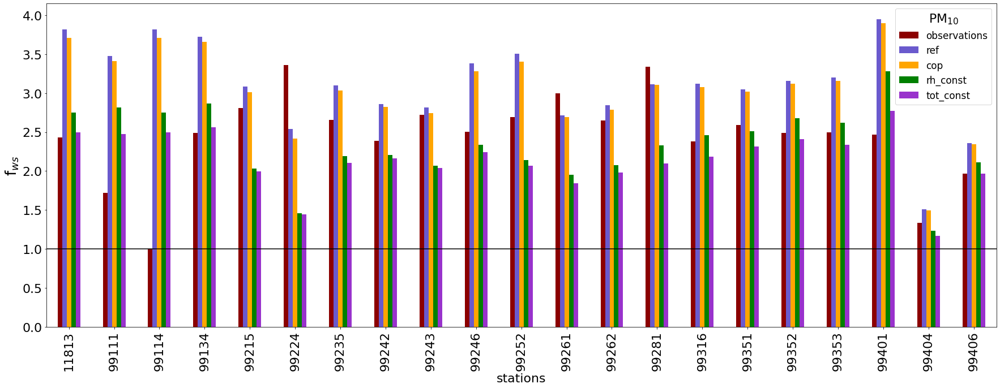

In [60]:
station_list = list(stat_all.loc[stat_all['type'] == 'B'].loc[stat_all.coverage != 0].index.values)

plt.rcParams['figure.figsize'] = 25,10
plt.rcParams.update({'font.size': 22})
# VYBER STANIC Z LISTU
fzl.loc[station_list,list(fzl.columns)[4:]].plot.bar(color = ['darkred','slateblue','orange','green','darkorchid'])
#fzl.loc[station_list,list(fzl.columns)[4:]].plot.bar(color=['red','k','b','green','fuchsia'])
# PLOT VSETKYCH STANIC S NAZVAMI (ROZMER ZADAT 40,8) 
#fzl.plot.bar(x = 'name',y = ['fzl_obs','fzl_orig','fzl_rh_const','fzl_tot_const'],color=['darkred','slateblue','orange','green'])
# PLOT VSETKYCH STANIC S KODOM (ROZMER ZADAT 40,8)
#fzl.iloc[:,4:].plot.bar(color=['darkred','slateblue','orange','green'])
plt.legend(["observations", "ref", "cop", 'rh_const','tot_const'],title='PM$_{10}$',fontsize=17)
plt.axhline(y=1,color='black')
plt.ylabel('f$_{ws}$', fontsize=26)
plt.xlabel('stations', fontsize=22)
plt.tight_layout()
    
plt.savefig('{0}/fzl_{1}_{2}.png'.format(save_path,folder_name,v), dpi=300)
plt.show()
plt.close()

In [61]:
save_path

'/data/teri/validacia/validated/CMAQ2017d02_ref_vs_cop_vs_const/graphs/PM10'

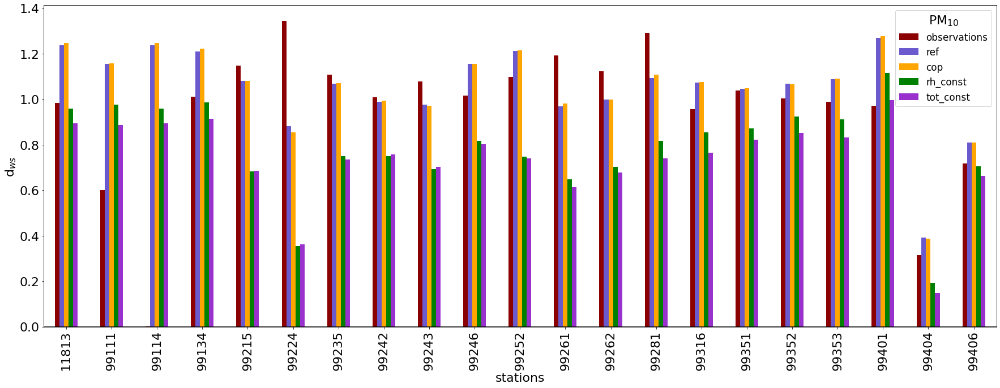

In [62]:
station_list = list(stat_all.loc[stat_all['type'] == 'B'].loc[stat_all.coverage != 0].index.values)

plt.rcParams['figure.figsize'] = 25,10
plt.rcParams.update({'font.size': 22})
zl.loc[station_list,list(zl.columns)[4:]].plot.bar(color=['darkred','slateblue','orange','green','darkorchid'])
#zl.iloc[:,4:].plot.bar(color=['darkred','slateblue','orange','green'])
plt.legend(["observations", "ref", "cop", 'rh_const','tot_const'],title='PM$_{10}$',fontsize=17)
plt.axhline(y=0,color='black')
#plt.ylabel('Mean winter - summer conc. $[\mu g . m^{-3}]$', fontsize=22)  #18
plt.ylabel('d$_{ws}$', fontsize=22)  #18
plt.xlabel('stations', fontsize=22)
plt.tight_layout()
    
plt.savefig('{0}/dws_{1}_{2}.png'.format(save_path,folder_name,v), dpi=300)
plt.show()
plt.close()

### Typy stanic 

In [63]:
fzl_types = pd.DataFrame(index = all_types, columns = ['count']+list(fzl.columns)[3:], dtype = 'float64')
zl_types = pd.DataFrame(index = all_types, columns = ['count']+list(zl.columns)[3:], dtype = 'float64')
for t in all_types:
    if t in locs:
        col = 'loc'
    else:
        col = 'type'
        
    stanice_vyber = list(stat_all.loc[stat_all[col] == t].loc[stat_all['coverage'] != 0].index)
    fzl_types.at[t,'count'], zl_types.at[t,'count']  = len(stanice_vyber), len(stanice_vyber)
    obs = data['ref']['OBS'].sel(station = stanice_vyber, time = data['ref'].time.dt.month.isin(season_months['year'])).to_series()
    zima = data['ref']['OBS'].sel(station = stanice_vyber, time = data['ref'].time.dt.month.isin(season_months['winter'])).mean()
    leto = data['ref']['OBS'].sel(station = stanice_vyber, time = data['ref'].time.dt.month.isin(season_months['summer'])).mean()    
    coverage = 100*(len(obs) - obs.isna().sum())/len(obs)
    fzl_types.at[t,'coverage'], zl_types.at[t,'coverage'] = coverage, coverage
    obs_mean = np.mean(obs)
    
    fzl_types.at[t, 'fzl_obs'] = zima/leto
    zl_types.at[t, 'zl_obs'] = (zima - leto)/obs_mean
    #zl_types.at[t, 'zl_obs'] = (zima - leto)
    
    for s in specific:
        zima = data[s]['MOD'].sel(station = stanice_vyber, time = data[s].time.dt.month.isin(season_months['winter'])).mean()
        leto = data[s]['MOD'].sel(station = stanice_vyber, time = data[s].time.dt.month.isin(season_months['summer'])).mean()
        mod_mean = data[s]['MOD'].sel(station = stanice_vyber, time = data['ref'].time.dt.month.isin(season_months['year'])).mean()
        
        fzl_types.at[t, 'fzl_{0}'.format(s)] = zima/leto
        zl_types.at[t, 'zl_{0}'.format(s)] = (zima - leto)/mod_mean
        #zl_types.at[t, 'zl_{0}'.format(s)] = (zima - leto)
    
        
zl_types

,count,coverage,zl_obs,zl_ref,zl_cop,zl_rh_const,zl_tot_const
S,3.0,97.031963,0.883067,1.099841,1.105034,0.868402,0.805536
R,3.0,98.295282,0.735561,0.910415,0.912879,0.765115,0.688248
U,27.0,97.200237,0.967458,1.095758,1.097847,0.822765,0.776622
B,21.0,97.504892,1.023512,1.071889,1.075099,0.808089,0.760630
T,11.0,96.714404,0.833926,1.103526,1.105170,0.844405,0.796241
I,1.0,98.926941,0.732333,1.042347,1.042191,0.866832,0.748431


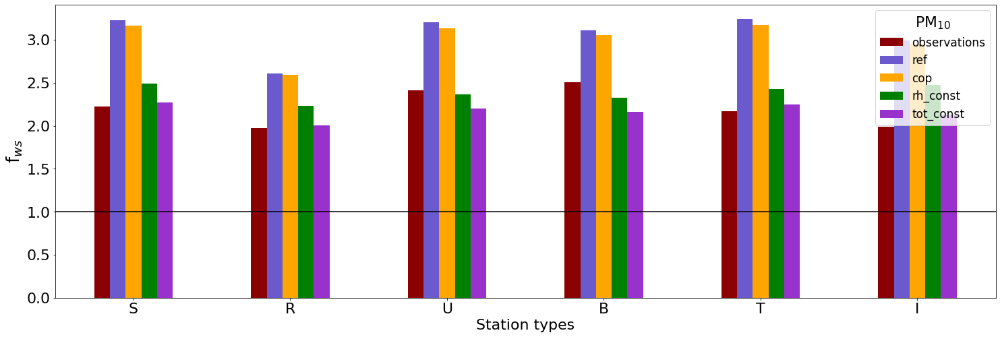

In [64]:
plt.rcParams['figure.figsize'] = 25,8
plt.rcParams.update({'font.size': 22})
fzl_types.iloc[:,2:].plot.bar(color=['darkred','slateblue','orange','green','darkorchid'], rot=0)
plt.legend(["observations", "ref", "cop", 'rh_const','tot_const'],title='PM$_{10}$',fontsize=17)
plt.axhline(y=1,color='black')
plt.ylabel('f$_{ws}$', fontsize=26)
plt.xlabel('Station types', fontsize=22)
    
plt.savefig('{0}/fws_station_types_{1}_{2}.png'.format(save_path,folder_name,v), dpi=300)
plt.show()
plt.close()

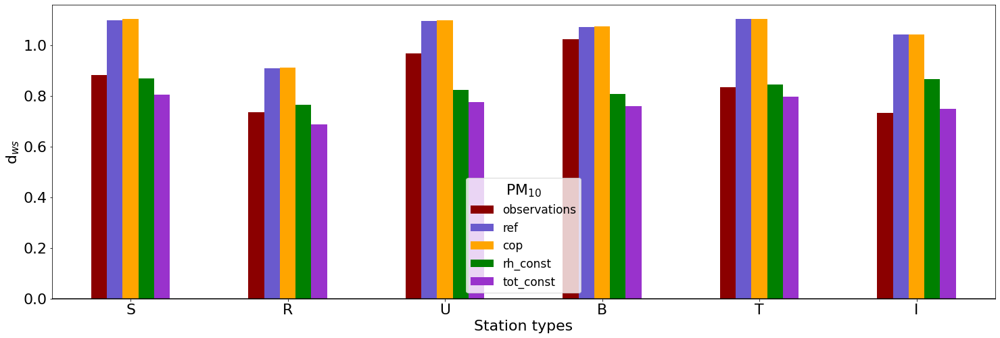

In [65]:
plt.rcParams['figure.figsize'] = 25,8
plt.rcParams.update({'font.size': 22})
zl_types.iloc[:,2:].plot.bar(color=['darkred','slateblue','orange','green','darkorchid'], rot=0)
plt.legend(["observations", "ref", "cop", 'rh_const','tot_const'],title='PM$_{10}$',fontsize=17)
plt.axhline(y=0,color='black')
#plt.ylabel('Mean winter - summer conc. $[\mu g . m^{-3}]$', fontsize=22)  #18
plt.ylabel('d$_{ws}$', fontsize=22)  #18
plt.xlabel('Station types', fontsize=22)
    
#plt.savefig('{0}/ws_station_types_{1}_CMAQ2017d02.png'.format(save_path,v), dpi=300)
plt.savefig('{0}/dws_station_types_{1}_{2}.png'.format(save_path, folder_name, v), dpi=300)
plt.show()
plt.close()

# PM2.5

In [66]:
v = 'PM2_5'
v2 = 'PM'
path = {'cop':'/data/oko/dusan/POST/WB_2017_d02_CAMS_13_res_heat_PM_2017',
        'ref':'/data/oko/dusan/POST/WB_2020_PM_2017',
       'rh_const':'/data/oko/dusan/POST/WB_const_PM_2017',
       'tot_const':'/data/oko/dusan/POST/WB_totcons_{0}_2017'.format(v2)} # prisluchajuca cesta k suboru

#for i in range(0, len(specific)):
for i, key in enumerate(specific):
    print(key)
    stat[key], data[key] = vali.validation(path[key], model_name[i], grid_name[i], start_date[i], end_date[i], v)

ref
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=11813 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=11916 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=11952 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=11958 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
sel

Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=99323 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=99325 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=99326 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=99334 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select 

/data/teri/validacia/validacia_v2.py:237: RuntimeWarning: Mean of empty slice
  stat['obs_mean'][s] = np.nanmean(obs_all[s])


Validation of PM2_5 done in 64.98611497879028 seconds
cop
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=11813 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=11916 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=11952 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=11958 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making con

Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=99316 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=99323 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=99325 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=99326 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select 

Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=99139 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=99214 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=99215 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=99217 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select 

Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=11916 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=11952 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=11958 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=99111 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select 

Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=99325 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=99326 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=99334 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select si.ii,si.lat,si.lon,si.elev, o.* from obs.obs_nmsko_1h o join si.si on si.id=o.si_id where ii=99351 and date between '2017-01-01 01:00:00' and '2018-01-01 00:00:00'
Making connection to database 10.20.7.200
Working on query: 
select 

## Statistika

### Vsetky stanice

In [67]:
my_season = 'year'

stat_all = stat[specific[0]][['name','loc','type','coverage','obs_mean']].copy()

for s in statistiky:
    for i in specific:
        stat_all['{0}_{1}'.format(s,i)] = pd.Series(dtype = 'float64')

for i in specific:   
    for s in stat_all.index:
        
        if s == 'all':
            obs = data[i]['OBS'].sel(time = data[i].time.dt.month.isin(season_months[my_season])).to_series()
            mod = data[i]['MOD'].sel(time = data[i].time.dt.month.isin(season_months[my_season])).to_series()
        else: 
            obs = data[i]['OBS'].sel(station = s, time = data[i].time.dt.month.isin(season_months[my_season])).to_series()
            mod = data[i]['MOD'].sel(station = s, time = data[i].time.dt.month.isin(season_months[my_season])).to_series()

        stat_all.at[s,'R_{0}'.format(i)] = obs.corr(mod)
        diff = (mod - obs).to_numpy()
        diff = diff[~np.isnan(diff)]
        obs[obs == 0] = np.nan
        obs_ = obs[~np.isnan(obs)]
        stat_all.at[s, 'obs_mean'] = np.nanmean(obs)
        podiel = (mod/obs).to_numpy()
        podiel = podiel[~np.isnan(podiel)]
        podiel_fac2 = podiel[podiel <= 2]
        podiel_fac2 = podiel_fac2[podiel_fac2 >= 0.5]
        
        if len(diff) != 0:
            stat_all.at[s, 'MB_{0}'.format(i)] = np.sum(diff)/len(diff)
            #stat_all.at[s, 'MPE_{0}'.format(i)] = 100*np.sum(diff/obs_)/len(diff)
            #stat_all.at[s,'MGE_{0}'.format(i)] = np.sum(np.absolute(diff))/len(diff)
            #stat_all.at[s,'MGPE_{0}'.format(i)] = 100*np.sum(np.absolute(diff/obs_))/len(diff)
            stat_all.at[s,'RMSE_{0}'.format(i)] = np.sqrt(np.sum(diff**2)/len(diff))
            #stat_all.at[s,'RMSPE_{0}'.format(i)] = 100*np.sqrt(np.sum((diff/obs_)**2)/len(diff))
            stat_all.at[s,'FAC2_{0}'.format(i)] = 100*len(podiel_fac2)/len(podiel)

#stat_all.loc[stat_all.coverage != 0]
#stat_all.loc[stat_all.r_full >= 0.5]
stat_all.to_csv('/data/teri/validacia/validated/{0}/tabulky/validation_{1}_all_{2}_2.csv'.format(folder_name,v,my_season))
stat_all.loc[stat_all.coverage != 0]

<ipython-input-67-036312436282>:24: RuntimeWarning: Mean of empty slice
  stat_all.at[s, 'obs_mean'] = np.nanmean(obs)


,name,loc,type,coverage,obs_mean,R_ref,R_cop,R_rh_const,R_tot_const,MB_ref,MB_cop,MB_rh_const,MB_tot_const,RMSE_ref,RMSE_cop,RMSE_rh_const,RMSE_tot_const,FAC2_ref,FAC2_cop,FAC2_rh_const,FAC2_tot_const
all,all,all,all,95.4434,18.7901,0.524226,0.528368,0.458989,0.449424,-12.314006,-12.138886,-12.253413,-11.941476,21.063410,20.905611,21.417068,21.284937,31.401586,32.562503,33.695388,35.895375
11813,"BRATISLAVA, JESENIOVA",S,B,96.7922,14.047,0.662255,0.672822,0.620941,0.607418,-6.592278,-6.402085,-6.479057,-6.142593,13.925815,13.699682,14.305096,14.233159,51.515509,53.225616,55.702323,56.999646
99111,"BRATISLAVA, MAMATEYOVA",U,B,98.1621,15.3904,0.658805,0.666319,0.630891,0.619313,-8.028045,-7.887658,-7.928162,-7.635020,15.831442,15.666867,16.052791,15.994909,48.377718,49.691825,51.878125,53.796953
99114,"BRATISLAVA, KAMENNE NAM.",U,B,50.7991,10.5609,0.531240,0.531294,0.486553,0.483325,-4.468010,-4.343297,-4.149761,-3.508106,9.126012,9.064938,9.194673,8.950145,49.460674,50.022472,49.505618,51.325843
99122,"SENICA, HVIEZDOSLAVOVA",U,T,97.1689,16.4472,0.571589,0.575919,0.543508,0.515935,-9.788472,-9.701670,-9.726908,-9.414326,15.321331,15.229015,15.454733,15.396851,35.361842,36.007989,36.524906,38.627820
99123,"TRNAVA, KOLLAROVA",U,T,97.1689,16.8043,0.521540,0.526966,0.485115,0.442087,-9.804380,-9.648966,-9.724457,-9.447779,15.976246,15.834597,16.160344,16.232223,35.338346,36.207707,37.135808,37.476504
99128,"TRENCIN, HASICSKA",U,T,97.6598,13.1957,0.258751,0.261151,0.227548,0.268391,-6.225556,-6.044617,-6.169385,-5.771321,13.049023,12.994597,13.074050,12.707625,34.903565,35.838691,36.306254,40.233781
99132,"MALACKY, MIEROVE NAMESTIE",U,T,91.8379,17.1592,0.573801,0.581922,0.538817,0.521113,-9.965319,-9.871071,-9.952191,-9.699884,15.341155,15.221410,15.553416,15.483548,34.965817,35.500311,35.997514,38.023617
99134,"NITRA, JANIKOVCE",U,B,97.0091,19.0217,0.623747,0.635399,0.564828,0.552821,-12.028317,-11.854098,-11.969219,-11.715697,19.323775,19.103761,19.703673,19.625490,29.442222,30.913156,33.278418,37.102848
99135,"NITRA, STUROVA",U,T,84.7717,14.3824,0.526027,0.537867,0.456974,0.436523,-7.317779,-7.114676,-7.190630,-7.014775,14.399691,14.201676,14.793478,14.828953,38.553730,39.792621,42.162672,42.512793


In [68]:
#stat_all.loc[stat_all.coverage != 0]
stat_all.loc[stat_all.R_ref <= 0.3]

,name,loc,type,coverage,obs_mean,R_ref,R_cop,R_rh_const,R_tot_const,MB_ref,MB_cop,MB_rh_const,MB_tot_const,RMSE_ref,RMSE_cop,RMSE_rh_const,RMSE_tot_const,FAC2_ref,FAC2_cop,FAC2_rh_const,FAC2_tot_const
99128,"TRENCIN, HASICSKA",U,T,97.6598,13.1957,0.258751,0.261151,0.227548,0.268391,-6.225556,-6.044617,-6.169385,-5.771321,13.049023,12.994597,13.07405,12.707625,34.903565,35.838691,36.306254,40.233781


In [71]:
ID_B = list(stat_all.loc[stat_all.type == 'B'].loc[stat_all.coverage != 0].index.values)
#ID_B


### Typy stanic

In [69]:
my_season = 'year'

#stat_types_mine = ['all','RB', 'OB', 'UT', 'I']
stat_types_mine = ['all','RB', 'OB', 'UT']
stat_types = pd.DataFrame(index = stat_types_mine, columns = ['n']+list(stat_all.columns)[3:])

for i in specific:
    for t in stat_types_mine:
        if t == 'RB':
            #loc_, type_ = 'R', 'B'
            stanice_vyber = list(stat_all.loc[stat_all['type'] == 'B'].loc[stat_all['loc']=='R'].loc[stat_all['coverage'] != 0].index)
        
        if t == 'OB':
            stanice_vyber = list(stat_all.loc[stat_all['type'] == 'B'].loc[stat_all['loc']=='U'].loc[stat_all['coverage'] != 0].index) + list(stat_all.loc[stat_all['type'] == 'B'].loc[stat_all['loc']=='S'].loc[stat_all['coverage'] != 0].index)
             
        if t == 'UT':
            stanice_vyber = list(stat_all.loc[stat_all['type'] == 'T'].loc[stat_all['loc']=='U'].loc[stat_all['coverage'] != 0].index)
            
        if t == 'I':
            stanice_vyber = list(stat_all.loc[stat_all['type'] == 'I'].loc[stat_all['coverage'] != 0].index)
            
        if t == 'all':
            stanice_vyber = list(stat_all.loc[stat_all.coverage != 0].index.values)[1:]
            
        #stat_types.at[t,'count'] = len(stat_all.loc[stat_all['type'] == type_].loc[stat_all['loc']==loc_])
        #stanice_vyber = list(stat_all.loc[stat_all[col] == t].loc[stat_all['coverage'] != 0].index)
        stat_types.at[t,'n'] = len(stanice_vyber)
        obs = data[i]['OBS'].sel(station = stanice_vyber, time = data[i].time.dt.month.isin(season_months[my_season])).to_series()
        mod = data[i]['MOD'].sel(station = stanice_vyber, time = data[i].time.dt.month.isin(season_months[my_season])).to_series()

        obs[obs == 0] = np.nan
        obs_ = obs[~np.isnan(obs)]
        podiel = (mod/obs).to_numpy()
        podiel = podiel[~np.isnan(podiel)]
        podiel_fac2 = podiel[podiel <= 2]
        podiel_fac2 = podiel_fac2[podiel_fac2 >= 0.5]
        
        stat_types.at[t,'coverage'] = 100*(len(obs) - obs.isna().sum())/len(obs)
        stat_types.at[t,'obs_mean'] = np.nanmean(obs)
        stat_types.at[t,'R_{0}'.format(i)] = obs.corr(mod)
        diff = (mod - obs).to_numpy()
        diff = diff[~np.isnan(diff)]
        stat_types.at[t, 'MB_{0}'.format(i)] = np.sum(diff)/len(diff)
        #stat_types.at[t, 'MPE_{0}'.format(i)] = 100*np.sum(diff/obs_)/len(diff)
        #stat_types.at[t,'MGE_{0}'.format(i)] = np.sum(np.absolute(diff))/len(diff)
        #stat_types.at[t,'MGPE_{0}'.format(i)] = 100*np.sum(np.absolute(diff/obs_))/len(diff)
        stat_types.at[t,'RMSE_{0}'.format(i)] = np.sqrt(np.sum(diff**2)/len(diff))
        #stat_types.at[t,'RMSPE_{0}'.format(i)] = 100*np.sqrt(np.sum((diff/obs_)**2)/len(diff))
        stat_types.at[t,'FAC2_{0}'.format(i)] = 100*len(podiel_fac2)/len(podiel)
        
stat_types

,n,coverage,obs_mean,R_ref,R_cop,R_rh_const,R_tot_const,MB_ref,MB_cop,MB_rh_const,MB_tot_const,RMSE_ref,RMSE_cop,RMSE_rh_const,RMSE_tot_const,FAC2_ref,FAC2_cop,FAC2_rh_const,FAC2_tot_const
all,32,95.4434,18.7901,0.524226,0.528368,0.458989,0.449424,-12.314,-12.1389,-12.2534,-11.9415,21.0634,20.9056,21.4171,21.2849,31.4016,32.5625,33.6954,35.8954
RB,3,97.5761,12.8903,0.622093,0.626192,0.592986,0.576684,-7.31338,-7.23399,-7.29572,-7.07633,12.5825,12.498,12.7499,12.7223,39.3636,40.1318,40.8611,43.6064
OB,18,95.3361,19.1859,0.534473,0.537726,0.459309,0.450757,-12.7284,-12.5544,-12.6789,-12.3459,22.1616,22.0075,22.5875,22.4373,31.749,32.9404,34.2556,36.4415
UT,10,94.7021,19.2254,0.488676,0.494313,0.428488,0.418326,-12.4919,-12.2864,-12.4016,-12.0911,20.5727,20.39,20.8612,20.7251,29.4856,30.7188,31.7157,33.7757


In [73]:
stat_types_diff = stat_types.copy()
for s in statistiky:
    for e in ['cop','rh_const','tot_const']:
        stat_types_diff['{0}_{1}'.format(s,e)] = stat_types['{0}_{1}'.format(s,e)] - stat_types['{0}_ref'.format(s)]

stat_types_diff.to_csv('/data/teri/validacia/validated/{0}/tabulky/stat_types_validation_{1}_{2}_fac2.csv'.format(folder_name,v,my_season))

stat_types_diff

,n,coverage,obs_mean,R_ref,R_cop,R_rh_const,R_tot_const,MB_ref,MB_cop,MB_rh_const,MB_tot_const,RMSE_ref,RMSE_cop,RMSE_rh_const,RMSE_tot_const,FAC2_ref,FAC2_cop,FAC2_rh_const,FAC2_tot_const
all,32,95.4434,18.7901,0.524226,0.00414269,-0.065237,-0.0748017,-12.314,0.17512,0.0605933,0.37253,21.0634,-0.157799,0.353658,0.221527,31.4016,1.16092,2.2938,4.49379
RB,3,97.5761,12.8903,0.622093,0.00409913,-0.0291068,-0.0454091,-7.31338,0.0793954,0.0176676,0.237053,12.5825,-0.0845879,0.167344,0.139735,39.3636,0.768241,1.49748,4.24287
OB,18,95.3361,19.1859,0.534473,0.00325302,-0.0751644,-0.0837163,-12.7284,0.174045,0.0495439,0.382506,22.1616,-0.154179,0.425802,0.275643,31.749,1.19141,2.50655,4.69247
UT,10,94.7021,19.2254,0.488676,0.00563771,-0.0601873,-0.0703492,-12.4919,0.205522,0.0902428,0.400814,20.5727,-0.182681,0.288554,0.152425,29.4856,1.23314,2.23002,4.29007


### Stat. tabulka seasons

In [70]:
stat_season = pd.DataFrame(index = season, columns = ['coverage','obs_mean'] + statistiky)
stat_season_all = {}
for i in ['ref','cop','rh_const','tot_const']:
    stat_season_all[i] = {}
    for t in all_types_all:
        if t in locs:
            stanice_vyber = list(stat_all.loc[stat_all['loc'] == t].loc[stat_all['coverage'] != 0].index)
        elif t in types:
            stanice_vyber = list(stat_all.loc[stat_all['type'] == t].loc[stat_all['coverage'] != 0].index)
        else:
            stanice_vyber = list(stat_all.loc[stat_all['coverage'] != 0].index.values)[1:]
            
        for s in season:   
            obs = data[i]['OBS'].sel(station = stanice_vyber, time = data[i].time.dt.month.isin(season_months[s])).to_series()
            mod = data[i]['MOD'].sel(station = stanice_vyber, time = data[i].time.dt.month.isin(season_months[s])).to_series()
        
            obs[obs == 0] = np.nan
            obs_ = obs[~np.isnan(obs)]
            podiel = (mod/obs).to_numpy()
            podiel = podiel[~np.isnan(podiel)]
            podiel_fac2 = podiel[podiel <= 2]
            podiel_fac2 = podiel_fac2[podiel_fac2 >= 0.5]
            
            stat_season.at[s,'coverage'] = 100*(len(obs) - obs.isna().sum())/len(obs)
            stat_season.at[s,'obs_mean'] = np.nanmean(obs)
            stat_season.at[s,'R'.format(i)] = obs.corr(mod)
            diff = (mod - obs).to_numpy()
            diff = diff[~np.isnan(diff)]
            stat_season.at[s, 'MB'.format(i)] = np.sum(diff)/len(diff)
            #stat_season.at[s,'MGE'.format(i)] = np.sum(np.absolute(diff))/len(diff)
            stat_season.at[s,'RMSE'.format(i)] = np.sqrt(np.sum(diff**2)/len(diff))
            if len(podiel) != 0:
                stat_season.at[s,'FAC2'.format(i)] = 100*len(podiel_fac2)/len(podiel)
        
        stat_season_all[i][t] = stat_season.copy()
        #stat_season.to_csv('/data/teri/validacia/validated/CMAQ2017d02_full_vs_const/tabulky/stat_seasons_{0}_CMAQ2017d02_{1}_{2}.csv'.format(v,i,t))
#stat_season_all

In [75]:
#stat_season_all

In [71]:
typ = 'B'
stat_season_diff = pd.DataFrame(index = season, columns = list(stat_all.columns)[3:])
for s in statistiky:
    stat_season_diff['{0}_ref'.format(s)] = stat_season_all['ref']['B'][s].copy()
    stat_season_diff['coverage'.format(s)] = stat_season_all['ref']['B']['coverage'].copy()
    stat_season_diff['obs_mean'.format(s)] = stat_season_all['ref']['B']['obs_mean'].copy()
    for e in ['cop', 'rh_const','tot_const']:
        stat_season_diff['{0}_{1}'.format(s,e)] = stat_season_all[e]['B'][s] - stat_season_all['ref']['B'][s]

stat_season_diff.to_csv('/data/teri/validacia/validated/{0}/tabulky/seasons_validation_{1}_{2}_fac2.csv'.format(folder_name,typ,v))

stat_season_diff

,coverage,obs_mean,R_ref,R_cop,R_rh_const,R_tot_const,MB_ref,MB_cop,MB_rh_const,MB_tot_const,RMSE_ref,RMSE_cop,RMSE_rh_const,RMSE_tot_const,FAC2_ref,FAC2_cop,FAC2_rh_const,FAC2_tot_const
spring,94.1662,13.8457,0.417175,-0.00351115,-0.0125306,-0.0562977,-7.41951,0.0510756,0.269488,-0.0815061,11.0749,-0.0218403,-0.133246,0.224457,41.9738,0.471795,3.01399,0.572567
summer,95.691,9.53591,0.187931,-0.00157054,-0.0146126,-0.0435405,-6.3721,0.184913,0.681375,1.1762,8.991,-0.125332,-0.429574,-0.665504,28.3953,2.26955,7.91075,12.86
autumn,97.3029,14.3143,0.442294,-0.00326229,-0.0206689,-0.0291256,-8.52493,0.0398987,0.202324,0.862621,13.4878,-0.01259,-0.0453808,-0.407773,35.2724,0.333879,1.57304,5.33534
winter,95.4784,35.7483,0.448038,-0.0017723,-0.0539003,-0.0647906,-25.718,0.369072,-0.995812,-0.543676,37.4774,-0.29149,1.06018,0.82699,25.7545,1.44543,-3.17717,-0.450253
year,95.6561,18.2684,0.540737,0.00380637,-0.0699112,-0.0781442,-11.9393,0.160252,0.0448987,0.36131,21.039,-0.146111,0.397765,0.260219,32.8586,1.12974,2.35951,4.62695


## Hodinovy chod koncentracii 

In [13]:
### USER INPUT
# Choose stations to plot
ID = list(stat_all.index.values)[1:]   # all stations
#ID = [11813,11916]    # selected stations
save = False   # save the plots?

plot_from = '2017-01-05'
plot_until = '2017-01-05'  

save_path = '{0}/validated/{1}_{2}/graphs/{3}'.format(vali_path, nick, start_date[0:4],v)

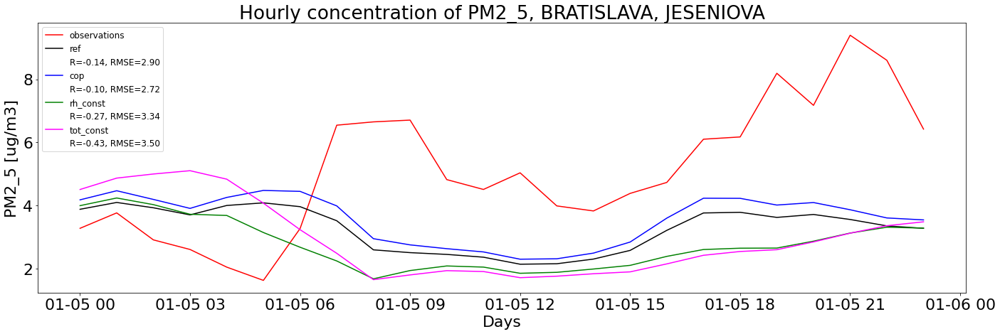

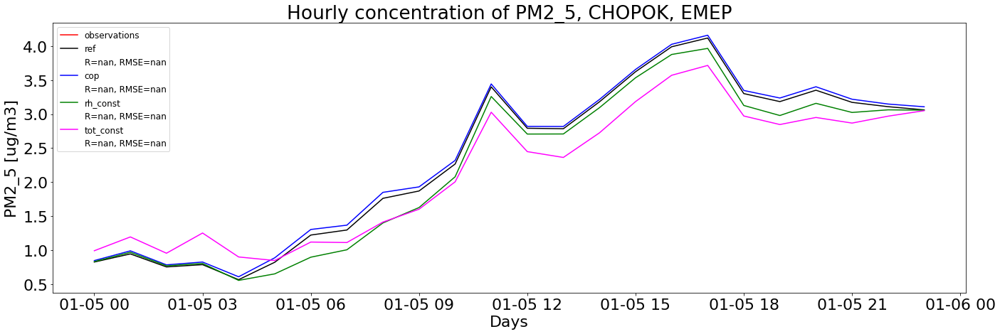

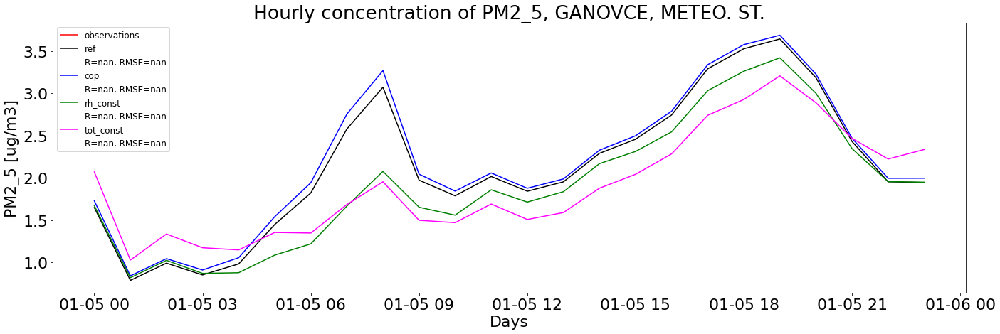

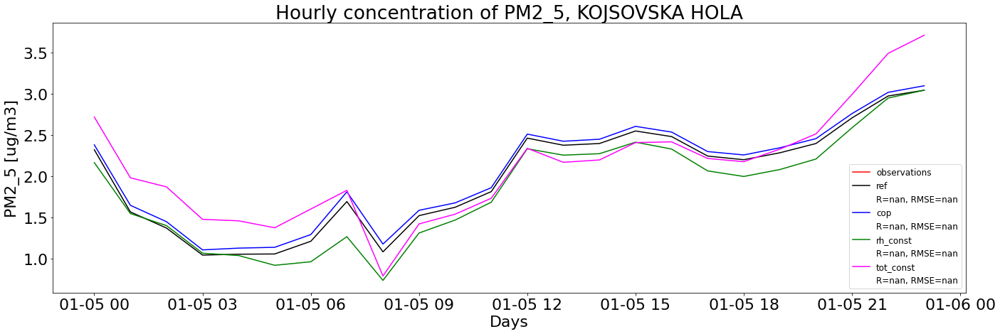

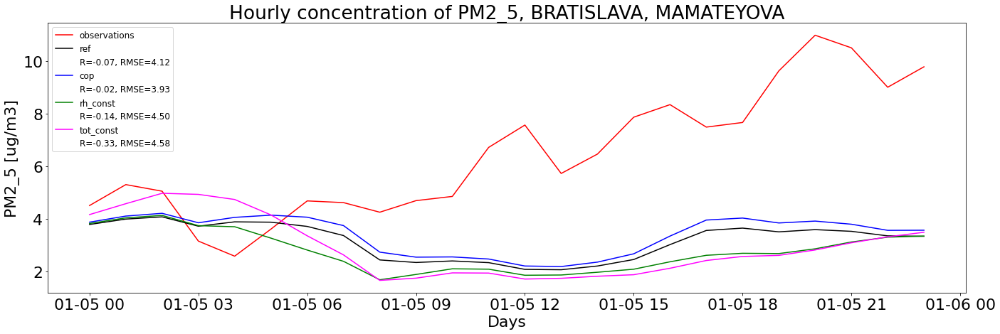

...

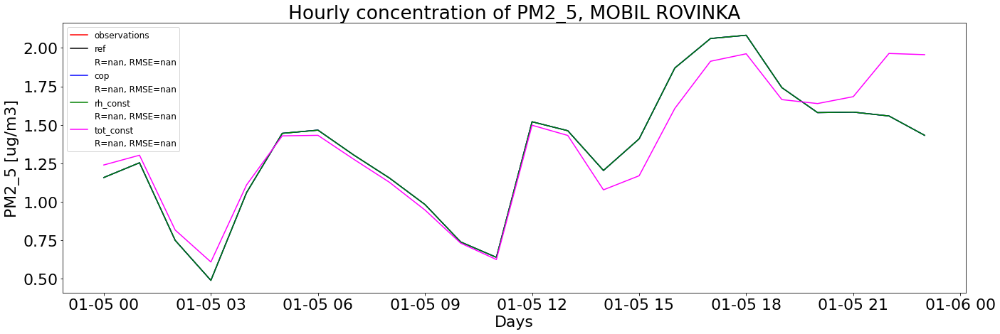

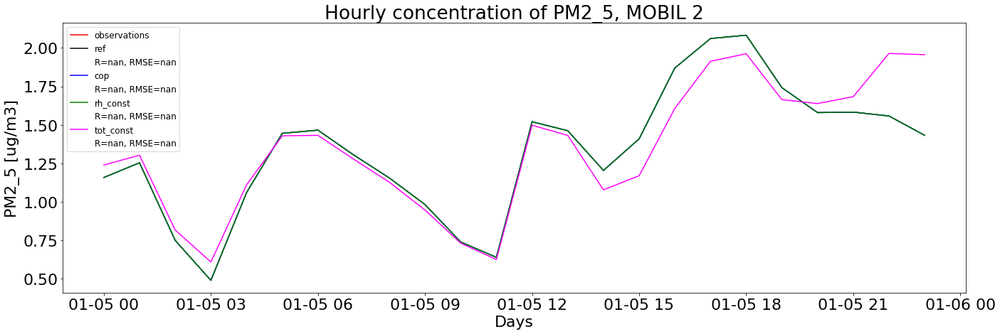

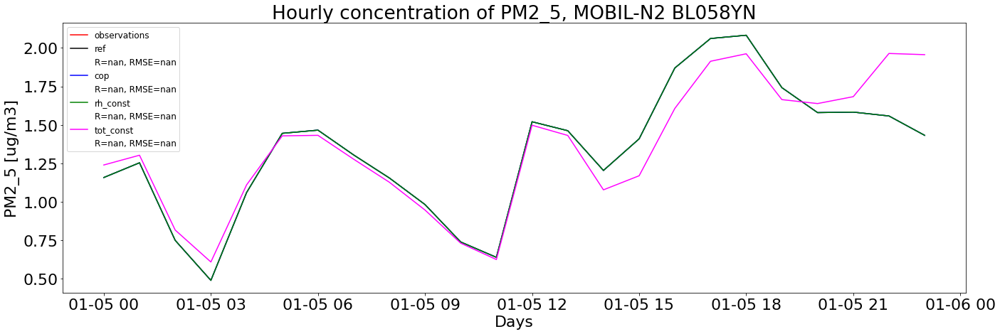

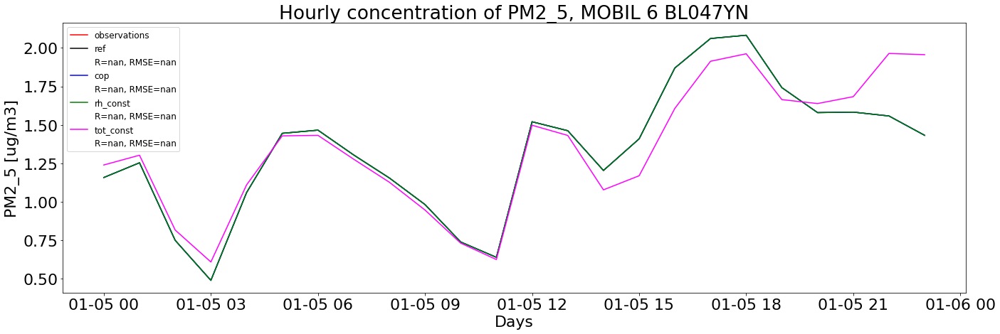

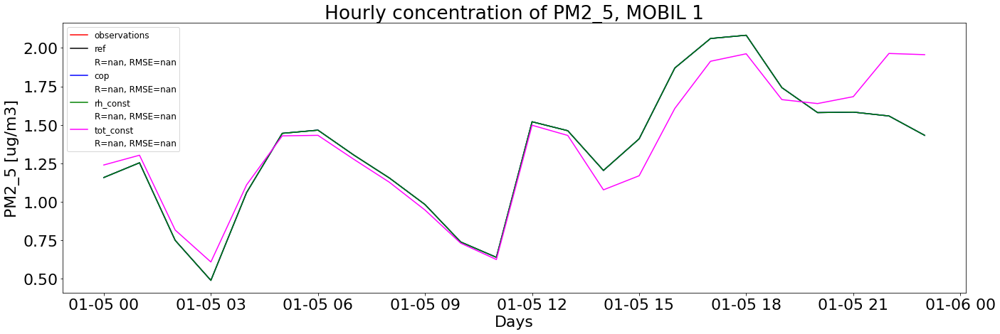

In [14]:
if save:
    print('Plots will be saved at:{}'.format(save_path))
for i in ID:    
    
    obs_id = data[specific[0]]['OBS'].sel(station = i).to_series()[plot_from:plot_until]
    name_sta = stat[specific[0]].name.loc[stat[specific[0]].index == i].item()
    
    plt.rcParams['figure.figsize'] = 20,7
    plt.rcParams.update({'font.size': 22})

    plt.plot(obs_id.index[:], obs_id[:], color =obs_color, label = 'observations')                
    for s in specific:
        mod_id = data[s]['MOD'].sel(station = i).to_series()[plot_from:plot_until]
        
        stat_corr = mod_id.corr(obs_id)
        stat_diff = np.array((mod_id - obs_id).dropna())
        if len(stat_diff) != 0:
            stat_rmse = np.sqrt(np.sum(stat_diff**2)/len(stat_diff))
        else:
            stat_rmse = np.nan
            
        plt.plot(obs_id.index[:], mod_id[:], color = color_list[s], label = '{}'.format(s))
        plt.plot([], [], ' ', label='R={:0.2f}, RMSE={:1.2f}'.format(stat_corr,stat_rmse))

    plt.legend(fontsize=12)                
    plt.title('Hourly concentration of {0}, {1}'.format(v,name_sta))                               
    plt.xlabel('Days')
    plt.ylabel('{0} [{1}]'.format(v,units))
    plt.tight_layout()

    if save:
        if not os.path.exists(save_path):
            os.makedirs(save_path)
        plt.savefig('{0}/{1}_{2}_{3}_{4}_H{5}-{6}.png'.format(save_path,nick, start_date[0:4], v, i,plot_from,plot_until), dpi=300)                
    plt.show()                
    plt.close()   

## Priemerny hodinovy chod 

In [90]:
### USER INPUT
# Choose stations to plot
ID = list(stat_all.loc[stat_all.coverage != 0].index.values)[1:]
#ID = [11813,11916]    # selected stations

my_season = 'year'

save = False   # save the plots?  

save_path = '{0}/validated/{1}_{2}/graphs/{3}'.format(vali_path, nick, start_date[0:4],v)

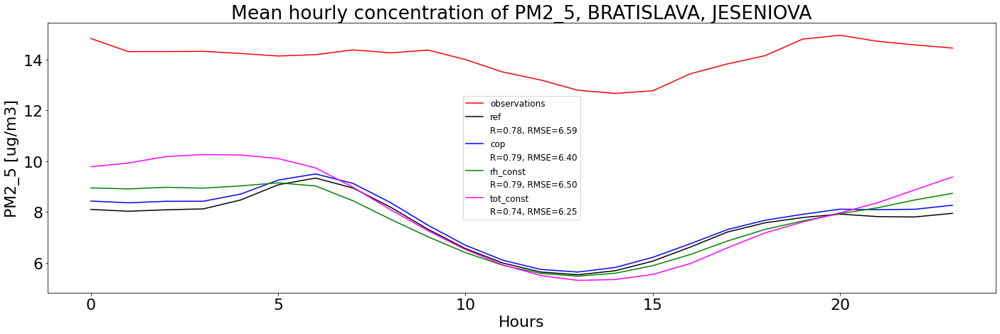

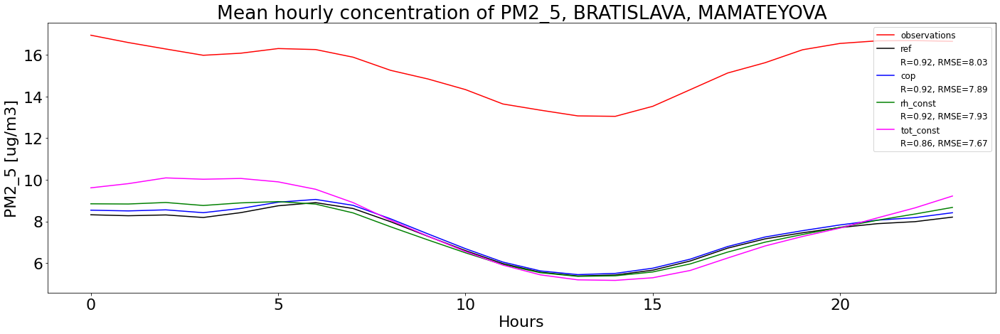

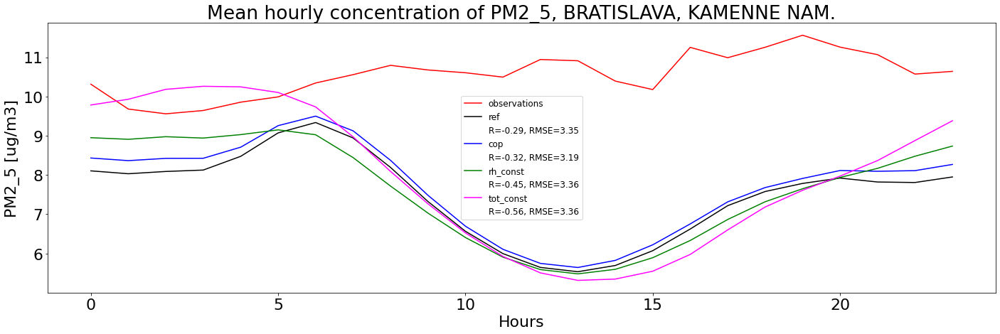

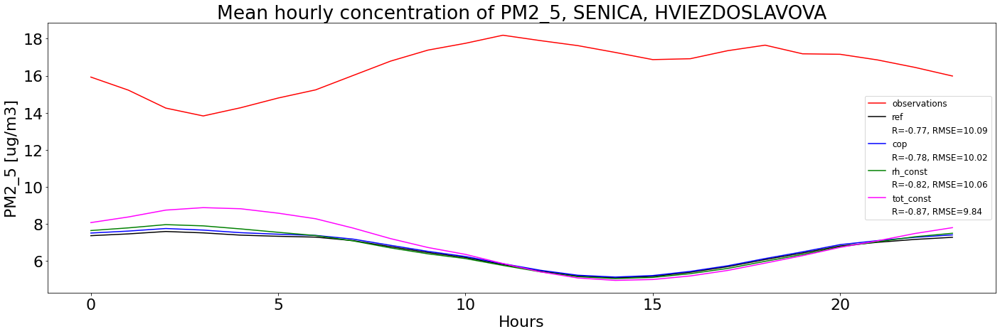

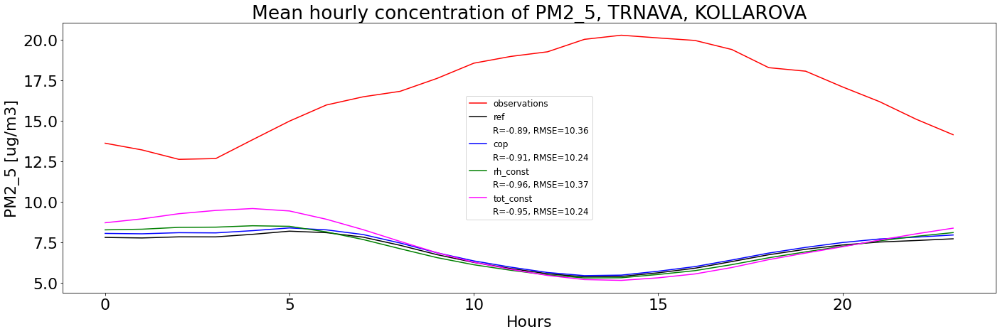

...

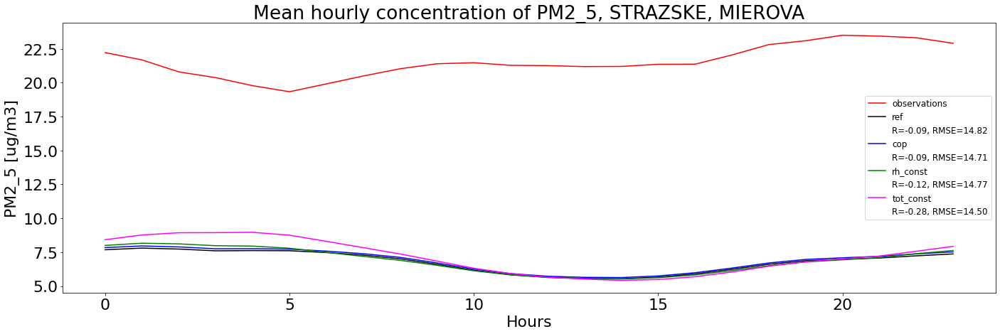

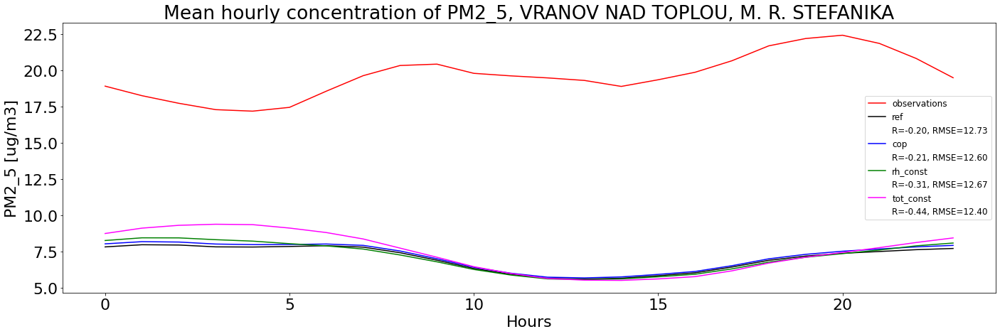

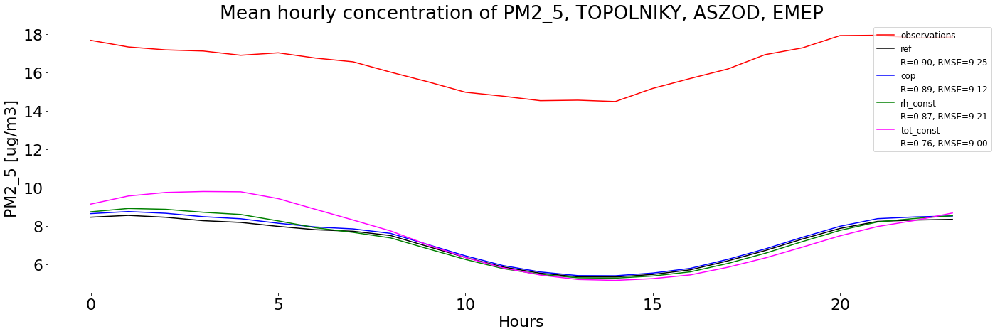

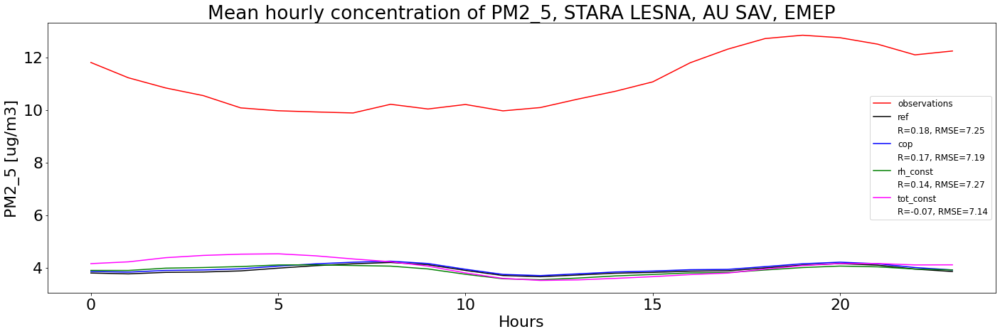

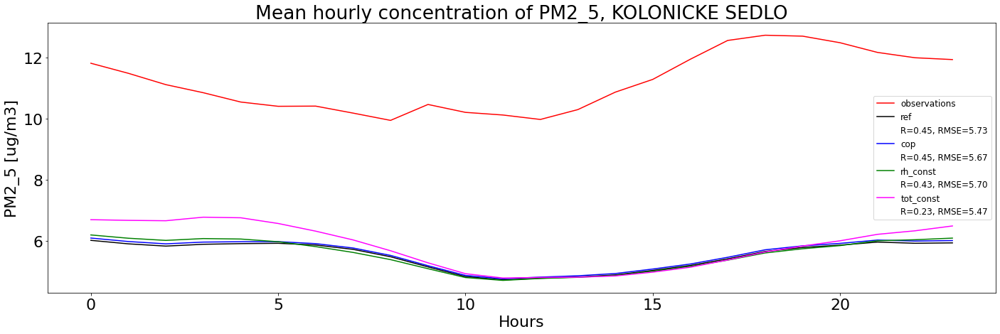

In [91]:
if save:
    print('Plots will be saved at:{}'.format(save_path))
for i in ID:    
    
    obs_id = data[specific[0]]['OBS'].sel(station = i, time = data[specific[0]].time.dt.month.isin(season_months[my_season])).groupby('time.hour').mean()
    name_sta = stat[specific[0]].name.loc[stat[specific[0]].index == i].item()
    
    plt.rcParams['figure.figsize'] = 20,7
    plt.rcParams.update({'font.size': 22})

    plt.plot(obs_id.hour, obs_id[:], color =obs_color, label = 'observations')                
    for s in specific:
        mod_id = data[s]['MOD'].sel(station = i, time = data[s].time.dt.month.isin(season_months[my_season])).groupby('time.hour').mean()
        
        stat_corr = mod_id.to_series().corr(obs_id.to_series())
        stat_diff = np.array((mod_id - obs_id).to_series().dropna())
        if len(stat_diff) != 0:
            stat_rmse = np.sqrt(np.sum(stat_diff**2)/len(stat_diff))
        else:
            stat_rmse = np.nan
            
        plt.plot(obs_id.hour, mod_id[:], color = color_list[s], label = '{}'.format(s))
        plt.plot([], [], ' ', label='R={:0.2f}, RMSE={:1.2f}'.format(stat_corr,stat_rmse))

    plt.legend(fontsize=12)                
    plt.title('Mean hourly concentration of {0}, {1}'.format(v,name_sta))                               
    plt.xlabel('Hours')
    plt.ylabel('{0} [{1}]'.format(v,units))
    plt.tight_layout()

    if save:
        if not os.path.exists(save_path):
            os.makedirs(save_path)
        plt.savefig('{0}/{1}_{2}_{3}_{4}_MH_{5}.png'.format(save_path,nick, start_date[0:4], v, i,my_season), dpi=300)                
    plt.show()                
    plt.close() 

## Priemerny hodinovy chod pre typy stanic

In [72]:
### USER INPUT
# Choose stations to plot
#moj_typ = 'T'
#moj_loc = 'U'
my_name = 'B'
#ID = list(stat_all.loc[stat_all['type'] == moj_typ].loc[stat_all['loc'] == moj_loc].loc[stat_all.coverage != 0].index.values)
ID = list(stat_all.loc[stat_all['type'] == my_name].loc[stat_all.coverage != 0].index.values)
#ID = [11813,11916]    # selected stations

my_season = 'winter'

save = True   # save the plots?  

save_path = '{0}/validated/{1}/graphs/{2}'.format(vali_path, folder_name,v)

Plots will be saved at:/data/teri/validacia/validated/CMAQ2017d02_ref_vs_cop_vs_const/graphs/PM2_5


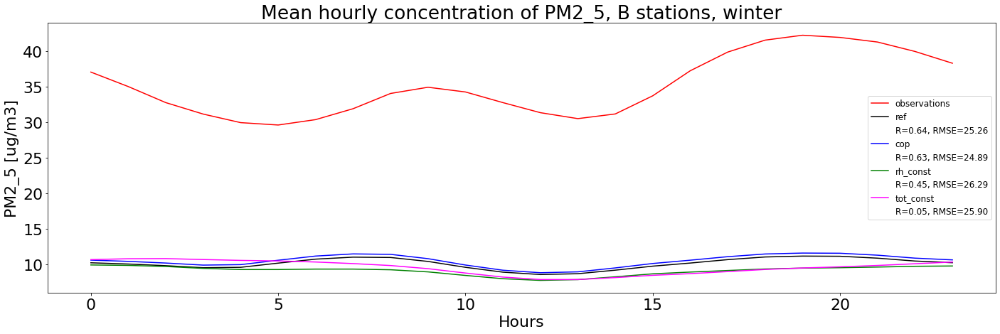

In [73]:
if save:
    print('Plots will be saved at:{}'.format(save_path))
#for i in ID:    
    
obs_id = data[specific[0]]['OBS'].sel(station = ID, time = data[specific[0]].time.dt.month.isin(season_months[my_season])).groupby('time.hour').mean().mean(dim = 'station')
#name_sta = stat[specific[0]].name.loc[stat[specific[0]].index == i].item()

plt.rcParams['figure.figsize'] = 20,7
plt.rcParams.update({'font.size': 22})

plt.plot(obs_id.hour, obs_id[:], color =obs_color, label = 'observations')                
for s in specific:
    mod_id = data[s]['MOD'].sel(station = ID, time = data[s].time.dt.month.isin(season_months[my_season])).groupby('time.hour').mean().mean(dim = 'station')

    stat_corr = mod_id.to_series().corr(obs_id.to_series())
    stat_diff = np.array((mod_id - obs_id).to_series().dropna())
    if len(stat_diff) != 0:
        stat_rmse = np.sqrt(np.sum(stat_diff**2)/len(stat_diff))
    else:
        stat_rmse = np.nan

    plt.plot(obs_id.hour, mod_id[:], color = color_list[s], label = '{}'.format(s))
    plt.plot([], [], ' ', label='R={:0.2f}, RMSE={:1.2f}'.format(stat_corr,stat_rmse))

plt.legend(fontsize=12)                
plt.title('Mean hourly concentration of {0}, {1} stations, {2}'.format(v, my_name, my_season))                               
plt.xlabel('Hours')
plt.ylabel('{0} [{1}]'.format(v,units))
plt.tight_layout()

if save:
    if not os.path.exists(save_path):
        os.makedirs(save_path)
    plt.savefig('{0}/MH_{1}_{2}_{3}_{4}.png'.format(save_path,my_name, nick, v, my_season), dpi=300)                
plt.show()                
plt.close() 

## Normovany priemerny hodinovy chod pre typy stanic

In [74]:
### USER INPUT
# Choose stations to plot
#moj_typ = 'T'
#moj_loc = 'U'
my_name = 'B'
#ID = list(stat_all.loc[stat_all['type'] == moj_typ].loc[stat_all['loc'] == moj_loc].loc[stat_all.coverage != 0].index.values)
ID = list(stat_all.loc[stat_all['type'] == my_name].loc[stat_all.coverage != 0].index.values)
#ID = [11813,11916]    # selected stations

my_season = 'winter'

save = True   # save the plots?  

save_path = '{0}/validated/{1}/graphs/{2}'.format(vali_path, folder_name,v)

Plots will be saved at:/data/teri/validacia/validated/CMAQ2017d02_ref_vs_cop_vs_const/graphs/PM2_5


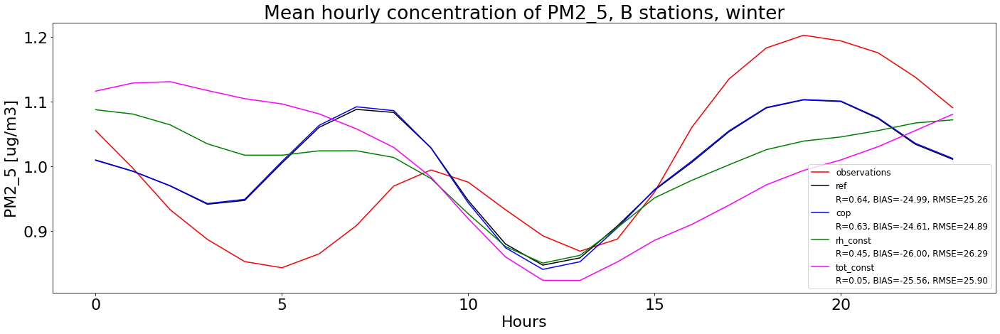

In [75]:
if save:
    print('Plots will be saved at:{}'.format(save_path))
#for i in ID:    
    
obs_id = data[specific[0]]['OBS'].sel(station = ID, time = data[specific[0]].time.dt.month.isin(season_months[my_season])).groupby('time.hour').mean().mean(dim = 'station')
#name_sta = stat[specific[0]].name.loc[stat[specific[0]].index == i].item()

plt.rcParams['figure.figsize'] = 20,7
plt.rcParams.update({'font.size': 22})

obs_id_norm = 24*obs_id/obs_id.sum()
plt.plot(obs_id.hour, obs_id_norm[:], color =obs_color, label = 'observations')                
for s in specific:
    mod_id = data[s]['MOD'].sel(station = ID, time = data[s].time.dt.month.isin(season_months[my_season])).groupby('time.hour').mean().mean(dim = 'station')
    mod_id_norm = 24*mod_id/mod_id.sum()
    
    stat_corr = mod_id.to_series().corr(obs_id.to_series())
    stat_diff = np.array((mod_id - obs_id).to_series().dropna())
    if len(stat_diff) != 0:
        stat_bias = np.sum(stat_diff)/len(stat_diff)
        stat_rmse = np.sqrt(np.sum(stat_diff**2)/len(stat_diff))
    else:
        stat_rmse = np.nan
        stat_bias = np.nan
    
    plt.plot(obs_id.hour, mod_id_norm[:], color = color_list[s], label = '{}'.format(s))
    #plt.plot([], [], ' ', label='R={:0.2f}, RMSE={:1.2f}'.format(stat_corr,stat_rmse))
    plt.plot([], [], ' ', label='R={:0.2f}, BIAS={:1.2f}, RMSE={:1.2f}'.format(stat_corr,stat_bias, stat_rmse))

plt.legend(fontsize=12)                
plt.title('Mean hourly concentration of {0}, {1} stations, {2}'.format(v, my_name, my_season))                               
plt.xlabel('Hours')
plt.ylabel('{0} [{1}]'.format(v,units))
plt.tight_layout()

if save:
    if not os.path.exists(save_path):
        os.makedirs(save_path)
    plt.savefig('{0}/MH_norm_{1}_{2}_{3}_{4}.png'.format(save_path,my_name, nick, v, my_season), dpi=300)                
plt.show()                
plt.close() 

## Priemerny rocny chod pre stanice

Chod priemernych dennych hodnot

In [21]:
### USER INPUT
# Choose stations to plot
ID = list(stat_all.index.values)[1:]   # all stations
#ID = [11813,11916]    # selected stations
save = False   # save the plots?

plot_from = '2017-01-01'
plot_until = '2017-01-31' 

save_path = '{0}/validated/{1}_{2}/graphs/{3}'.format(vali_path, nick, start_date[0:4],v)

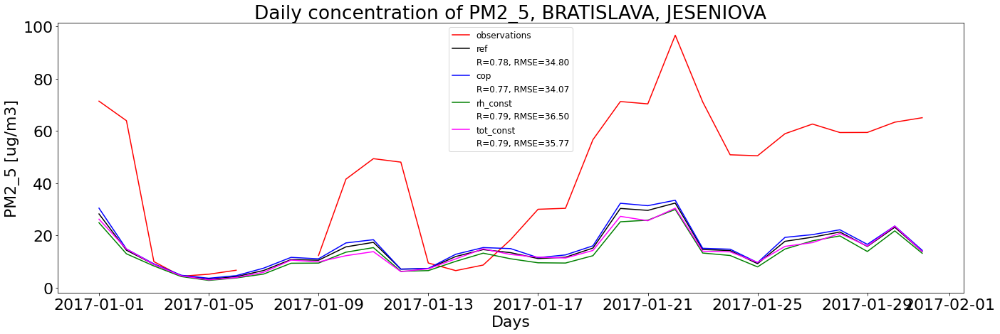

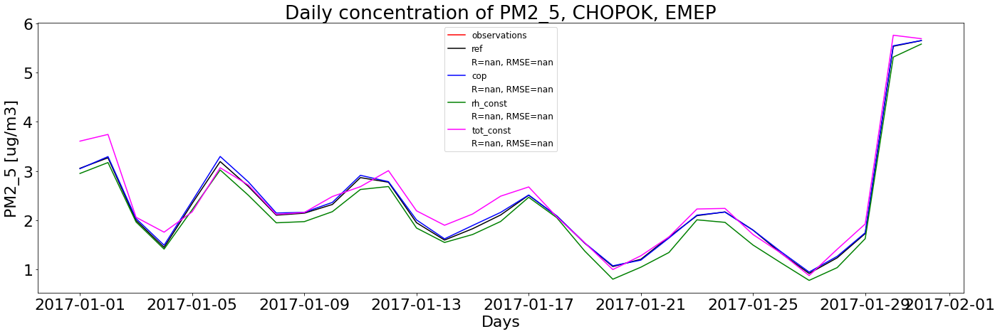

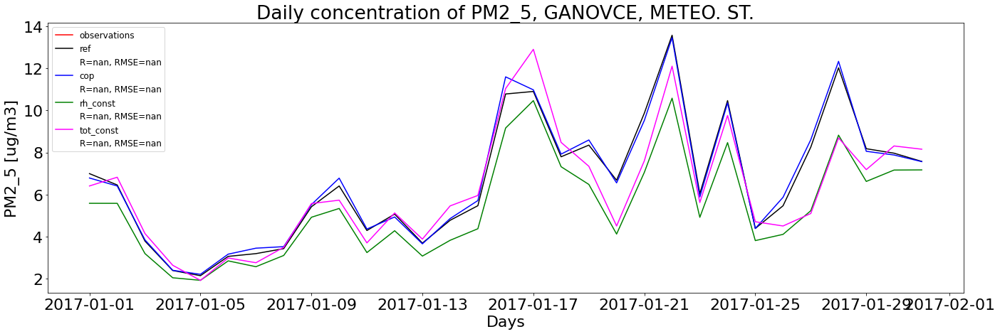

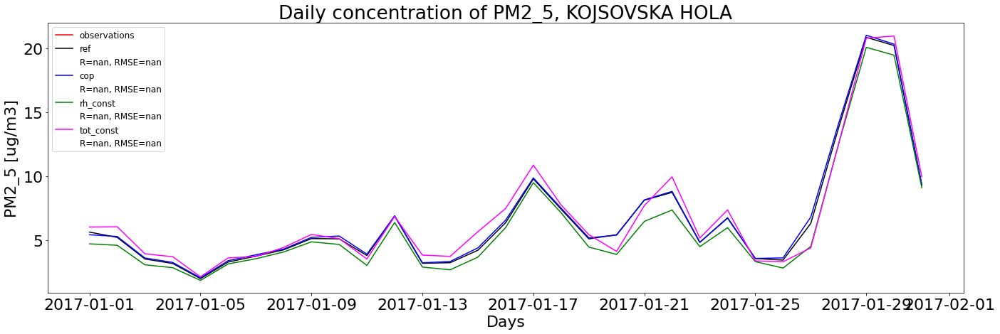

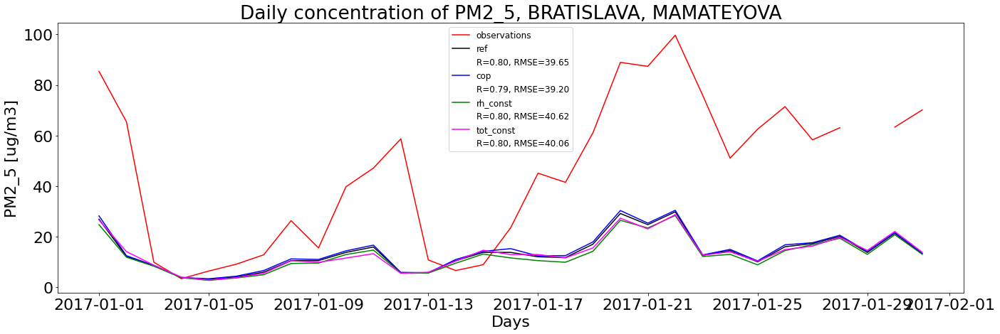

...

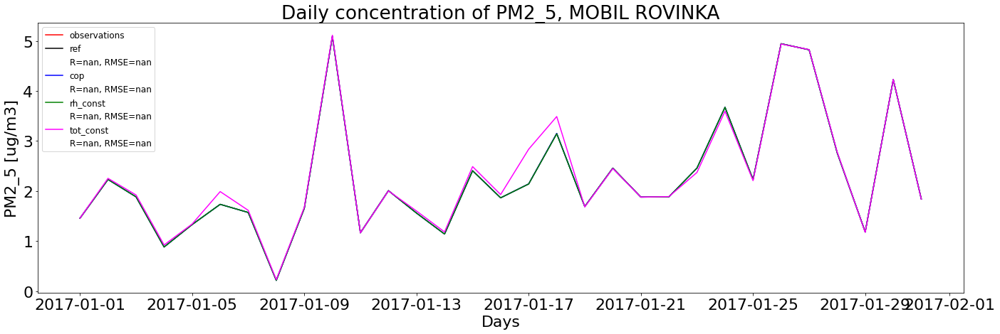

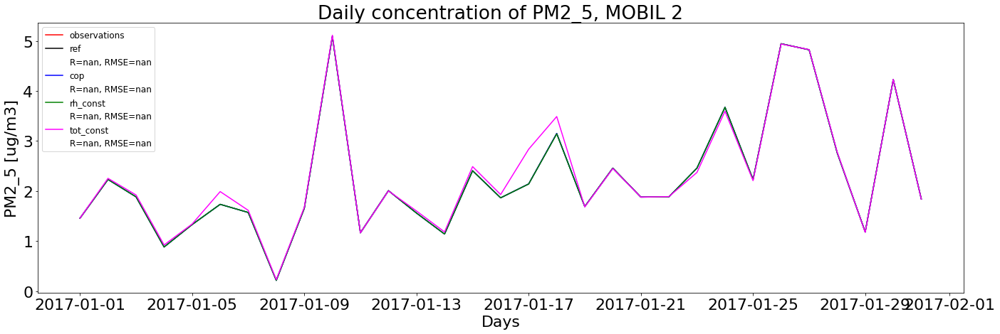

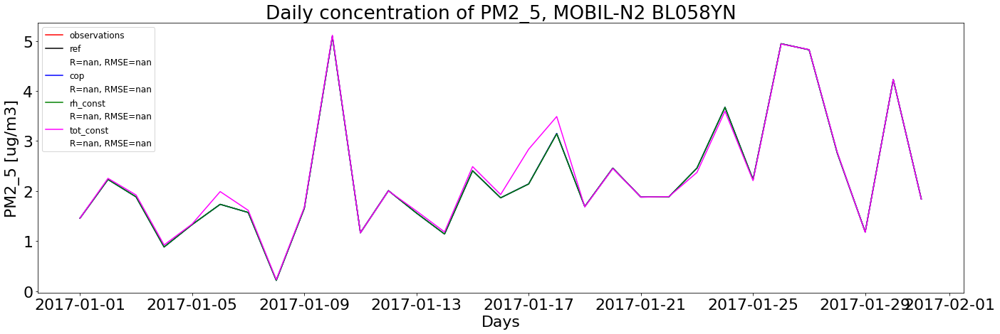

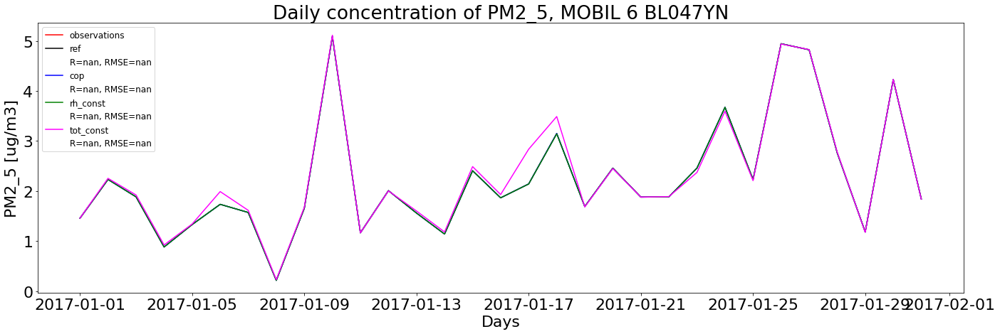

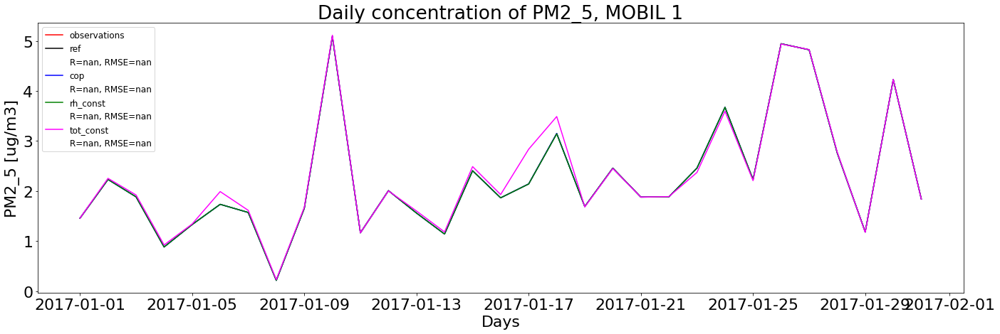

In [22]:
if save:
    print('Plots will be saved at:{}'.format(save_path))
for i in ID:
    obs_id = data[specific[0]]['OBS'].sel(station = i).to_series()[plot_from:plot_until]
    name_sta = stat[specific[0]].name.loc[stat[specific[0]].index == i].item()
    daily_obs = obs_id.groupby(pd.Grouper(freq='D')).mean()
    
    plt.rcParams['figure.figsize'] = 20,7
    plt.rcParams.update({'font.size': 22})
    plt.plot(daily_obs.index[:], daily_obs[:], color = obs_color, label = 'observations')                
    
    for s in specific:        
        mod_id = data[s]['MOD'].sel(station = i).to_series()[plot_from:plot_until]        
        daily_mod = mod_id.groupby(pd.Grouper(freq='D')).mean()

        stat_corr_daily = daily_mod.corr(daily_obs)
        stat_diff_daily = np.array((daily_mod - daily_obs).dropna())
        if len(stat_diff_daily) != 0:
            stat_rmse_daily = np.sqrt(np.sum(stat_diff_daily**2)/len(stat_diff_daily))
        else:
            stat_rmse_daily = np.nan

        plt.plot(daily_obs.index[:], daily_mod[:], color = color_list[s], label = '{}'.format(s))
        plt.plot([], [], ' ', label='R={:0.2f}, RMSE={:1.2f}'.format(stat_corr_daily,stat_rmse_daily))

    plt.legend(fontsize=12)                
    plt.title('Daily concentration of {0}, {1}'.format(v,name_sta))                               
    plt.xlabel('Days')
    plt.ylabel('{0} [{1}]'.format(v,units))
    plt.tight_layout()

    if save:
        if not os.path.exists(save_path):
            os.makedirs(save_path)
        plt.savefig('{0}/{1}_{2}_{3}_{4}_D{5}-{6}.png'.format(save_path,nick, start_date[0:4], v, i,plot_from,plot_until), dpi=300)                
    plt.show()                
    plt.close()   

## Priemerny rocny chod typy stanic

In [23]:
v

'PM2_5'

In [77]:
### USER INPUT
# Choose stations to plot
#moj_typ = 'T'
#moj_loc = 'U'
my_name = 'B'
#ID = list(stat_all.loc[stat_all['type'] == moj_typ].loc[stat_all['loc'] == moj_loc].loc[stat_all.coverage != 0].index.values)
ID = list(stat_all.loc[stat_all['type'] == my_name].loc[stat_all.coverage != 0].index.values)
#ID = [11813,11916]    # selected stations

my_season = 'year'

save = True   # save the plots?  

save_path = '{0}/validated/{1}/graphs/{2}'.format(vali_path, folder_name,v)

Plots will be saved at:/data/teri/validacia/validated/CMAQ2017d02_ref_vs_cop_vs_const/graphs/PM2_5


/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)


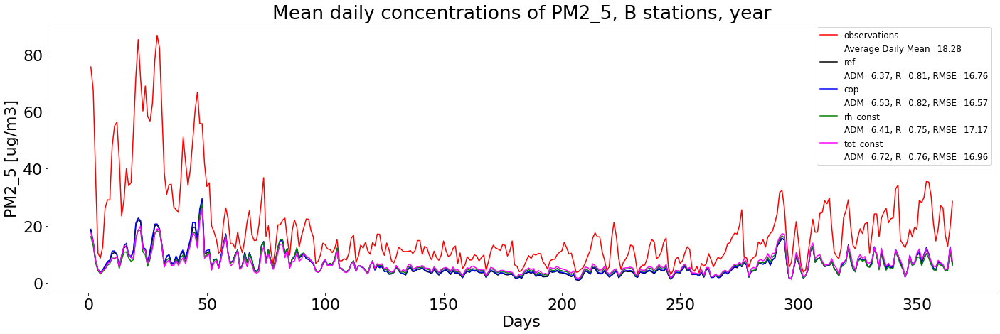

In [78]:
if save:
    print('Plots will be saved at:{}'.format(save_path))
#for i in ID:    
days_np = np.repeat(np.linspace(1,365,365),24)
new_data = data[specific[0]].assign_coords(time = days_np)    
obs_id = new_data['OBS'].sel(station = ID).groupby(new_data['OBS'].time).mean().mean(dim = 'station')
obs_mean = obs_id.mean()

plt.rcParams['figure.figsize'] = 20,7
plt.rcParams.update({'font.size': 22})

plt.plot(obs_id.time, obs_id[:], color =obs_color, label = 'observations') 
plt.plot([], [], ' ', label='Average Daily Mean={:0.2f}'.format(obs_mean.item()))

for s in specific:
    new_data = data[s].assign_coords(time = days_np)
    mod_id = new_data['MOD'].sel(station = ID).groupby(new_data['MOD'].time).mean().mean(dim = 'station')
    mod_mean = mod_id.mean()

    stat_corr = mod_id.to_series().corr(obs_id.to_series())
    stat_diff = np.array((mod_id - obs_id).to_series().dropna())
    if len(stat_diff) != 0:
        stat_rmse = np.sqrt(np.sum(stat_diff**2)/len(stat_diff))
    else:
        stat_rmse = np.nan

    plt.plot(obs_id.time, mod_id[:], color = color_list[s], label = '{}'.format(s))
    plt.plot([], [], ' ', label='ADM={:0.2f}, R={:1.2f}, RMSE={:1.2f}'.format(mod_mean.item(),stat_corr,stat_rmse))

plt.legend(fontsize=12)                
plt.title('Mean daily concentrations of {0}, {1} stations, {2}'.format(v, my_name, my_season))                               
plt.xlabel('Days')
plt.ylabel('{0} [{1}]'.format(v,units))
plt.tight_layout()

if save:
    if not os.path.exists(save_path):
        os.makedirs(save_path)
    plt.savefig('{0}/MA_{1}_{2}_{3}_{4}.png'.format(save_path,my_name, nick, v, my_season), dpi=300)                
plt.show()                
plt.close() 

In [25]:
mod_mean.item()

6.6042866706848145

In [26]:
# Average annual mean
my_seasons = ['spring','summer','autumn','winter','year']
print(v)
for s in my_seasons:    
    means = data['ref'].sel(station = ID, time = data['ref'].time.dt.month.isin(season_months[s])).mean()
    print('{0} average \n obs: {1} \n ref: {2}'.format(s, means['OBS'].values,means['MOD'].values))
    means = data['cop'].sel(station = ID, time = data['cop'].time.dt.month.isin(season_months[s])).mean()
    print(' cop: {0}'.format(means['MOD'].values))
    means = data['rh_const'].sel(station = ID, time = data['rh_const'].time.dt.month.isin(season_months[s])).mean()
    print(' rh_const: {0}'.format(means['MOD'].values))

PM2_5
spring average 
 obs: 13.845700865790258 
 ref: 6.448963165283203
 cop: 6.495749473571777
 rh_const: 6.724374771118164
summer average 
 obs: 9.535906211381564 
 ref: 3.1630046367645264
 cop: 3.3480241298675537
 rh_const: 3.844477653503418
autumn average 
 obs: 14.314317187016826 
 ref: 5.772741317749023
 cop: 5.81392765045166
 rh_const: 5.9792633056640625
winter average 
 obs: 30.62248992418051 
 ref: 8.808286666870117
 cop: 9.035212516784668
 rh_const: 7.965869426727295
year average 
 obs: 18.26844668899636 
 ref: 6.367026329040527
 cop: 6.529224872589111
 rh_const: 6.41139030456543


## Rocne obdobia

In [27]:
### USER INPUT
# Choose stations to plot
#stat_all.loc[stat_all.coverage != 0]
ID = list(stat_all.loc[stat_all.coverage != 0].index.values)[1:]   # all stations
#ID = [11813,11916]    # selected stations

save = True   # save the plots?  

save_path = '{0}/validated/{1}/graphs/{2}'.format(vali_path, folder_name,v)
save_path

'/data/teri/validacia/validated/CMAQ2017d02_ref_vs_cop_vs_const/graphs/PM2_5'

### Observations

In [28]:
if save:
    print('Plots will be saved at:{}'.format(save_path))
for i in ID:    
    
    obs_id_jar = data[specific[0]]['OBS'].sel(station = i, time = data[specific[0]].time.dt.month.isin(season_months['jar'])).groupby('time.hour').mean()
    obs_id_leto = data[specific[0]]['OBS'].sel(station = i, time = data[specific[0]].time.dt.month.isin(season_months['leto'])).groupby('time.hour').mean()
    obs_id_jesen = data[specific[0]]['OBS'].sel(station = i, time = data[specific[0]].time.dt.month.isin(season_months['jesen'])).groupby('time.hour').mean()
    obs_id_zima = data[specific[0]]['OBS'].sel(station = i, time = data[specific[0]].time.dt.month.isin(season_months['zima'])).groupby('time.hour').mean()
    
    name_sta = stat[specific[0]].name.loc[stat[specific[0]].index == i].item()
    
    plt.rcParams['figure.figsize'] = 20,7
    plt.rcParams.update({'font.size': 22})

    plt.plot(obs_id_jar.hour, obs_id_jar[:], color ='green', label = 'jar') 
    plt.plot(obs_id_leto.hour, obs_id_leto[:], color ='red', label = 'leto')
    plt.plot(obs_id_jesen.hour, obs_id_jesen[:], color ='orange', label = 'jesen') 
    plt.plot(obs_id_zima.hour, obs_id_zima[:], color ='blue', label = 'zima')

    plt.legend(fontsize=12)                
    plt.title('Mean hourly concentration of {0}, {1}'.format(v,name_sta))                               
    plt.xlabel('Hours')
    plt.ylabel('{0} [{1}]'.format(v,units))
    plt.tight_layout()

    if save:
        if not os.path.exists(save_path):
            os.makedirs(save_path)
        plt.savefig('{0}/{1}_{2}_{3}_{4}_MH{5}-{6}.png'.format(save_path,nick, start_date[0:4], v, i,plot_from,plot_until), dpi=300)                
    plt.show()                
    plt.close() 

Plots will be saved at:/data/teri/validacia/validated/CMAQ2017d02_ref_vs_cop_vs_const/graphs/PM2_5


KeyError: 'jar'

### Model

In [ ]:
spec_nick = 'ref'

if save:
    print('Plots will be saved at:{}'.format(save_path))
for i in ID:    
    
    
    mod_id_jar = data[spec_nick]['MOD'].sel(station = i, time = data[spec_nick].time.dt.month.isin(season_months['jar'])).groupby('time.hour').mean()
    mod_id_leto = data[spec_nick]['MOD'].sel(station = i, time = data[spec_nick].time.dt.month.isin(season_months['leto'])).groupby('time.hour').mean()
    mod_id_jesen = data[spec_nick]['MOD'].sel(station = i, time = data[spec_nick].time.dt.month.isin(season_months['jesen'])).groupby('time.hour').mean()
    mod_id_zima = data[spec_nick]['MOD'].sel(station = i, time = data[spec_nick].time.dt.month.isin(season_months['zima'])).groupby('time.hour').mean()
    
    obs_id_jar = data[specific[0]]['OBS'].sel(station = i, time = data[specific[0]].time.dt.month.isin(season_months['jar'])).groupby('time.hour').mean()
    obs_id_leto = data[specific[0]]['OBS'].sel(station = i, time = data[specific[0]].time.dt.month.isin(season_months['leto'])).groupby('time.hour').mean()
    obs_id_jesen = data[specific[0]]['OBS'].sel(station = i, time = data[specific[0]].time.dt.month.isin(season_months['jesen'])).groupby('time.hour').mean()
    obs_id_zima = data[specific[0]]['OBS'].sel(station = i, time = data[specific[0]].time.dt.month.isin(season_months['zima'])).groupby('time.hour').mean()
    
    r_jar = mod_id_jar.to_series().corr(obs_id_jar.to_series())
    r_leto = mod_id_leto.to_series().corr(obs_id_leto.to_series())
    r_jesen = mod_id_jesen.to_series().corr(obs_id_jesen.to_series())
    r_zima = mod_id_zima.to_series().corr(obs_id_zima.to_series())
    
    name_sta = stat[spec_nick].name.loc[stat[spec_nick].index == i].item()
    
    plt.rcParams['figure.figsize'] = 20,7
    plt.rcParams.update({'font.size': 22})
    
    plt.plot(mod_id_jar.hour, mod_id_jar[:], color ='green', linestyle = '--', label = 'jar mod, R={:0.2f}'.format(r_jar)) 
    plt.plot(mod_id_leto.hour, mod_id_leto[:], color ='red', linestyle = '--', label = 'leto mod, R={:0.2f}'.format(r_leto))
    plt.plot(mod_id_jesen.hour, mod_id_jesen[:], color ='darkorange', linestyle = '--', label = 'jesen mod, R={:0.2f}'.format(r_jesen)) 
    plt.plot(mod_id_zima.hour, mod_id_zima[:], color ='blue', linestyle = '--', label = 'zima mod, R={:0.2f}'.format(r_zima))
    
    plt.plot(obs_id_jar.hour, obs_id_jar[:], color ='limegreen', label = 'jar obs') 
    plt.plot(obs_id_leto.hour, obs_id_leto[:], color ='salmon', label = 'leto obs')
    plt.plot(obs_id_jesen.hour, obs_id_jesen[:], color ='gold', label = 'jesen obs') 
    plt.plot(obs_id_zima.hour, obs_id_zima[:], color ='dodgerblue', label = 'zima obs')
    
    plt.legend(fontsize=12)                
    plt.title('Mean hourly concentration of {0}, {1}, {2}'.format(v,name_sta, spec_nick))                               
    plt.xlabel('Hours')
    plt.ylabel('{0} [{1}]'.format(v,units))
    plt.tight_layout()

    if save:
        if not os.path.exists(save_path):
            os.makedirs(save_path)
        plt.savefig('{0}/{1}_{2}_{3}_{4}_MH{5}-{6}.png'.format(save_path,nick, start_date[0:4], v, i,plot_from,plot_until), dpi=300)                
    plt.show()                
    plt.close() 

### Model - station types

Plots will be saved at:/data/teri/validacia/validated/CMAQ2017d02_ref_vs_cop_vs_const/graphs/PM2_5


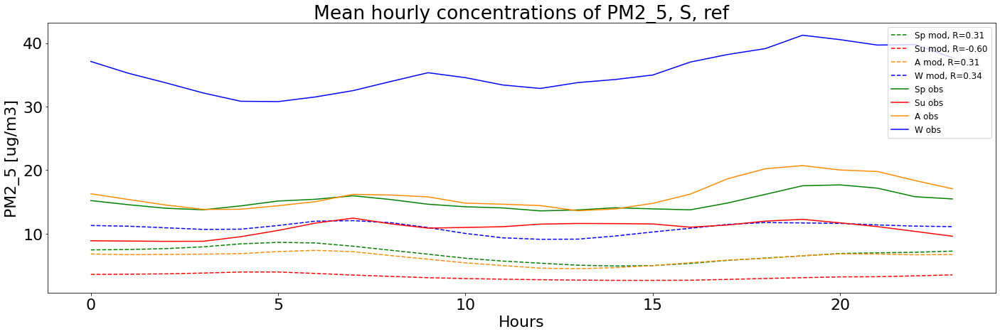

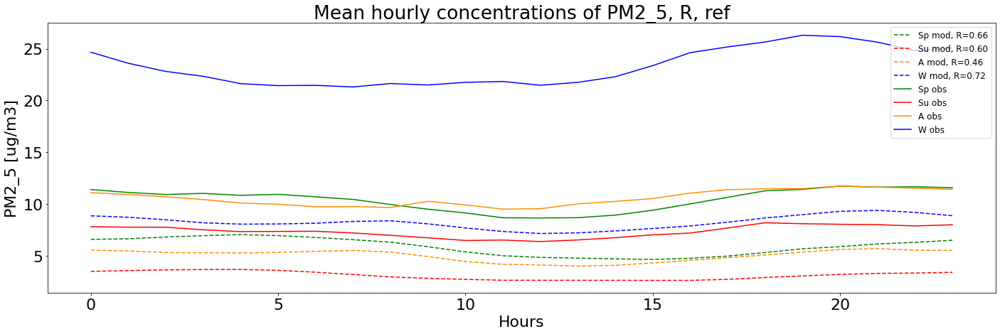

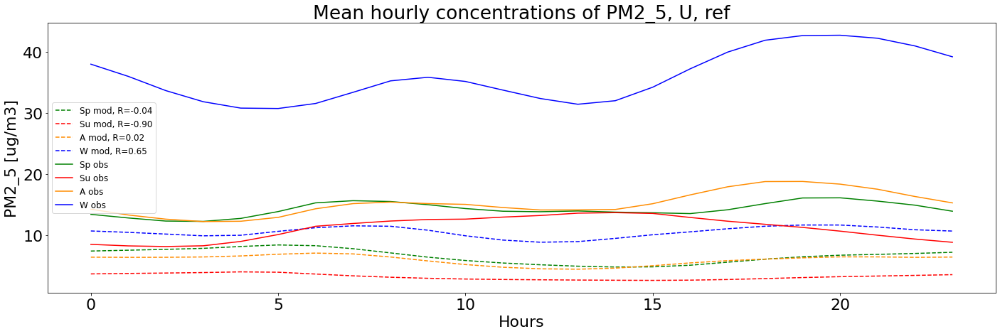

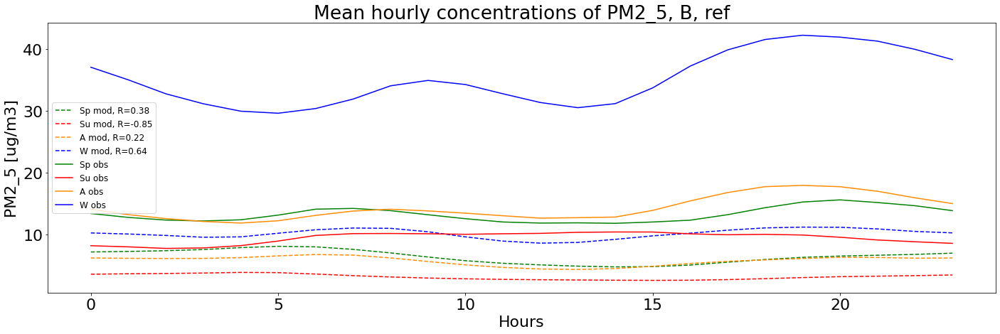

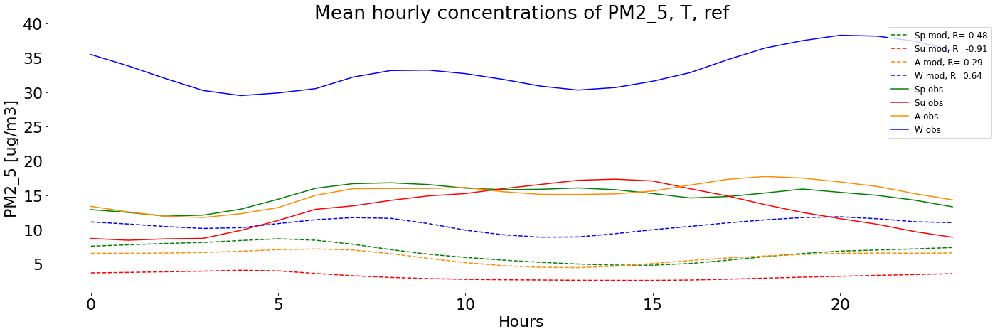

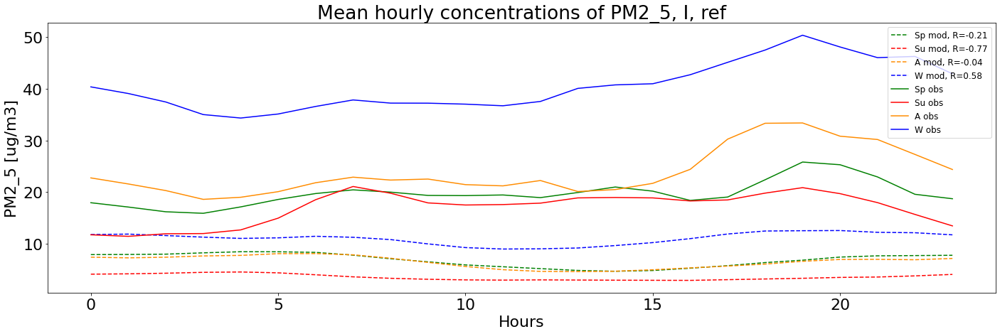

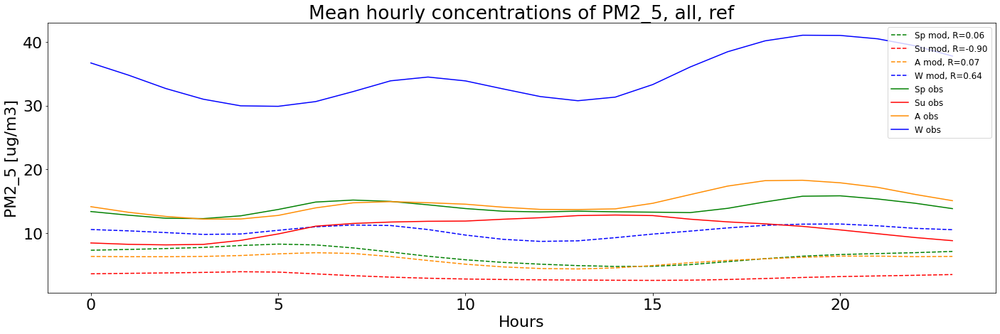

In [76]:
save = True
spec_nick = 'ref'
stat_types_new = ['RB', 'OB', 'UT']

if save:
    print('Plots will be saved at:{}'.format(save_path))
#for t in stat_types_new:
for t in all_types_all:
    #"""
    if t in locs:
        stanice_vyber = list(stat_all.loc[stat_all['loc'] == t].loc[stat_all['coverage'] != 0].index)
    elif t in types:
        stanice_vyber = list(stat_all.loc[stat_all['type'] == t].loc[stat_all['coverage'] != 0].index)
    else:
        stanice_vyber = list(stat_all.loc[stat_all['coverage'] != 0].index.values)[1:]  
    """
        
    if t == 'RB':
            #loc_, type_ = 'R', 'B'
            stanice_vyber = list(stat_all.loc[stat_all['type'] == 'B'].loc[stat_all['loc']=='R'].loc[stat_all['coverage'] != 0].index)
        
    if t == 'OB':
            stanice_vyber = list(stat_all.loc[stat_all['type'] == 'B'].loc[stat_all['loc']=='U'].loc[stat_all['coverage'] != 0].index) + list(stat_all.loc[stat_all['type'] == 'B'].loc[stat_all['loc']=='S'].loc[stat_all['coverage'] != 0].index)
             
    if t == 'UT':
            stanice_vyber = list(stat_all.loc[stat_all['type'] == 'T'].loc[stat_all['loc']=='U'].loc[stat_all['coverage'] != 0].index)
    #"""

    mod_id_jar = data[spec_nick]['MOD'].sel(station = stanice_vyber, time = data[spec_nick].time.dt.month.isin(season_months['spring'])).groupby('time.hour').mean().mean(dim = 'station')
    mod_id_leto = data[spec_nick]['MOD'].sel(station = stanice_vyber, time = data[spec_nick].time.dt.month.isin(season_months['summer'])).groupby('time.hour').mean().mean(dim = 'station')
    mod_id_jesen = data[spec_nick]['MOD'].sel(station = stanice_vyber, time = data[spec_nick].time.dt.month.isin(season_months['autumn'])).groupby('time.hour').mean().mean(dim = 'station')
    mod_id_zima = data[spec_nick]['MOD'].sel(station = stanice_vyber, time = data[spec_nick].time.dt.month.isin(season_months['winter'])).groupby('time.hour').mean().mean(dim = 'station')
    
    obs_id_jar = data[specific[0]]['OBS'].sel(station = stanice_vyber, time = data[specific[0]].time.dt.month.isin(season_months['spring'])).groupby('time.hour').mean().mean(dim = 'station')
    obs_id_leto = data[specific[0]]['OBS'].sel(station = stanice_vyber, time = data[specific[0]].time.dt.month.isin(season_months['summer'])).groupby('time.hour').mean().mean(dim = 'station')
    obs_id_jesen = data[specific[0]]['OBS'].sel(station = stanice_vyber, time = data[specific[0]].time.dt.month.isin(season_months['autumn'])).groupby('time.hour').mean().mean(dim = 'station')
    obs_id_zima = data[specific[0]]['OBS'].sel(station = stanice_vyber, time = data[specific[0]].time.dt.month.isin(season_months['winter'])).groupby('time.hour').mean().mean(dim = 'station')
    
    r_jar = mod_id_jar.to_series().corr(obs_id_jar.to_series())
    r_leto = mod_id_leto.to_series().corr(obs_id_leto.to_series())
    r_jesen = mod_id_jesen.to_series().corr(obs_id_jesen.to_series())
    r_zima = mod_id_zima.to_series().corr(obs_id_zima.to_series())
    
    #name_sta = stat[spec_nick].name.loc[stat[spec_nick].index == i].item()
    
    plt.rcParams['figure.figsize'] = 20,7
    plt.rcParams.update({'font.size': 22})

    plt.plot(mod_id_jar.hour, mod_id_jar[:], color ='green', linestyle='--', label = 'Sp mod, R={:0.2f}'.format(r_jar)) 
    plt.plot(mod_id_leto.hour, mod_id_leto[:], color ='red', linestyle='--', label = 'Su mod, R={:0.2f}'.format(r_leto))
    plt.plot(mod_id_jesen.hour, mod_id_jesen[:], color ='darkorange', linestyle='--', label = 'A mod, R={:0.2f}'.format(r_jesen)) 
    plt.plot(mod_id_zima.hour, mod_id_zima[:], color ='blue', linestyle='--', label = 'W mod, R={:0.2f}'.format(r_zima))
    
    plt.plot(obs_id_jar.hour, obs_id_jar[:], color ='green', label = 'Sp obs') 
    plt.plot(obs_id_leto.hour, obs_id_leto[:], color ='red', label = 'Su obs')
    plt.plot(obs_id_jesen.hour, obs_id_jesen[:], color ='darkorange', label = 'A obs') 
    plt.plot(obs_id_zima.hour, obs_id_zima[:], color ='blue', label = 'W obs')
    
    plt.legend(fontsize=12)                
    plt.title('Mean hourly concentrations of {0}, {1}, {2}'.format(v,t,spec_nick))                               
    plt.xlabel('Hours')
    plt.ylabel('{0} [{1}]'.format(v,units))
    plt.tight_layout()

    if save:
        if not os.path.exists(save_path):
            os.makedirs(save_path)
        plt.savefig('{0}/MH_seasons_{1}_{2}_{3}_2.png'.format(save_path,v,spec_nick,t), dpi=300) 
    plt.show()                
    plt.close() 

### Normovane Model - station types

Plots will be saved at:/data/teri/validacia/validated/CMAQ2017d02_ref_vs_cop_vs_const/graphs/PM2_5


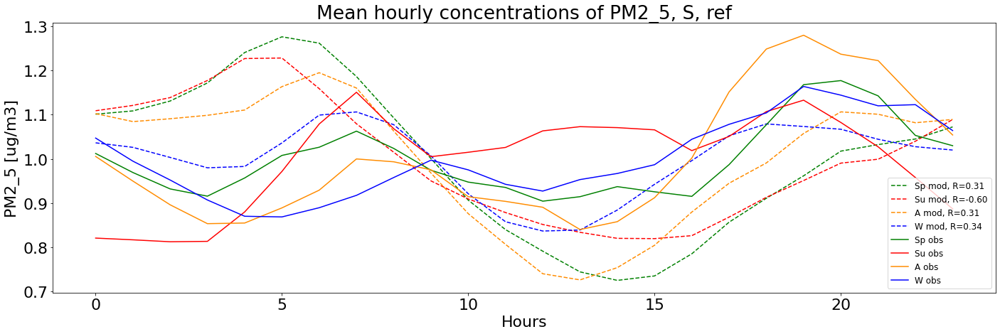

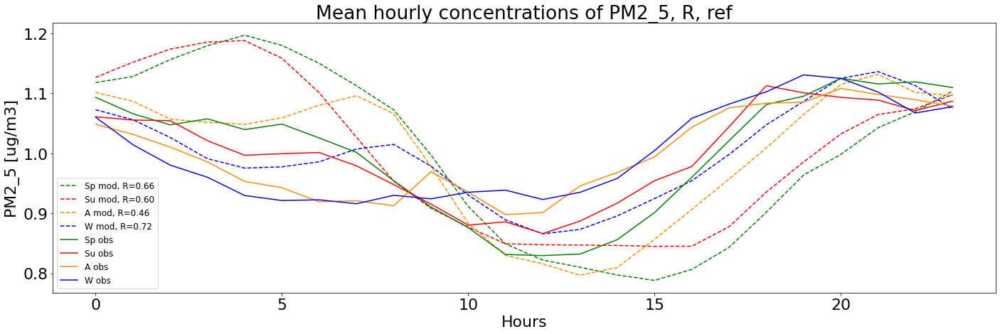

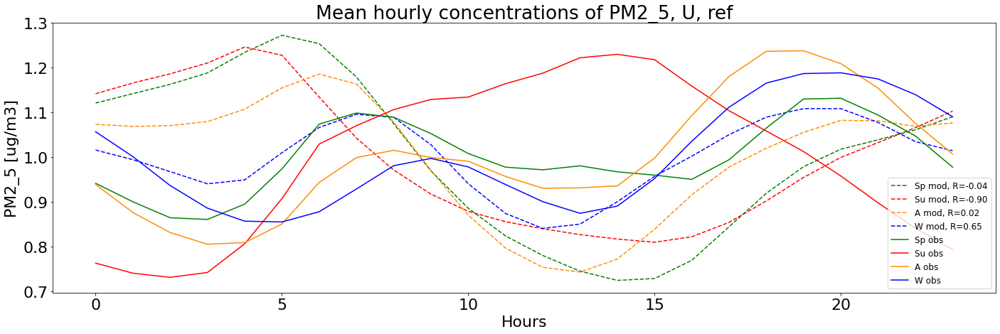

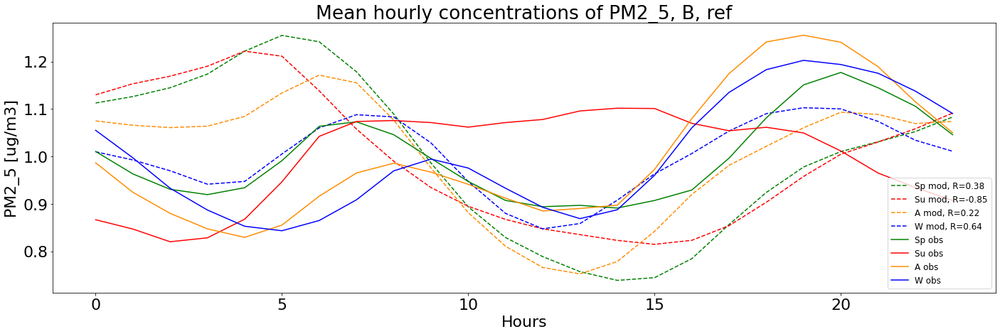

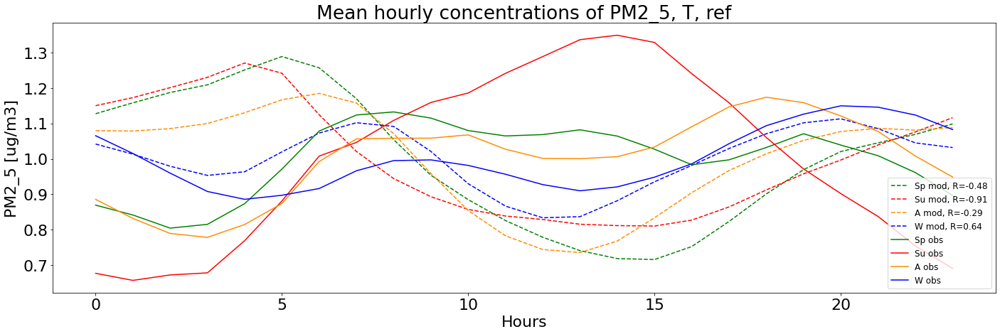

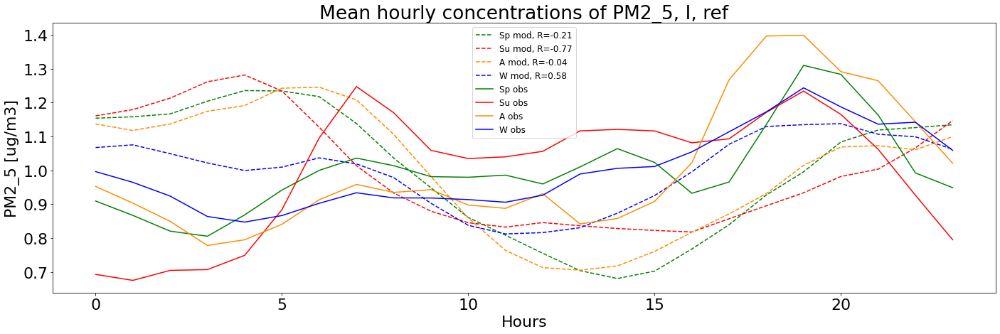

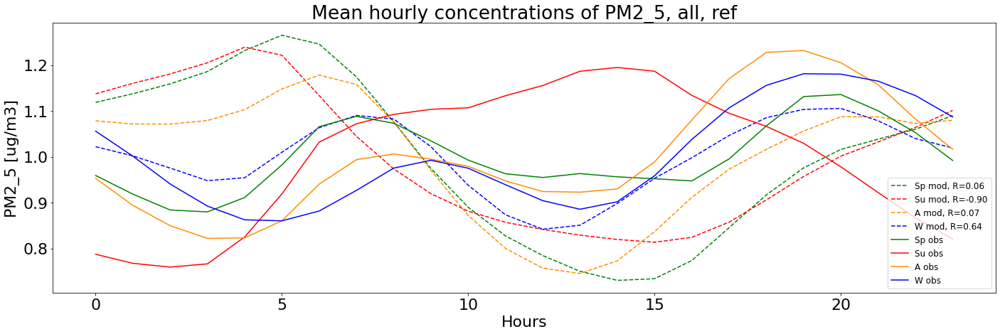

In [77]:
save = True
spec_nick = 'ref'
stat_types_new = ['RB', 'OB', 'UT']

if save:
    print('Plots will be saved at:{}'.format(save_path))
#for t in stat_types_new:
for t in all_types_all:
    #"""
    if t in locs:
        stanice_vyber = list(stat_all.loc[stat_all['loc'] == t].loc[stat_all['coverage'] != 0].index)
    elif t in types:
        stanice_vyber = list(stat_all.loc[stat_all['type'] == t].loc[stat_all['coverage'] != 0].index)
    else:
        stanice_vyber = list(stat_all.loc[stat_all['coverage'] != 0].index.values)[1:]  
    """
        
    if t == 'RB':
            #loc_, type_ = 'R', 'B'
            stanice_vyber = list(stat_all.loc[stat_all['type'] == 'B'].loc[stat_all['loc']=='R'].loc[stat_all['coverage'] != 0].index)
        
    if t == 'OB':
            stanice_vyber = list(stat_all.loc[stat_all['type'] == 'B'].loc[stat_all['loc']=='U'].loc[stat_all['coverage'] != 0].index) + list(stat_all.loc[stat_all['type'] == 'B'].loc[stat_all['loc']=='S'].loc[stat_all['coverage'] != 0].index)
             
    if t == 'UT':
            stanice_vyber = list(stat_all.loc[stat_all['type'] == 'T'].loc[stat_all['loc']=='U'].loc[stat_all['coverage'] != 0].index)
    #"""

    mod_id_jar = data[spec_nick]['MOD'].sel(station = stanice_vyber, time = data[spec_nick].time.dt.month.isin(season_months['spring'])).groupby('time.hour').mean().mean(dim = 'station')
    mod_id_leto = data[spec_nick]['MOD'].sel(station = stanice_vyber, time = data[spec_nick].time.dt.month.isin(season_months['summer'])).groupby('time.hour').mean().mean(dim = 'station')
    mod_id_jar_norm, mod_id_leto_norm = 24*mod_id_jar/mod_id_jar.sum(), 24*mod_id_leto/mod_id_leto.sum()
    mod_id_jesen = data[spec_nick]['MOD'].sel(station = stanice_vyber, time = data[spec_nick].time.dt.month.isin(season_months['autumn'])).groupby('time.hour').mean().mean(dim = 'station')
    mod_id_zima = data[spec_nick]['MOD'].sel(station = stanice_vyber, time = data[spec_nick].time.dt.month.isin(season_months['winter'])).groupby('time.hour').mean().mean(dim = 'station')
    mod_id_jesen_norm, mod_id_zima_norm = 24*mod_id_jesen/mod_id_jesen.sum(), 24*mod_id_zima/mod_id_zima.sum()
    
    obs_id_jar = data[specific[0]]['OBS'].sel(station = stanice_vyber, time = data[specific[0]].time.dt.month.isin(season_months['spring'])).groupby('time.hour').mean().mean(dim = 'station')
    obs_id_leto = data[specific[0]]['OBS'].sel(station = stanice_vyber, time = data[specific[0]].time.dt.month.isin(season_months['summer'])).groupby('time.hour').mean().mean(dim = 'station')
    obs_id_jar_norm, obs_id_leto_norm = 24*obs_id_jar/obs_id_jar.sum(), 24*obs_id_leto/obs_id_leto.sum()
    obs_id_jesen = data[specific[0]]['OBS'].sel(station = stanice_vyber, time = data[specific[0]].time.dt.month.isin(season_months['autumn'])).groupby('time.hour').mean().mean(dim = 'station')
    obs_id_zima = data[specific[0]]['OBS'].sel(station = stanice_vyber, time = data[specific[0]].time.dt.month.isin(season_months['winter'])).groupby('time.hour').mean().mean(dim = 'station')
    obs_id_jesen_norm, obs_id_zima_norm = 24*obs_id_jesen/obs_id_jesen.sum(), 24*obs_id_zima/obs_id_zima.sum()
    
    r_jar = mod_id_jar.to_series().corr(obs_id_jar.to_series())
    r_leto = mod_id_leto.to_series().corr(obs_id_leto.to_series())
    r_jesen = mod_id_jesen.to_series().corr(obs_id_jesen.to_series())
    r_zima = mod_id_zima.to_series().corr(obs_id_zima.to_series())
    
    #name_sta = stat[spec_nick].name.loc[stat[spec_nick].index == i].item()
    
    plt.rcParams['figure.figsize'] = 20,7
    plt.rcParams.update({'font.size': 22})

    plt.plot(mod_id_jar.hour, mod_id_jar_norm[:], color ='green', linestyle='--', label = 'Sp mod, R={:0.2f}'.format(r_jar)) 
    plt.plot(mod_id_leto.hour, mod_id_leto_norm[:], color ='red', linestyle='--', label = 'Su mod, R={:0.2f}'.format(r_leto))
    plt.plot(mod_id_jesen.hour, mod_id_jesen_norm[:], color ='darkorange', linestyle='--', label = 'A mod, R={:0.2f}'.format(r_jesen)) 
    plt.plot(mod_id_zima.hour, mod_id_zima_norm[:], color ='blue', linestyle='--', label = 'W mod, R={:0.2f}'.format(r_zima))
    
    plt.plot(obs_id_jar.hour, obs_id_jar_norm[:], color ='green', label = 'Sp obs') 
    plt.plot(obs_id_leto.hour, obs_id_leto_norm[:], color ='red', label = 'Su obs')
    plt.plot(obs_id_jesen.hour, obs_id_jesen_norm[:], color ='darkorange', label = 'A obs') 
    plt.plot(obs_id_zima.hour, obs_id_zima_norm[:], color ='blue', label = 'W obs')
    
    plt.legend(fontsize=12)                
    plt.title('Mean hourly concentrations of {0}, {1}, {2}'.format(v,t,spec_nick))                               
    plt.xlabel('Hours')
    plt.ylabel('{0} [{1}]'.format(v,units))
    plt.tight_layout()

    if save:
        if not os.path.exists(save_path):
            os.makedirs(save_path)
        plt.savefig('{0}/MH_norm_seasons_{1}_{2}_{3}_2.png'.format(save_path,v,spec_nick,t), dpi=300) 
    plt.show()                
    plt.close() 

## Zimny vs letny cas

In [ ]:
### USER INPUT
# Choose stations to plot
ID = list(stat_all.index.values)[1:]   # all stations
#ID = [11813,11916]    # selected stations

letny = 'leto'
zimny = 'zima'
spec_nick = 'orig'

save = False   # save the plots?  

save_path = '{0}/validated/{1}_{2}/graphs/{3}'.format(vali_path, nick, start_date[0:4],v)

In [ ]:
if save:
    print('Plots will be saved at:{}'.format(save_path))
for i in ID:    
    
    obs_id_leto = data[specific[0]]['OBS'].sel(station = i, time = data[specific[0]].time.dt.month.isin(season_months[letny])).groupby('time.hour').mean()
    obs_id_zima = data[specific[0]]['OBS'].sel(station = i, time = data[specific[0]].time.dt.month.isin(season_months[zimny])).groupby('time.hour').mean()
    
    mod_id_leto = data[spec_nick]['MOD'].sel(station = i, time = data[spec_nick].time.dt.month.isin(season_months[letny])).groupby('time.hour').mean()
    mod_id_zima = data[spec_nick]['MOD'].sel(station = i, time = data[spec_nick].time.dt.month.isin(season_months[zimny])).groupby('time.hour').mean()
    
    r_leto = mod_id_leto.to_series().corr(obs_id_leto.to_series())
    r_zima = mod_id_zima.to_series().corr(obs_id_zima.to_series())
    
    name_sta = stat[specific[0]].name.loc[stat[specific[0]].index == i].item()
    
    plt.rcParams['figure.figsize'] = 20,7
    plt.rcParams.update({'font.size': 22})

    plt.plot(obs_id_leto.hour, obs_id_leto[:], color ='salmon', label = 'letny cas') 
    plt.plot(obs_id_zima.hour, obs_id_zima[:], color ='dodgerblue', label = 'zimny cas')
    
    plt.plot(mod_id_leto.hour, mod_id_leto[:], color ='red', label = 'leto mod, R={:0.2f}'.format(r_leto))
    plt.plot(mod_id_zima.hour, mod_id_zima[:], color ='blue', label = 'zima mod, R={:0.2f}'.format(r_zima))

    plt.legend(fontsize=12)                
    plt.title('Mean hourly concentration of {0}, {1}'.format(v,name_sta))                               
    plt.xlabel('Hours')
    plt.ylabel('{0} [{1}]'.format(v,units))
    plt.tight_layout()

    if save:
        if not os.path.exists(save_path):
            os.makedirs(save_path)
        plt.savefig('{0}/{1}_{2}_{3}_{4}_MH{5}-{6}.png'.format(save_path,nick, start_date[0:4], v, i,plot_from,plot_until), dpi=300)                
    plt.show()                
    plt.close() 

## Sezonalita 

### Vsetky stanice

In [78]:
save_path = '/data/teri/validacia/validated/{0}/graphs/{1}'.format(folder_name, v)
#ID = list(stat_all.index.values)[:]
ID = list(stat_all.index.values)
fzl = stat[specific[0]][['name','loc','type','coverage']].copy()
zl = stat[specific[0]][['name','loc','type','coverage']].copy()

for i in ID:
    #print(i)
    if i == 'all':
        zima = data['ref']['OBS'].sel(time = data[specific[0]].time.dt.month.isin(season_months['winter'])).mean()
        leto = data['ref']['OBS'].sel(time = data[specific[0]].time.dt.month.isin(season_months['summer'])).mean()
        obs_mean = data['ref']['OBS'].sel(time = data[specific[0]].time.dt.month.isin(season_months['year'])).mean()
    else:
        zima = data['ref']['OBS'].sel(station = i, time = data[specific[0]].time.dt.month.isin(season_months['winter'])).mean()
        leto = data['ref']['OBS'].sel(station = i, time = data[specific[0]].time.dt.month.isin(season_months['summer'])).mean()
        obs_mean = data['ref']['OBS'].sel(station = i, time = data[specific[0]].time.dt.month.isin(season_months['year'])).mean()
    
    fzl.at[i, 'fzl_obs'] = zima/leto
    zl.at[i, 'zl_obs'] = (zima - leto)/obs_mean

    for s in specific:
        if i == 'all':
            zima = data[s]['MOD'].sel(time = data[specific[0]].time.dt.month.isin(season_months['winter'])).mean()
            leto = data[s]['MOD'].sel(time = data[specific[0]].time.dt.month.isin(season_months['summer'])).mean()
            mod_mean = data[s]['MOD'].sel(time = data[specific[0]].time.dt.month.isin(season_months['year'])).mean()
        else:
            zima = data[s]['MOD'].sel(station = i, time = data[s].time.dt.month.isin(season_months['winter'])).mean()
            leto = data[s]['MOD'].sel(station = i, time = data[s].time.dt.month.isin(season_months['summer'])).mean()
            mod_mean = data[s]['MOD'].sel(station = i, time = data[s].time.dt.month.isin(season_months['year'])).mean()
        
        if zima != np.nan and leto != np.nan:
            fzl.at[i, 'fzl_{0}'.format(s)] = zima/leto
            zl.at[i, 'zl_{0}'.format(s)] = (zima - leto)/mod_mean
        else:
            fzl.at[i, 'fzl_{0}'.format(s)] = np.nan
            zl.at[i, 'zl_{0}'.format(s)] = np.nan

fzl

/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)
/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)
/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)
/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)
/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis=axis, dtype=dtype)
/data/juraj/anaconda/envs/supergeo/lib/python3.8/site-packages/xarray/core/nanops.py:142: RuntimeWarning: Mean of empty slice
  return 

,name,loc,type,coverage,fzl_obs,fzl_ref,fzl_cop,fzl_rh_const,fzl_tot_const
all,all,all,all,95.4434,3.257443,2.998928,2.954208,2.317511,2.143534
11813,"BRATISLAVA, JESENIOVA",S,B,96.7922,4.341812,4.047027,3.910098,2.855180,2.593354
11916,"CHOPOK, EMEP",R,B,0,NaN,0.837343,0.832933,0.755686,0.724464
11952,"GANOVCE, METEO. ST.",R,B,0,NaN,1.945347,1.902189,1.433939,1.407701
11958,KOJSOVSKA HOLA,R,B,0,NaN,1.900234,1.889476,1.614238,1.557379
99111,"BRATISLAVA, MAMATEYOVA",U,B,98.1621,4.114979,3.723616,3.638635,2.964143,2.602902
99112,"BRATISLAVA, TRNAVSKE MYTO",U,T,0,NaN,4.047027,3.910098,2.855180,2.593354
99114,"BRATISLAVA, KAMENNE NAM.",U,B,50.7991,4.036687,4.047027,3.910098,2.855180,2.593354
99117,BRATISLAVA - RACA,None,None,0,NaN,3.738219,3.673552,2.991242,2.753779
99122,"SENICA, HVIEZDOSLAVOVA",U,T,97.1689,2.915202,3.507404,3.463173,2.984353,2.691381


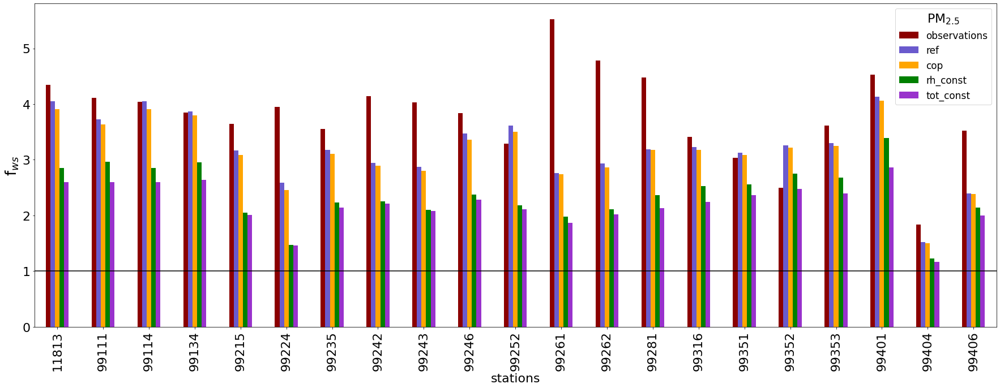

In [79]:
station_list = list(stat_all.loc[stat_all['type'] == 'B'].loc[stat_all.coverage != 0].index.values)

plt.rcParams['figure.figsize'] = 25,10
plt.rcParams.update({'font.size': 22})
# VYBER STANIC Z LISTU
fzl.loc[station_list,list(fzl.columns)[4:]].plot.bar(color=['darkred','slateblue','orange','green','darkorchid'])
# PLOT VSETKYCH STANIC S NAZVAMI (ROZMER ZADAT 40,8) 
#fzl.plot.bar(x = 'name',y = ['fzl_obs','fzl_orig','fzl_rh_const','fzl_tot_const'],color=['darkred','slateblue','orange','green'])
# PLOT VSETKYCH STANIC S KODOM (ROZMER ZADAT 40,8)
#fzl.iloc[:,4:].plot.bar(color=['darkred','slateblue','orange','green'])
plt.legend(["observations", "ref", "cop", 'rh_const','tot_const'],title='PM$_{2.5}$',fontsize=17)
plt.axhline(y=1,color='black')
plt.ylabel('f$_{ws}$', fontsize=26)
plt.xlabel('stations', fontsize=22)
plt.tight_layout()
    
plt.savefig('{0}/fzl_{1}_{2}.png'.format(save_path,folder_name,v), dpi=300)
plt.show()
plt.close()

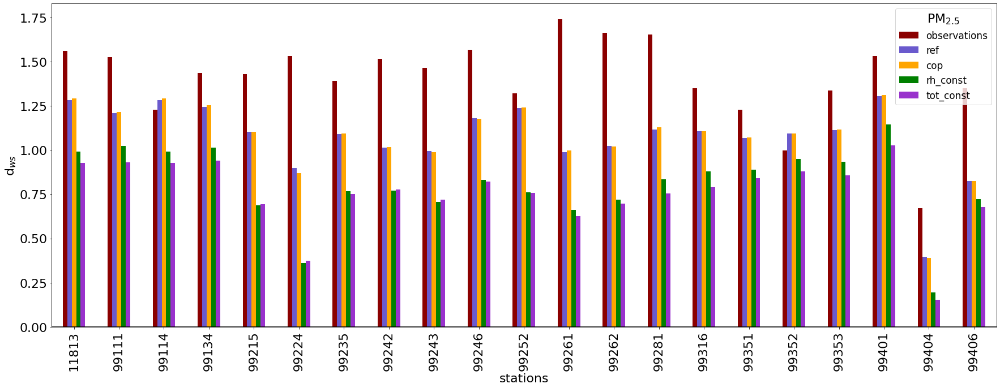

In [80]:
station_list = list(stat_all.loc[stat_all['type'] == 'B'].loc[stat_all.coverage != 0].index.values)

plt.rcParams['figure.figsize'] = 25,10
plt.rcParams.update({'font.size': 22})
zl.loc[station_list,list(zl.columns)[4:]].plot.bar(color=['darkred','slateblue','orange','green','darkorchid'])
#zl.iloc[:,4:].plot.bar(color=['darkred','slateblue','orange','green'])
plt.legend(["observations", "ref", "cop", 'rh_const','tot_const'],title='PM$_{2.5}$',fontsize=17)
plt.axhline(y=0,color='black')
#plt.ylabel('Mean winter - summer conc. $[\mu g . m^{-3}]$', fontsize=22)  #18
plt.ylabel('d$_{ws}$', fontsize=22)  #18
plt.xlabel('stations', fontsize=22)
plt.tight_layout()
    
plt.savefig('{0}/dws_{1}_{2}.png'.format(save_path,folder_name,v), dpi=300)
plt.show()
plt.close()

### Typy stanic 

In [81]:
fzl_types = pd.DataFrame(index = all_types, columns = ['count']+list(fzl.columns)[3:], dtype = 'float64')
zl_types = pd.DataFrame(index = all_types, columns = ['count']+list(zl.columns)[3:], dtype = 'float64')
for t in all_types:
    if t in locs:
        col = 'loc'
    else:
        col = 'type'
        
    stanice_vyber = list(stat_all.loc[stat_all[col] == t].loc[stat_all['coverage'] != 0].index)
    fzl_types.at[t,'count'], zl_types.at[t,'count']  = len(stanice_vyber), len(stanice_vyber)
    obs = data['ref']['OBS'].sel(station = stanice_vyber, time = data['ref'].time.dt.month.isin(season_months['year'])).to_series()
    zima = data['ref']['OBS'].sel(station = stanice_vyber, time = data['ref'].time.dt.month.isin(season_months['winter'])).mean()
    leto = data['ref']['OBS'].sel(station = stanice_vyber, time = data['ref'].time.dt.month.isin(season_months['summer'])).mean()    
    coverage = 100*(len(obs) - obs.isna().sum())/len(obs)
    fzl_types.at[t,'coverage'], zl_types.at[t,'coverage'] = coverage, coverage
    obs_mean = np.mean(obs)
    
    fzl_types.at[t, 'fzl_obs'] = zima/leto
    zl_types.at[t, 'zl_obs'] = (zima - leto)/obs_mean
    
    for s in specific:
        zima = data[s]['MOD'].sel(station = stanice_vyber, time = data[s].time.dt.month.isin(season_months['winter'])).mean()
        leto = data[s]['MOD'].sel(station = stanice_vyber, time = data[s].time.dt.month.isin(season_months['summer'])).mean()
        mod_mean = data[s]['MOD'].sel(station = stanice_vyber, time = data['ref'].time.dt.month.isin(season_months['year'])).mean()
        
        fzl_types.at[t, 'fzl_{0}'.format(s)] = zima/leto
        zl_types.at[t, 'zl_{0}'.format(s)] = (zima - leto)/mod_mean
    
        
zl_types

,count,coverage,zl_obs,zl_ref,zl_cop,zl_rh_const,zl_tot_const
S,3.0,97.226027,1.280326,1.135794,1.140316,0.896591,0.834382
R,3.0,97.576104,1.236747,0.931050,0.933169,0.782315,0.705673
U,26.0,94.991658,1.304180,1.118935,1.119885,0.837469,0.792985
B,21.0,95.656121,1.434844,1.098845,1.101288,0.827879,0.781430
T,10.0,94.702055,1.064123,1.121443,1.121438,0.854452,0.808535
I,1.0,98.390411,0.935843,1.080915,1.080375,0.899056,0.779578


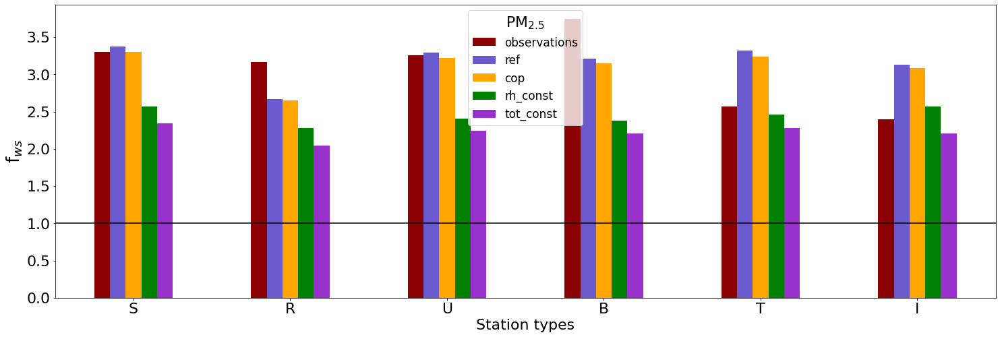

In [82]:
plt.rcParams['figure.figsize'] = 25,8
plt.rcParams.update({'font.size': 22})
fzl_types.iloc[:,2:].plot.bar(color=['darkred','slateblue','orange','green','darkorchid'], rot=0)
plt.legend(["observations", "ref", "cop", 'rh_const','tot_const'],title='PM$_{2.5}$',fontsize=17)
plt.axhline(y=1,color='black')
plt.ylabel('f$_{ws}$', fontsize=26)
plt.xlabel('Station types', fontsize=22)
    
plt.savefig('{0}/fws_station_types_{1}_{2}.png'.format(save_path,folder_name,v), dpi=300)
plt.show()
plt.close()

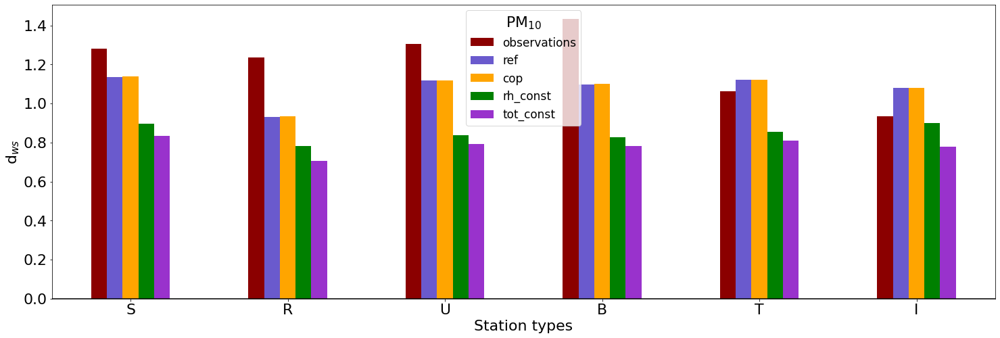

In [83]:
plt.rcParams['figure.figsize'] = 25,8
plt.rcParams.update({'font.size': 22})
zl_types.iloc[:,2:].plot.bar(color=['darkred','slateblue','orange','green','darkorchid'], rot=0)
plt.legend(["observations", "ref", "cop", 'rh_const','tot_const'],title='PM$_{10}$',fontsize=17)
plt.axhline(y=0,color='black')
#plt.ylabel('Mean winter - summer conc. $[\mu g . m^{-3}]$', fontsize=22)  #18
plt.ylabel('d$_{ws}$', fontsize=22)  #18
plt.xlabel('Station types', fontsize=22)
    
#plt.savefig('{0}/ws_station_types_{1}_CMAQ2017d02.png'.format(save_path,v), dpi=300)
plt.savefig('{0}/dws_station_types_{1}_{2}.png'.format(save_path, folder_name, v), dpi=300)
plt.show()
plt.close()